In [27]:
import pandas as pd
import os

def load_and_label_year(file_path, year):
    """
    Load a CSV file, remove commas from numeric values, add a 'Year' column to it, and handle data types appropriately.
    """
    df = pd.read_csv(file_path)
    
    # Remove commas and convert columns to float, skipping the 'State' column which is categorical
    numeric_columns = df.columns.drop(['State'])  # Adjust if some columns shouldn't be included
    for column in numeric_columns:
        df[column] = df[column].astype(str).str.replace(',', '').astype(float)
    
    df['Year'] = year
    return df

def combine_data(directory):
    """
    Combine CSV files from different years into a single DataFrame.
    Each file should be named with the year, like '2016 Registration Counts - Sheet1.csv'.
    """
    combined_df = pd.DataFrame()
    for file_name in os.listdir(directory):
        if file_name.endswith('.csv'):
            year = int(file_name.split()[0])  # Extract year from the filename assuming it starts with the year
            file_path = os.path.join(directory, file_name)
            df = load_and_label_year(file_path, year)
            combined_df = pd.concat([combined_df, df], ignore_index=True)
    
    return combined_df

def clean_data(df):
    """
    Clean the combined DataFrame.
    """
    df.dropna(inplace=True)  # Example: Remove rows with any missing values
    return df

# Directory where the CSV files are stored
data_directory = "processed_data"

# Combine the data from all years
all_data = combine_data(data_directory)

# Clean the combined data
cleaned_data = clean_data(all_data)

# Save the cleaned and combined data
output_file = "combined_data.csv"
cleaned_data.to_csv(output_file, index=False)

print(f"Combined data saved to {output_file}")



Combined data saved to combined_data.csv


Forecasted EV Registrations for the next year: 2288014.285714388


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


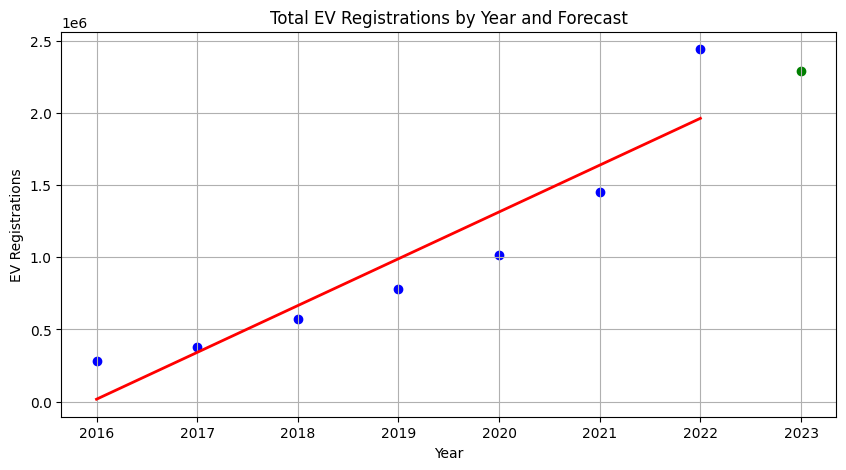

In [30]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from matplotlib import pyplot as plt

# Load the combined data from a single CSV file
file_path = 'combined_data.csv'
all_data = pd.read_csv(file_path)

# Check if 'Electric (EV)' is a string and contains commas; if so, replace commas
if all_data['Electric (EV)'].dtype == 'object':
    all_data['Electric (EV)'] = all_data['Electric (EV)'].str.replace(',', '')

# Convert 'Year' and 'Electric (EV)' to numeric if not already
all_data['Year'] = pd.to_numeric(all_data['Year'], errors='coerce')
all_data['Electric (EV)'] = pd.to_numeric(all_data['Electric (EV)'], errors='coerce')

# Aggregate 'Electric (EV)' registrations by year if there are multiple entries per year
ev_registrations = all_data.groupby('Year')['Electric (EV)'].sum()

# Convert to DataFrame for regression
df = pd.DataFrame(ev_registrations).reset_index()

# Preparing data for regression
X = df[['Year']]  # Features
y = df['Electric (EV)']  # Target

# Fit linear regression model
model = LinearRegression()
model.fit(X, y)

# Predict the next year by adding one to the last year in your dataset
next_year = np.array([[X['Year'].iloc[-1] + 1]])
forecast = model.predict(next_year)
print(f'Forecasted EV Registrations for the next year: {forecast[0]}')

# Plot the data along with the prediction
plt.figure(figsize=(10, 5))
plt.scatter(X['Year'], y, color='blue')  # Actual data points
plt.plot(X['Year'], model.predict(X), color='red', linewidth=2)  # Line of best fit
plt.scatter(next_year, forecast, color='green')  # Forecasted point
plt.title('Total EV Registrations by Year and Forecast')
plt.xlabel('Year')
plt.ylabel('EV Registrations')
plt.grid(True)
plt.show()


Forecasted EV Registrations for the next year: 2288014.285713911
                            OLS Regression Results                            
Dep. Variable:          Electric (EV)   R-squared:                       0.862
Model:                            OLS   Adj. R-squared:                  0.834
Method:                 Least Squares   F-statistic:                     31.18
Date:                Sun, 28 Jul 2024   Prob (F-statistic):            0.00254
Time:                        11:54:13   Log-Likelihood:                -97.209
No. Observations:                   7   AIC:                             198.4
Df Residuals:                       5   BIC:                             198.3
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\stats\stattools.py:74: ValueWarning: omni_normtest is not valid with less than 8 observations; 7 samples were given.
  warn("omni_normtest is not valid with less than 8 observations; %i "


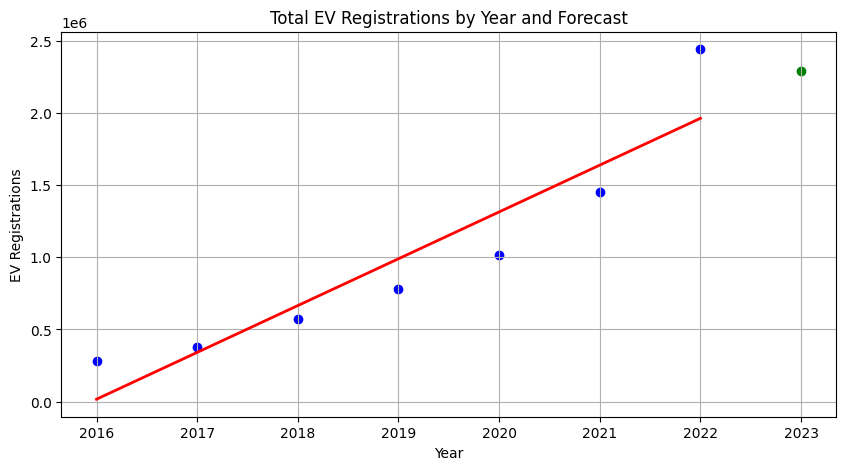

In [33]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from matplotlib import pyplot as plt

# Load the data
all_data = pd.read_csv('combined_data.csv')

# Ensure 'Year' and 'Electric (EV)' columns are the correct type
all_data['Year'] = pd.to_numeric(all_data['Year'], errors='coerce')
all_data['Electric (EV)'] = pd.to_numeric(all_data['Electric (EV)'], errors='coerce')

# Assuming 'Electric (EV)' column exists and you want to aggregate it by year if needed
ev_registrations = all_data.groupby('Year')['Electric (EV)'].sum()

# Convert to DataFrame for regression
df = pd.DataFrame(ev_registrations).reset_index()

# Preparing data for regression
X = df[['Year']]  # Independent variable
y = df['Electric (EV)']  # Dependent variable
X = sm.add_constant(X)  # Adding a constant to the model

# Create the OLS model
model = sm.OLS(y, X)
results = model.fit()

# Assume that we want to predict for the next year, based on the last year available in the data
next_year_value = X['Year'].max() + 1  # Get the last year from data and add one

# Create a DataFrame for prediction and add constant
next_year = pd.DataFrame({'Year': [next_year_value]})
next_year = sm.add_constant(next_year, has_constant='add')  # Add constant ensuring not to omit it

# Predict using the trained model
forecast = results.predict(next_year)
print(f'Forecasted EV Registrations for the next year: {forecast.iloc[0]}')

# Output the summary of the regression
print(results.summary())

# Plot the data along with the prediction
plt.figure(figsize=(10, 5))
plt.scatter(X['Year'], y, color='blue')  # Actual data points
plt.plot(X['Year'], results.predict(X), color='red', linewidth=2)  # Line of best fit
plt.scatter(next_year['Year'], forecast, color='green')  # Forecasted point
plt.title('Total EV Registrations by Year and Forecast')
plt.xlabel('Year')
plt.ylabel('EV Registrations')
plt.grid(True)
plt.show()


In [22]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd

# Assuming X is your DataFrame of predictors
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns

# Calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(len(X.columns))]

print(vif_data)


  feature           VIF
0   const  1.019091e+06
1    Year  1.000000e+00


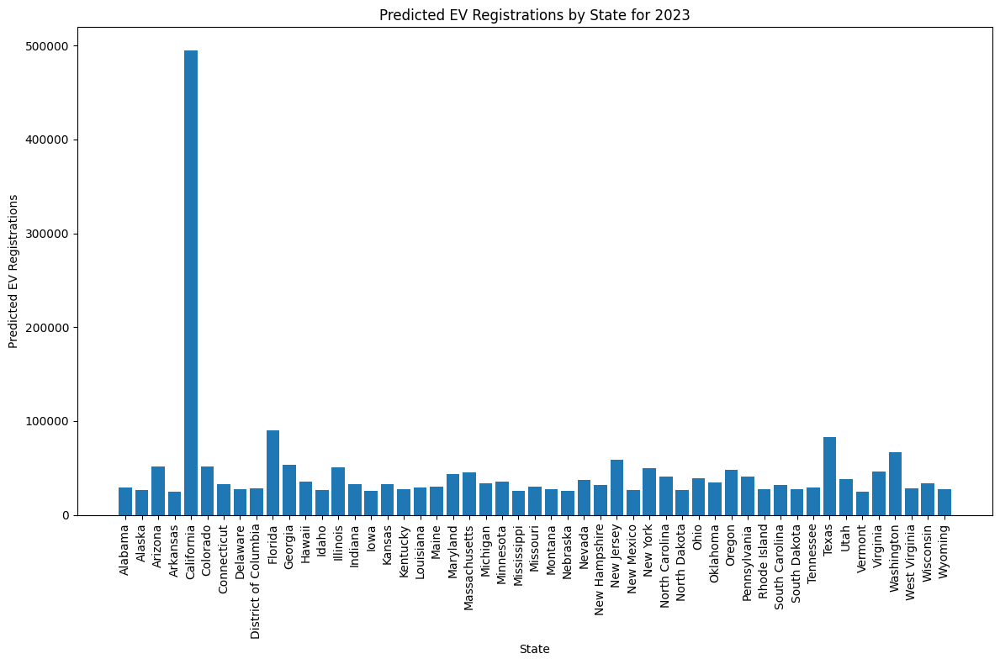

In [36]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

# Load your dataset
df = pd.read_csv("combined_data.csv")

# Assuming 'Year' and 'State' are your columns, and 'Electric (EV)' is the target
X = df[['Year', 'State']]
y = df['Electric (EV)']

# Preprocessing to handle categorical data (State)
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', ['Year']),
        ('cat', OneHotEncoder(), ['State'])
    ])

# Create a pipeline
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model
model.fit(X_train, y_train)

# To predict next year's registrations
next_year = max(df['Year']) + 1
states = df['State'].unique()
next_year_df = pd.DataFrame({'Year': [next_year]*len(states), 'State': states})
predictions = model.predict(next_year_df)

# Create a DataFrame to view the predictions nicely
predicted_df = pd.DataFrame({
    'State': states,
    'Year': next_year,
    'Predicted_EV_Registration': predictions
})

# Plotting the predictions
plt.figure(figsize=(12, 8))
plt.bar(predicted_df['State'], predicted_df['Predicted_EV_Registration'])
plt.xlabel('State')
plt.ylabel('Predicted EV Registrations')
plt.title('Predicted EV Registrations by State for ' + str(next_year))
plt.xticks(rotation=90)  # Rotate state labels for better visibility
plt.tight_layout()  # Adjust layout to make room for label rotation
plt.show()


Model R^2: 0.6942180537116146


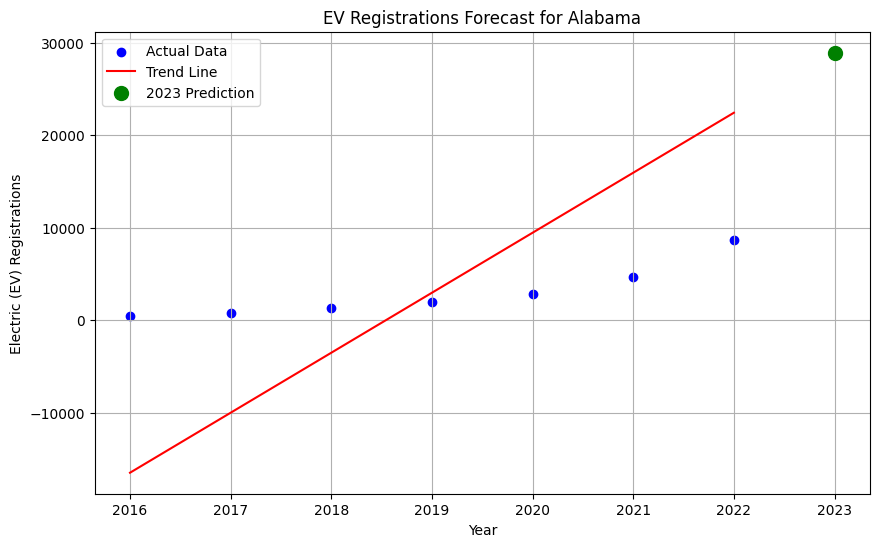

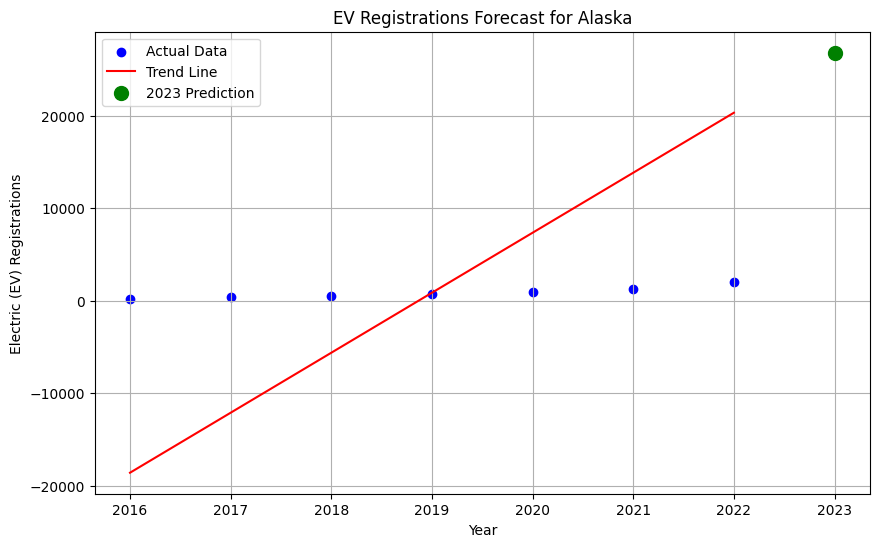

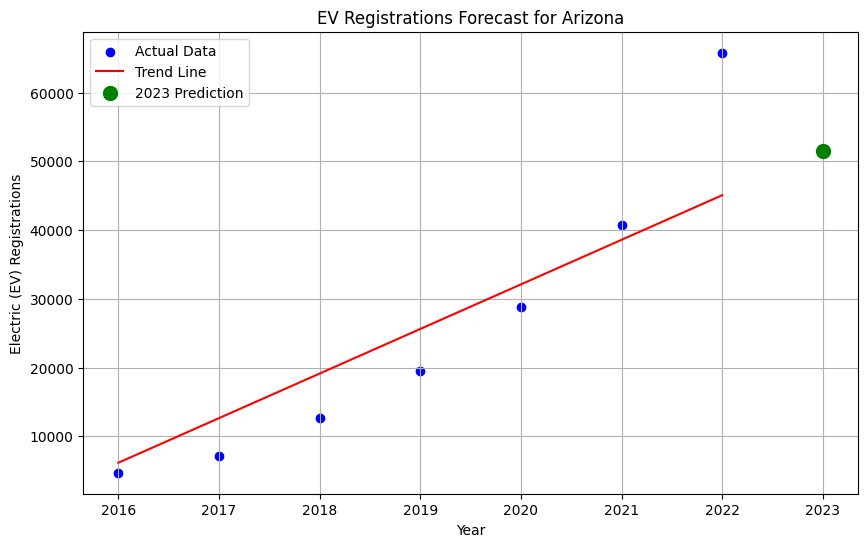

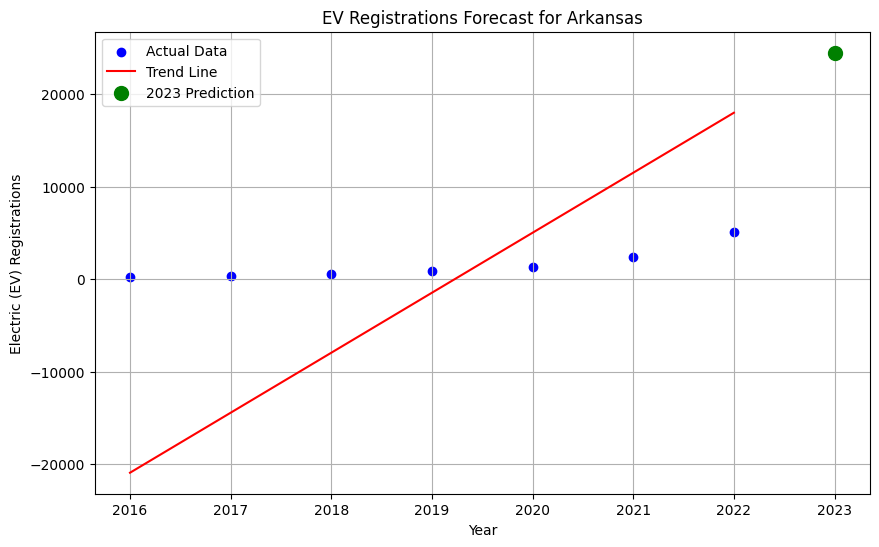

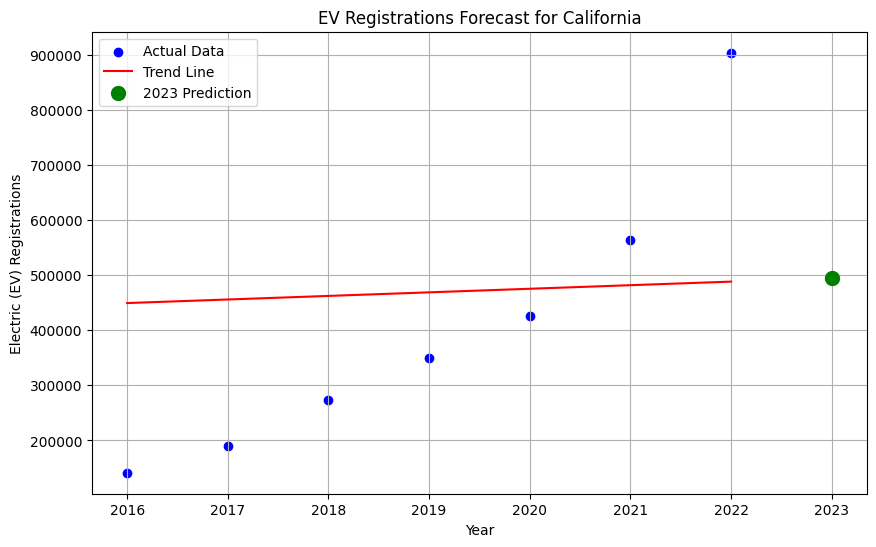

...

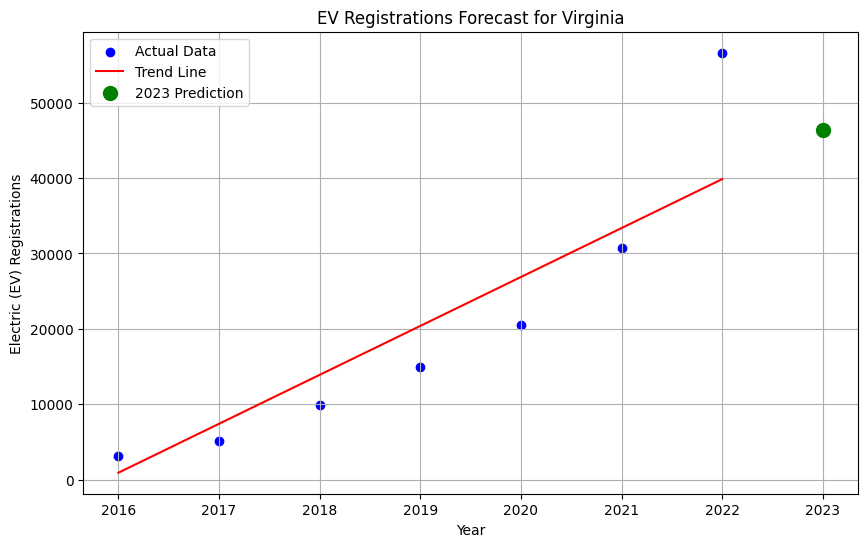

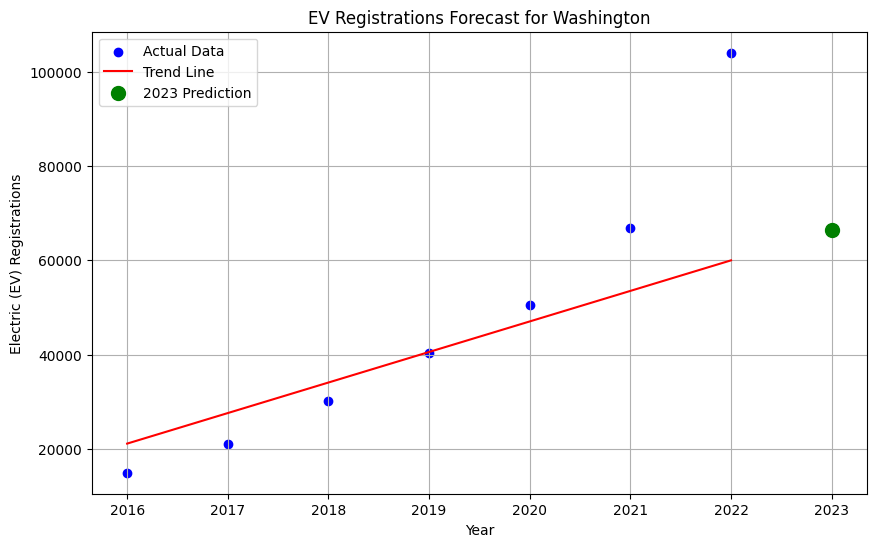

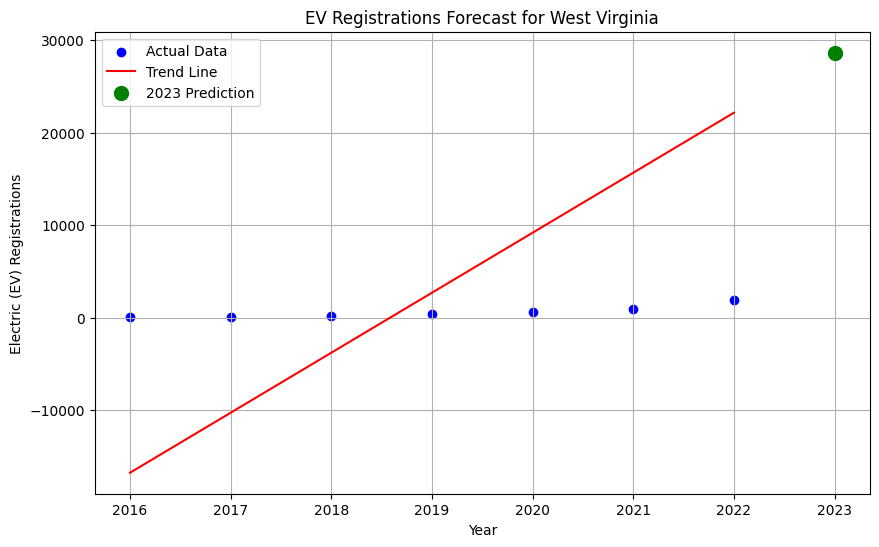

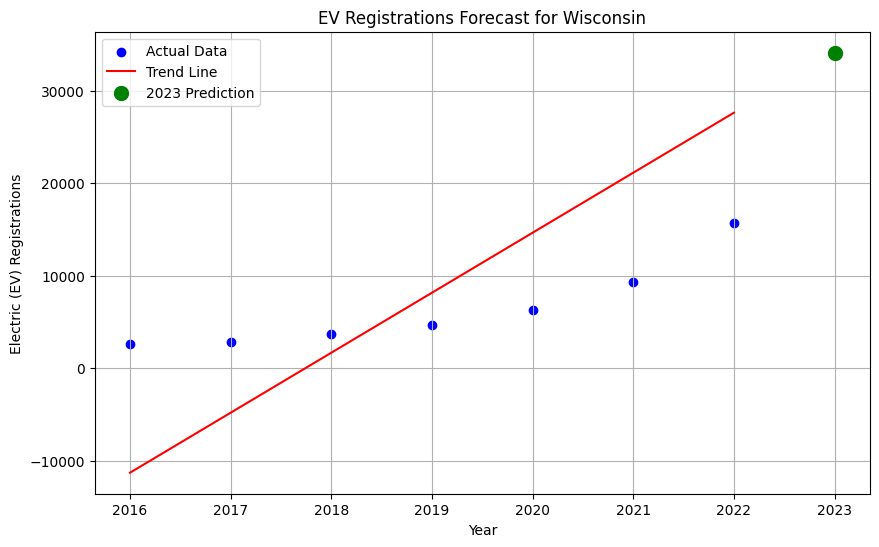

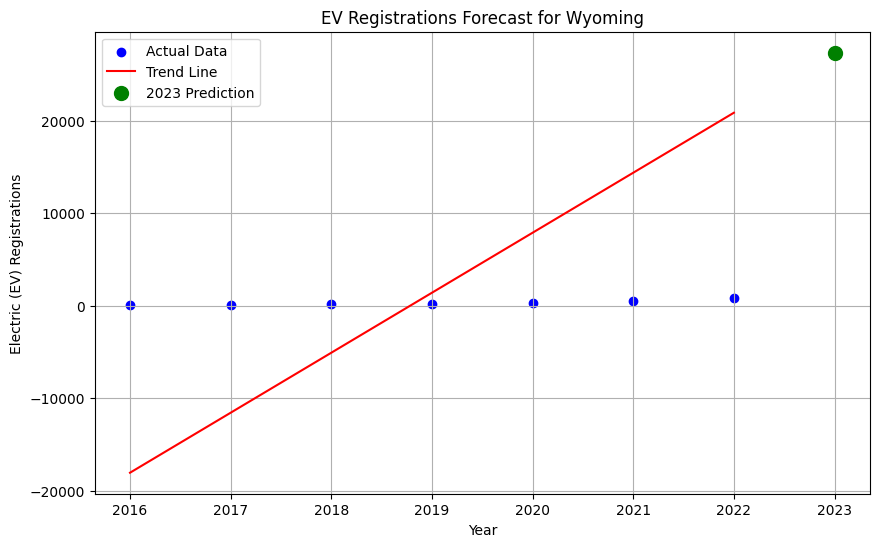

In [60]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

# Load your dataset
df = pd.read_csv("combined_data.csv")

# Convert 'Year' to numerical data suitable for regression analysis
df['Year'] = pd.to_numeric(df['Year'])

# Assuming 'Year' and 'State' are your columns, and 'Electric (EV)' is the target
X = df[['Year', 'State']]
y = df['Electric (EV)']

# Preprocessing to handle categorical data (State)
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', ['Year']),
        ('cat', OneHotEncoder(), ['State'])
    ])

# Create a pipeline with a linear regressor
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model on the training data
model.fit(X_train, y_train)

# Evaluate the model by predicting on the test data
y_pred = model.predict(X_test)

# Calculate the coefficient of determination R^2 of the prediction
r_squared = model.score(X_test, y_test)
print(f"Model R^2: {r_squared}")

# Predict for each year and state to plot trend lines
all_years = np.arange(df['Year'].min(), df['Year'].max() + 2)  # Up to next year
states = df['State'].unique()

for state in states:
    state_df = pd.DataFrame({'Year': all_years, 'State': [state] * len(all_years)})
    predictions = model.predict(state_df)
    
    # Plotting
    plt.figure(figsize=(10, 6))
    state_data = df[df['State'] == state]
    plt.scatter(state_data['Year'], state_data['Electric (EV)'], color='blue', label='Actual Data')
    plt.plot(all_years[:-1], predictions[:-1], color='red', label='Trend Line')  # Exclude the last point from the line
    plt.scatter(all_years[-1:], predictions[-1:], color='green', s=100, label='2023 Prediction', zorder=5)  # Highlight 2023
    
    plt.title(f'EV Registrations Forecast for {state}')
    plt.xlabel('Year')
    plt.ylabel('Electric (EV) Registrations')
    plt.legend()
    plt.grid(True)
    plt.show()


Model R^2: 0.6942180537116146


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_36980\235280572.py:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', len(states))


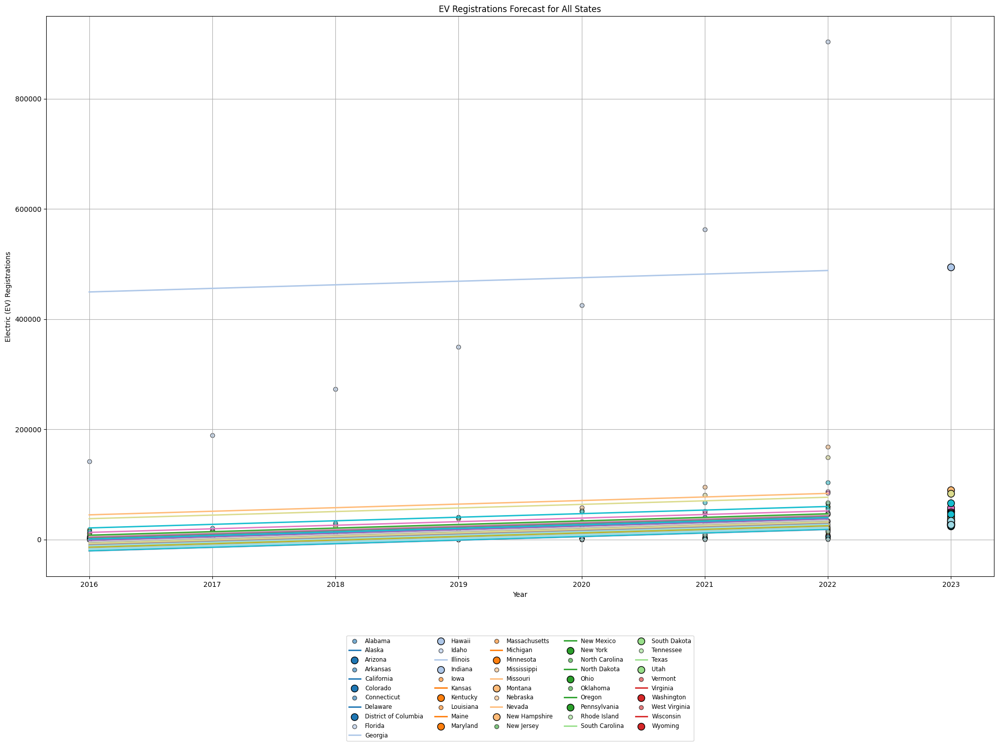

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

# Load your dataset
df = pd.read_csv("combined_data.csv")

# Convert 'Year' to numerical data suitable for regression analysis
df['Year'] = pd.to_numeric(df['Year'])

# Assuming 'Year' and 'State' are your columns, and 'Electric (EV)' is the target
X = df[['Year', 'State']]
y = df['Electric (EV)']

# Preprocessing to handle categorical data (State)
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', ['Year']),
        ('cat', OneHotEncoder(), ['State'])
    ])

# Create a pipeline with a linear regressor
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model on the training data
model.fit(X_train, y_train)

# Evaluate the model by predicting on the test data
y_pred = model.predict(X_test)

# Calculate the coefficient of determination R^2 of the prediction
r_squared = model.score(X_test, y_test)
print(f"Model R^2: {r_squared}")

# Predict for each year and state to plot trend lines
all_years = np.arange(df['Year'].min(), df['Year'].max() + 2)  # Up to next year
states = df['State'].unique()

# Initialize the plot
plt.figure(figsize=(20, 15))

# Use a colormap for better differentiation between states
colors = plt.cm.get_cmap('tab20', len(states))

for idx, state in enumerate(states):
    state_df = pd.DataFrame({'Year': all_years, 'State': [state] * len(all_years)})
    predictions = model.predict(state_df)
    
    # Plotting
    state_data = df[df['State'] == state]
    plt.scatter(state_data['Year'], state_data['Electric (EV)'], color=colors(idx), alpha=0.6, edgecolor='k')
    plt.plot(all_years[:-1], predictions[:-1], color=colors(idx), linewidth=2)
    plt.scatter(all_years[-1:], predictions[-1:], color=colors(idx), s=100, edgecolor='k', zorder=5)

plt.title('EV Registrations Forecast for All States')
plt.xlabel('Year')
plt.ylabel('Electric (EV) Registrations')
plt.grid(True)
plt.legend(states, bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small', ncol=5)
plt.tight_layout()
plt.show()


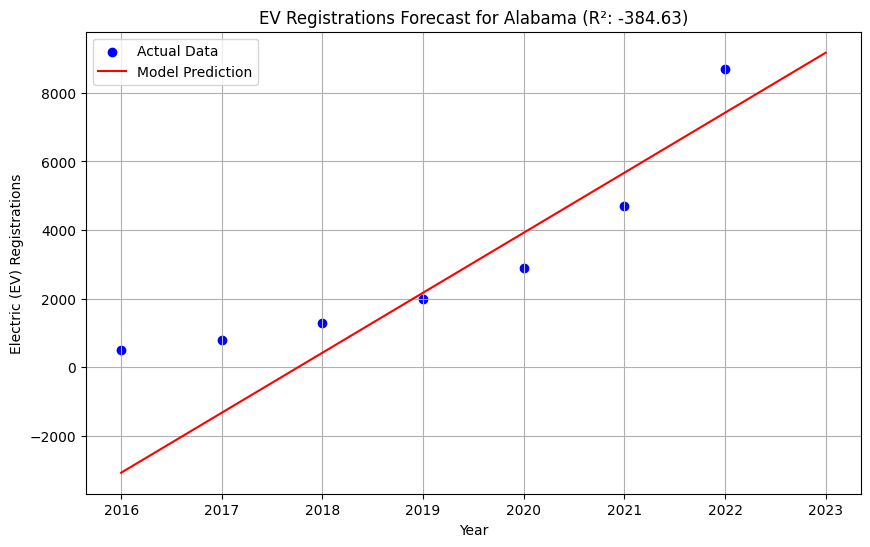

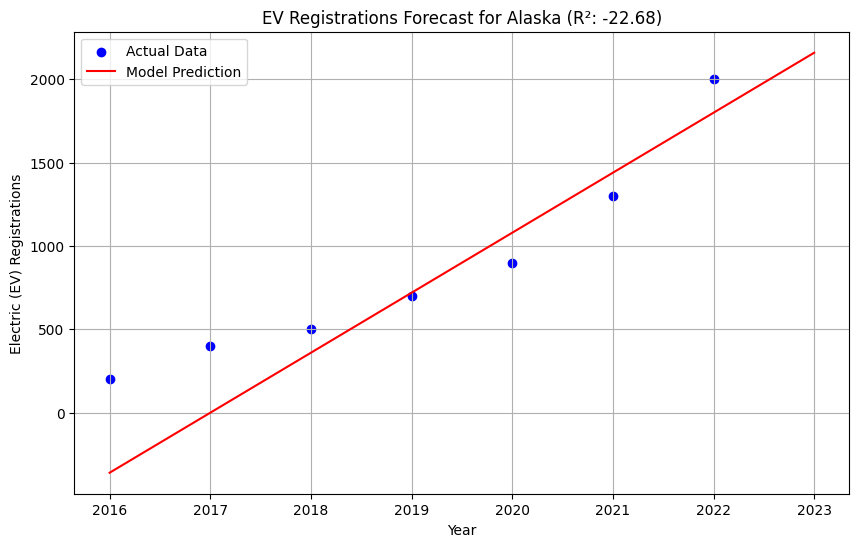

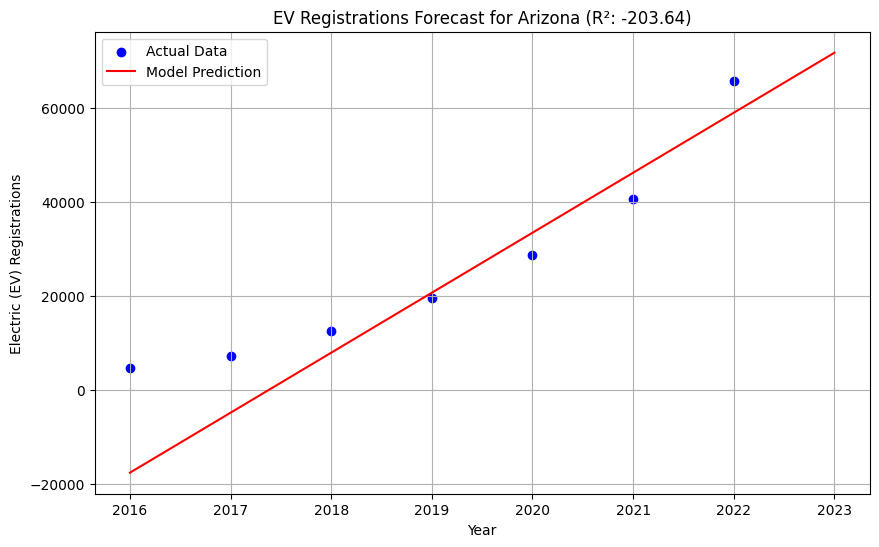

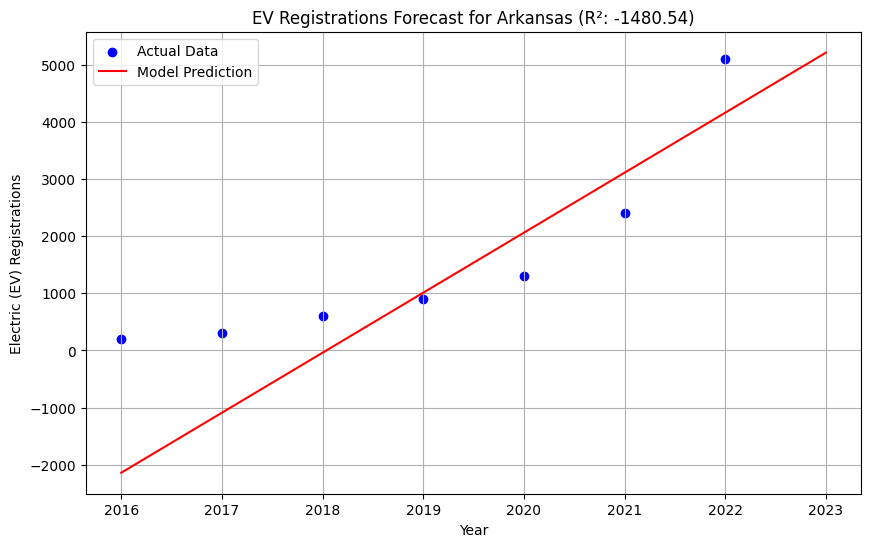

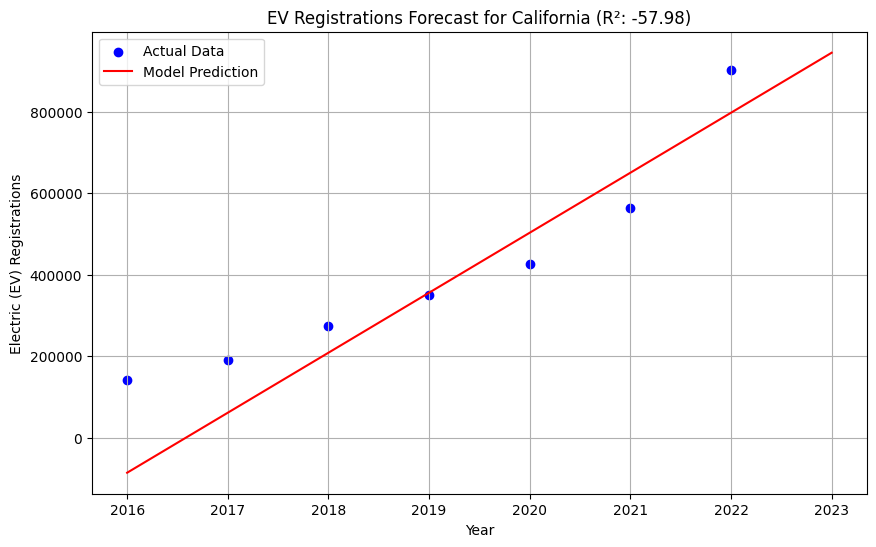

...

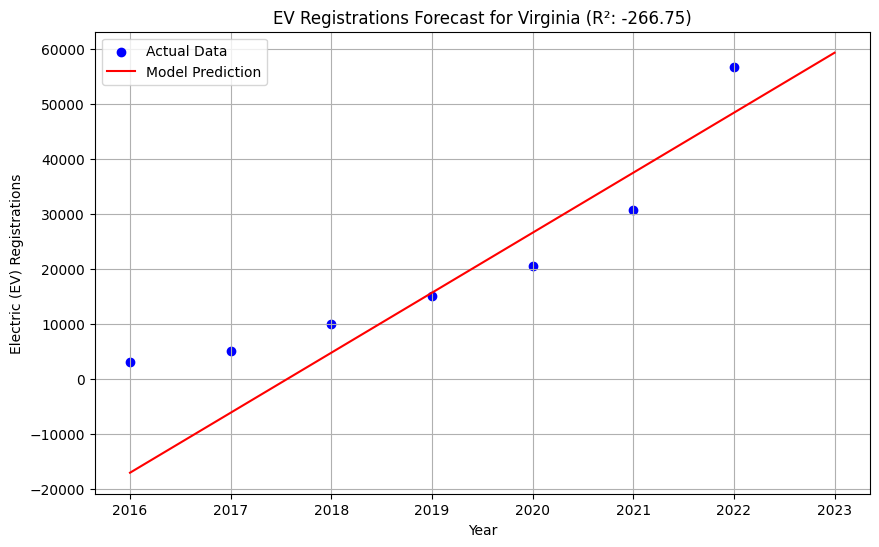

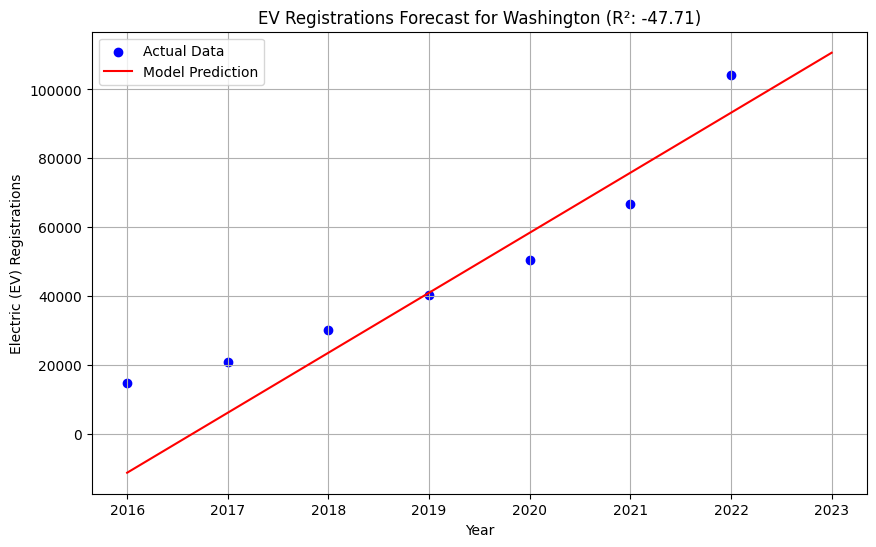

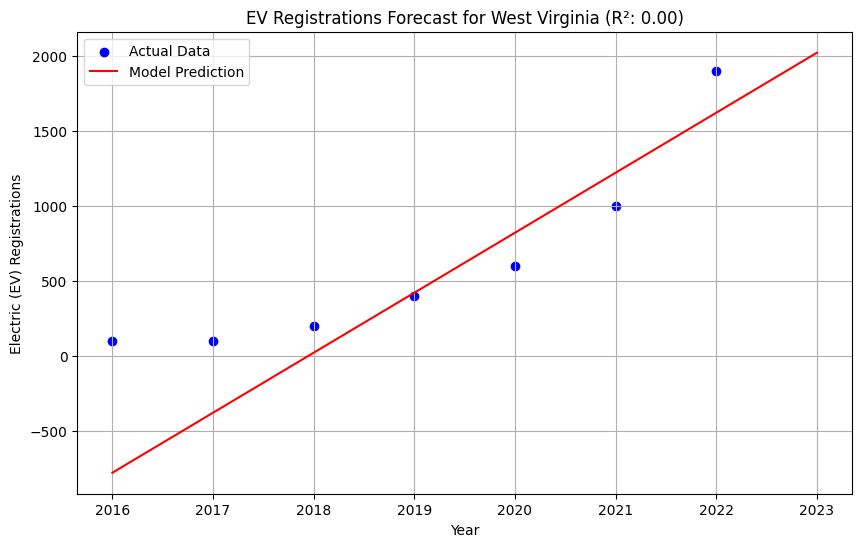

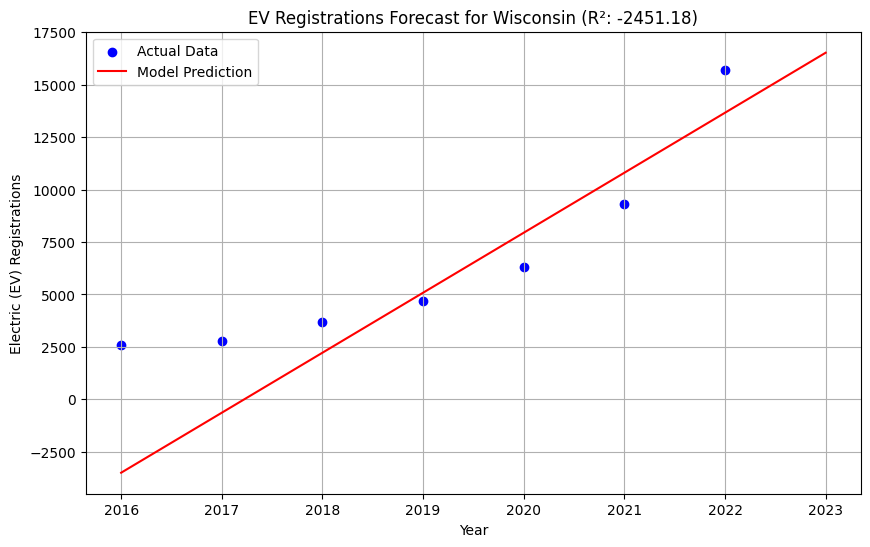

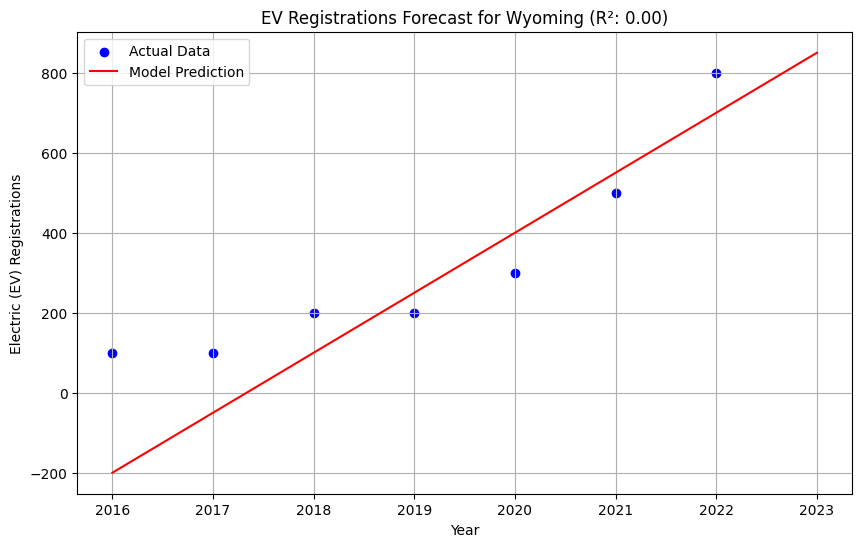

State: Alabama, R² Score: -384.63
State: Alaska, R² Score: -22.68
State: Arizona, R² Score: -203.64
State: Arkansas, R² Score: -1480.54
State: California, R² Score: -57.98
State: Colorado, R² Score: -139.18
State: Connecticut, R² Score: -124.88
State: Delaware, R² Score: -1232.70
State: District of Columbia, R² Score: -326.06
State: Florida, R² Score: -667.68
State: Georgia, R² Score: -161.89
State: Hawaii, R² Score: -44.19
State: Idaho, R² Score: -134.72
State: Illinois, R² Score: -220.14
State: Indiana, R² Score: -270.79
State: Iowa, R² Score: -358.58
State: Kansas, R² Score: -91.74
State: Kentucky, R² Score: -610.73
State: Louisiana, R² Score: -403.26
State: Maine, R² Score: -251.03
State: Maryland, R² Score: -457.10
State: Massachusetts, R² Score: -172.94
State: Michigan, R² Score: -718.42
State: Minnesota, R² Score: -288.49
State: Mississippi, R² Score: -297.24
State: Missouri, R² Score: -219.08
State: Montana, R² Score: -535.50
State: Nebraska, R² Score: -159.40
State: Nevada, R²

In [61]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

# Load your dataset
df = pd.read_csv("combined_data.csv")

# Convert 'Year' to numerical data
df['Year'] = pd.to_numeric(df['Year'])

# Assuming 'Year' and 'State' are your columns, and 'Electric (EV)' is the target
X = df[['Year', 'State']]
y = df['Electric (EV)']

# Preprocessing to handle categorical data (State)
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', ['Year']),
        ('cat', OneHotEncoder(), ['State'])
    ])

# Create a pipeline with a linear regressor
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# States to analyze
states = df['State'].unique()
state_scores = []

for state in states:
    # Filter data for the state
    state_data = df[df['State'] == state]
    X_state = state_data[['Year', 'State']]
    y_state = state_data['Electric (EV)']

    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_state, y_state, test_size=0.2, random_state=42)

    # Train the model on the training data
    model.fit(X_train, y_train)

    # Evaluate the model by predicting on the test data
    r_squared = model.score(X_test, y_test)
    state_scores.append((state, r_squared))

    # Predict for visualization
    all_years = np.arange(state_data['Year'].min(), state_data['Year'].max() + 2)  # Including next year for prediction
    state_df = pd.DataFrame({'Year': all_years, 'State': [state] * len(all_years)})
    predictions = model.predict(state_df)

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.scatter(state_data['Year'], state_data['Electric (EV)'], color='blue', label='Actual Data')
    plt.plot(all_years, predictions, color='red', label='Model Prediction')
    plt.title(f'EV Registrations Forecast for {state} (R²: {r_squared:.2f})')
    plt.xlabel('Year')
    plt.ylabel('Electric (EV) Registrations')
    plt.legend()
    plt.grid(True)
    plt.show()

# Print out R² scores for all states
for state, score in state_scores:
    print(f'State: {state}, R² Score: {score:.2f}')


In [63]:
print(df.columns)


Index(['State', 'Electric (EV)', 'Plug-In Hybrid Electric (PHEV)',
       'Hybrid Electric (HEV)', 'Biodiesel', 'Ethanol/Flex (E85)',
       'Compressed Natural Gas (CNG)', 'Hydrogen', 'Gasoline', 'Diesel',
       'Unknown Fuel', 'Year'],
      dtype='object')


ADF Statistic: 5.277690459316344
p-value: 1.0
Best ARIMA(1, 3, 1) AIC: 80.55230260021789, BIC: 77.84813946622222


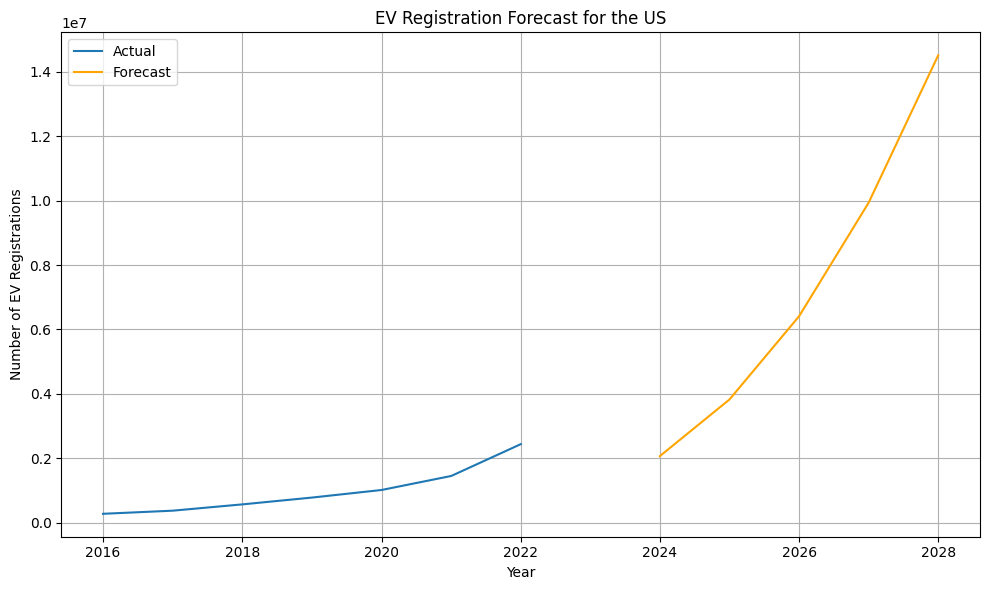

In [24]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
import itertools
import warnings
warnings.filterwarnings('ignore')
from statsmodels.tsa.stattools import adfuller

# Load dataset
df = pd.read_csv('combined_data.csv', parse_dates=['Year'], index_col='Year')

# Aggregate the data for the entire US
us_data = df.groupby(df.index)['Electric (EV)'].sum()

# Perform ADF test
result = adfuller(us_data)
print('ADF Statistic:', result[0])
print('p-value:', result[1])

# If p-value > 0.05, the series is not stationary
if result[1] > 0.05:
    us_data_diff = us_data.diff().dropna()
else:
    us_data_diff = us_data

# Define the p, d and q parameters to take any value between 0 and 3
p = d = q = range(0, 4)

# Generate all different combinations of p, d and q triplets
pdq = list(itertools.product(p, d, q))

# Grid search for best parameters
best_aic = np.inf
best_bic = np.inf
best_order = None
best_mdl = None

for param in pdq:
    try:
        temp_mdl = ARIMA(us_data_diff, order=param).fit()
        if temp_mdl.aic < best_aic and temp_mdl.bic < best_bic:
            best_aic = temp_mdl.aic
            best_bic = temp_mdl.bic
            best_order = param
            best_mdl = temp_mdl
    except Exception as e:
        continue

print(f'Best ARIMA{best_order} AIC: {best_aic}, BIC: {best_bic}')

# Forecast with the best model
forecast_steps = 5
forecast = best_mdl.forecast(steps=forecast_steps)

# Generate forecast index
forecast_index = pd.date_range(start=us_data.index[-1], periods=forecast_steps + 1, freq='A')[1:]

# Plot the data and the forecast
plt.figure(figsize=(10, 6))
plt.plot(us_data.index, us_data, label='Actual')
plt.plot(forecast_index, forecast, label='Forecast', color='orange')
plt.title('EV Registration Forecast for the US')
plt.xlabel('Year')
plt.ylabel('Number of EV Registrations')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


State: Alabama, Best ARIMA(3, 1, 2) AIC: 12.0, BIC: 9.656627474604601
State: Alaska, Best ARIMA(3, 3, 1) AIC: 32.40876227663021, BIC: 27.901823719970764
State: Arizona, Best ARIMA(2, 3, 0) AIC: 6.0, BIC: 3.295836866004329
State: Arkansas, Best ARIMA(3, 3, 0) AIC: 8.0, BIC: 4.394449154672439
State: California, Best ARIMA(2, 3, 2) AIC: 10.0, BIC: 5.493061443340549
State: Colorado, Best ARIMA(0, 3, 0) AIC: 63.929877989543854, BIC: 63.02849027821196
State: Connecticut, Best ARIMA(2, 3, 0) AIC: 6.0, BIC: 3.295836866004329
State: Delaware, Best ARIMA(2, 3, 0) AIC: 33.58613746149579, BIC: 30.881974327500117
State: District of Columbia, Best ARIMA(3, 3, 0) AIC: 8.0, BIC: 4.394449154672439
State: Florida, Best ARIMA(3, 1, 2) AIC: 12.0, BIC: 9.656627474604601
State: Georgia, Best ARIMA(0, 3, 0) AIC: 60.89673275826334, BIC: 59.99534504693145
State: Hawaii, Best ARIMA(1, 3, 0) AIC: 54.95364405611646, BIC: 53.15086863345268
State: Idaho, Best ARIMA(1, 3, 0) AIC: 4.0, BIC: 2.1972245773362196
State: 

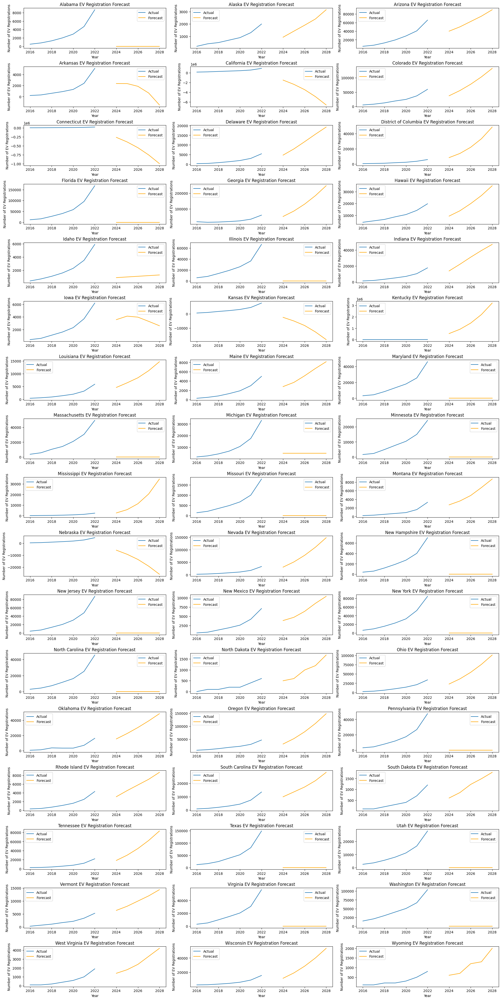

In [25]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
import itertools
import warnings
warnings.filterwarnings('ignore')
from statsmodels.tsa.stattools import adfuller

# Load dataset
df = pd.read_csv('combined_data.csv', parse_dates=['Year'], index_col='Year')

# List of all states
states = df['State'].unique()

# Initialize subplots
num_states = len(states)
num_cols = 3
num_rows = num_states // num_cols + (num_states % num_cols > 0)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 40), constrained_layout=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for idx, state in enumerate(states):
    state_data = df[df['State'] == state]['Electric (EV)']

    # Perform ADF test
    result = adfuller(state_data)
    # If p-value > 0.05, the series is not stationary
    if result[1] > 0.05:
        state_data_diff = state_data.diff().dropna()
    else:
        state_data_diff = state_data

    # Define the p, d and q parameters to take any value between 0 and 3
    p = d = q = range(0, 4)

    # Generate all different combinations of p, d and q triplets
    pdq = list(itertools.product(p, d, q))

    # Grid search for best parameters
    best_aic = np.inf
    best_bic = np.inf
    best_order = None
    best_mdl = None

    for param in pdq:
        try:
            temp_mdl = ARIMA(state_data_diff, order=param).fit()
            if temp_mdl.aic < best_aic and temp_mdl.bic < best_bic:
                best_aic = temp_mdl.aic
                best_bic = temp_mdl.bic
                best_order = param
                best_mdl = temp_mdl
        except Exception as e:
            continue

    print(f'State: {state}, Best ARIMA{best_order} AIC: {best_aic}, BIC: {best_bic}')

    # Forecast with the best model
    forecast_steps = 5
    forecast = best_mdl.forecast(steps=forecast_steps)

    # Generate forecast index
    forecast_index = pd.date_range(start=state_data.index[-1], periods=forecast_steps + 1, freq='A')[1:]

    # Plot the data and the forecast
    ax = axes[idx]
    ax.plot(state_data.index, state_data, label='Actual')
    ax.plot(forecast_index, forecast, label='Forecast', color='orange')
    ax.set_title(f'{state} EV Registration Forecast')
    ax.set_xlabel('Year')
    ax.set_ylabel('Number of EV Registrations')
    ax.legend()

# Remove any unused subplots
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

plt.show()


State: Alabama, Best ARIMA(3, 1, 2) AIC: 12.0, BIC: 9.656627474604601
State: Alaska, Best ARIMA(3, 3, 1) AIC: 32.40876227663021, BIC: 27.901823719970764
State: Arizona, Best ARIMA(2, 3, 0) AIC: 6.0, BIC: 3.295836866004329
State: Arkansas, Best ARIMA(3, 3, 0) AIC: 8.0, BIC: 4.394449154672439
State: California, Best ARIMA(2, 3, 2) AIC: 10.0, BIC: 5.493061443340549
State: Colorado, Best ARIMA(0, 3, 0) AIC: 63.929877989543854, BIC: 63.02849027821196
State: Connecticut, Best ARIMA(2, 3, 0) AIC: 6.0, BIC: 3.295836866004329
State: Delaware, Best ARIMA(2, 3, 0) AIC: 33.58613746149579, BIC: 30.881974327500117
State: District of Columbia, Best ARIMA(3, 3, 0) AIC: 8.0, BIC: 4.394449154672439
State: Florida, Best ARIMA(3, 1, 2) AIC: 12.0, BIC: 9.656627474604601
State: Georgia, Best ARIMA(0, 3, 0) AIC: 60.89673275826334, BIC: 59.99534504693145
State: Hawaii, Best ARIMA(1, 3, 0) AIC: 54.95364405611646, BIC: 53.15086863345268
State: Idaho, Best ARIMA(1, 3, 0) AIC: 4.0, BIC: 2.1972245773362196
State: 

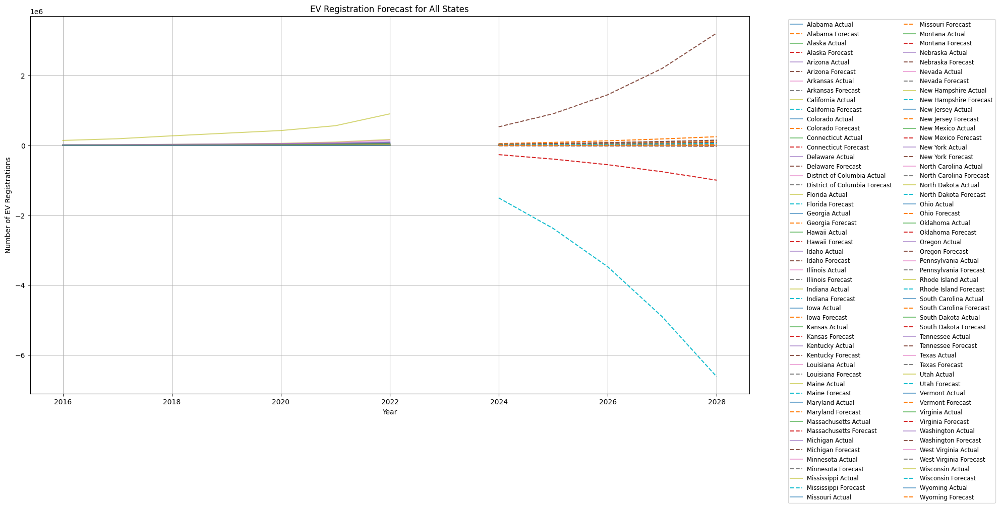

In [26]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
import itertools
import warnings
warnings.filterwarnings('ignore')
from statsmodels.tsa.stattools import adfuller

# Load dataset
df = pd.read_csv('combined_data.csv', parse_dates=['Year'], index_col='Year')

# List of all states
states = df['State'].unique()

plt.figure(figsize=(20, 10))

for state in states:
    state_data = df[df['State'] == state]['Electric (EV)']

    # Perform ADF test
    result = adfuller(state_data)
    # If p-value > 0.05, the series is not stationary
    if result[1] > 0.05:
        state_data_diff = state_data.diff().dropna()
    else:
        state_data_diff = state_data

    # Define the p, d and q parameters to take any value between 0 and 3
    p = d = q = range(0, 4)

    # Generate all different combinations of p, d and q triplets
    pdq = list(itertools.product(p, d, q))

    # Grid search for best parameters
    best_aic = np.inf
    best_bic = np.inf
    best_order = None
    best_mdl = None

    for param in pdq:
        try:
            temp_mdl = ARIMA(state_data_diff, order=param).fit()
            if temp_mdl.aic < best_aic and temp_mdl.bic < best_bic:
                best_aic = temp_mdl.aic
                best_bic = temp_mdl.bic
                best_order = param
                best_mdl = temp_mdl
        except Exception as e:
            continue

    print(f'State: {state}, Best ARIMA{best_order} AIC: {best_aic}, BIC: {best_bic}')

    # Forecast with the best model
    forecast_steps = 5
    forecast = best_mdl.forecast(steps=forecast_steps)

    # Generate forecast index
    forecast_index = pd.date_range(start=state_data.index[-1], periods=forecast_steps + 1, freq='A')[1:]

    # Plot the data and the forecast
    plt.plot(state_data.index, state_data, label=f'{state} Actual', alpha=0.6)
    plt.plot(forecast_index, forecast, label=f'{state} Forecast', linestyle='--')

plt.title('EV Registration Forecast for All States')
plt.xlabel('Year')
plt.ylabel('Number of EV Registrations')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small', ncol=2)
plt.grid(True)
plt.tight_layout()
plt.show()


In [5]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Load dataset
df = pd.read_csv('combined_data.csv', parse_dates=['Year'], index_col='Year')

# Example for one state
state_data = df[df['State'] == 'California']['Electric (EV)']

# Check stationarity and make the series stationary if necessary
# Here we assume the series is already stationary for demonstration

# Fit an ARIMA model
model = ARIMA(state_data, order=(1,1,1))  # these orders are usually determined after analysis
fitted_model = model.fit()
print(model.score)
# Forecast
forecast = fitted_model.forecast(steps=5)  # Forecasting next 5 periods

# Plot the data and the forecast
plt.figure(figsize=(10, 6))
plt.plot(state_data.index, state_data, label='Actual')
plt.plot(forecast.index, forecast, label='Forecast')
plt.title('EV Registration Forecast')
plt.xlabel('Year')
plt.ylabel('Number of EV Registrations')
plt.legend()
plt.show()


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

TypeError: MLEModel.score() missing 1 required positional argument: 'params'

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

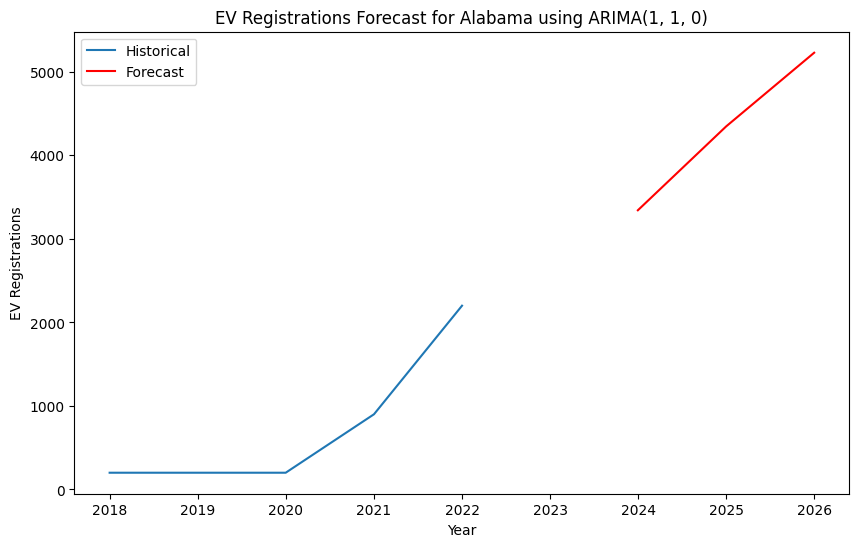

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

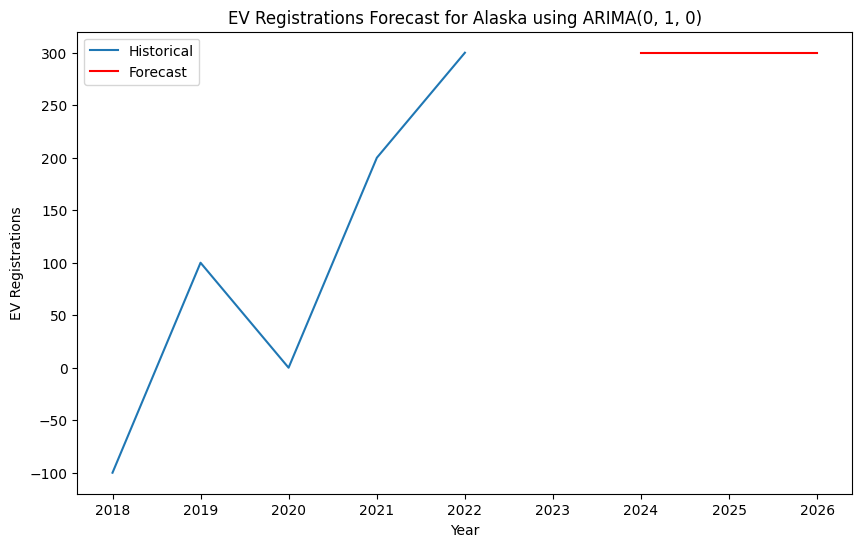

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

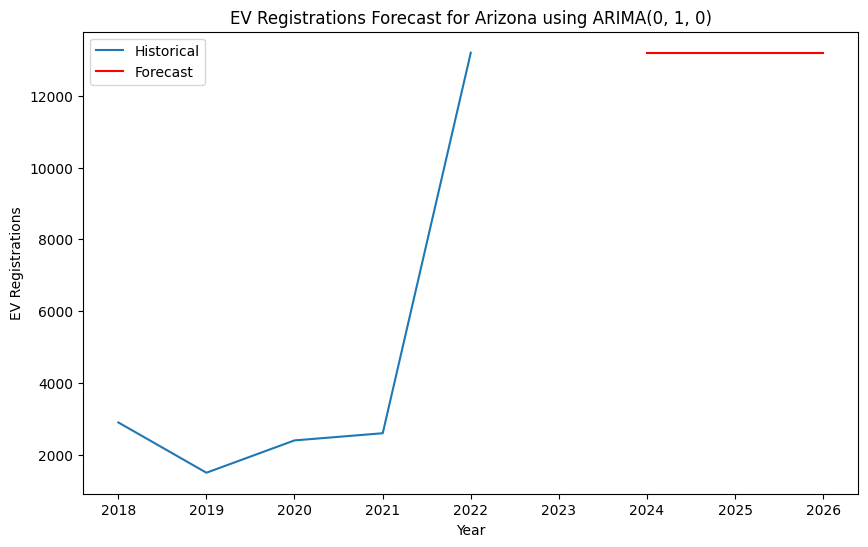

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

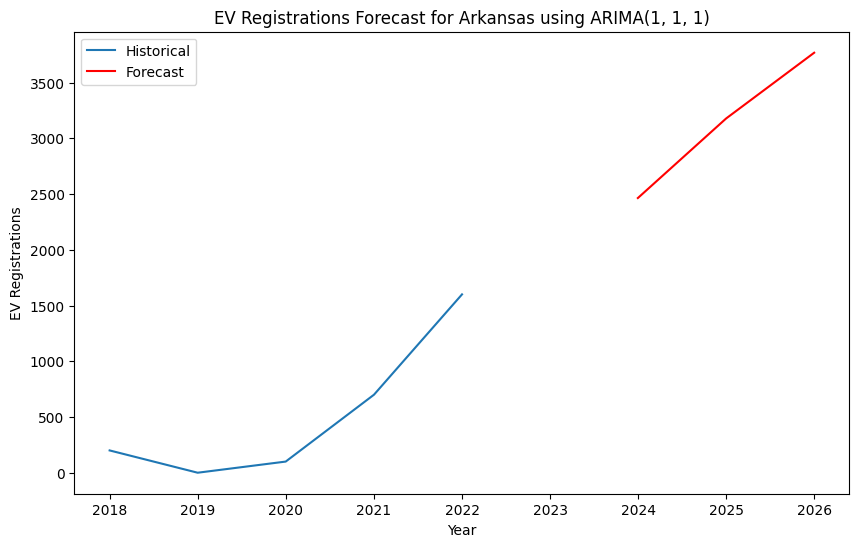

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

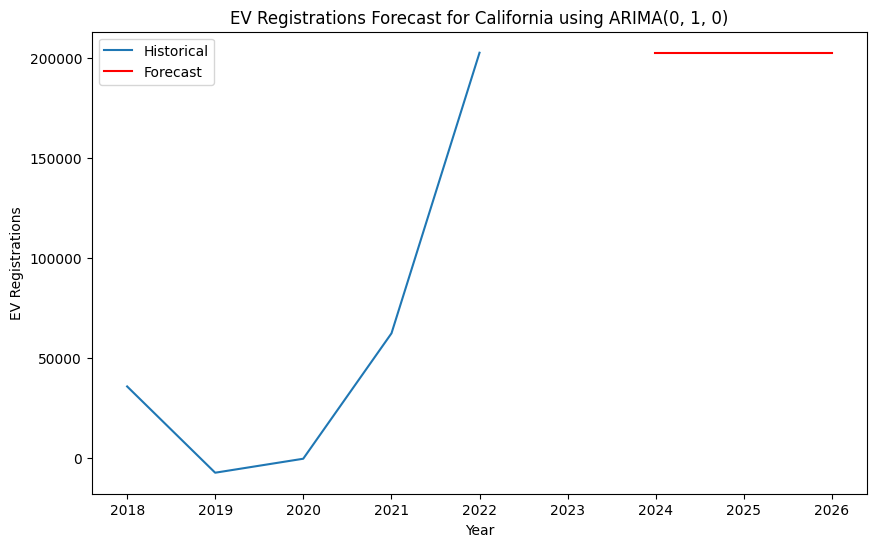

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

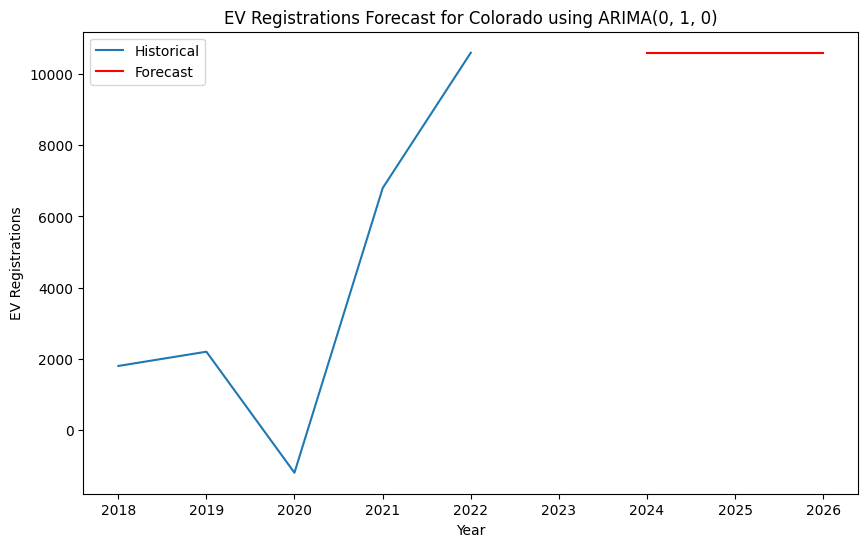

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

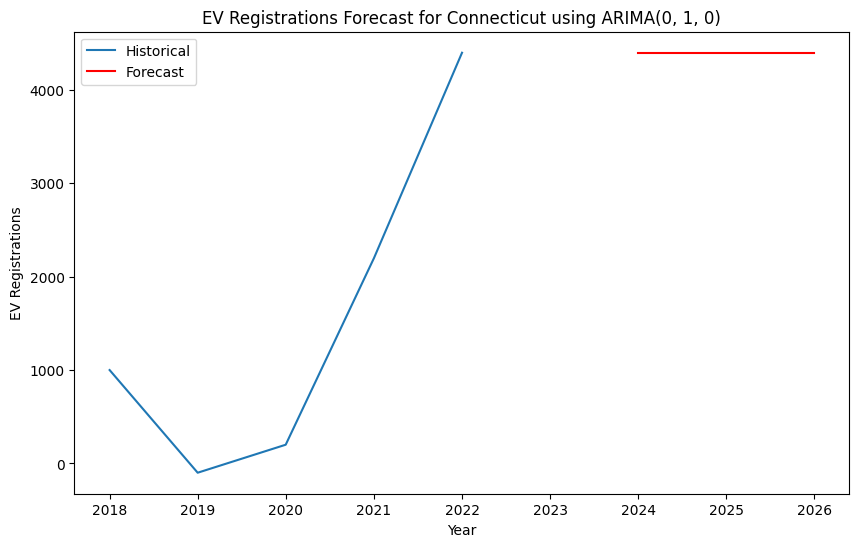

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

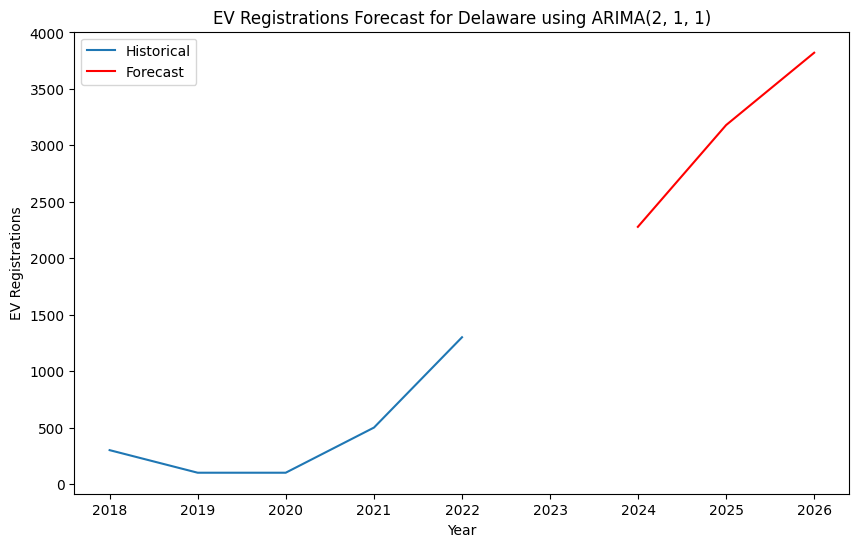

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

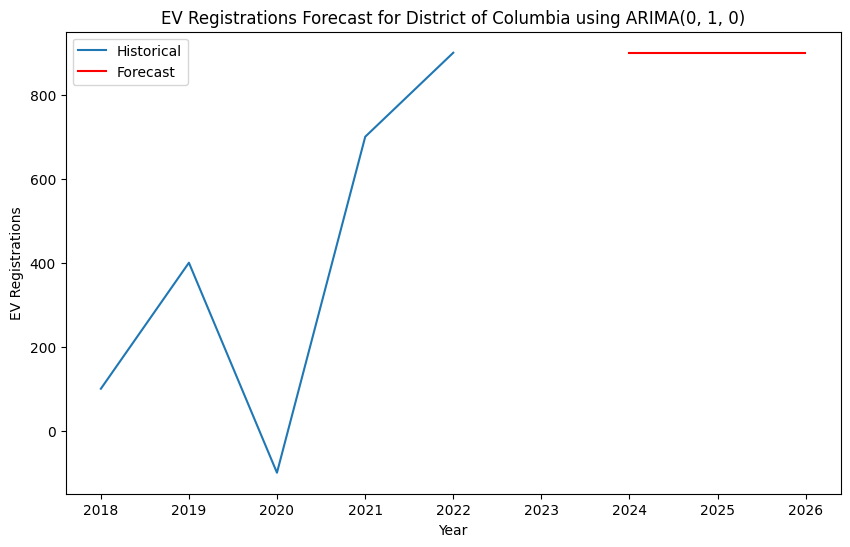

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

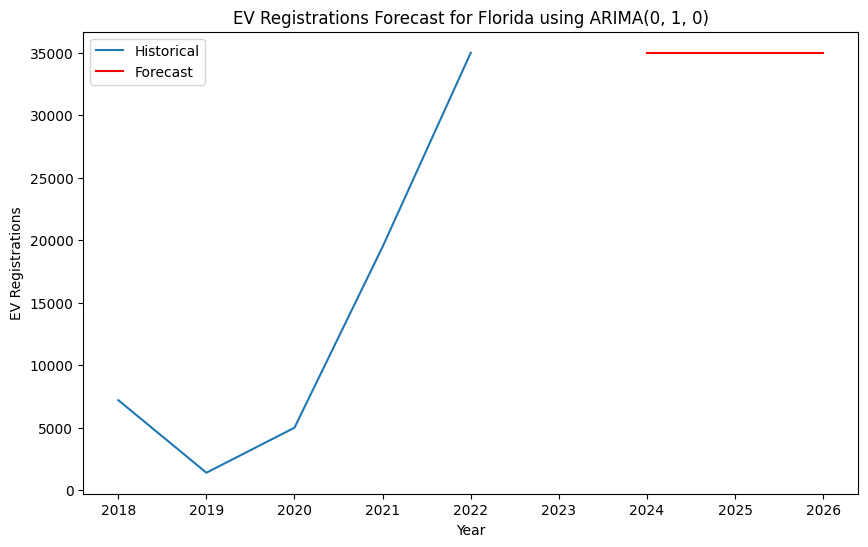

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

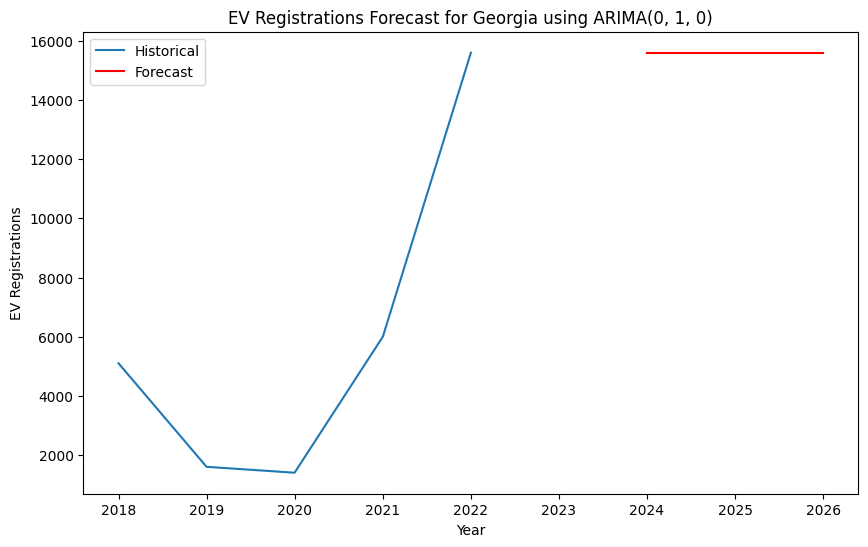

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

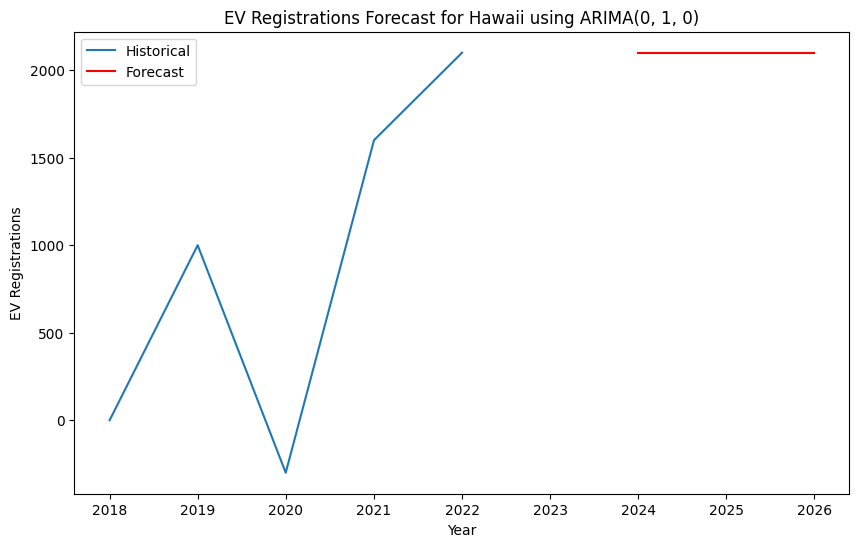

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

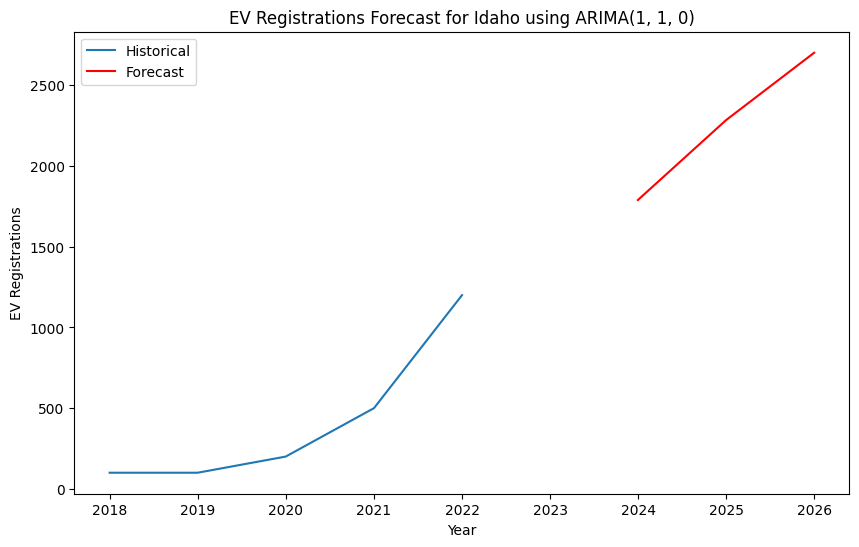

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

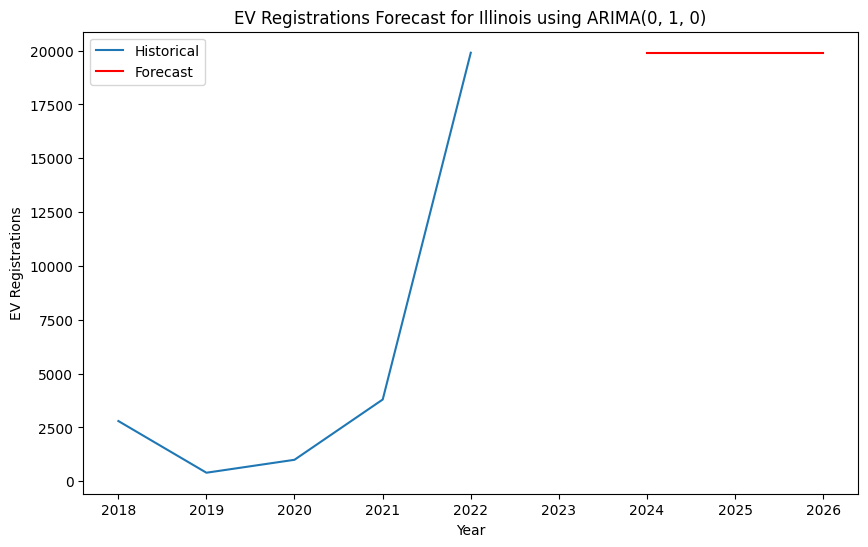

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

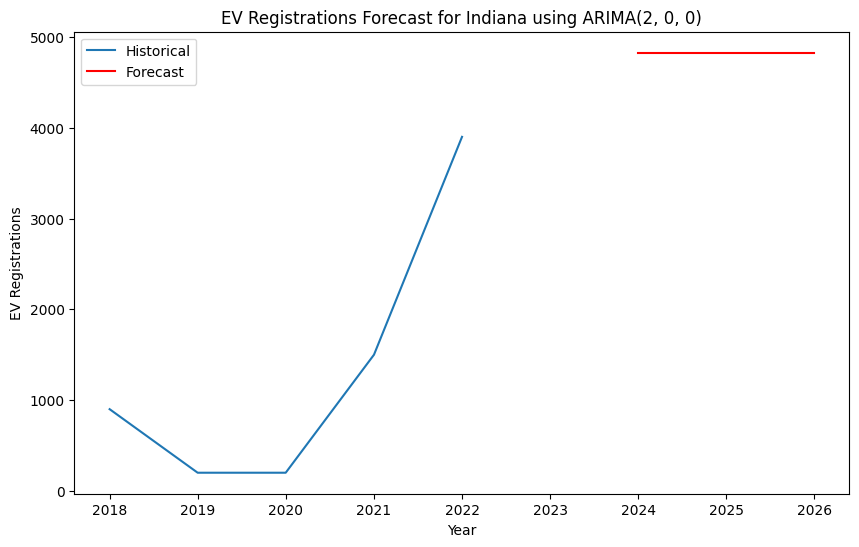

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

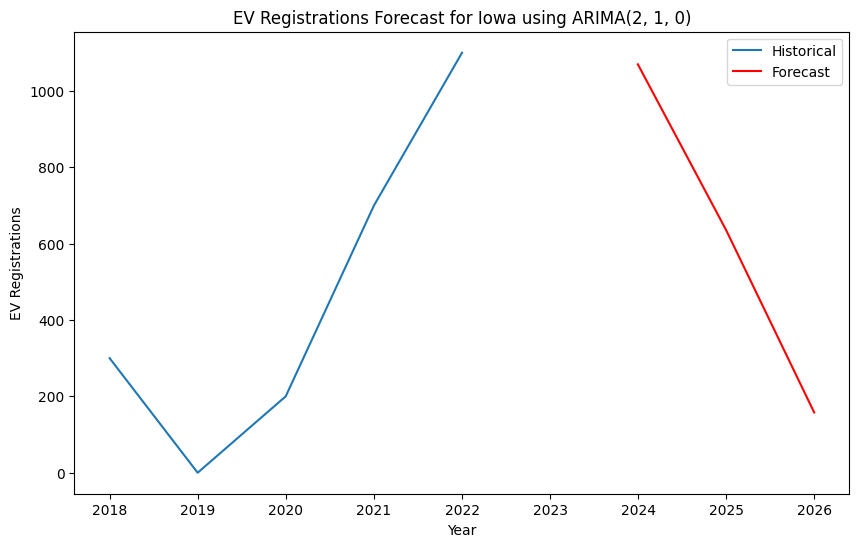

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

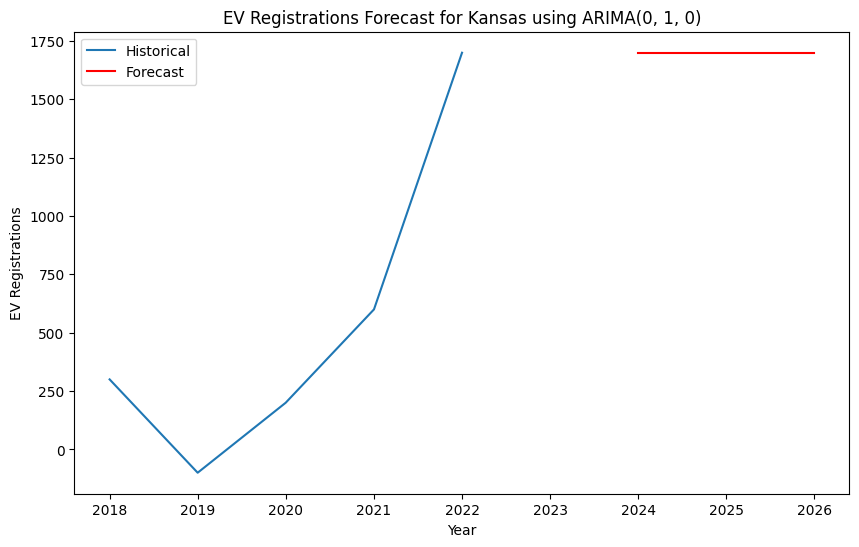

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

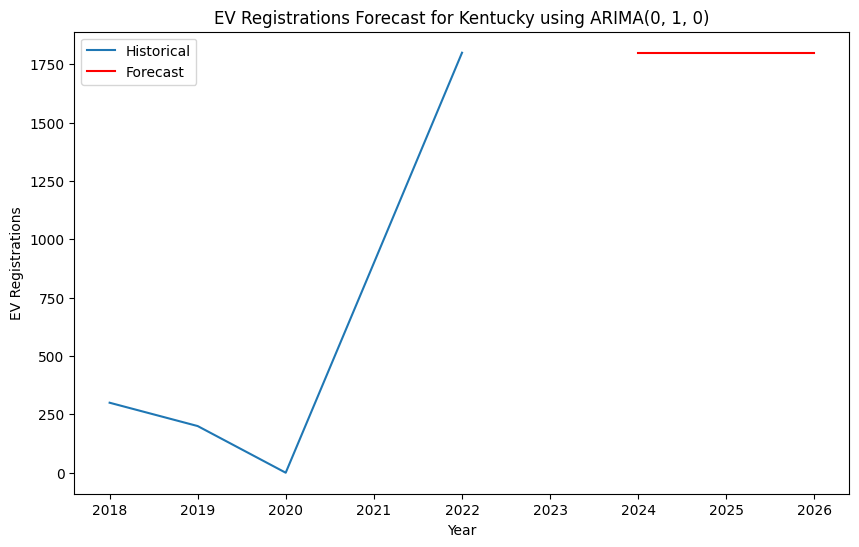

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

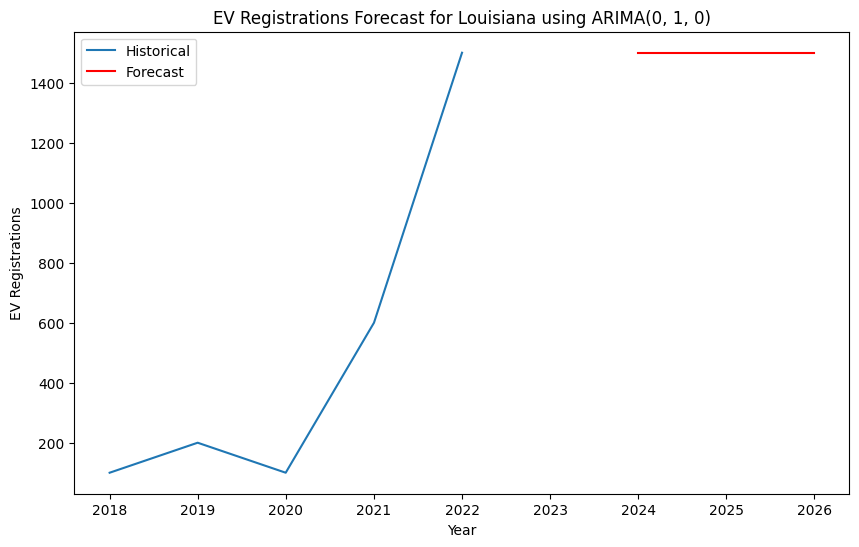

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

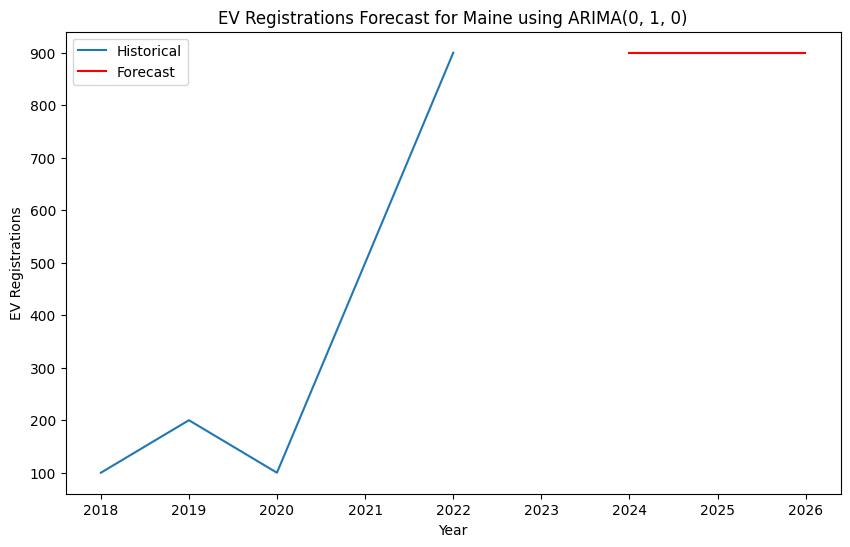

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

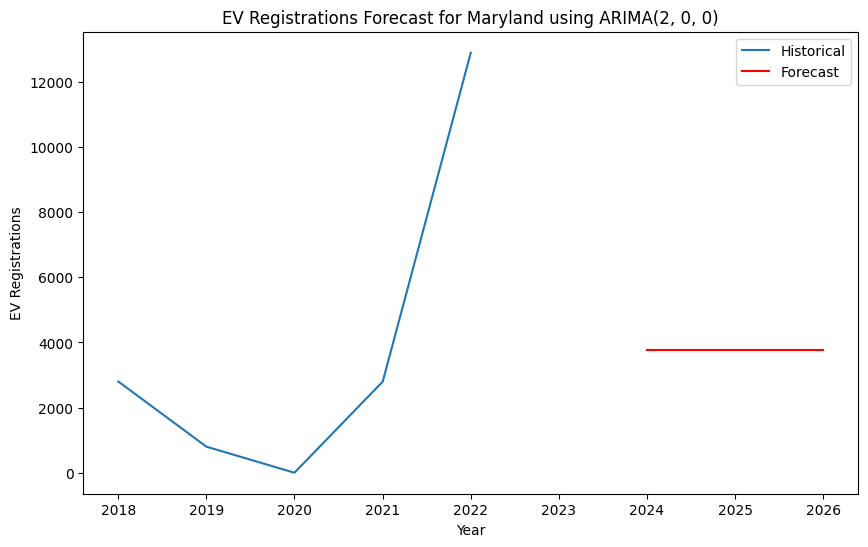

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

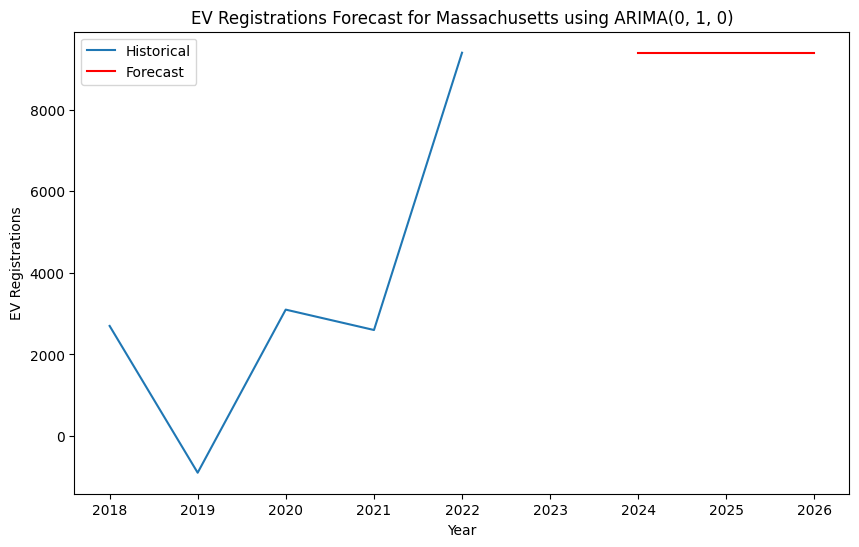

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

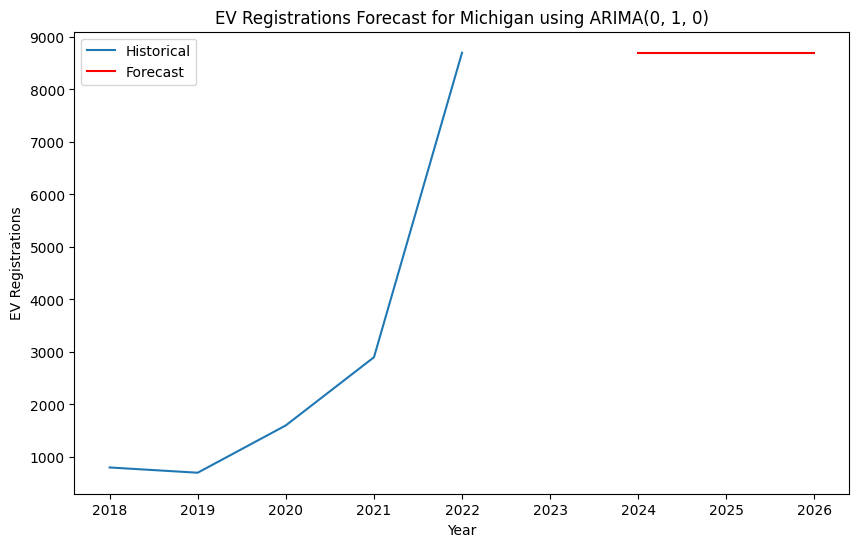

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

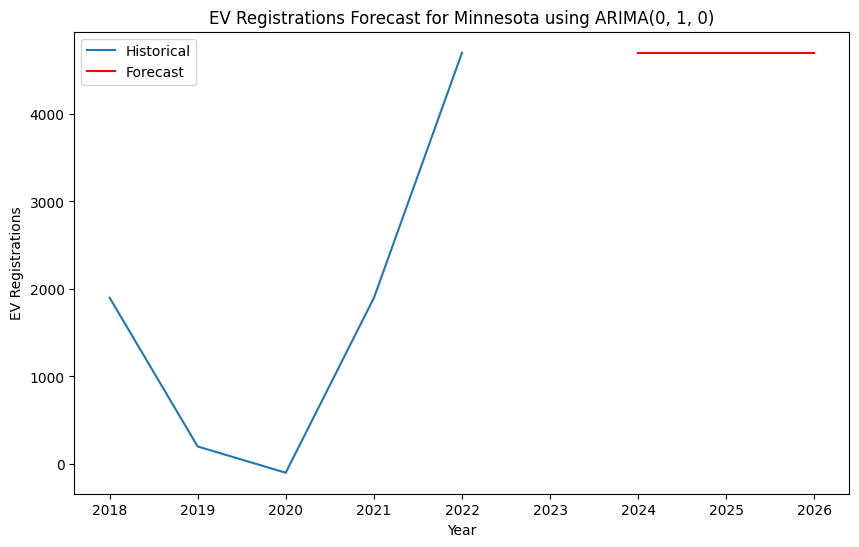

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

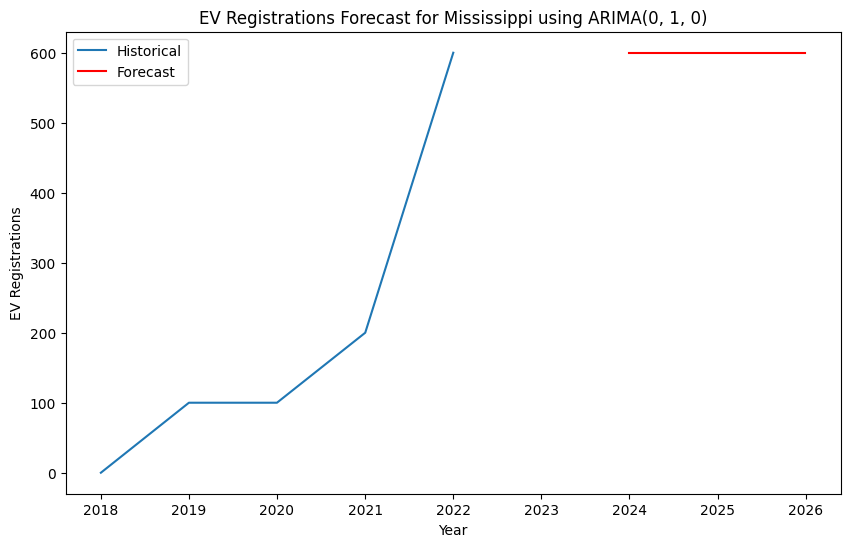

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

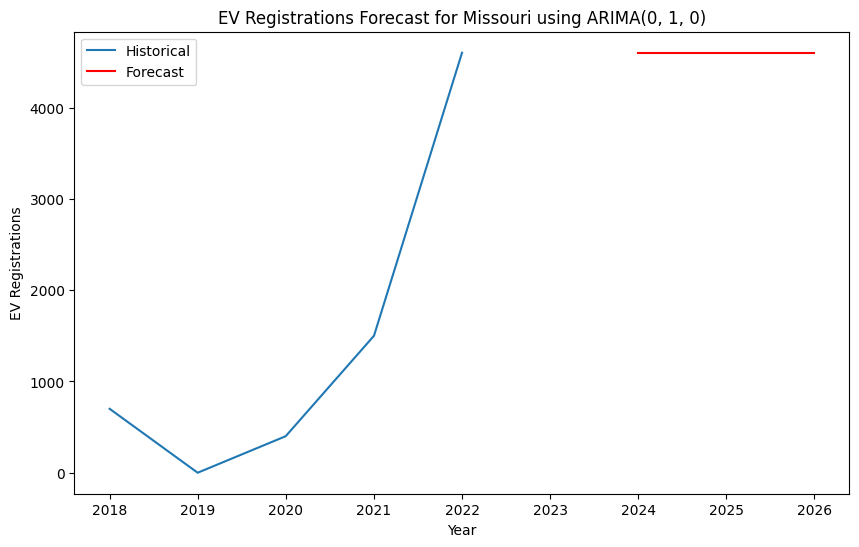

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

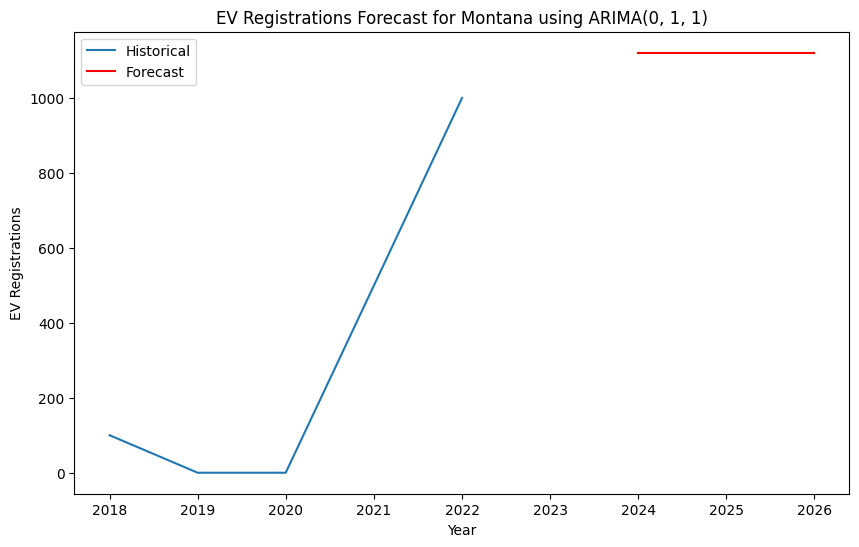

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

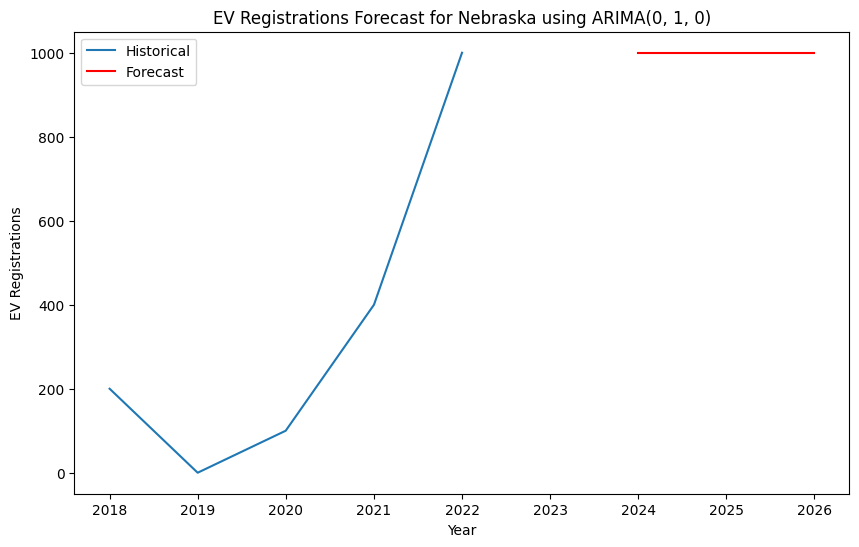

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

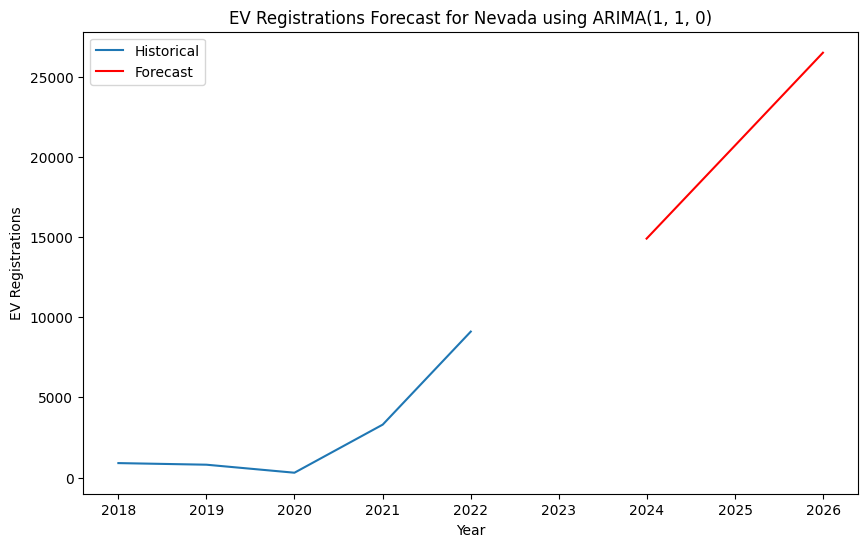

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

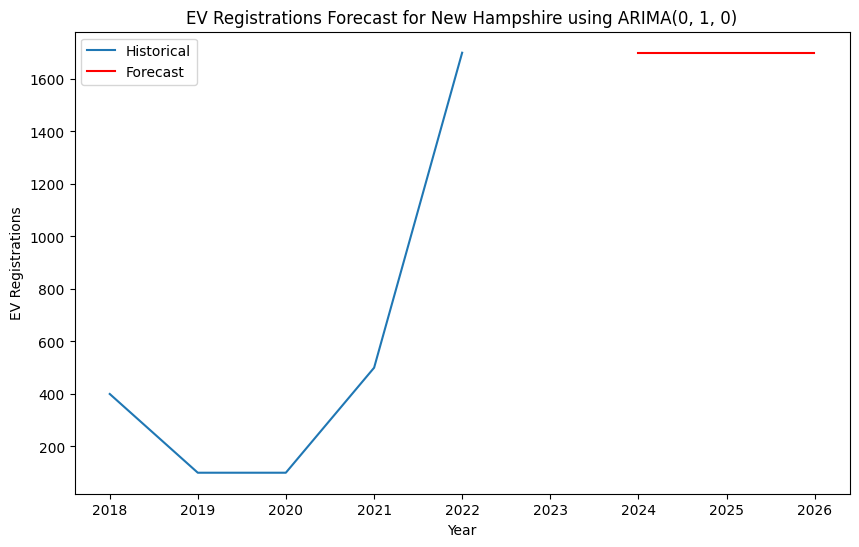

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

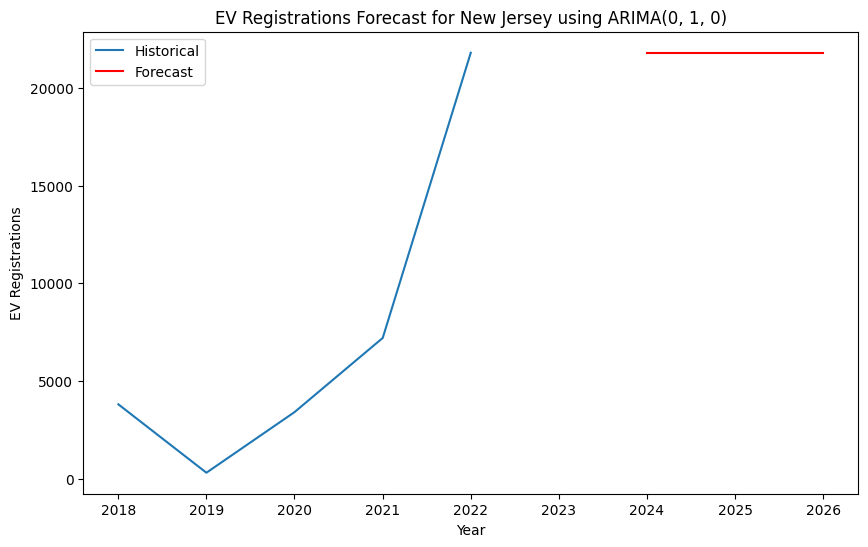

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

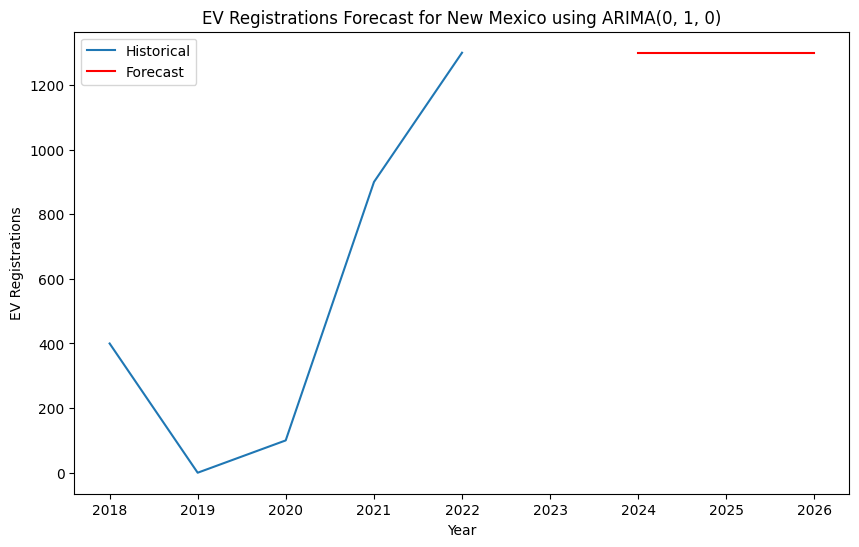

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

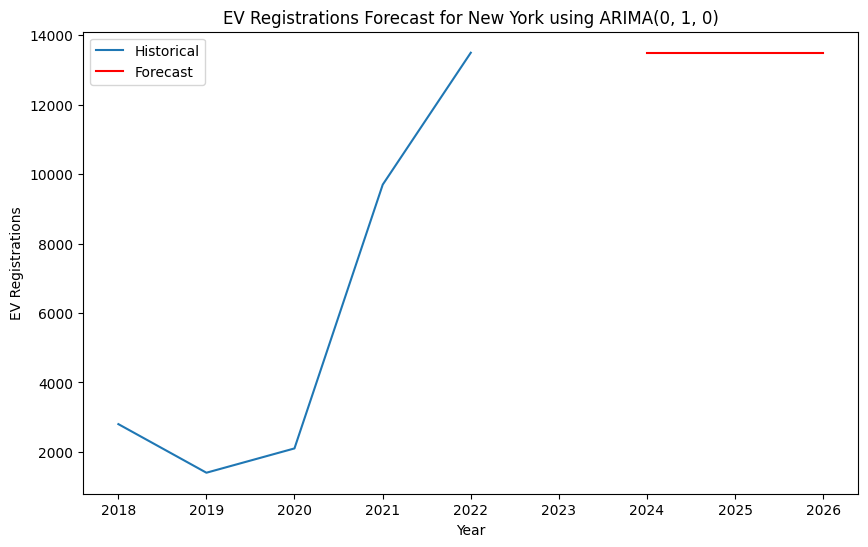

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

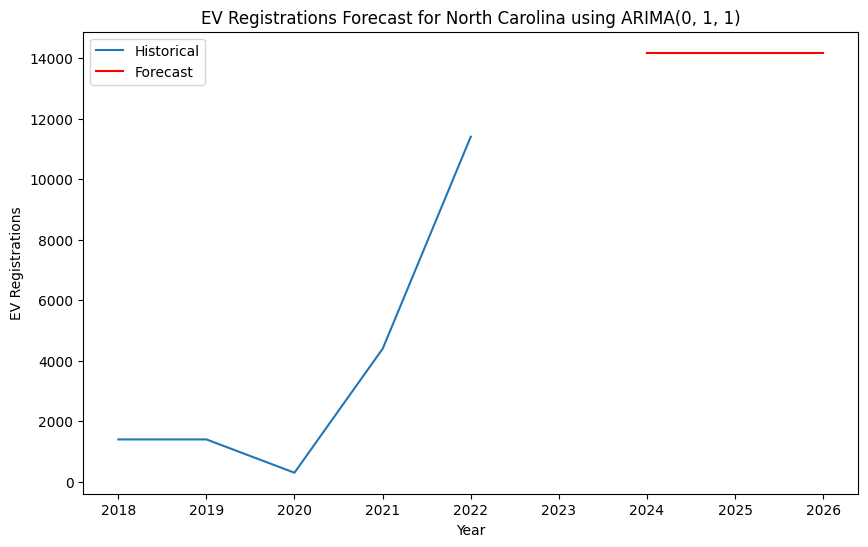

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

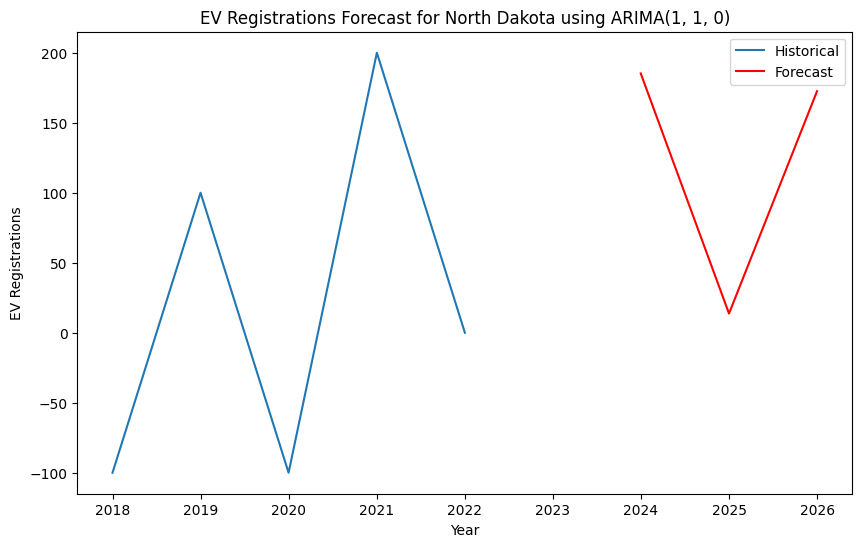

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

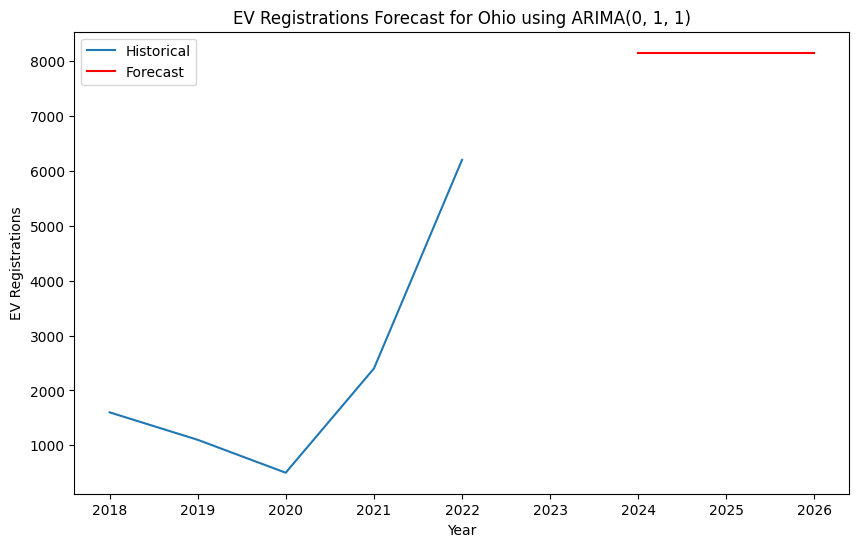

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

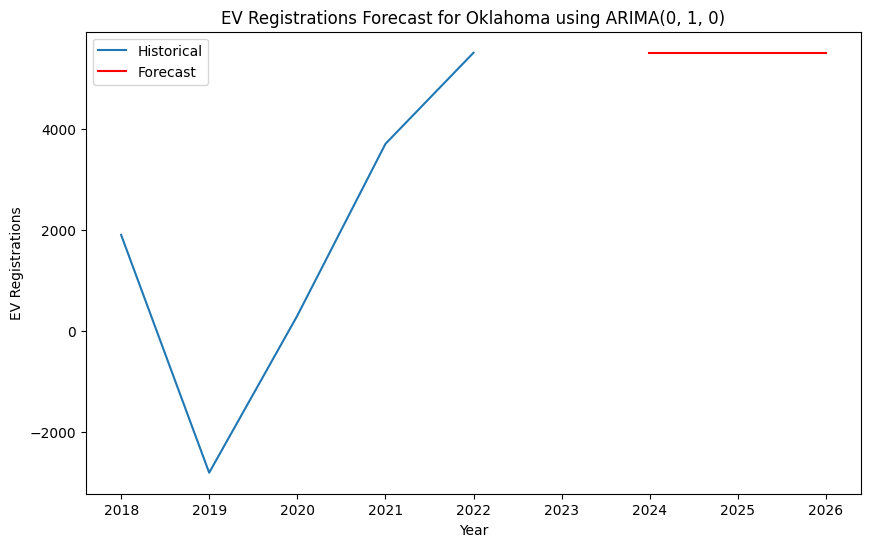

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

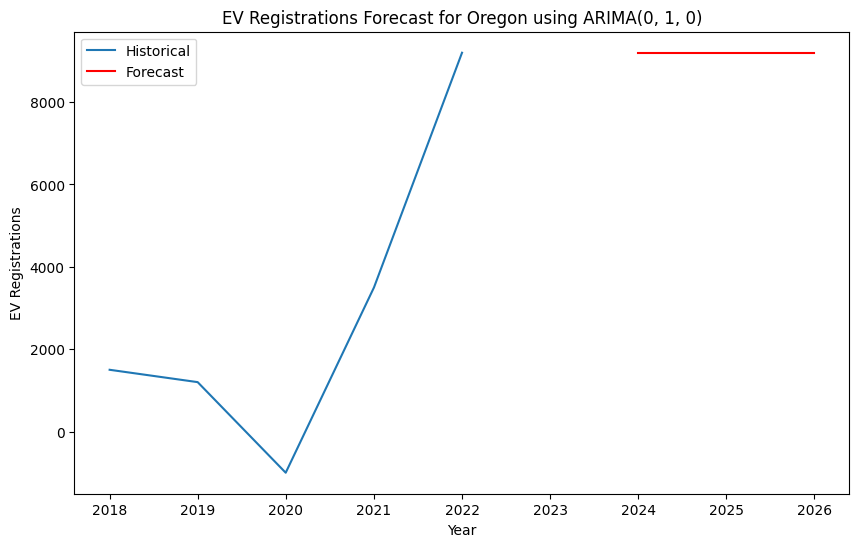

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

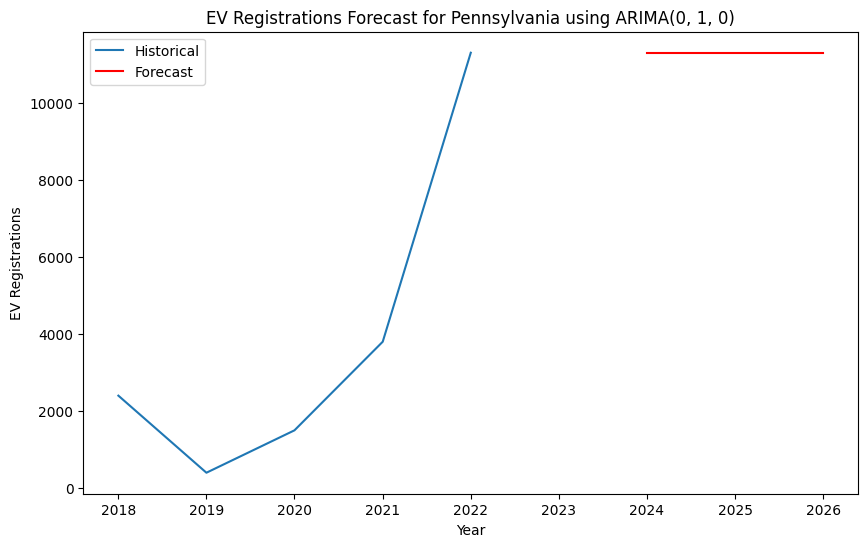

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

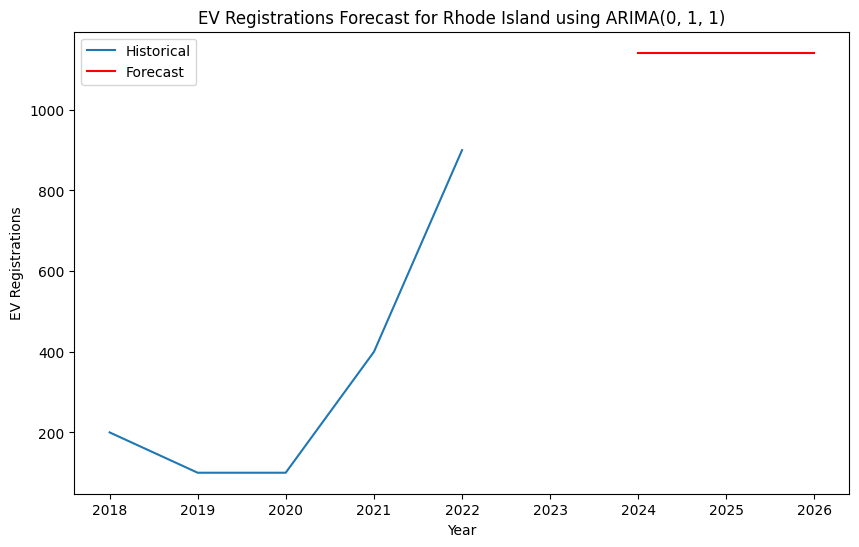

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

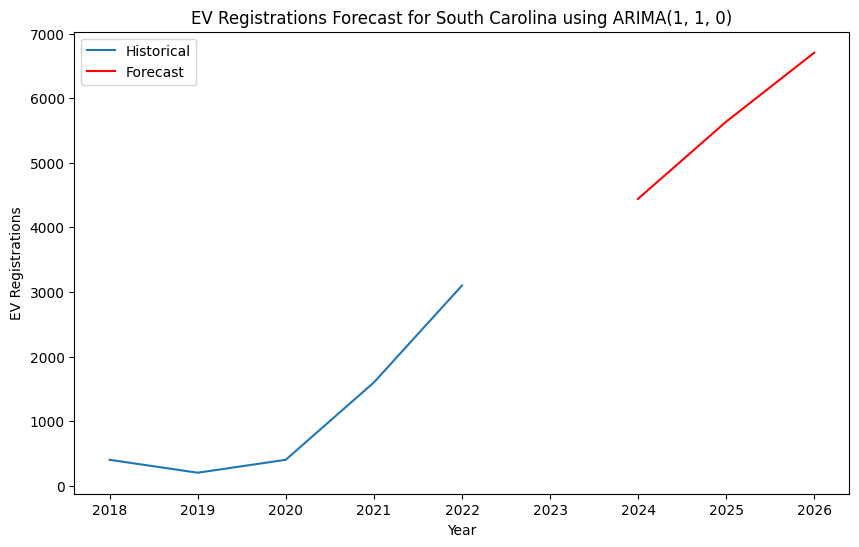

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

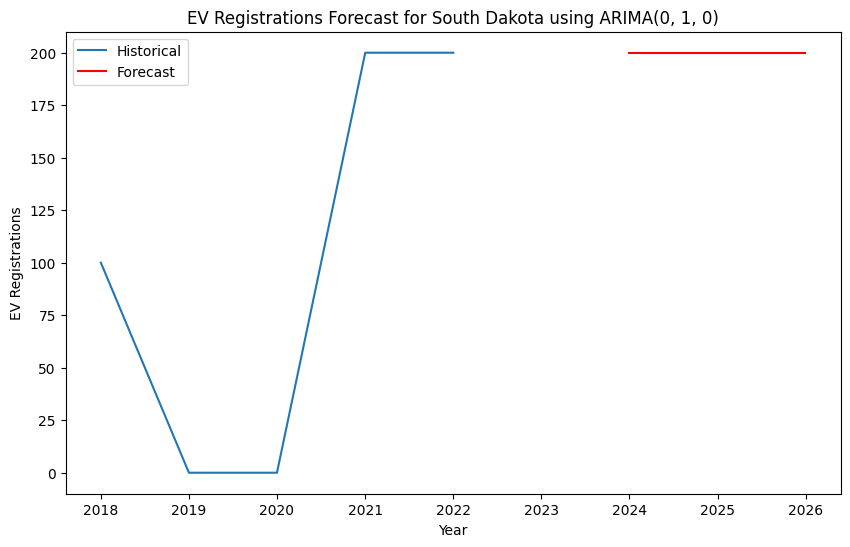

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

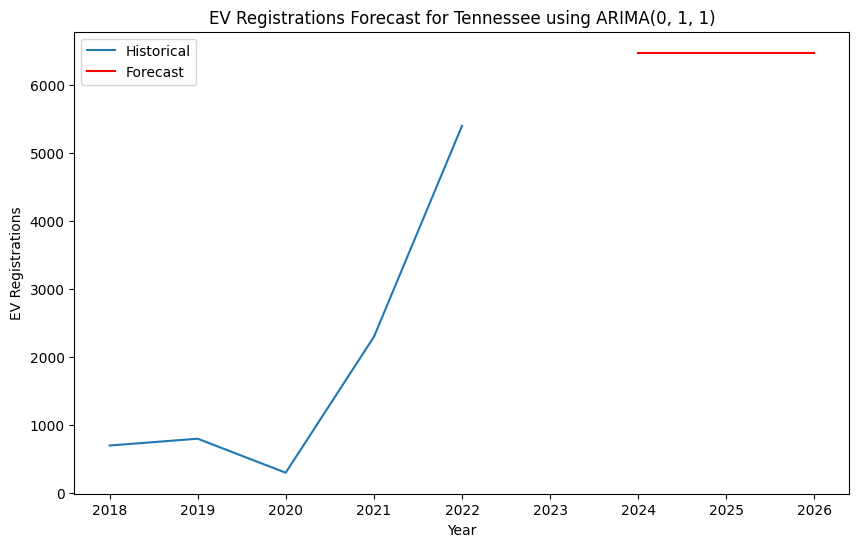

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

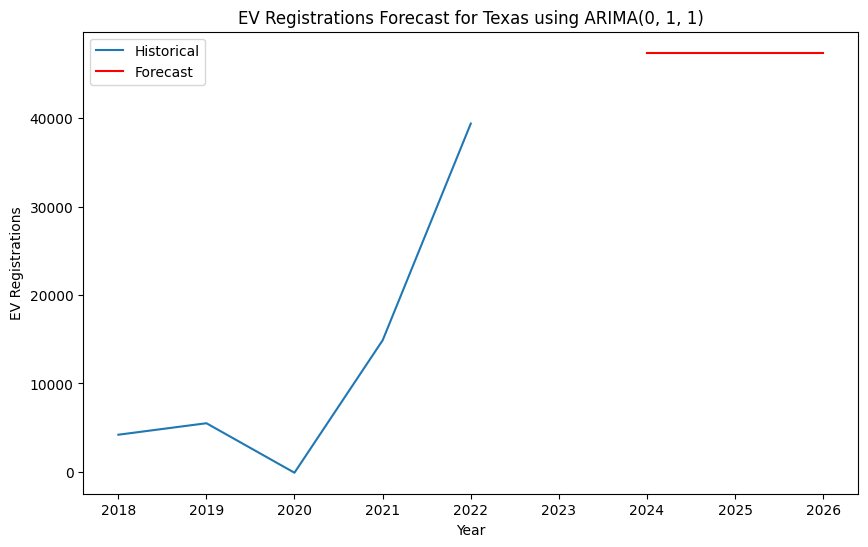

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

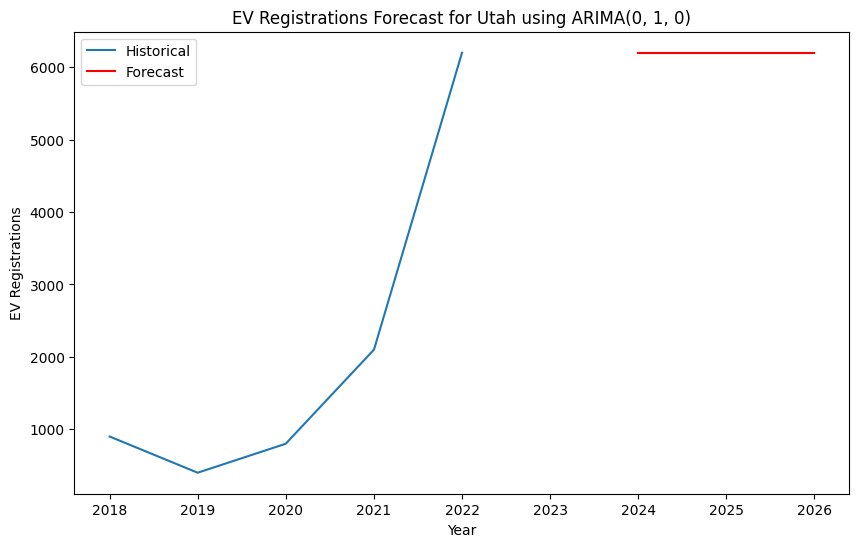

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

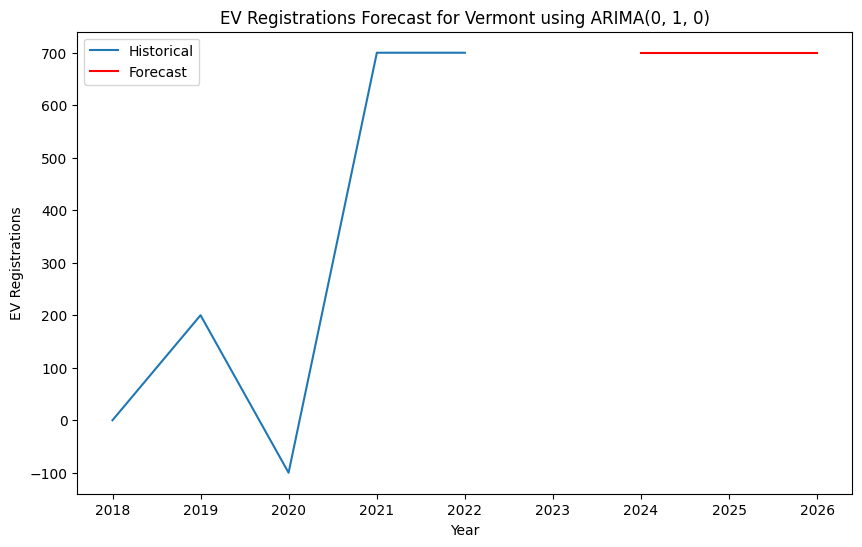

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

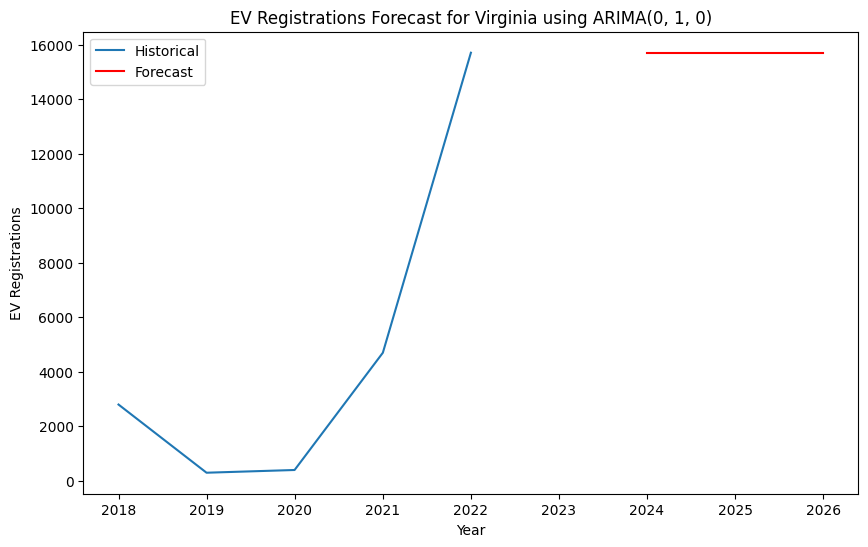

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

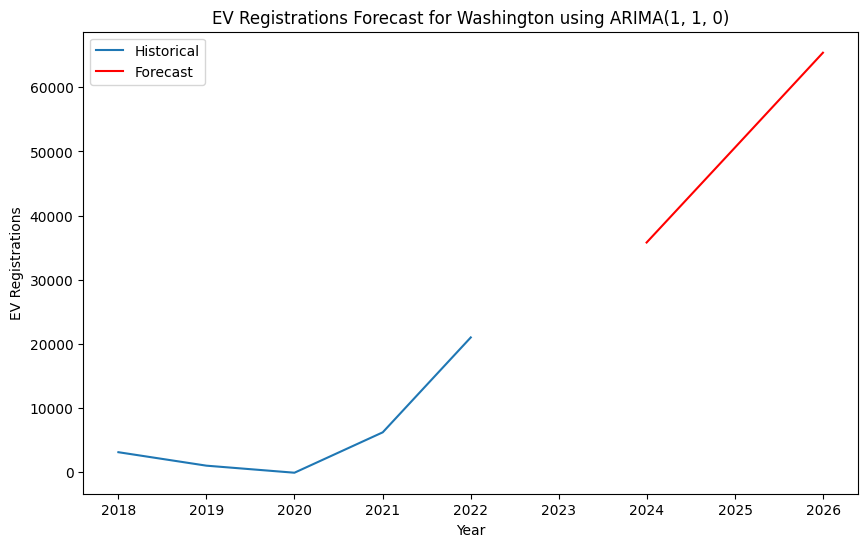

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

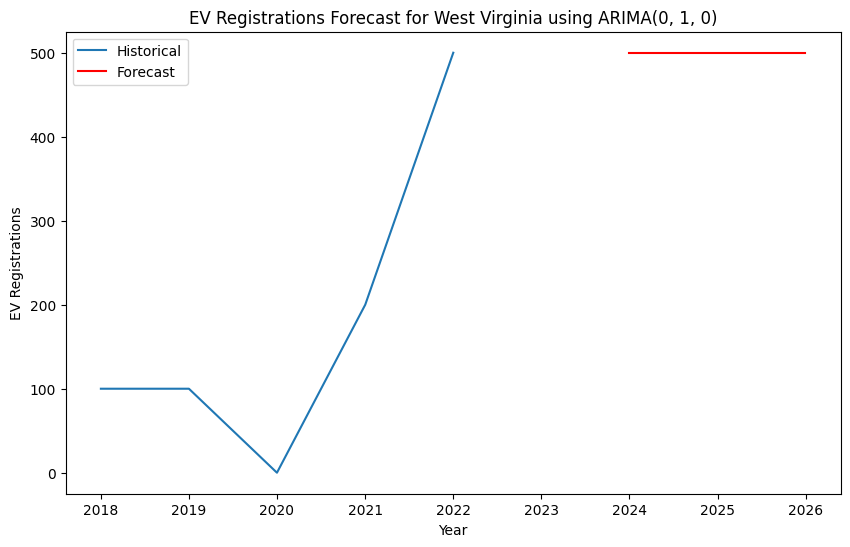

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

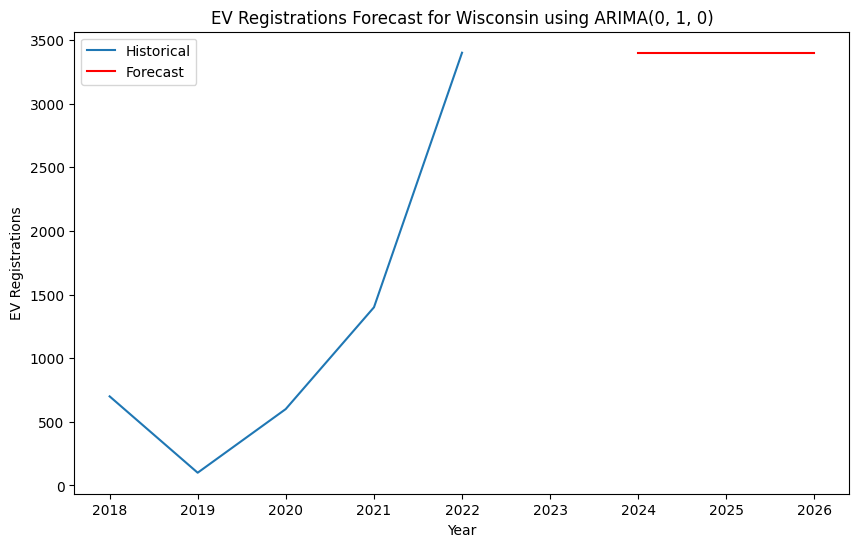

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

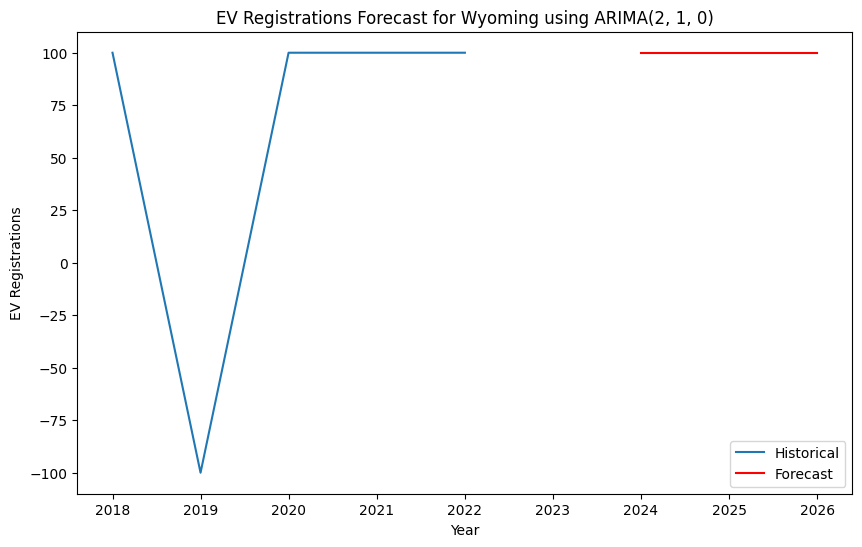

In [52]:
import pandas as pd
import numpy as np
import itertools
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

# Load your dataset
df = pd.read_csv("combined_data.csv")

# Convert 'Year' to a datetime type
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

states = df['State'].unique()

def check_stationarity(timeseries):
    # Perform Dickey-Fuller test:
    result = adfuller(timeseries.dropna())
    if result[1] <= 0.05:
        return True  # Stationary
    else:
        return False  # Not stationary

for state in states:
    state_data = df[df['State'] == state]['Electric (EV)']
    
    # Make the data stationary if not already
    if not check_stationarity(state_data):
        state_data = state_data.diff().dropna()
        if not check_stationarity(state_data):
            state_data = state_data.diff().dropna()

    # Fit ARIMA model
    p = range(0, 3)
    d = range(0, 2)
    q = range(0, 3)
    pdq = list(itertools.product(p, d, q))

    best_aic = np.inf
    best_order = None
    best_model = None

    for param in pdq:
        try:
            model = ARIMA(state_data, order=param)
            results = model.fit()
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_model = results
        except Exception as e:
            continue

    if best_model is not None:
        # Forecast and plot
        forecast = best_model.get_forecast(steps=3)
        forecast_index = pd.date_range(state_data.index.max() + pd.DateOffset(years=1), periods=3, freq='Y')

        plt.figure(figsize=(10, 6))
        plt.plot(state_data.index, state_data, label='Historical')
        plt.plot(forecast_index, forecast.predicted_mean, label='Forecast', color='red')
        plt.title(f'EV Registrations Forecast for {state} using ARIMA{best_order}')
        plt.xlabel('Year')
        plt.ylabel('EV Registrations')
        plt.legend()
        plt.show()



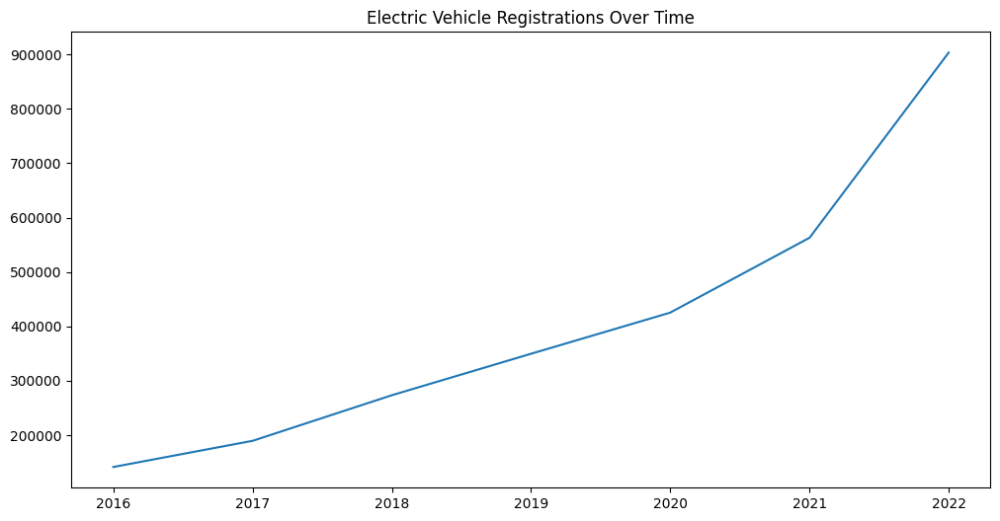

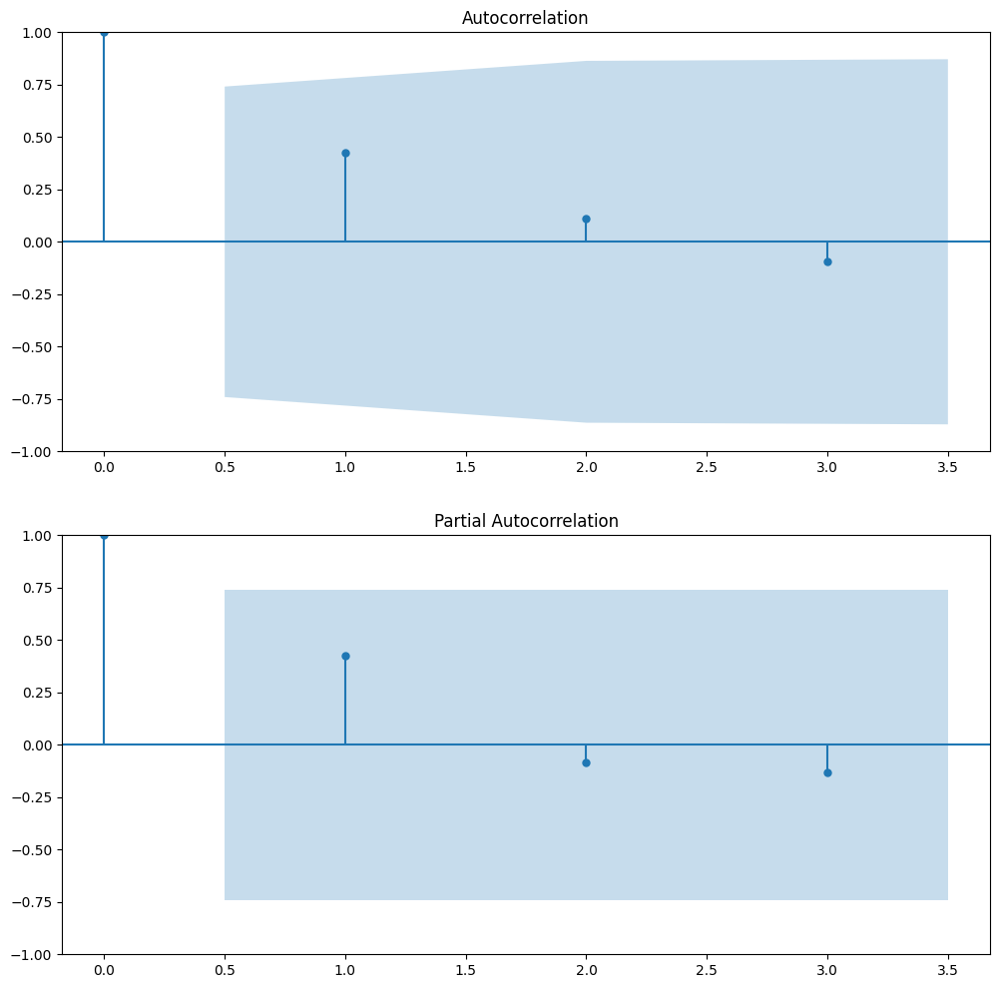

In [48]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Load your dataset
df = pd.read_csv('combined_data.csv')
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

# Sample plotting for one state's data
state_data = df[df['State'] == 'California']['Electric (EV)']

# Visual inspection
plt.figure(figsize=(12, 6))
plt.plot(state_data)
plt.title('Electric Vehicle Registrations Over Time')
plt.show()

# ACF and PACF plots
fig, ax = plt.subplots(2, 1, figsize=(12, 12))
plot_acf(state_data, ax=ax[0])  # Autocorrelation plot
plot_pacf(state_data, ax=ax[1])  # Partial Autocorrelation plot
plt.show()



C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 3) Model Failed to Fit: LU decomposition error.
Best ARIMA(1, 2, 1) AIC=6.0 for state Alabama


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

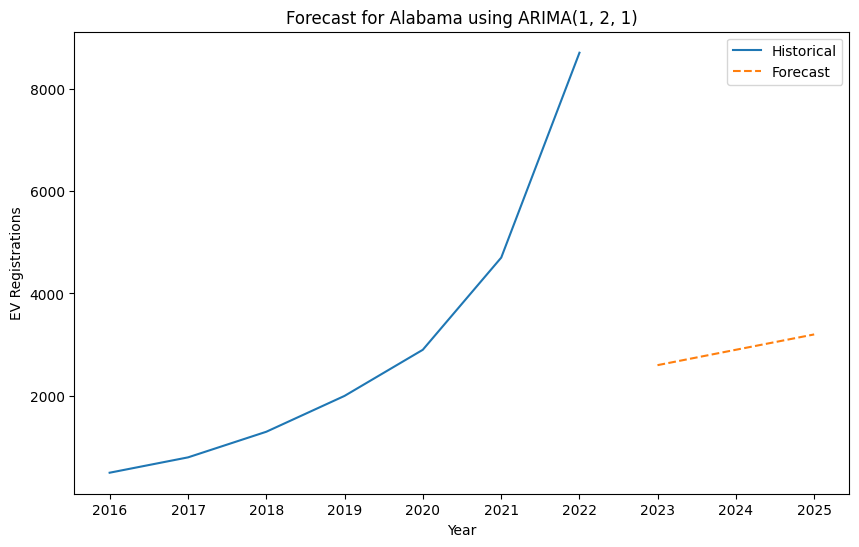

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(0, 2, 0) AIC=67.73416125873497 for state Alaska


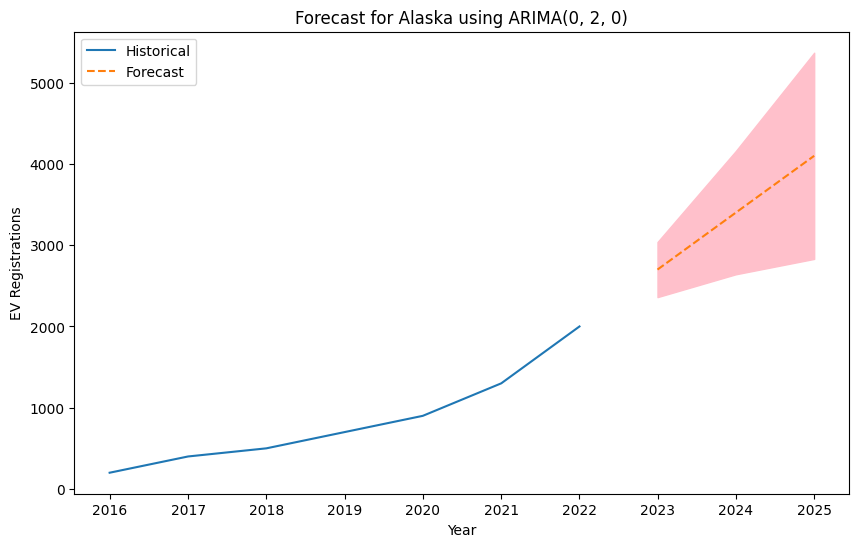

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 2, 2) AIC=12.0 for state Arizona


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


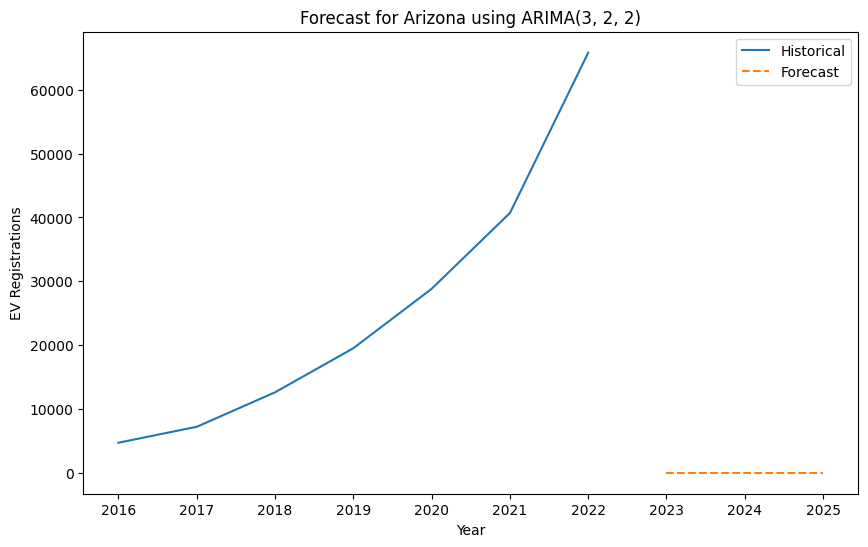

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 2, 3) AIC=14.0 for state Arkansas


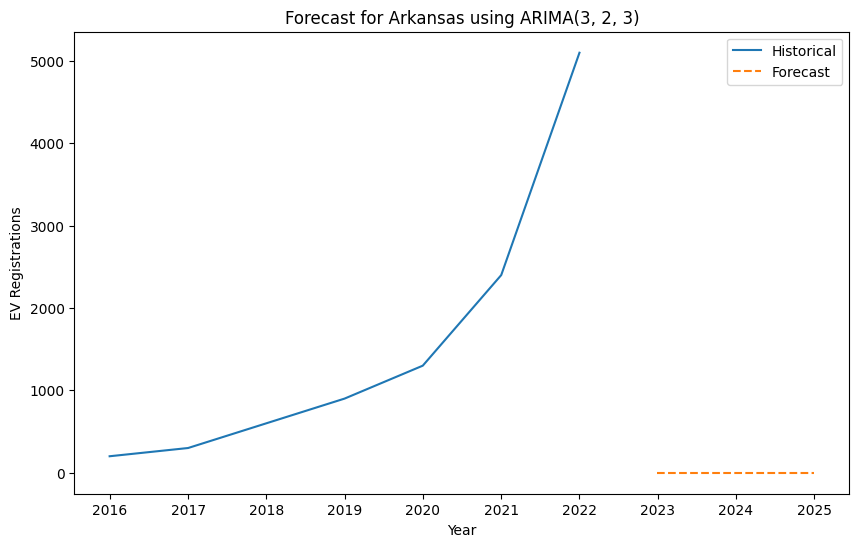

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(0, 2, 0) AIC=131.24988722133142 for state California


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


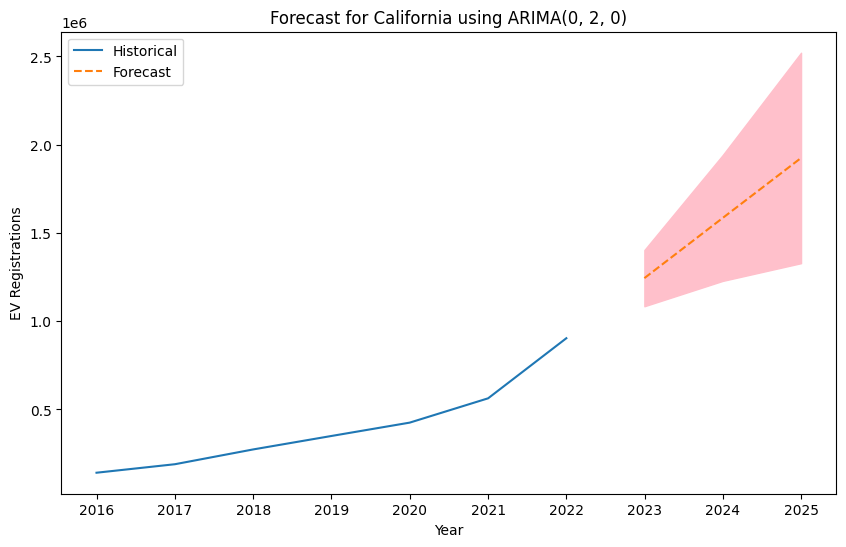

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 2, 1) AIC=10.0 for state Colorado


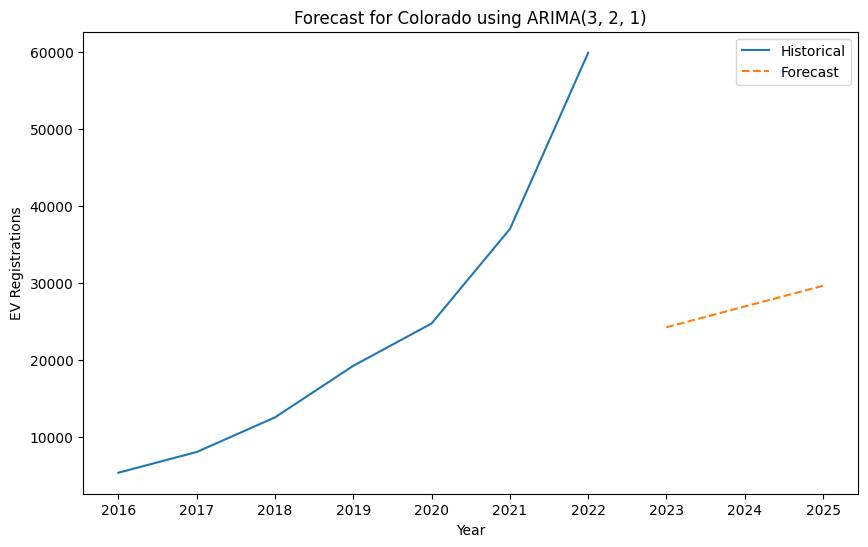

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 0) AIC=91.51745436876466 for state Connecticut


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


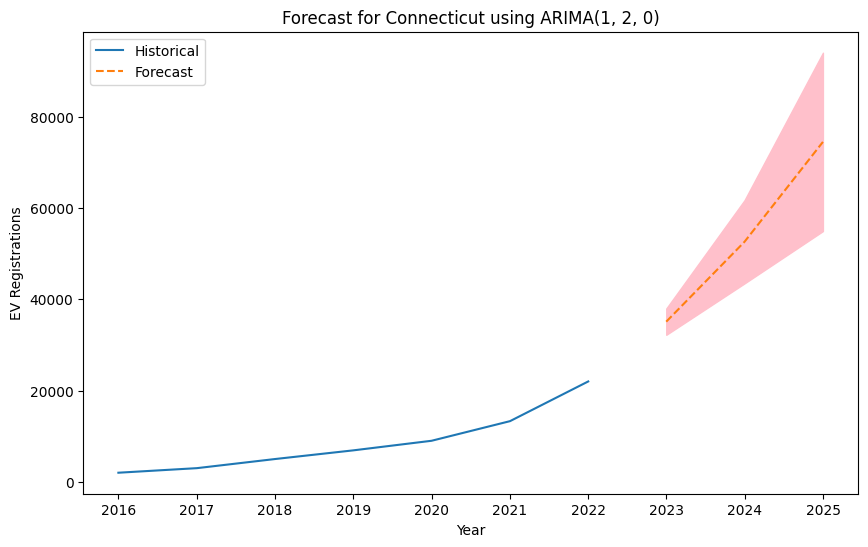

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 1) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

Best ARIMA(2, 2, 1) AIC=8.0 for state Delaware


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


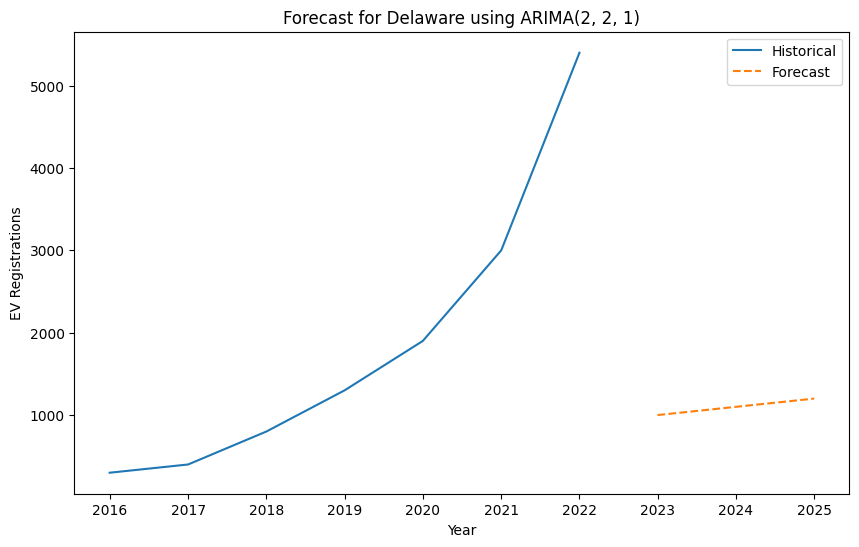

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 1) AIC=8.0 for state District of Columbia


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


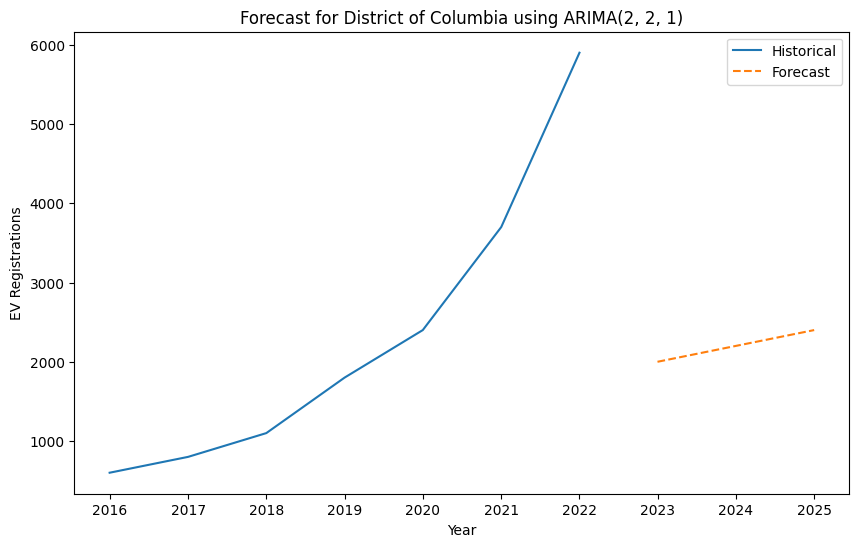

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 0) AIC=111.97600125071818 for state Florida


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


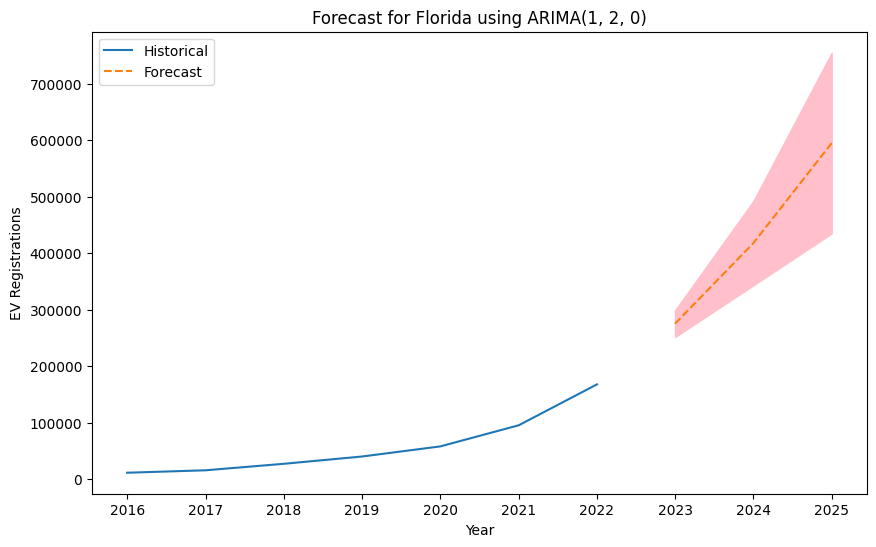

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

Best ARIMA(0, 2, 0) AIC=105.91487131050742 for state Georgia


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


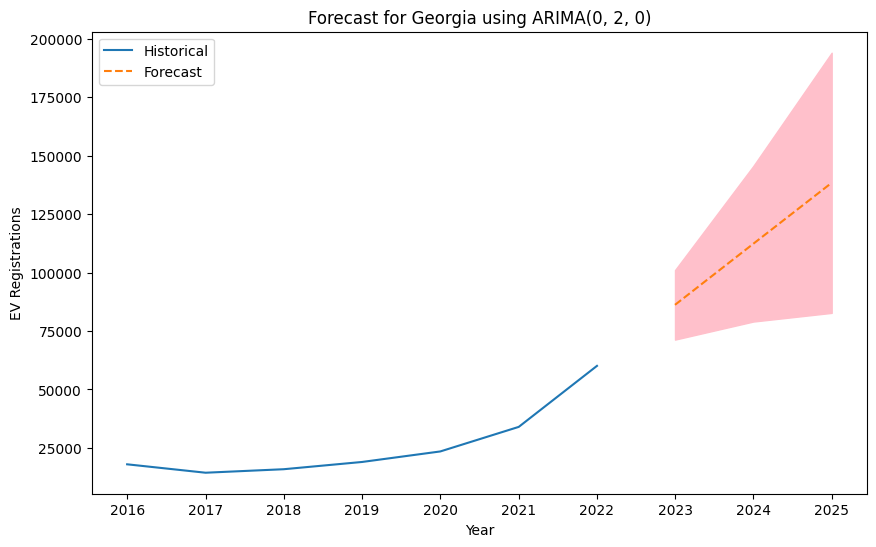

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(2, 2, 1) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Best ARIMA(3, 2, 1) AIC=10.0 for state Hawaii


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


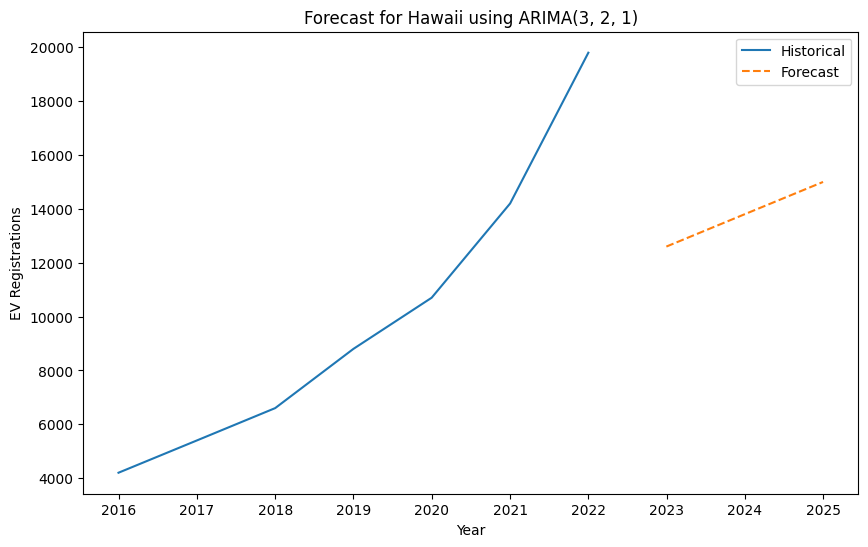

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 1, 2) AIC=12.0 for state Idaho


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

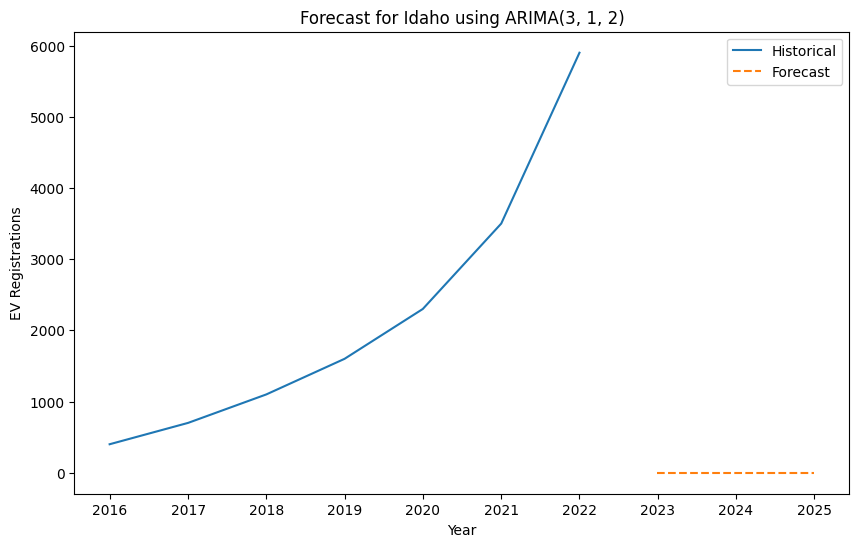

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 0) AIC=6.0 for state Illinois


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


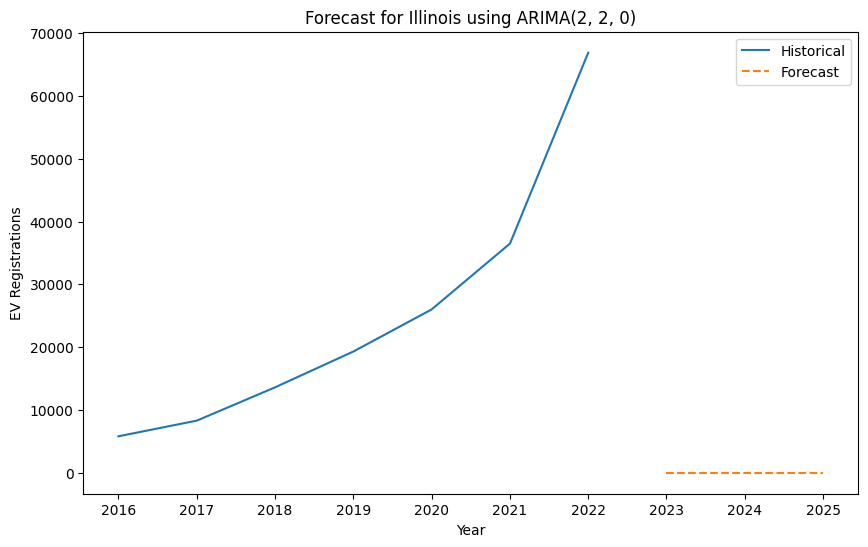

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(2, 1, 2) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 2) AIC=10.0 for state Indiana


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


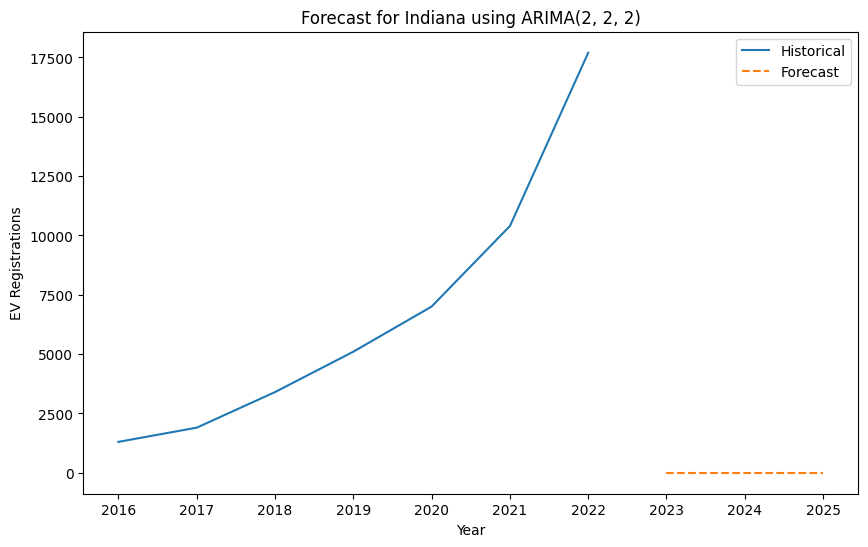

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 1, 2) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 2, 2) AIC=76.48289341740653 for state Iowa


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


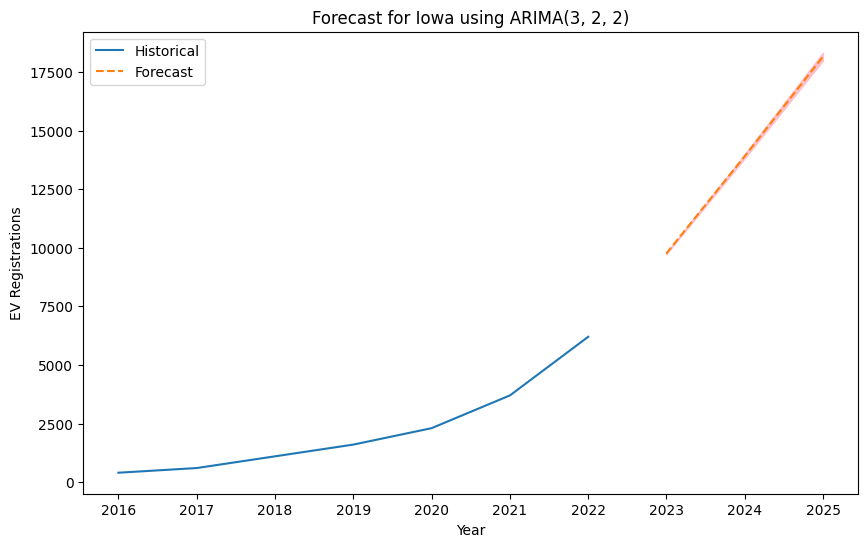

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 3) AIC=12.0 for state Kansas


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


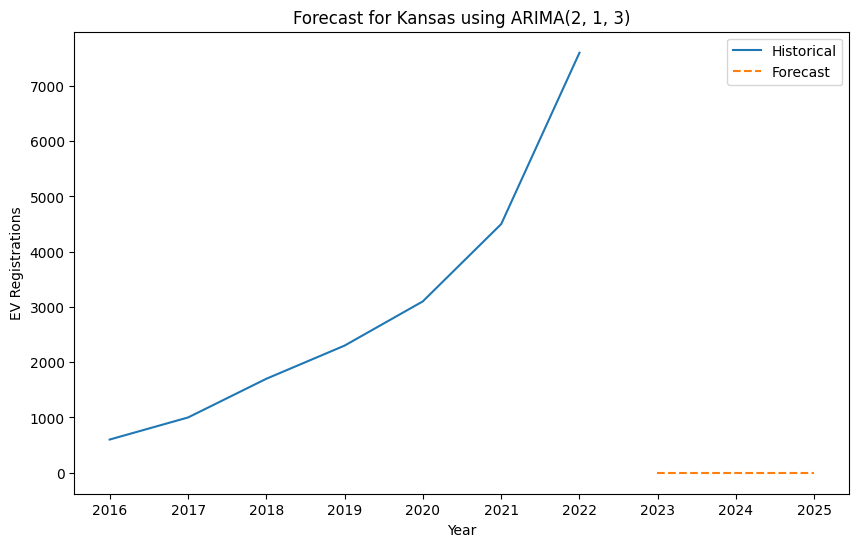

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 2) AIC=10.0 for state Kentucky


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


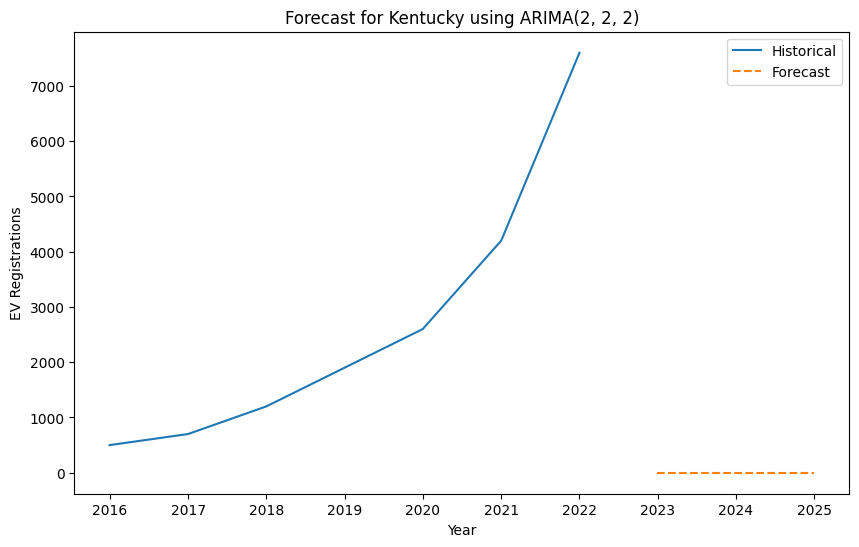

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 1) AIC=6.0 for state Louisiana


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


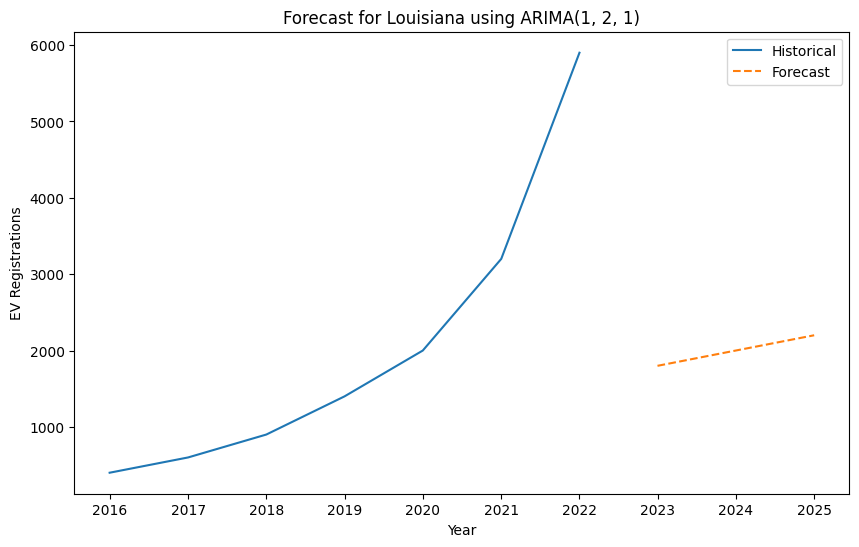

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(2, 1, 3) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Best ARIMA(1, 2, 0) AIC=75.19157534261346 for state Maine


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


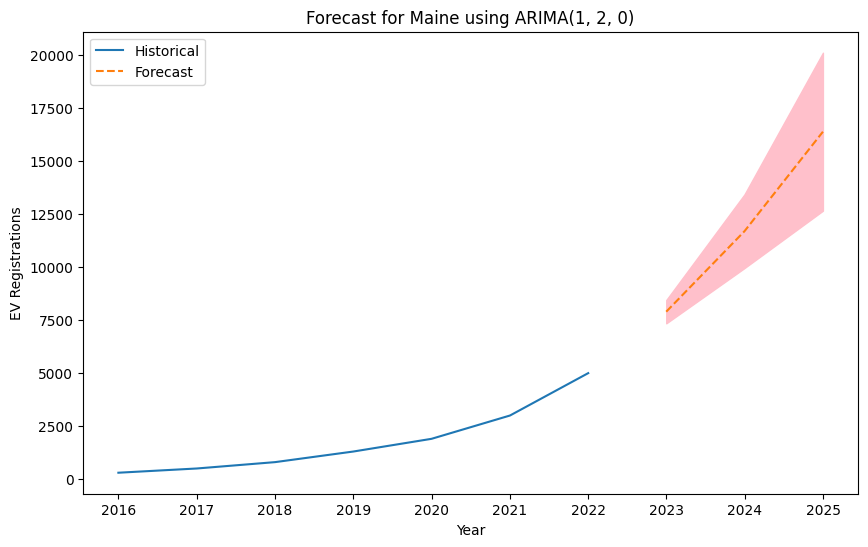

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(2, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 1, 3) AIC=14.0 for state Maryland


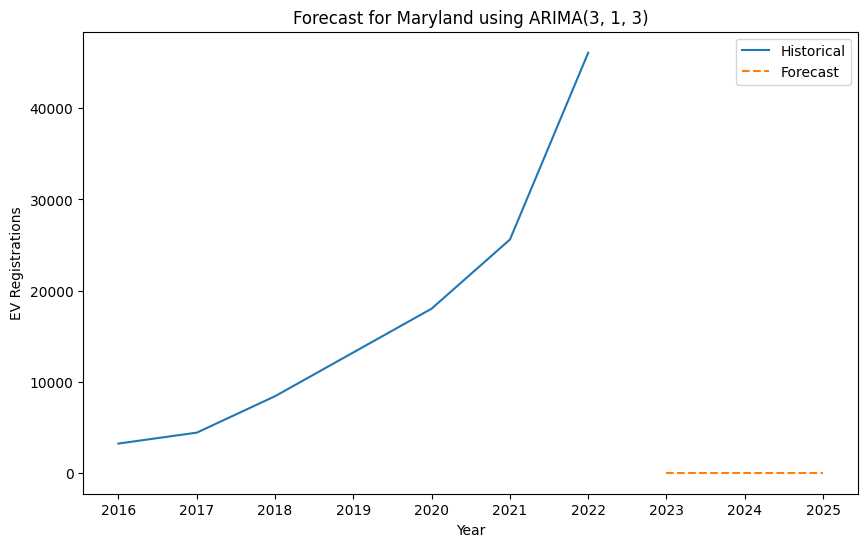

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 0) AIC=6.0 for state Massachusetts


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


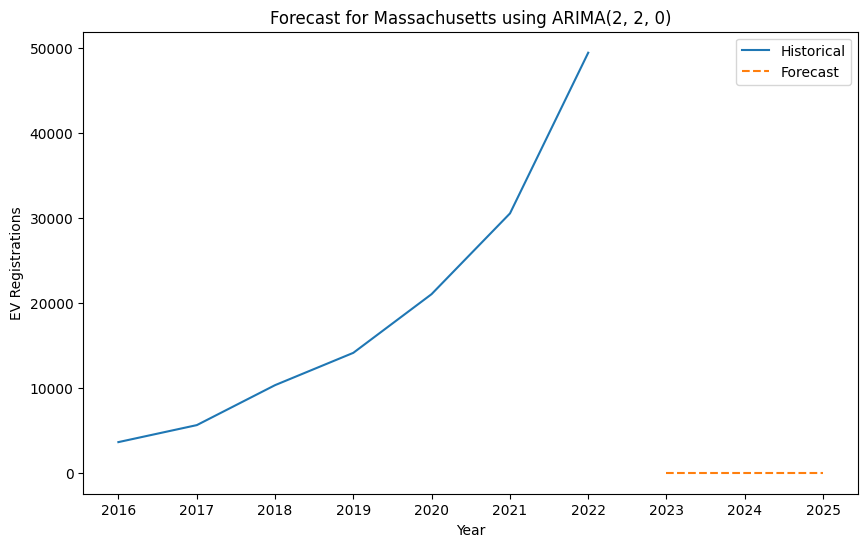

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 3) AIC=12.0 for state Michigan


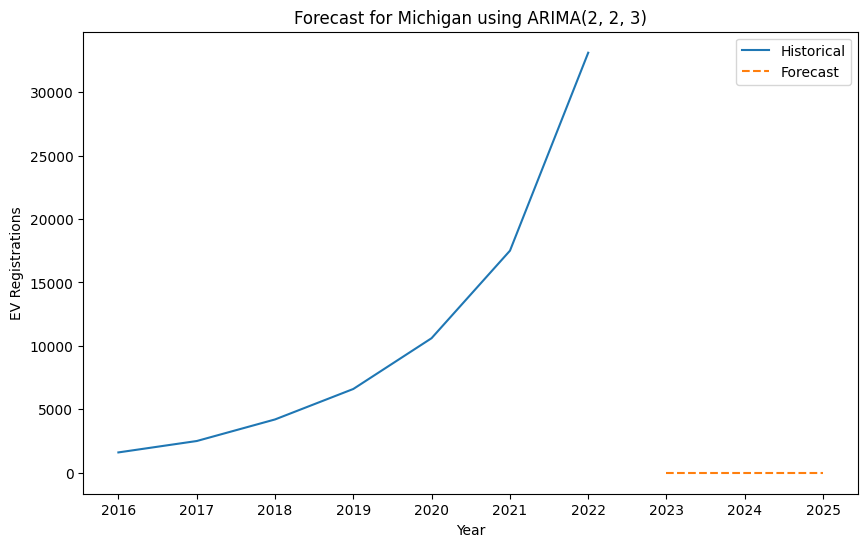

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 0) AIC=94.11812891182764 for state Minnesota


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


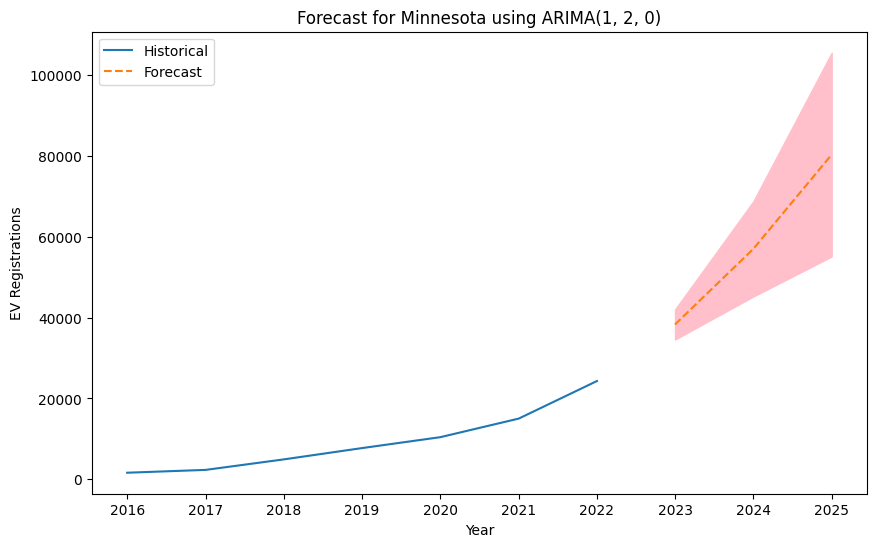

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 1) Model Failed to Fit: LU decomposition error.
Best ARIMA(1, 2, 0) AIC=72.29325962237641 for state Mississippi


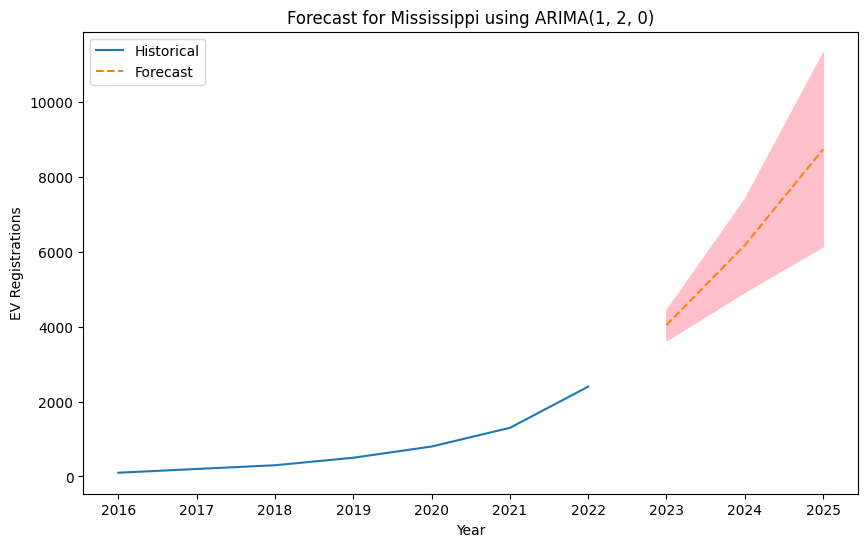

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 3) AIC=12.0 for state Missouri


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


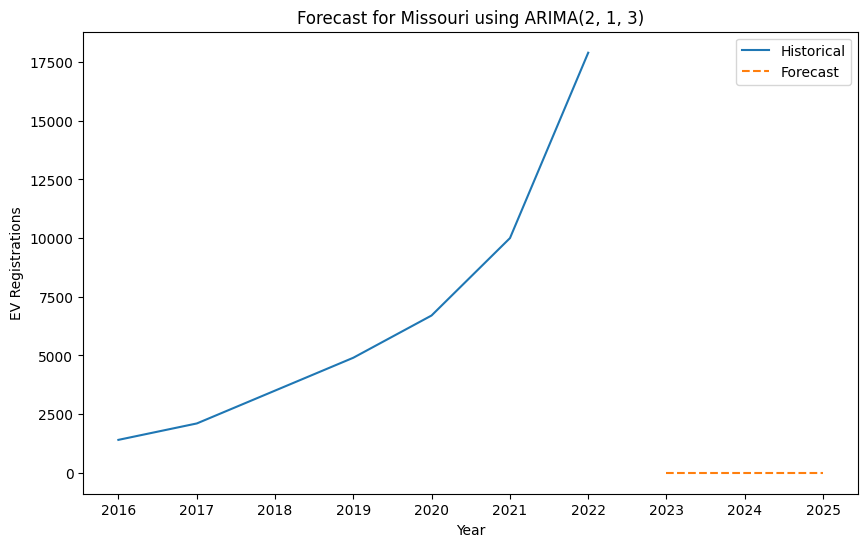

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 1, 3) AIC=14.0 for state Montana


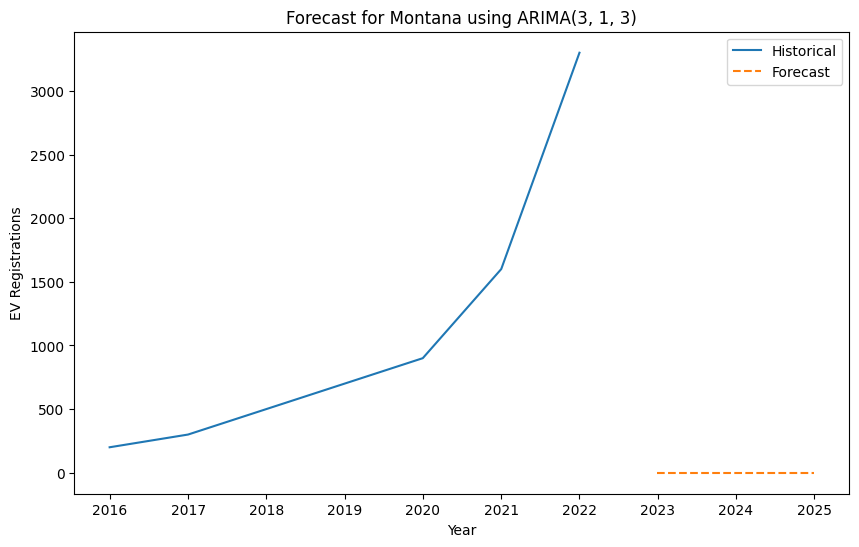

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 3) AIC=12.0 for state Nebraska


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

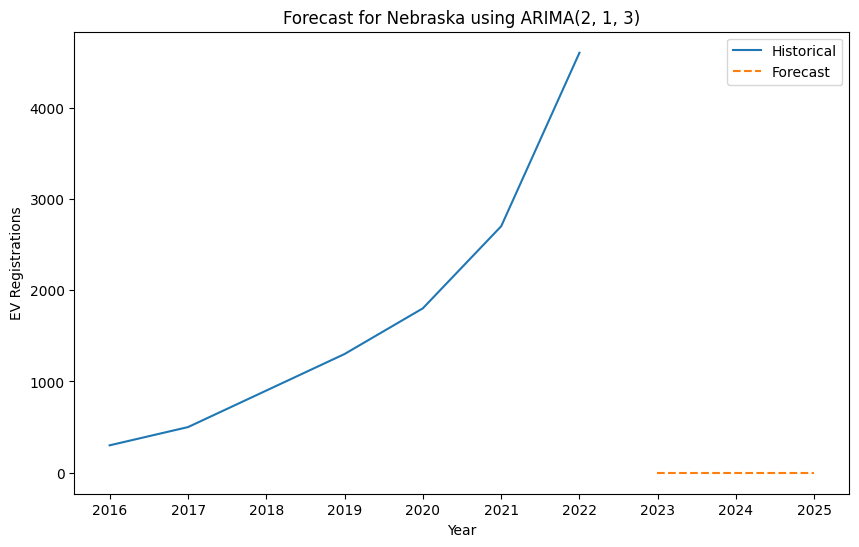

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 1) AIC=8.0 for state Nevada


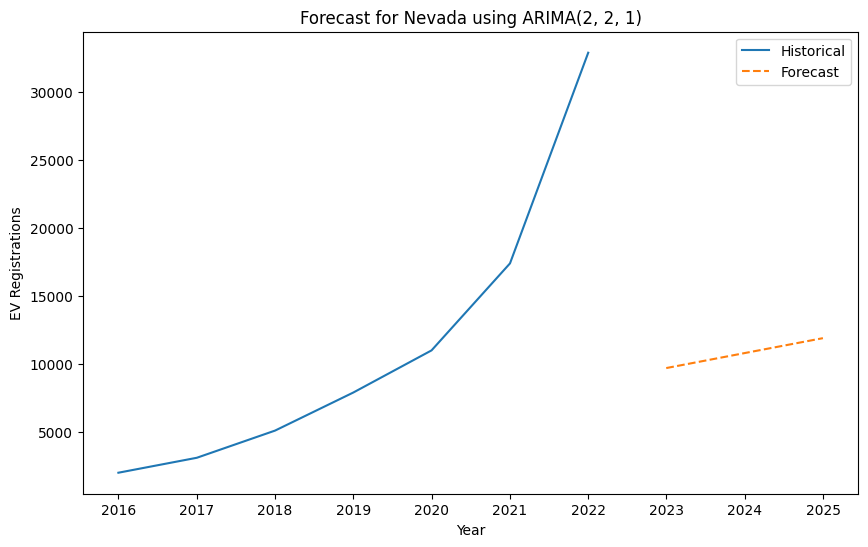

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 2, 3) AIC=14.0 for state New Hampshire


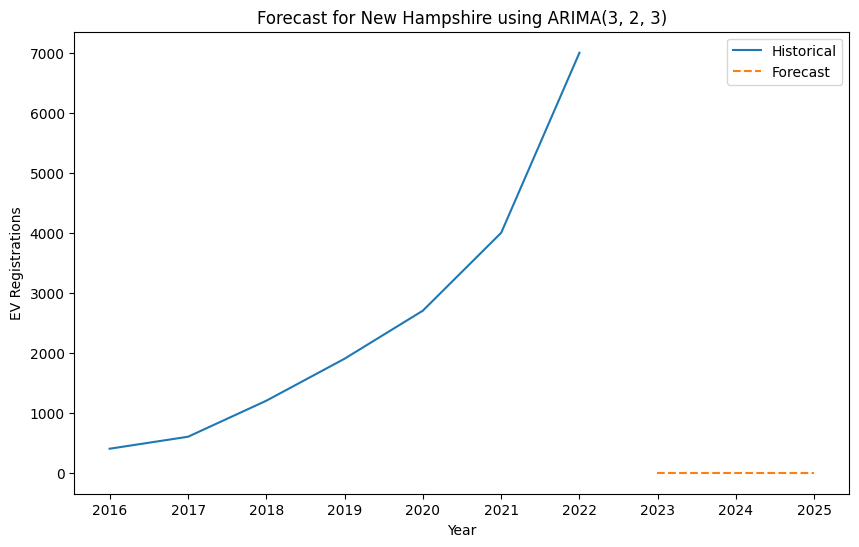

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 1) AIC=6.0 for state New Jersey


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


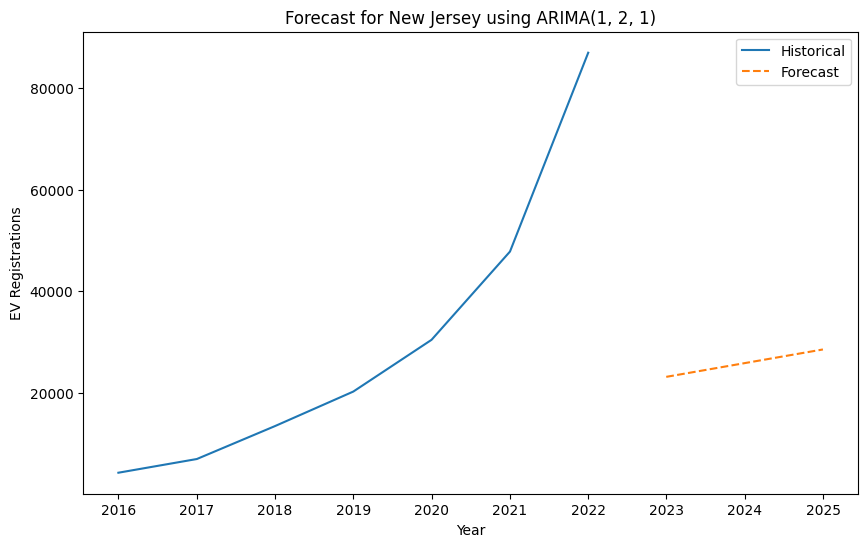

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

Best ARIMA(3, 1, 2) AIC=12.0 for state New Mexico


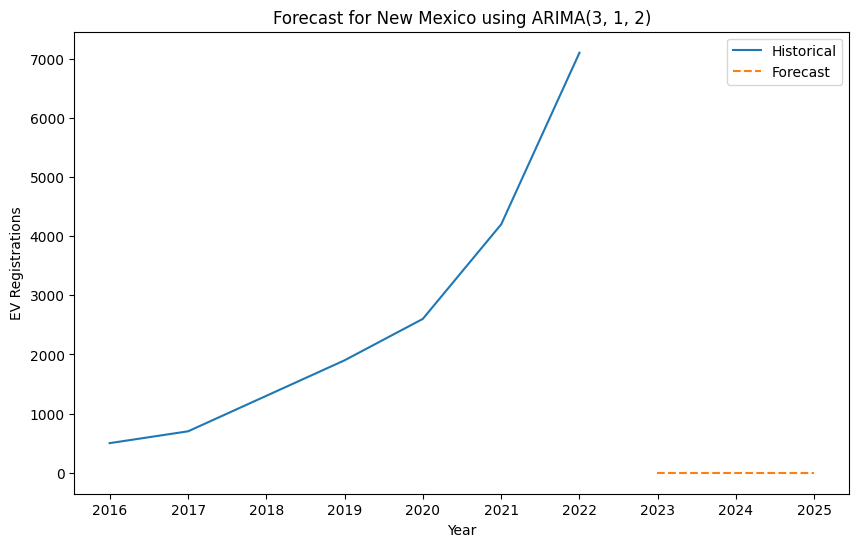

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 2, 1) AIC=10.0 for state New York


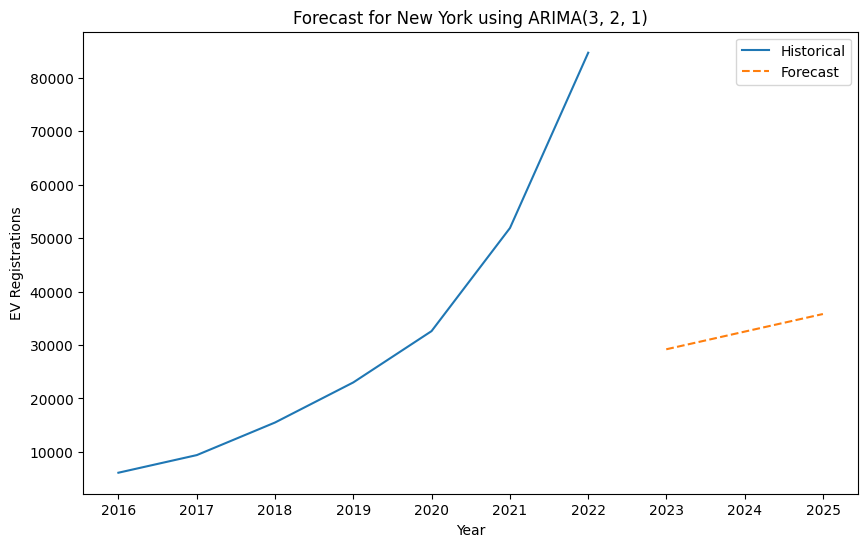

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 1) AIC=6.0 for state North Carolina


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


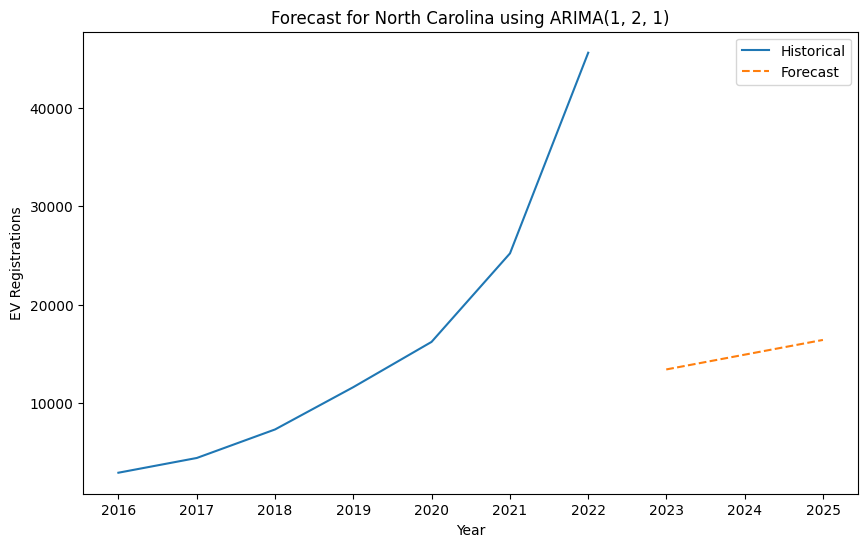

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 1) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

Best ARIMA(1, 2, 1) AIC=6.0 for state North Dakota


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


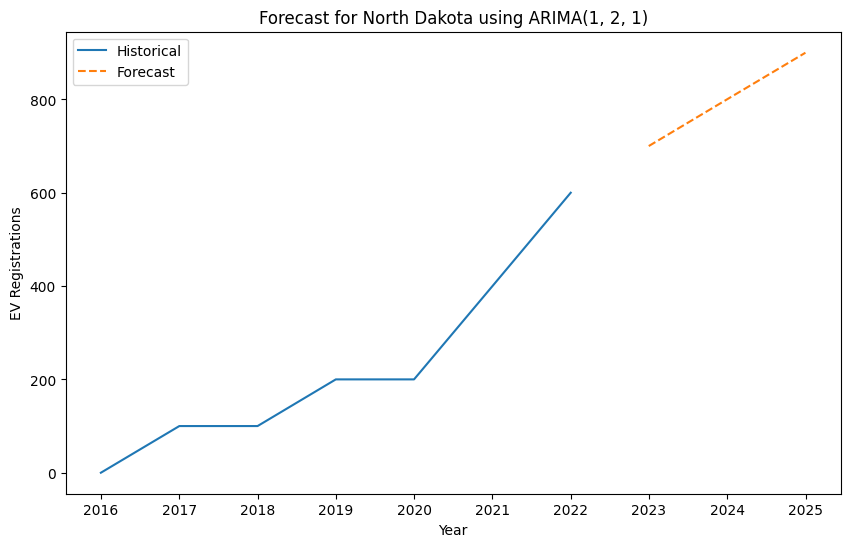

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

Best ARIMA(1, 2, 1) AIC=6.0 for state Ohio


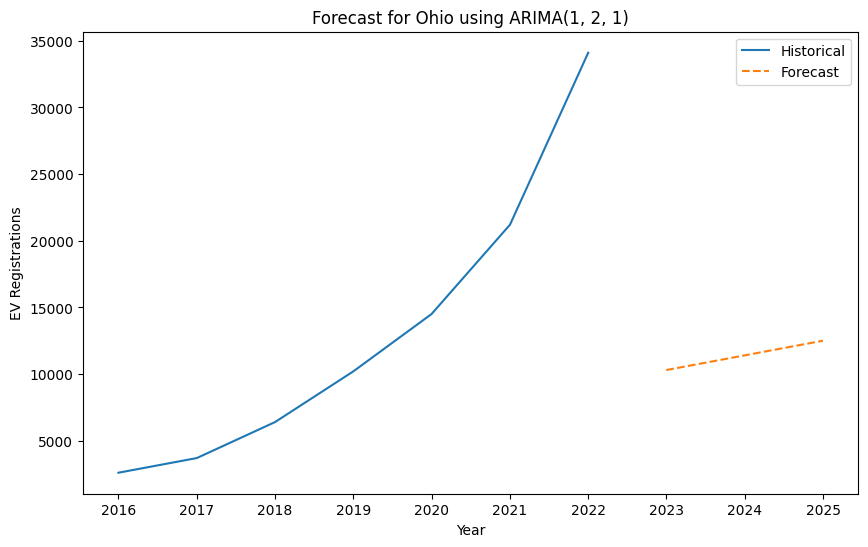

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(2, 2, 1) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

ARIMA(3, 1, 2) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Best ARIMA(0, 2, 0) AIC=97.30133034470649 for state Oklahoma


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


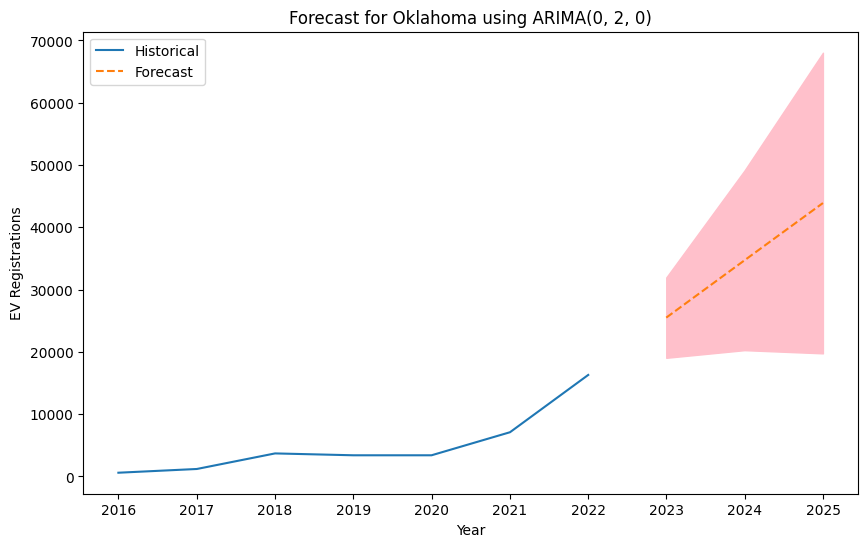

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 1) AIC=8.0 for state Oregon


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


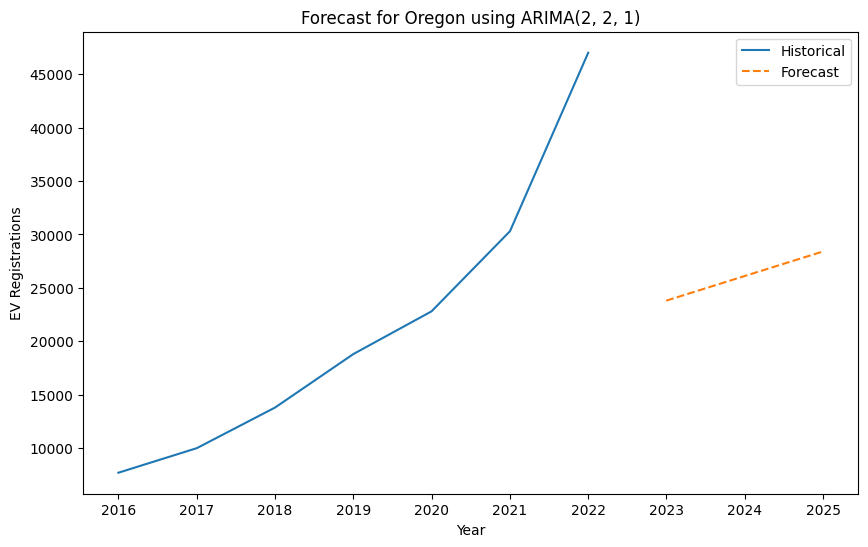

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 0) AIC=6.0 for state Pennsylvania


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


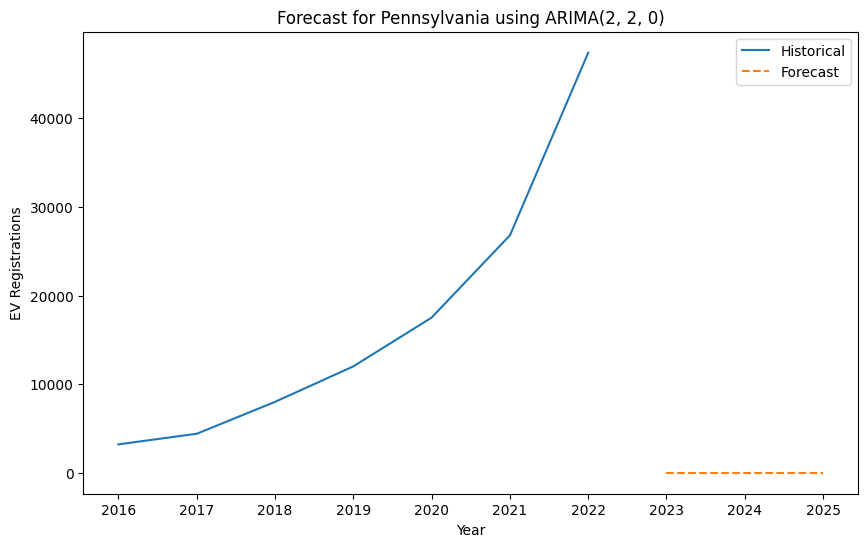

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(3, 1, 2) AIC=12.0 for state Rhode Island


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


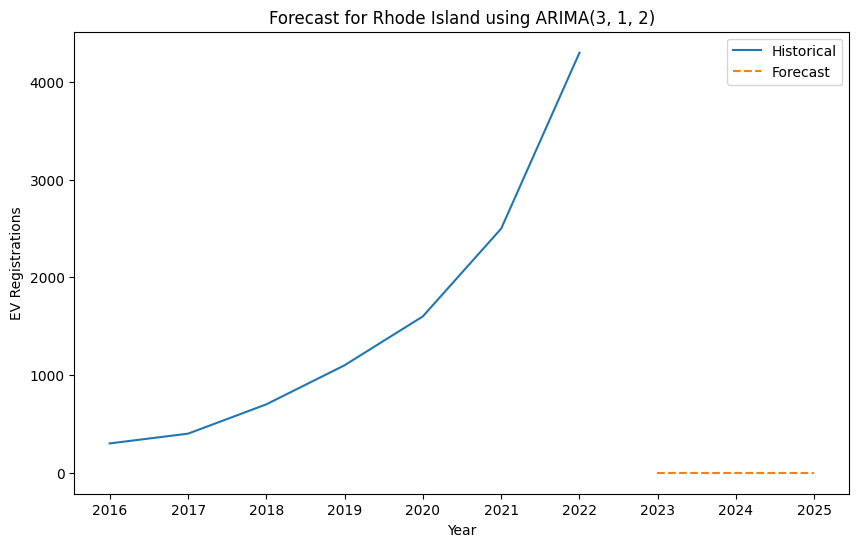

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 2) AIC=10.0 for state South Carolina


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


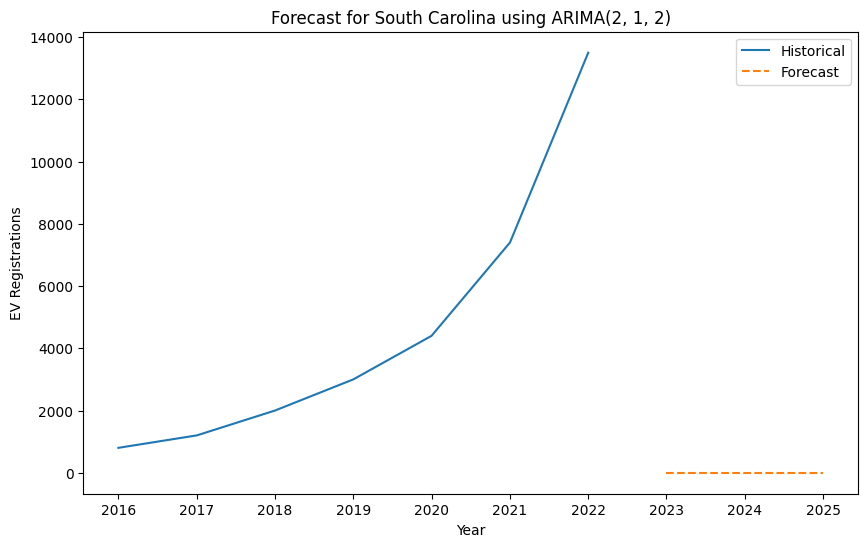

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(0, 2, 0) AIC=65.1800291903422 for state South Dakota


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


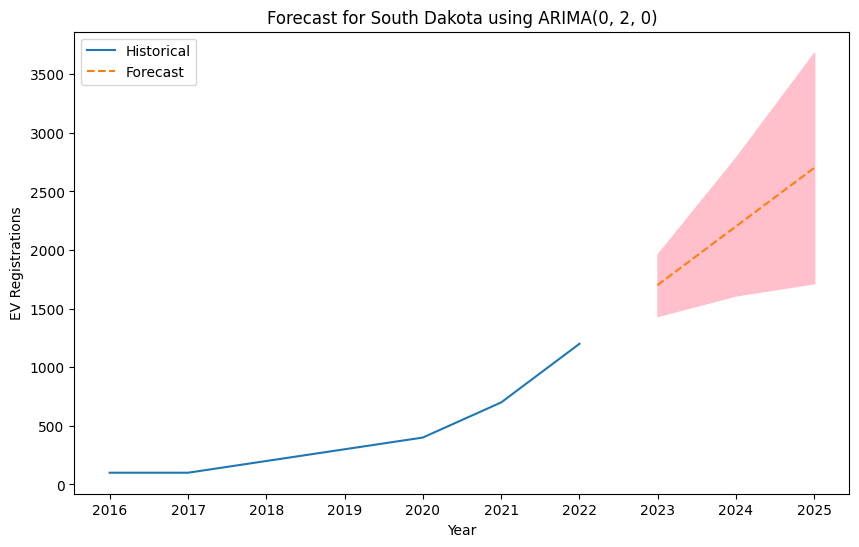

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 1) AIC=6.0 for state Tennessee


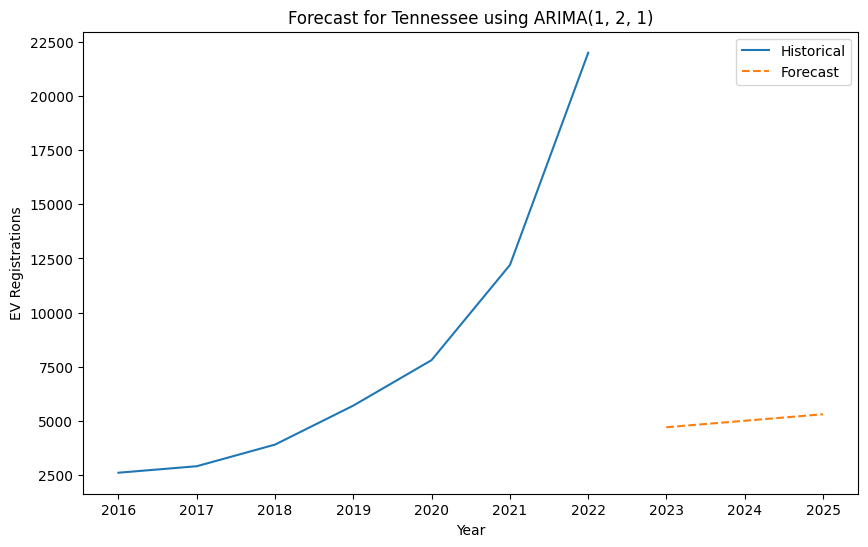

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 2, 1) AIC=8.0 for state Texas


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


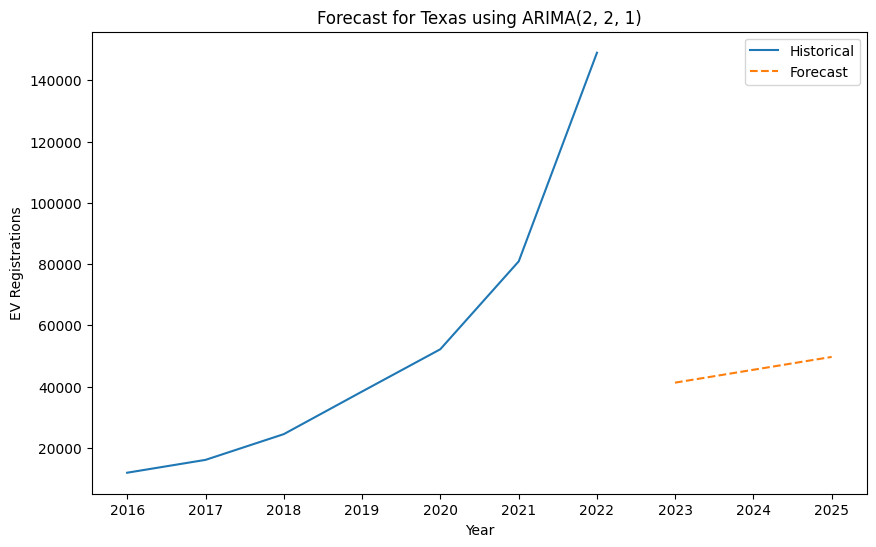

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(2, 2, 1) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

ARIMA(3, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

Best ARIMA(2, 1, 2) AIC=10.0 for state Utah


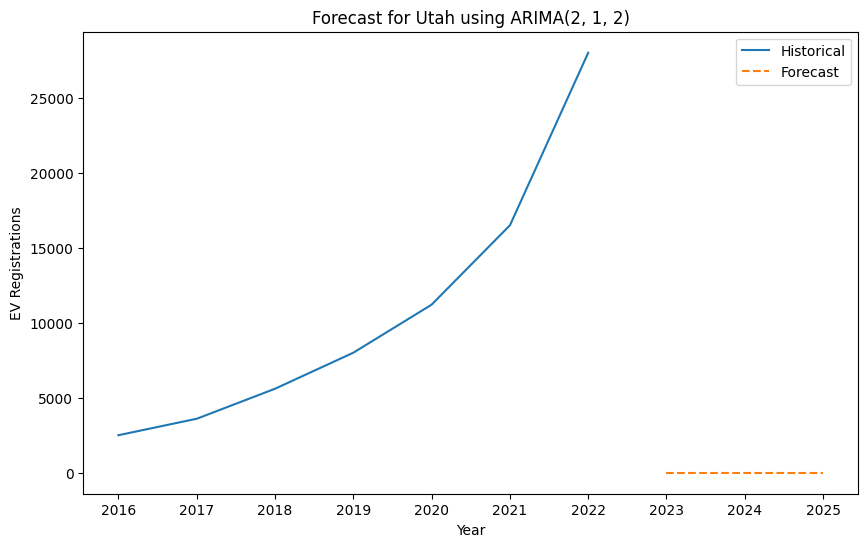

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 2) AIC=10.0 for state Vermont


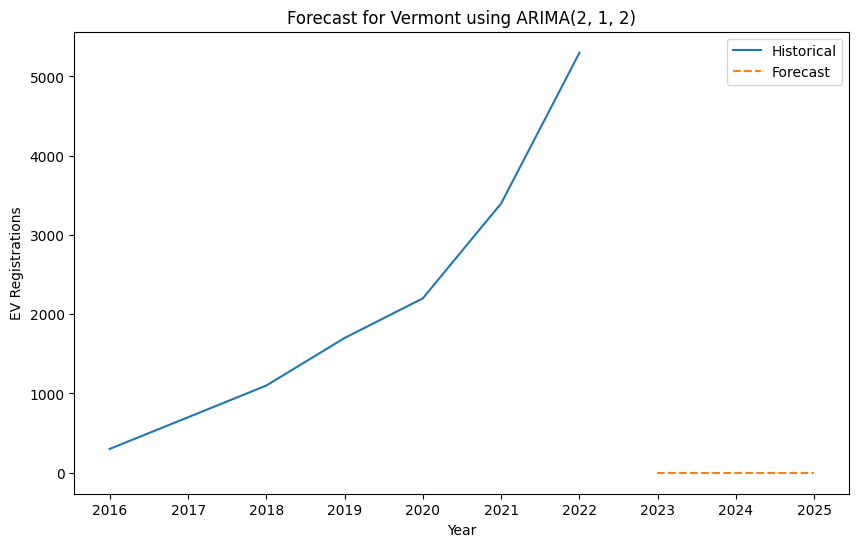

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(1, 2, 0) AIC=104.59077967526672 for state Virginia


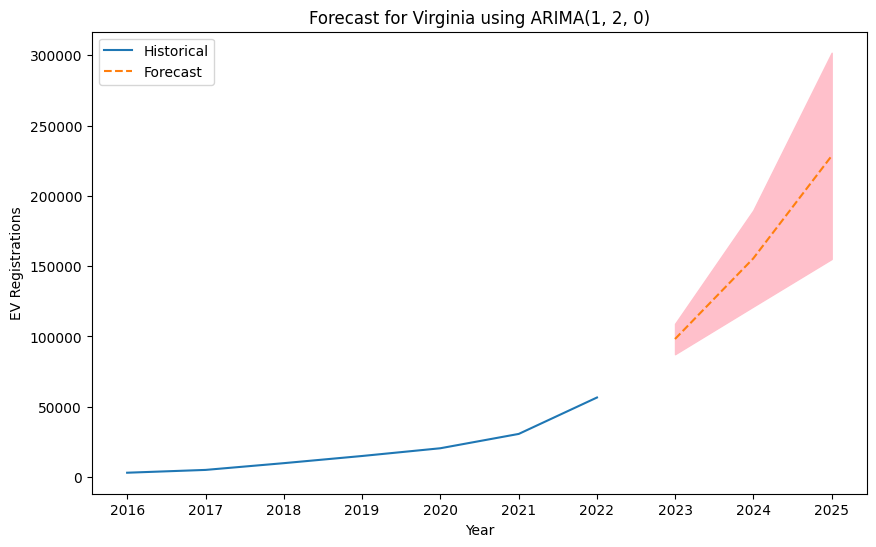

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(1, 1, 2) Model Failed to Fit: LU decomposition error.
ARIMA(1, 1, 3) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

ARIMA(3, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maxi

Best ARIMA(0, 2, 0) AIC=108.20865888178552 for state Washington


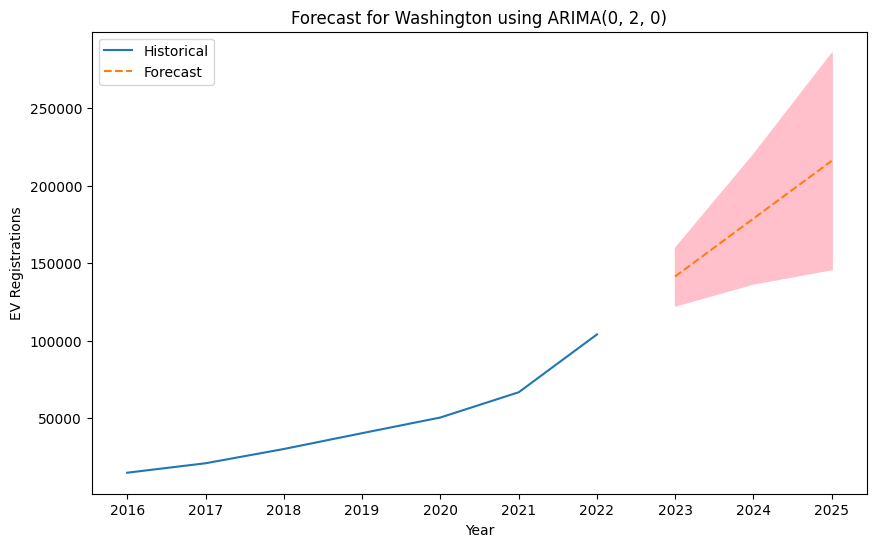

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(0, 2, 1) AIC=70.90710510919833 for state West Virginia


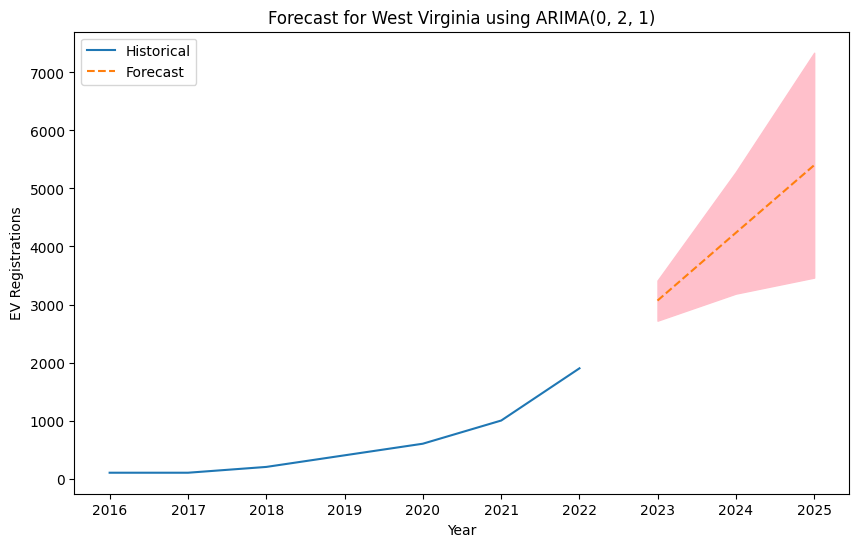

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

ARIMA(3, 2, 0) Model Failed to Fit: LU decomposition error.


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maxi

Best ARIMA(2, 2, 0) AIC=6.0 for state Wisconsin


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning:

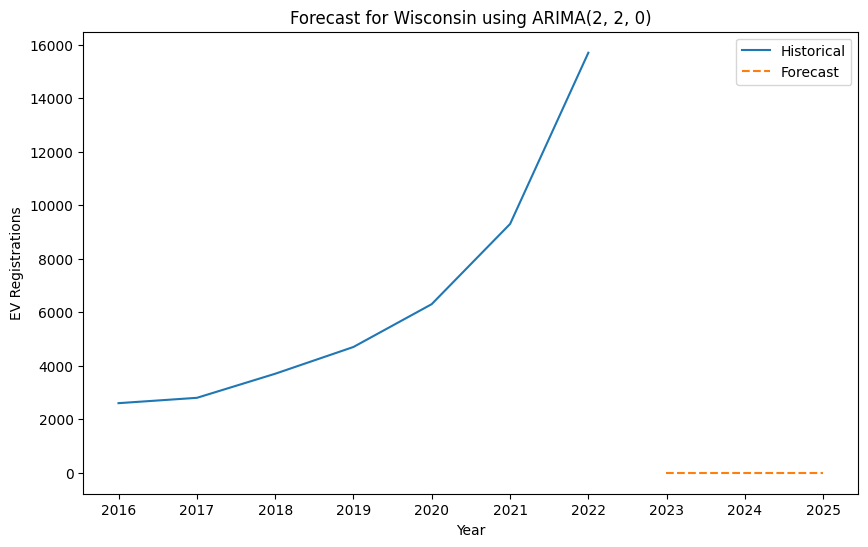

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(0, 2, 0) AIC=62.24109181527504 for state Wyoming


C:\Users\Harinya's Desktop\AppData\Local\Temp\ipykernel_60216\3423022610.py:53: FutureWarning: 'A-DEC' is deprecated and will be removed in a future version, please use 'YE-DEC' instead.
  forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')


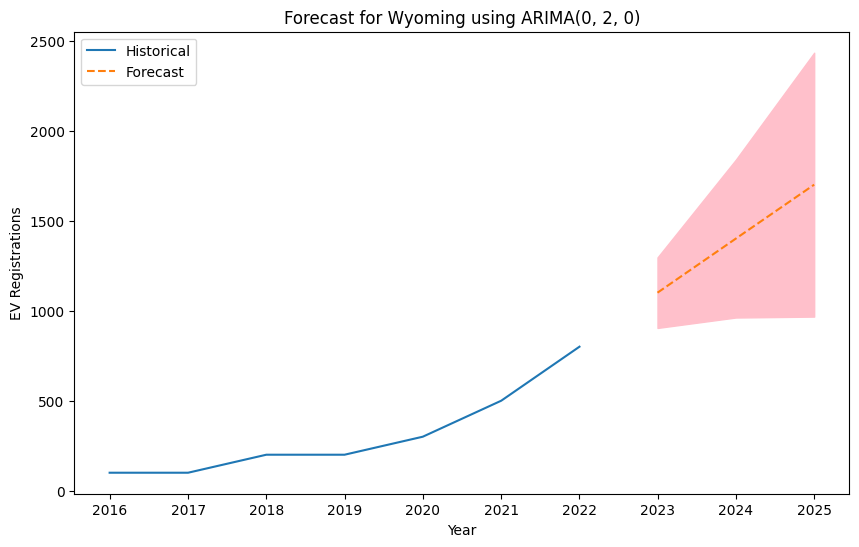

                   State ARIMA_order         AIC
0                Alabama   (1, 2, 1)    6.000000
1                 Alaska   (0, 2, 0)   67.734161
2                Arizona   (3, 2, 2)   12.000000
3               Arkansas   (3, 2, 3)   14.000000
4             California   (0, 2, 0)  131.249887
5               Colorado   (3, 2, 1)   10.000000
6            Connecticut   (1, 2, 0)   91.517454
7               Delaware   (2, 2, 1)    8.000000
8   District of Columbia   (2, 2, 1)    8.000000
9                Florida   (1, 2, 0)  111.976001
10               Georgia   (0, 2, 0)  105.914871
11                Hawaii   (3, 2, 1)   10.000000
12                 Idaho   (3, 1, 2)   12.000000
13              Illinois   (2, 2, 0)    6.000000
14               Indiana   (2, 2, 2)   10.000000
15                  Iowa   (3, 2, 2)   76.482893
16                Kansas   (2, 1, 3)   12.000000
17              Kentucky   (2, 2, 2)   10.000000
18             Louisiana   (1, 2, 1)    6.000000
19                 M

In [53]:
import pandas as pd
import numpy as np
import itertools
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

# Load your dataset
df = pd.read_csv("combined_data.csv")

# Ensure 'Year' is of datetime type and set it as the index
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

states = df['State'].unique()

# Define the range for ARIMA parameters
p = range(0, 4)  # AR terms
d = range(1, 3)  # Differencing order
q = range(0, 4)  # MA terms
pdq = list(itertools.product(p, d, q))

results_summary = []

# Loop through each state to model
for state in states:
    state_data = df[df['State'] == state]['Electric (EV)']
    best_aic = np.inf
    best_order = None
    best_mdl = None

    # Grid search to find the best ARIMA model
    for param in pdq:
        try:
            temp_mdl = ARIMA(state_data, order=param)
            results = temp_mdl.fit()
            
            # Keep the best model based on AIC
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_mdl = results
        except Exception as e:
            print(f'ARIMA{param} Model Failed to Fit: {e}')

    # Store best model results and forecast
    if best_mdl is not None:
        print(f'Best ARIMA{best_order} AIC={best_aic} for state {state}')
        results_summary.append((state, best_order, best_aic))

        # Forecast and plot
        forecast = best_mdl.get_forecast(steps=3)
        forecast_index = pd.date_range(state_data.index.max(), periods=3, freq='A-DEC')
        
        plt.figure(figsize=(10, 6))
        plt.plot(state_data.index, state_data, label='Historical')
        plt.plot(forecast_index, forecast.predicted_mean, label='Forecast', linestyle='--')
        plt.fill_between(forecast_index, forecast.conf_int().iloc[:, 0], forecast.conf_int().iloc[:, 1], color='pink')
        plt.title(f'Forecast for {state} using ARIMA{best_order}')
        plt.xlabel('Year')
        plt.ylabel('EV Registrations')
        plt.legend()
        plt.show()

# Display the summary of best models
results_df = pd.DataFrame(results_summary, columns=['State', 'ARIMA_order', 'AIC'])
print(results_df)


Results of Dickey-Fuller Test:
Test Statistic                 3.483320
p-value                        1.000000
#Lags Used                     0.000000
Number of Observations Used    6.000000
Critical Value (1%)           -5.354256
Critical Value (5%)           -3.646238
Critical Value (10%)          -2.901198
dtype: float64
Results of Dickey-Fuller Test:
Test Statistic                 2.345947
p-value                        0.998983
#Lags Used                     0.000000
Number of Observations Used    5.000000
Critical Value (1%)           -6.045114
Critical Value (5%)           -3.929280
Critical Value (10%)          -2.986810
dtype: float64


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA Model: ARIMA(2, 2, 0) - AIC:-28.673199095539758


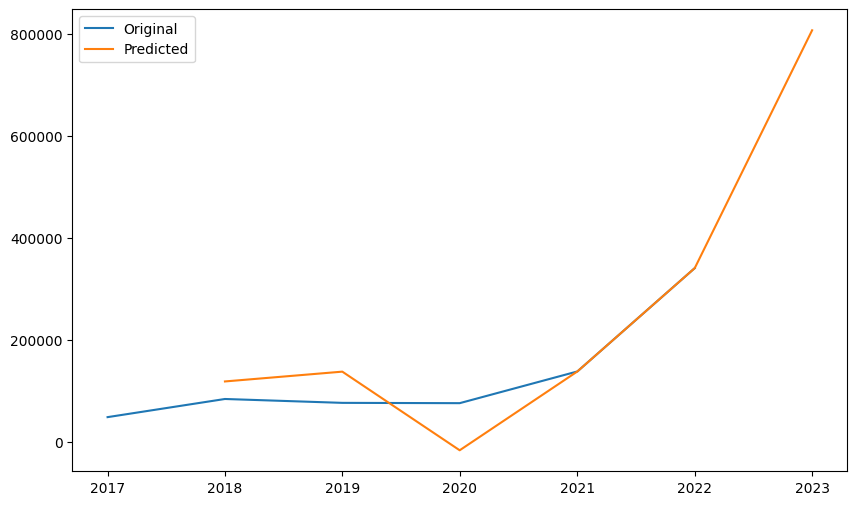

In [54]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from itertools import product

# Load your dataset
df = pd.read_csv("combined_data.csv")
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

def test_stationarity(timeseries):
    # Perform Dickey-Fuller test:
    print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key, value in dftest[4].items():
        dfoutput[f'Critical Value ({key})'] = value
    print(dfoutput)

# Assuming we are focusing on one state for simplicity
data = df[df['State'] == 'California']['Electric (EV)']

# Test stationarity
test_stationarity(data)

# If not stationary, differencing the data
if adfuller(data)[1] > 0.05:  # p-value is more than 0.05
    data_diff = data.diff().dropna()
    test_stationarity(data_diff)

# Define the p, d, and q parameters to take any values from 0 to 2
p = d = q = range(0, 3)

# Generate all different combinations of p, d, and q triplets
pdq = list(product(p, d, q))

best_aic = np.inf
best_pdq = None
best_model = None

# Grid search for best ARIMA parameters
for param in pdq:
    try:
        model = SARIMAX(data_diff,
                        order=(param[0], param[1], param[2]),
                        enforce_stationarity=False,
                        enforce_invertibility=False)
        results = model.fit(disp=0)
        if results.aic < best_aic:
            best_aic = results.aic
            best_pdq = param
            best_model = results
    except:
        continue

print(f'Best ARIMA Model: ARIMA{best_pdq} - AIC:{best_aic}')

# Predict and plot the results
if best_model:
    plt.figure(figsize=(10, 6))
    plt.plot(data_diff, label='Original')
    plt.plot(best_model.predict(start=1, end=len(data_diff), dynamic=False), label='Predicted')
    plt.legend()
    plt.show()


Processing Alabama...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

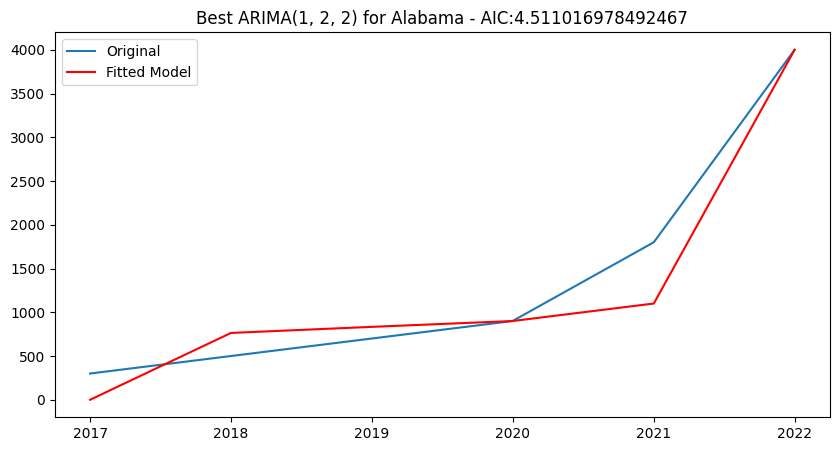

Processing Alaska...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

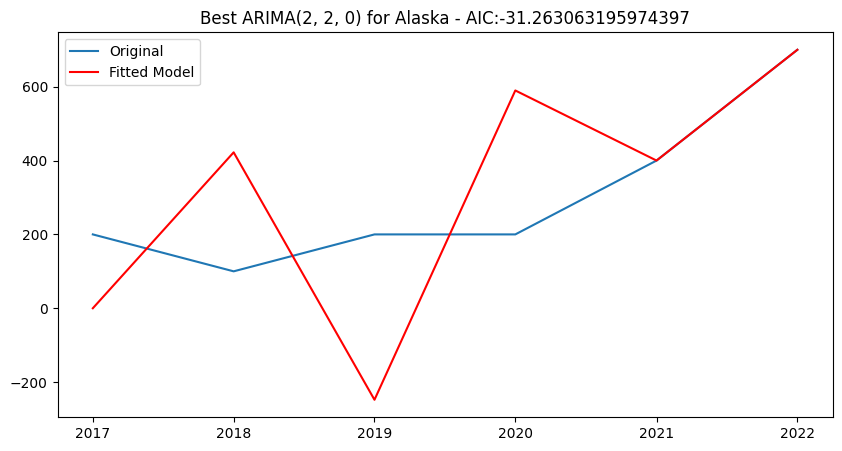

Processing Arizona...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

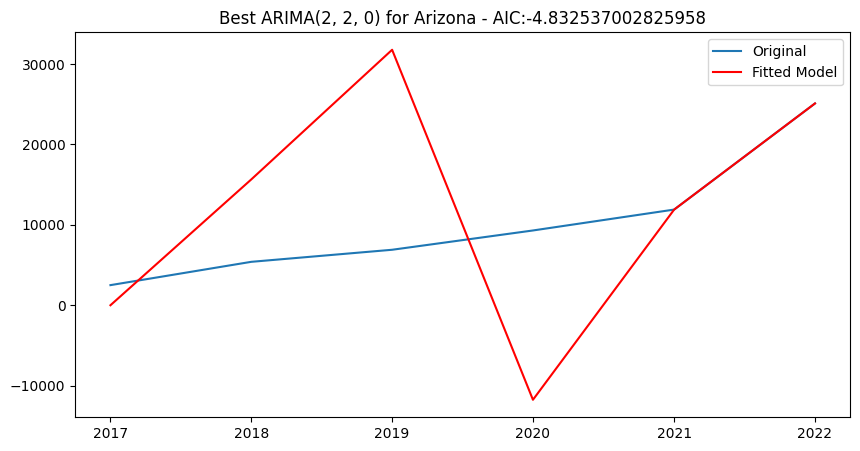

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Arkansas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

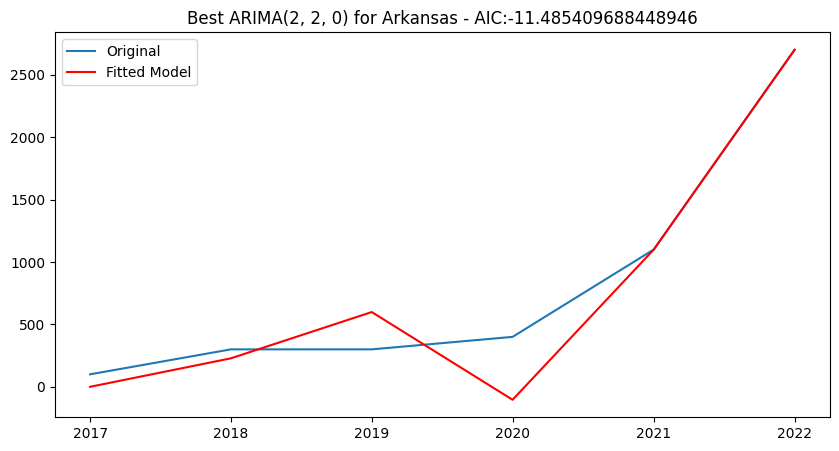

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing California...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

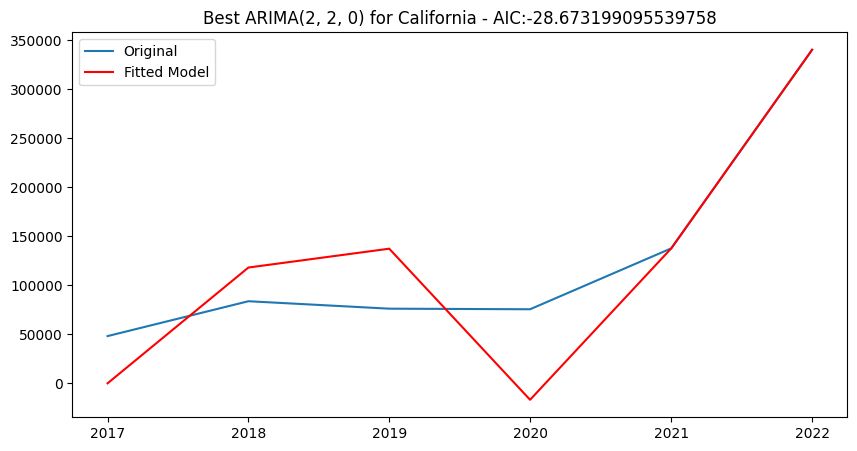

Processing Colorado...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

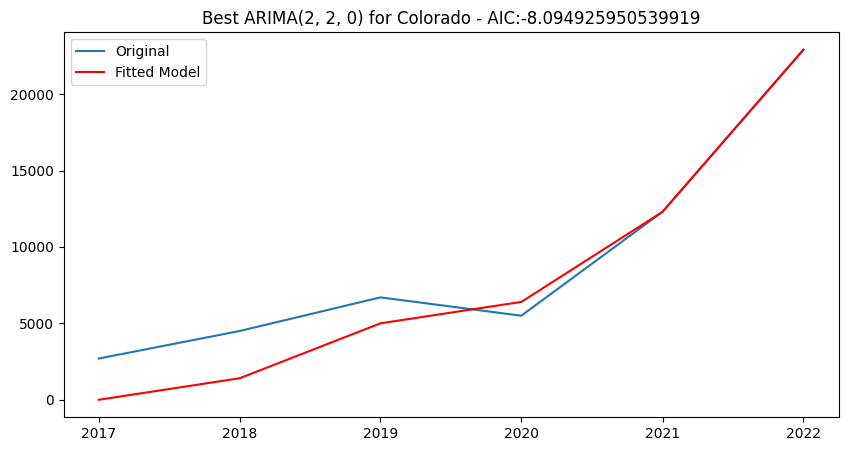

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Connecticut...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

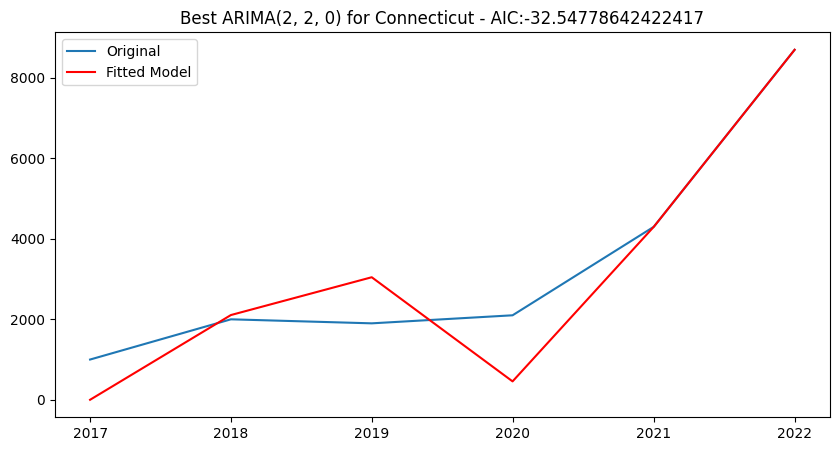

Processing Delaware...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

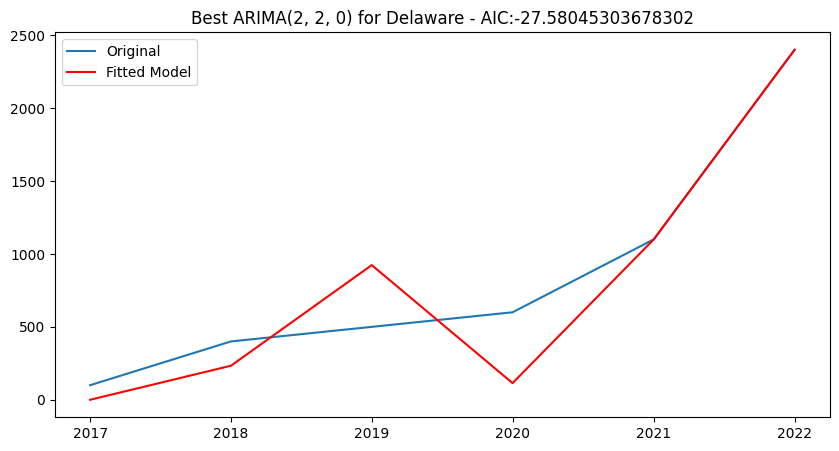

Processing District of Columbia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

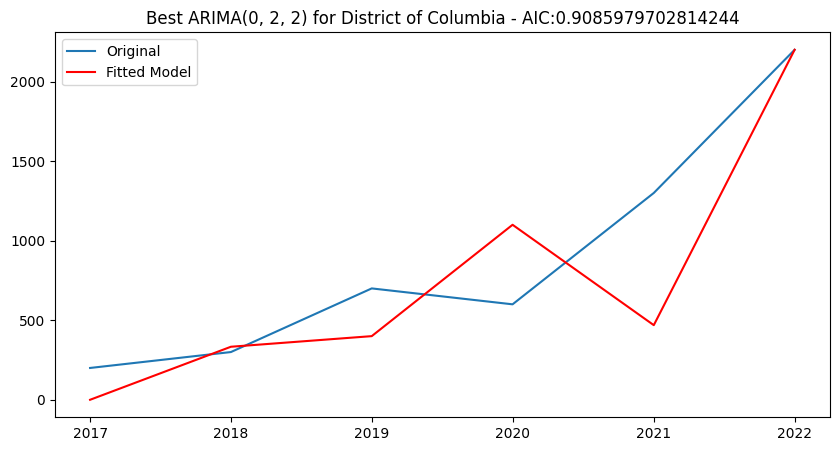

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Florida...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

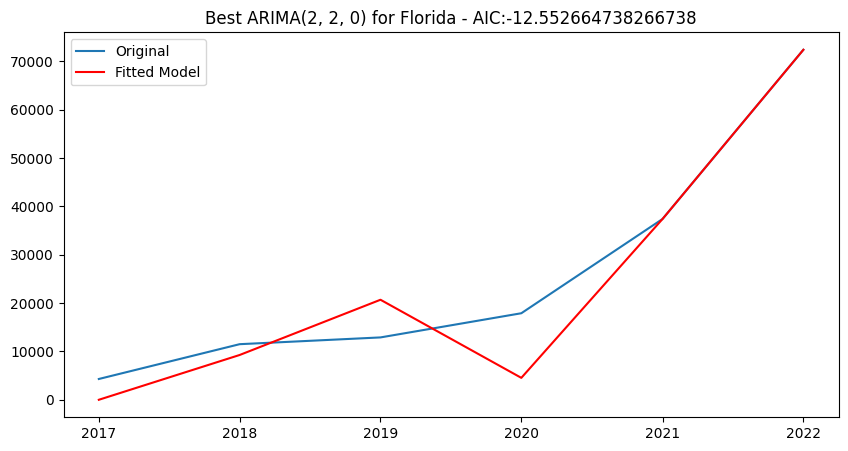

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Georgia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

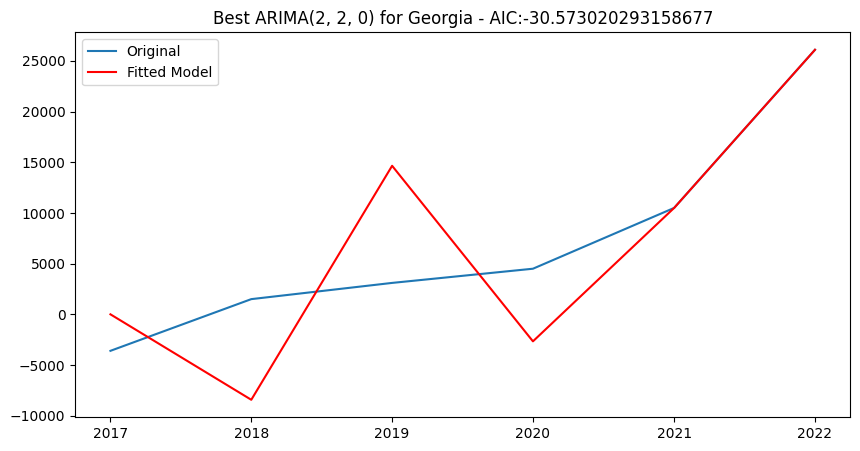

Processing Hawaii...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

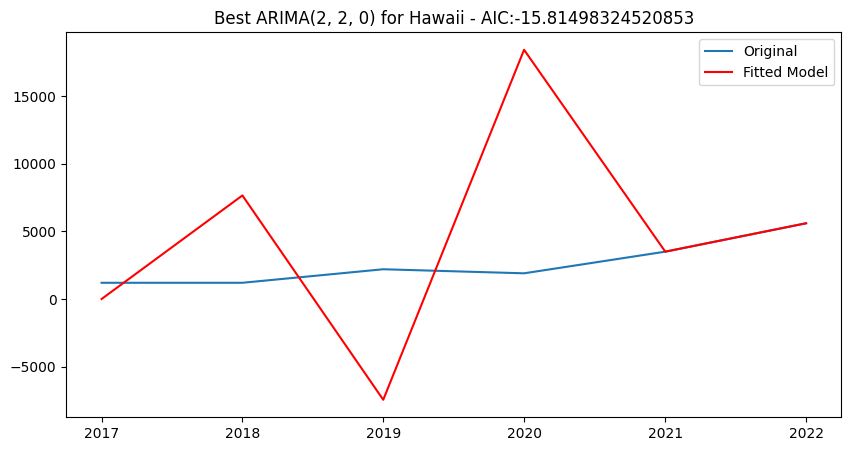

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Idaho...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

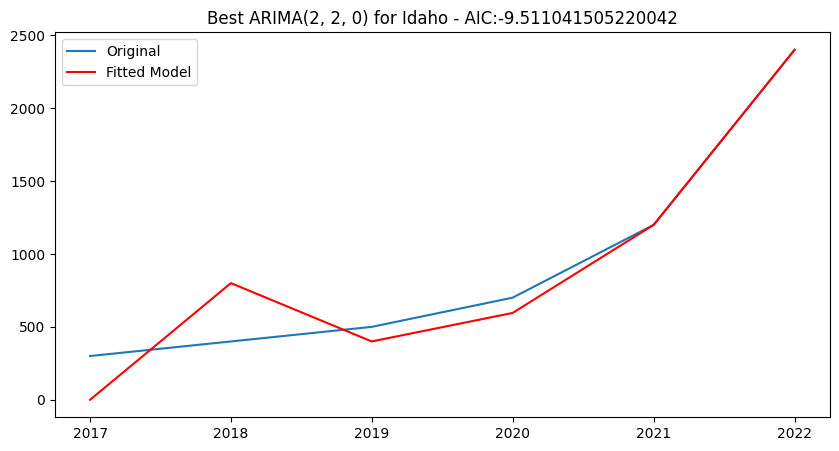

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Illinois...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

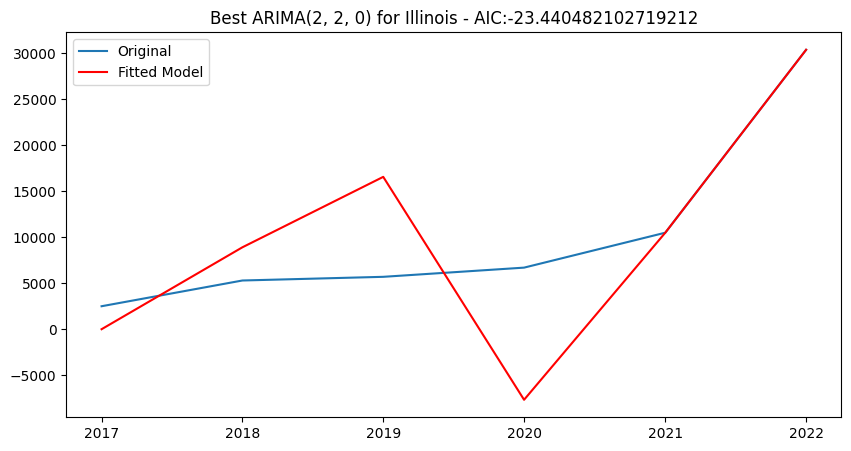

Processing Indiana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

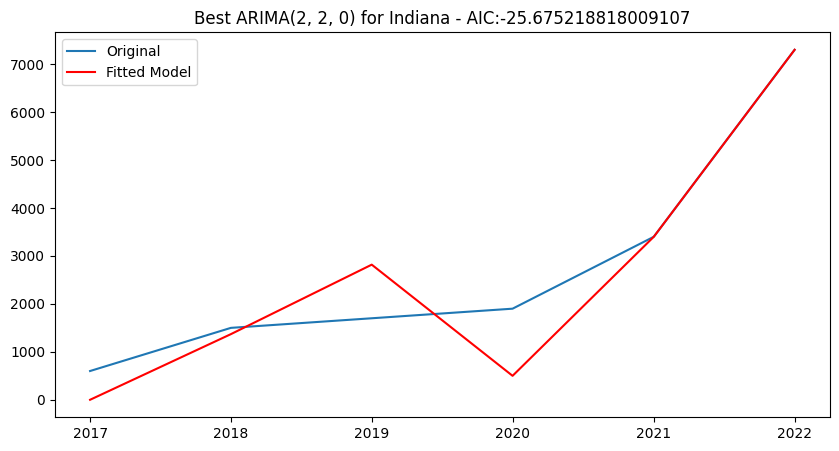

Processing Iowa...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

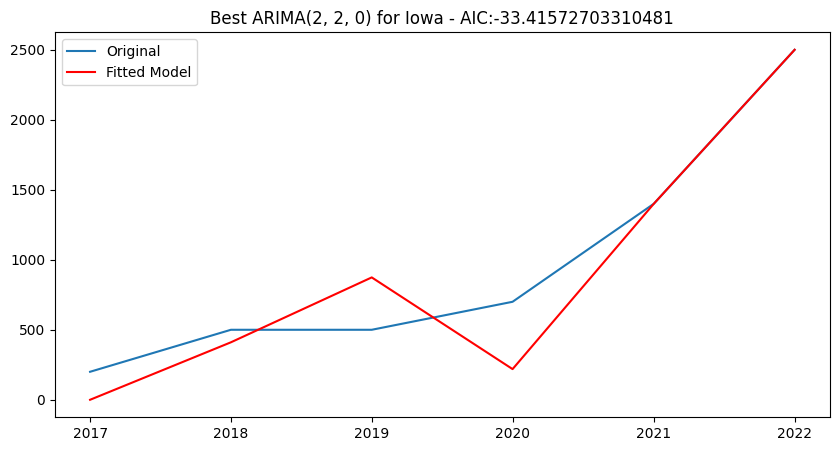

Processing Kansas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

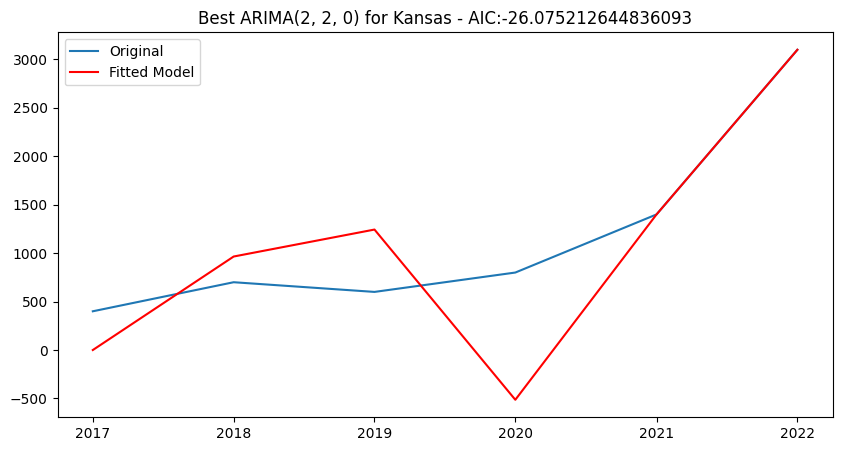

Processing Kentucky...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

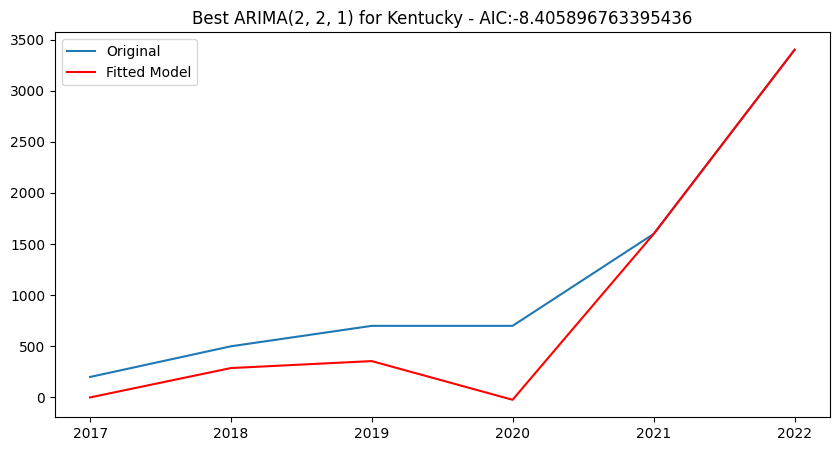

Processing Louisiana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

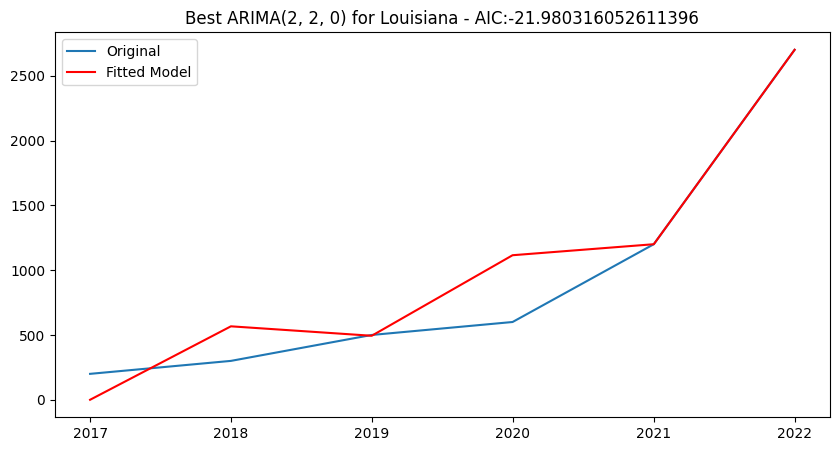

Processing Maine...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

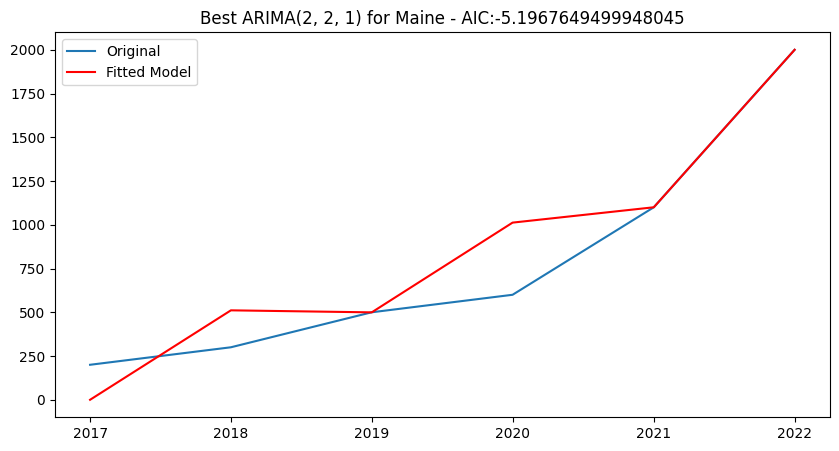

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Maryland...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

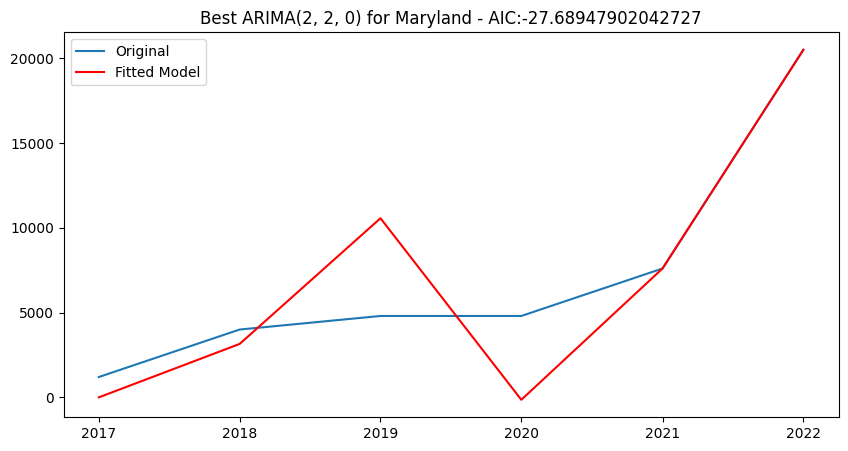

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Massachusetts...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

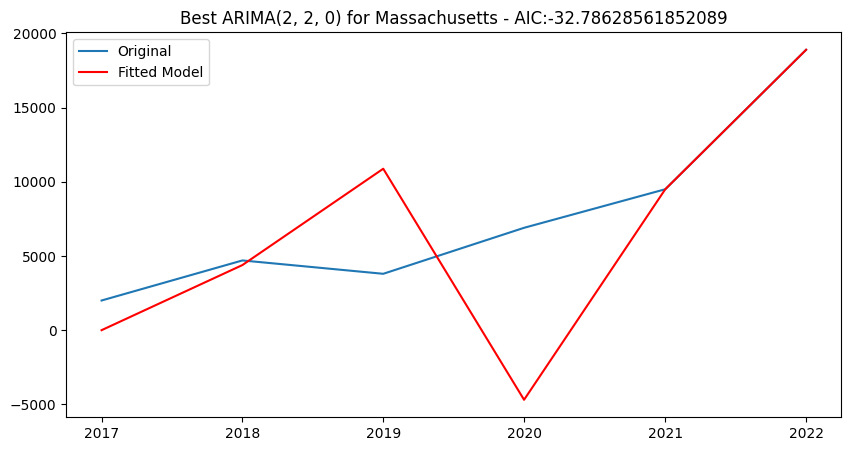

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Michigan...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

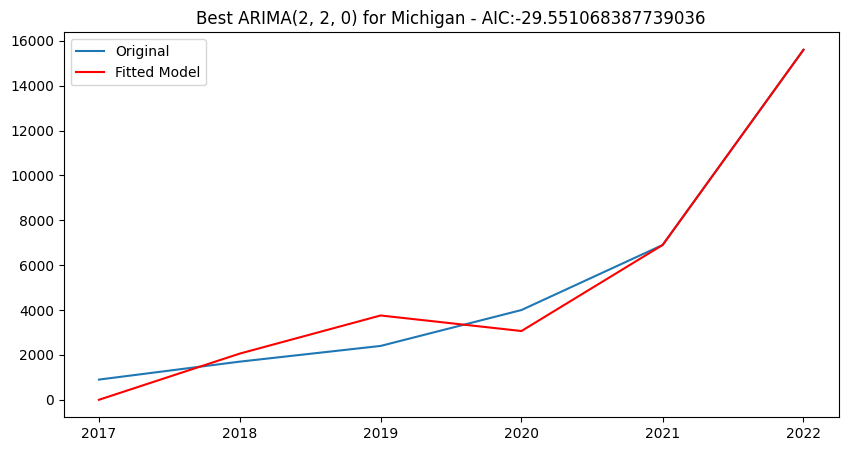

Processing Minnesota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

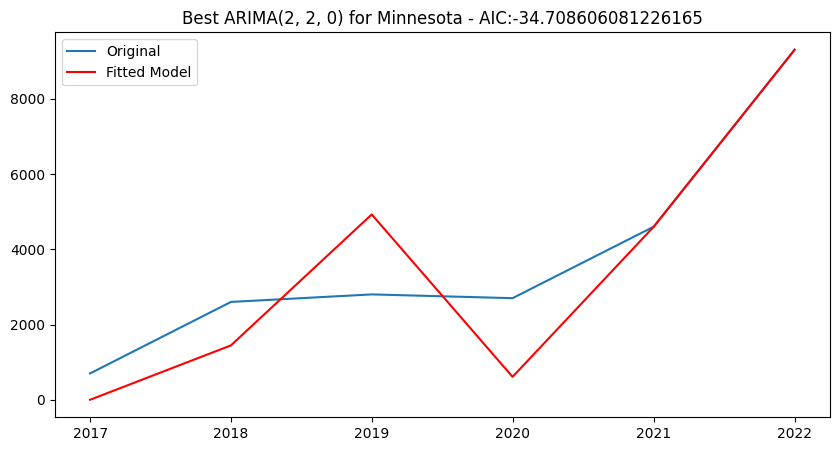

Processing Mississippi...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

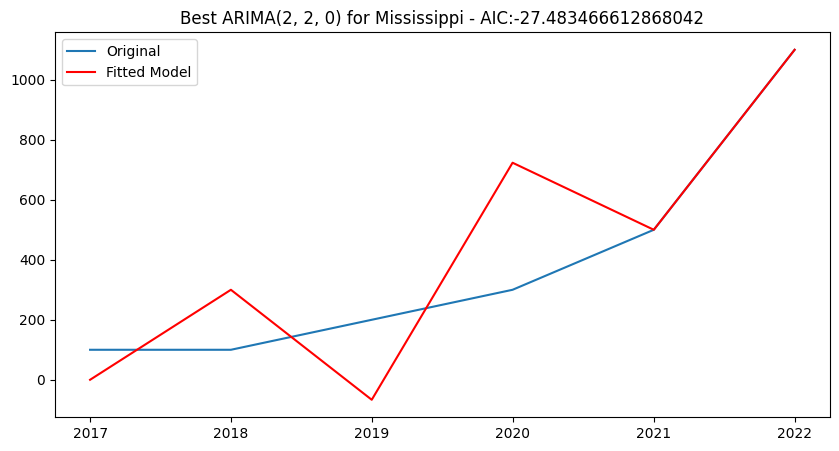

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Missouri...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

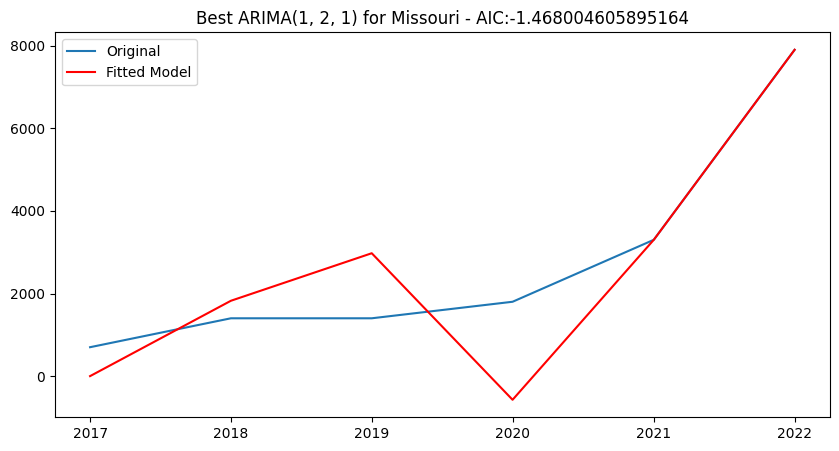

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Montana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

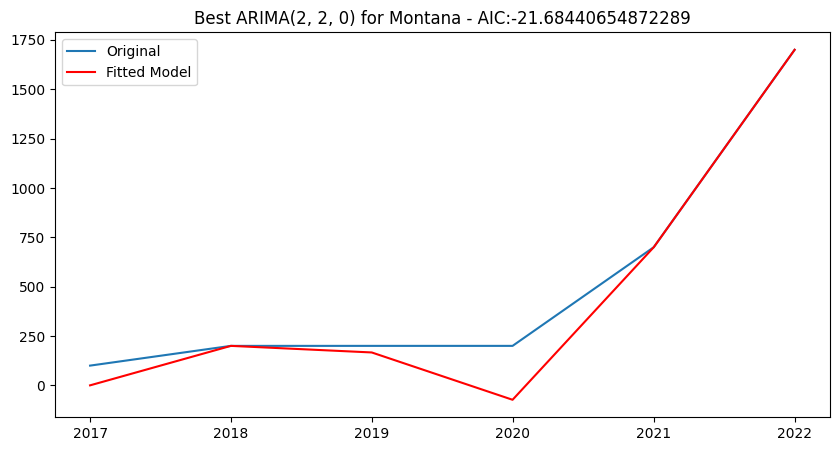

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Nebraska...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

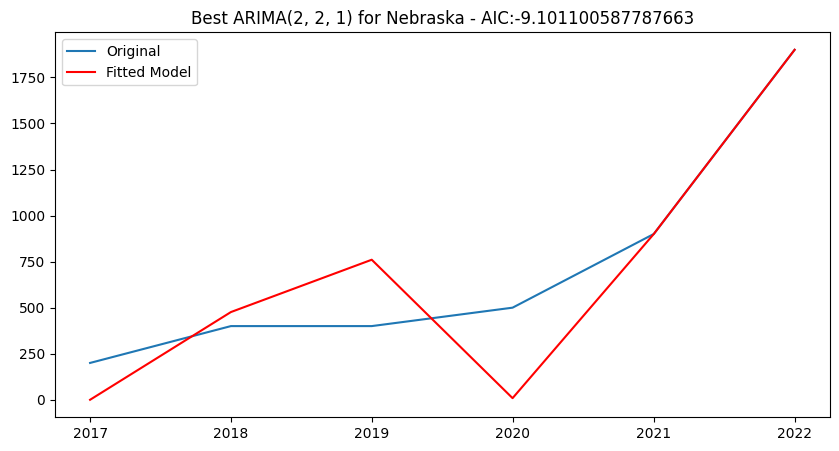

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Nevada...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

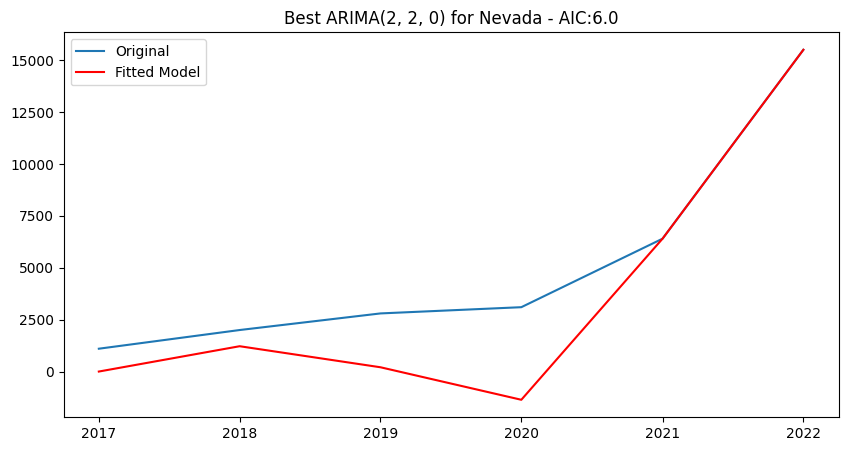

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing New Hampshire...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

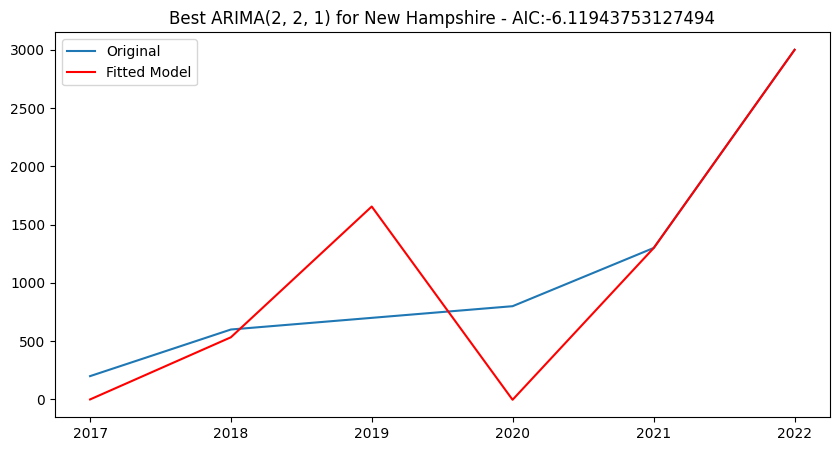

Processing New Jersey...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

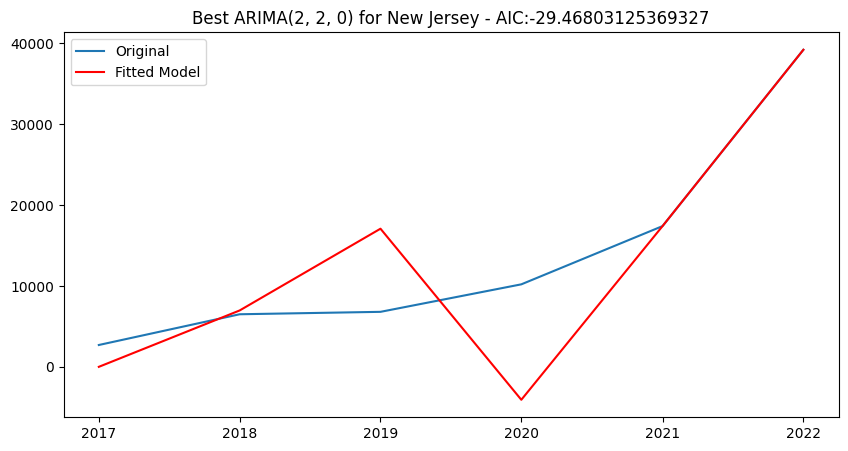

Processing New Mexico...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

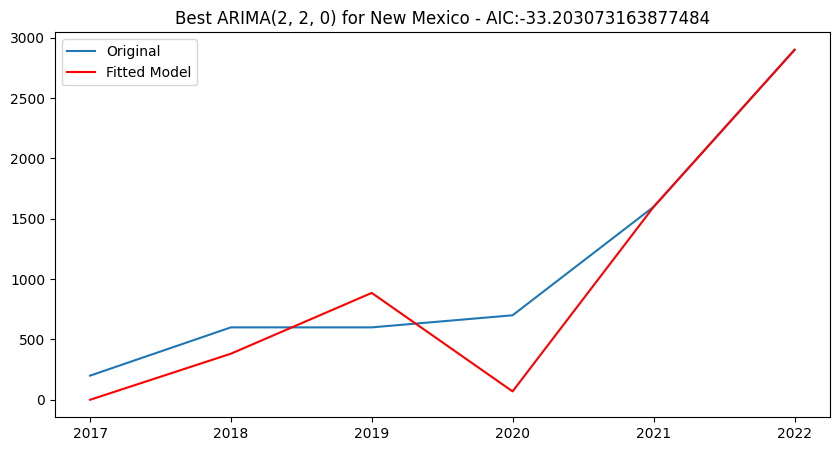

Processing New York...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

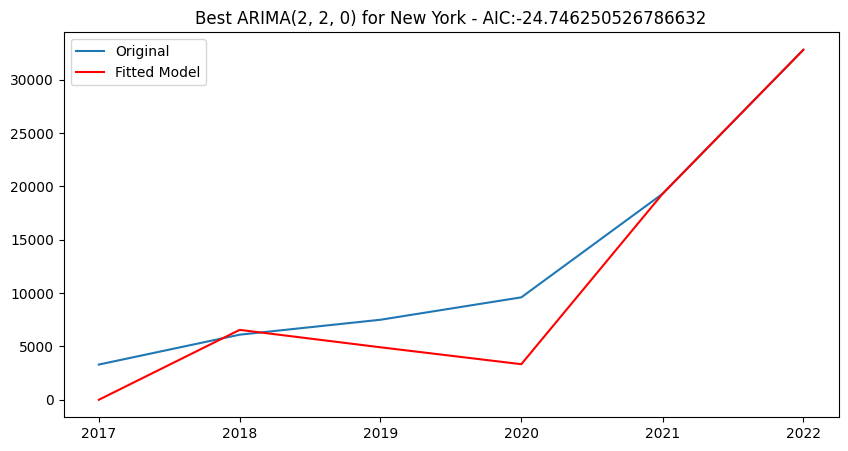

Processing North Carolina...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

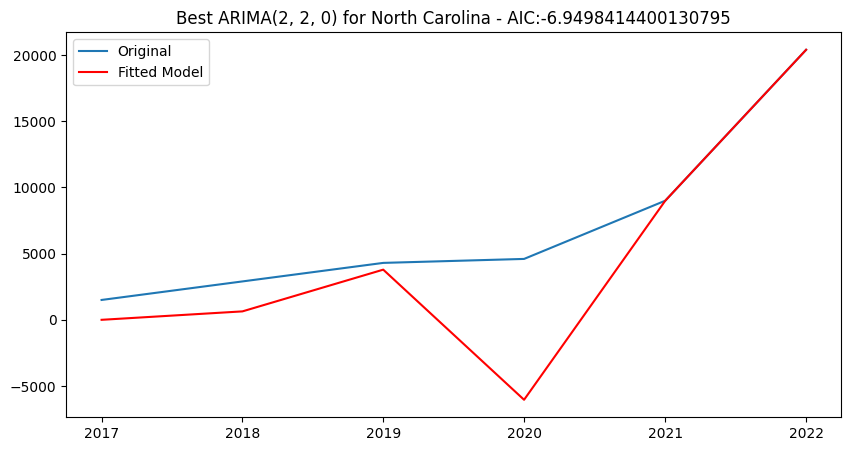

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing North Dakota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

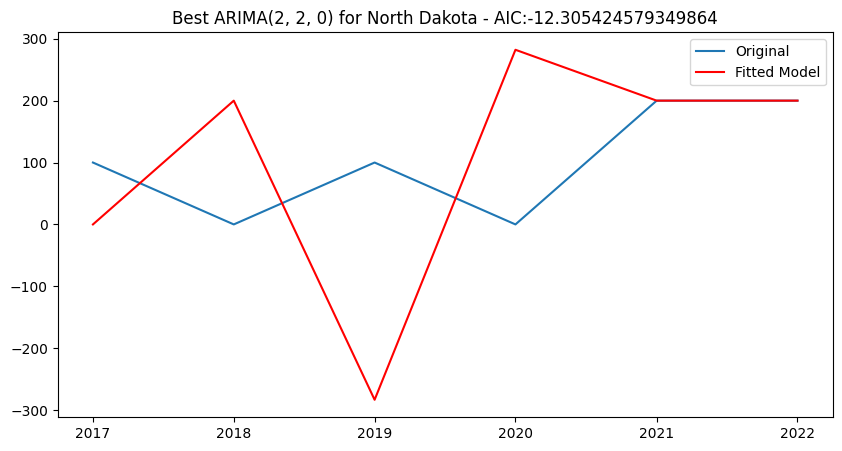

Processing Ohio...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

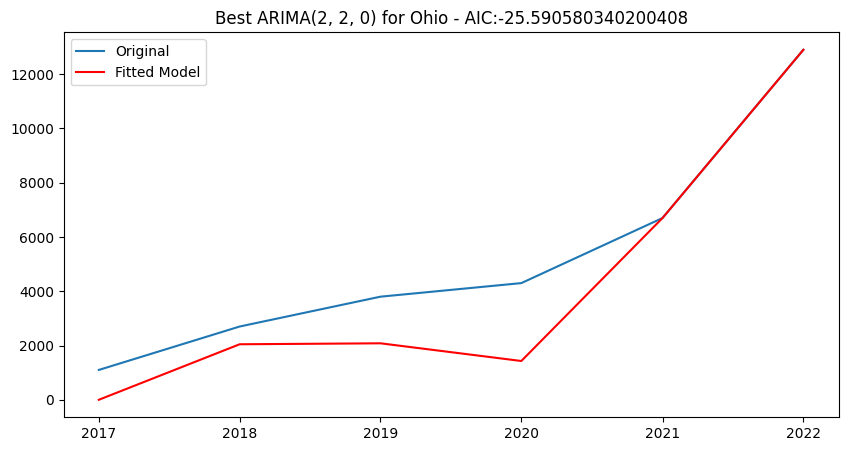

Processing Oklahoma...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

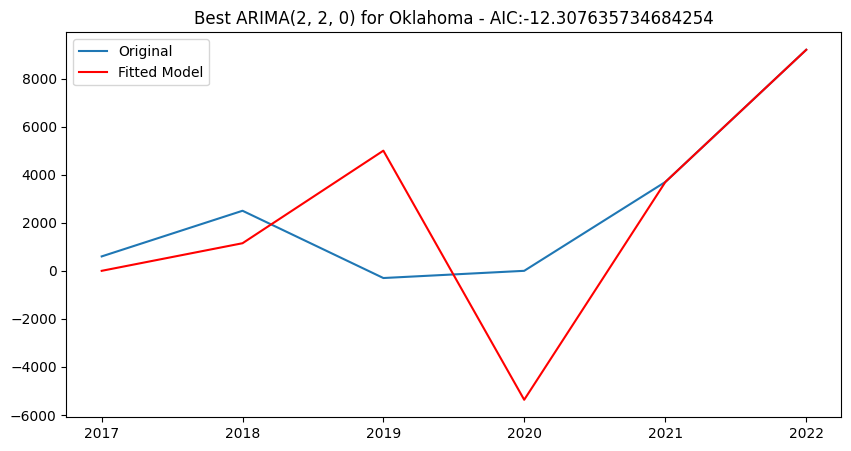

Processing Oregon...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

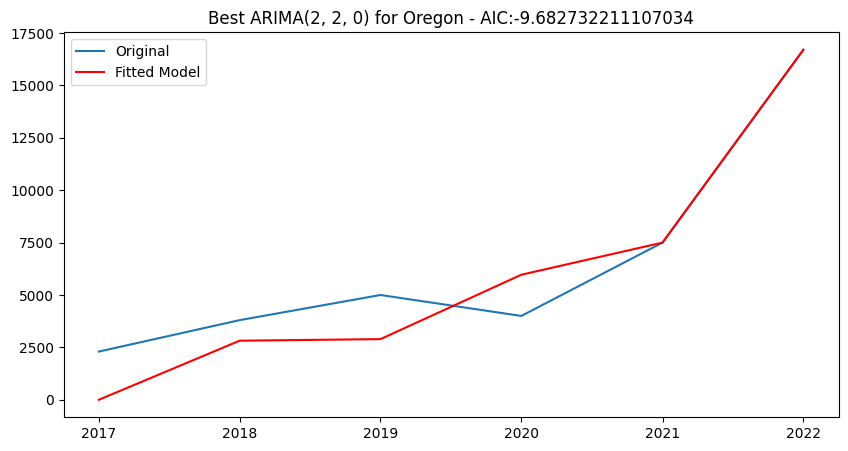

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Pennsylvania...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

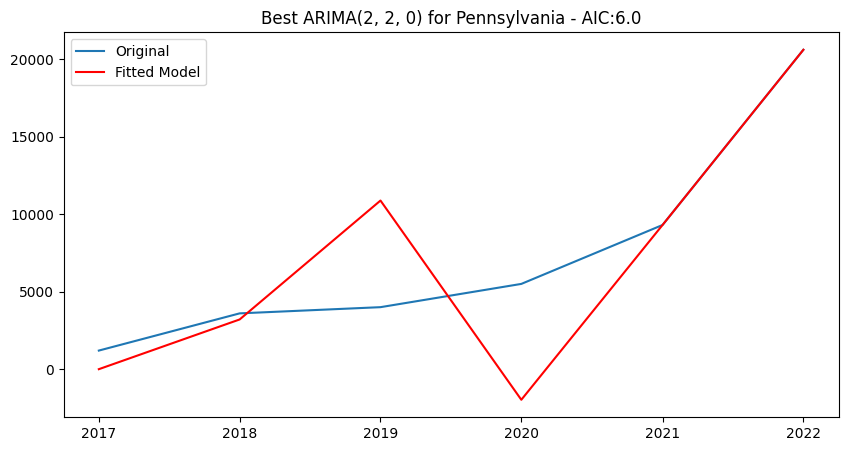

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Rhode Island...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

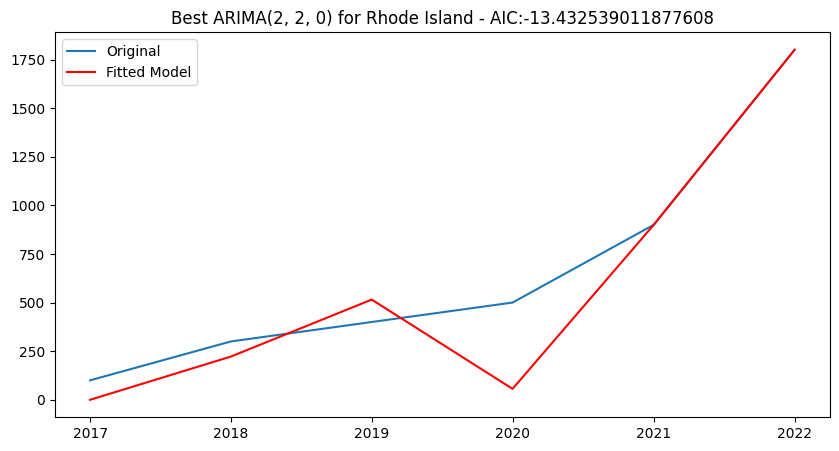

Processing South Carolina...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

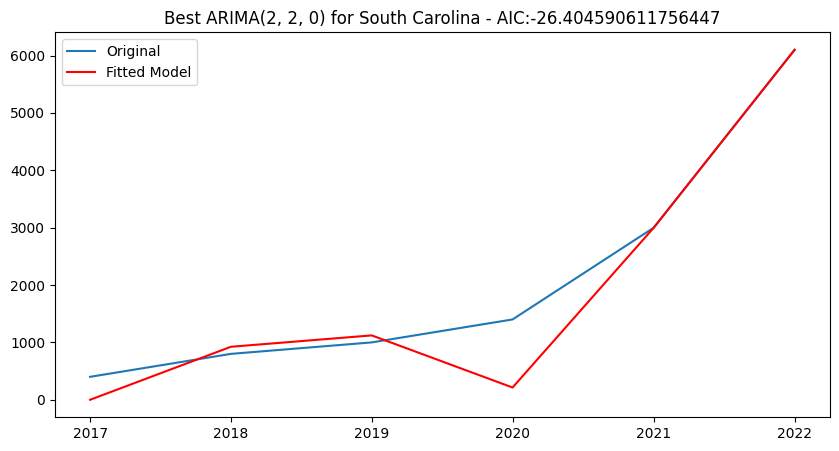

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing South Dakota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

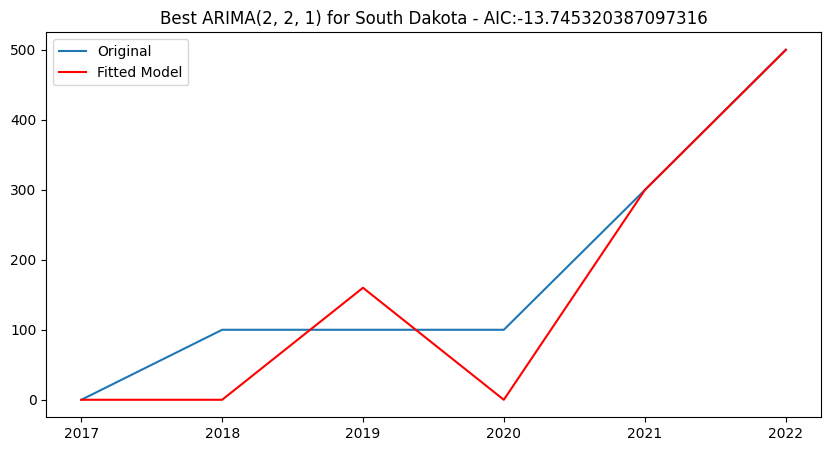

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Tennessee...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

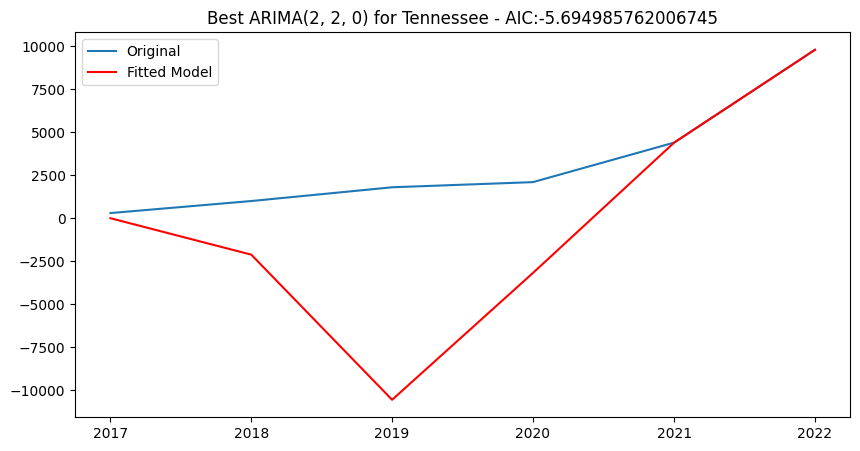

Processing Texas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

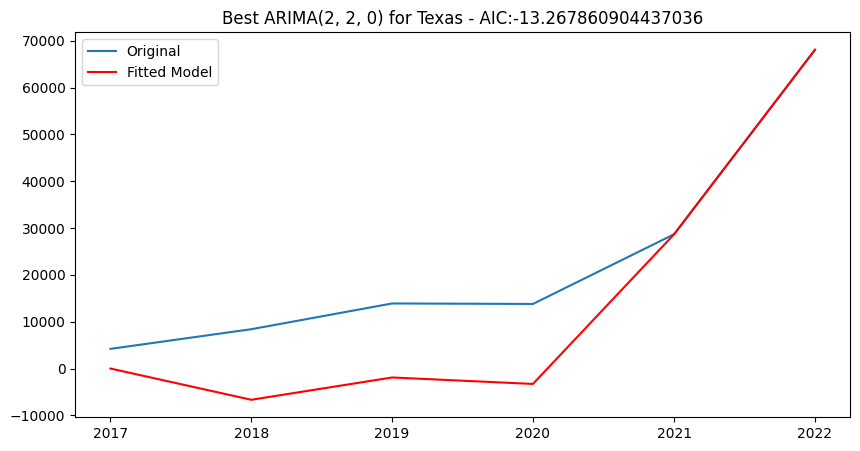

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Utah...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

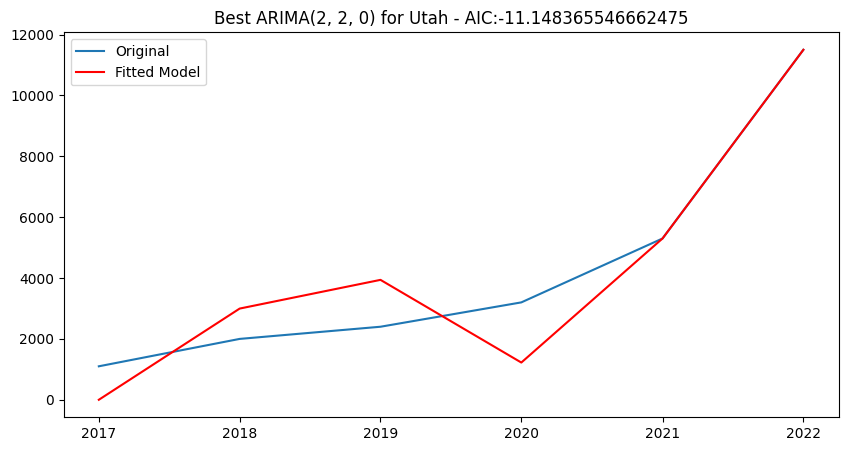

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Vermont...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

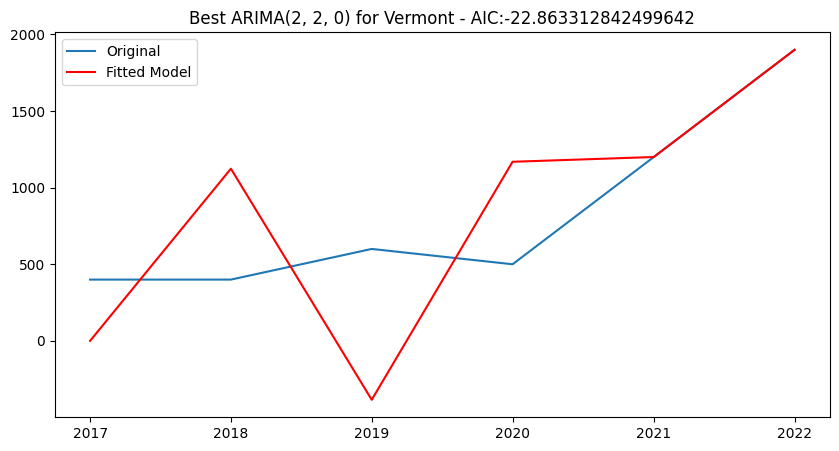

Processing Virginia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

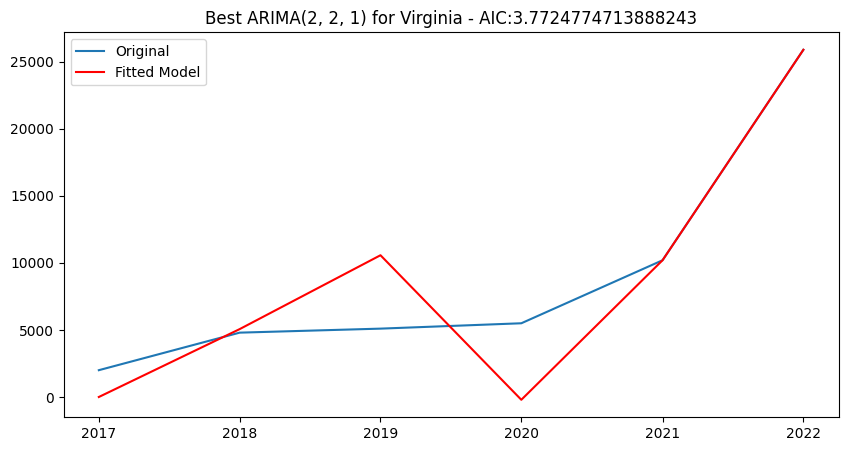

Processing Washington...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

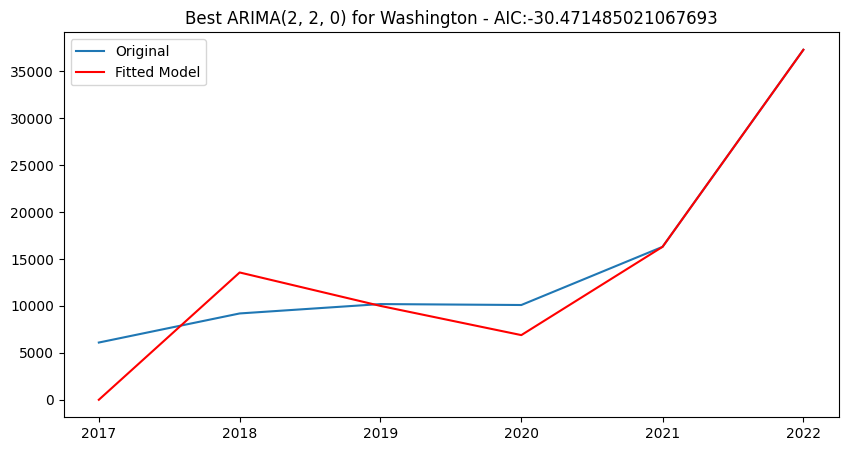

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing West Virginia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

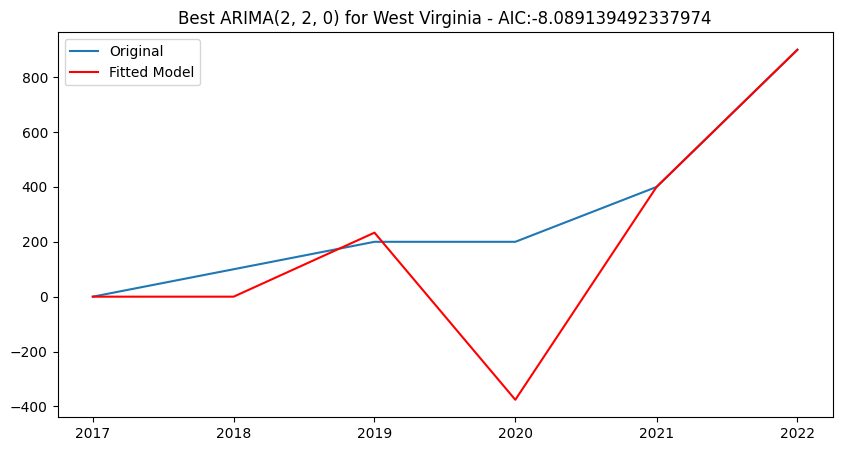

Processing Wisconsin...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

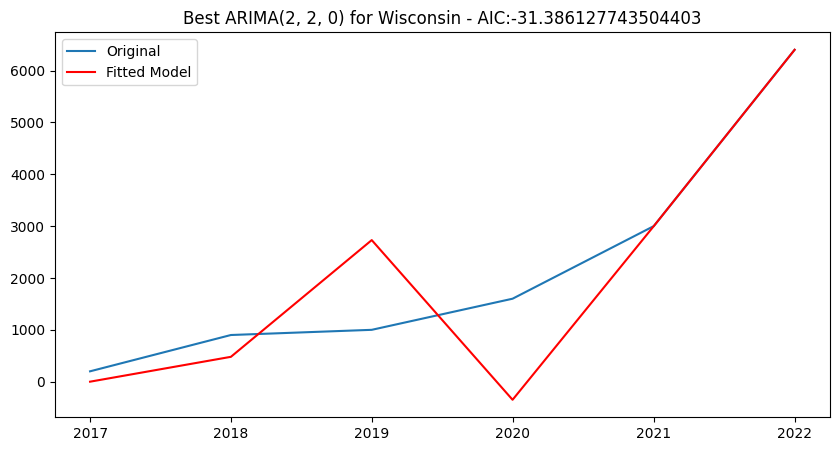

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Wyoming...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

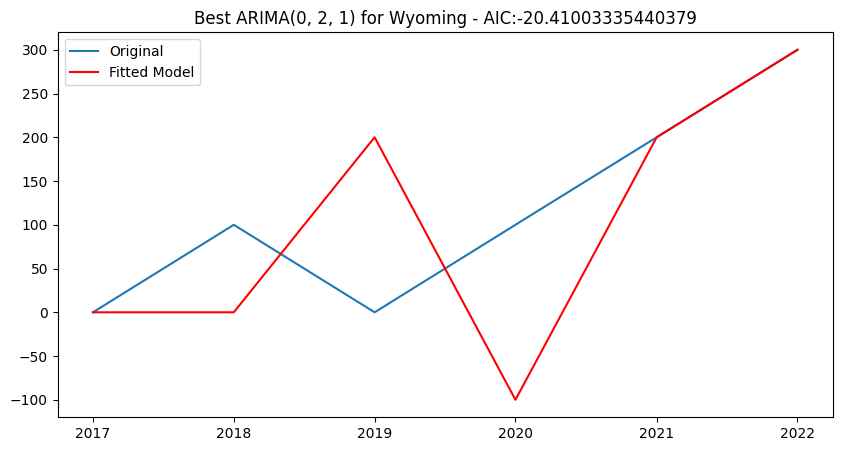

                   State        AIC      Order
0                Alabama   4.511017  (1, 2, 2)
1                 Alaska -31.263063  (2, 2, 0)
2                Arizona  -4.832537  (2, 2, 0)
3               Arkansas -11.485410  (2, 2, 0)
4             California -28.673199  (2, 2, 0)
5               Colorado  -8.094926  (2, 2, 0)
6            Connecticut -32.547786  (2, 2, 0)
7               Delaware -27.580453  (2, 2, 0)
8   District of Columbia   0.908598  (0, 2, 2)
9                Florida -12.552665  (2, 2, 0)
10               Georgia -30.573020  (2, 2, 0)
11                Hawaii -15.814983  (2, 2, 0)
12                 Idaho  -9.511042  (2, 2, 0)
13              Illinois -23.440482  (2, 2, 0)
14               Indiana -25.675219  (2, 2, 0)
15                  Iowa -33.415727  (2, 2, 0)
16                Kansas -26.075213  (2, 2, 0)
17              Kentucky  -8.405897  (2, 2, 1)
18             Louisiana -21.980316  (2, 2, 0)
19                 Maine  -5.196765  (2, 2, 1)
20           

In [55]:
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from itertools import product
import matplotlib.pyplot as plt

# Load your dataset
df = pd.read_csv("combined_data.csv")
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

# Function to test stationarity
def test_stationarity(timeseries):
    result = adfuller(timeseries, autolag='AIC')
    return result[1]  # return p-value

# Parameters range
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

def optimize_arima(series, pdq):
    best_aic = np.inf
    best_order = None
    best_mdl = None

    for param in pdq:
        try:
            model = SARIMAX(series,
                            order=param,
                            enforce_stationarity=False,
                            enforce_invertibility=False)
            results = model.fit(disp=0)
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_mdl = results
        except:
            continue
    return best_aic, best_order, best_mdl

# Store results
results = []

# Iterate through each state
states = df['State'].unique()
for state in states:
    print(f"Processing {state}...")
    state_data = df[df['State'] == state]['Electric (EV)']
    
    # Ensure data is stationary
    if test_stationarity(state_data) > 0.05:
        state_data = state_data.diff().dropna()  # Differencing to make data stationary
    
    if len(state_data.dropna()) > 0:
        best_aic, best_order, best_model = optimize_arima(state_data, pdq)
        
        if best_model:
            results.append({
                'State': state,
                'AIC': best_aic,
                'Order': best_order
            })
            
            # Plotting each state's forecast
            plt.figure(figsize=(10, 5))
            plt.plot(state_data.index, state_data, label='Original')
            plt.plot(state_data.index, best_model.fittedvalues, color='red', label='Fitted Model')
            plt.title(f'Best ARIMA{best_order} for {state} - AIC:{best_aic}')
            plt.legend()
            plt.show()

# Convert results to DataFrame
results_df = pd.DataFrame(results)
print(results_df)


Processing Alabama...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

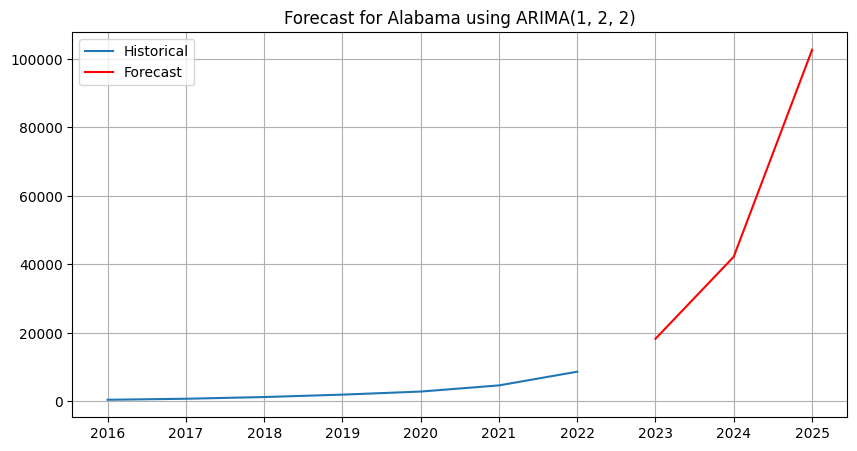

Processing Alaska...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

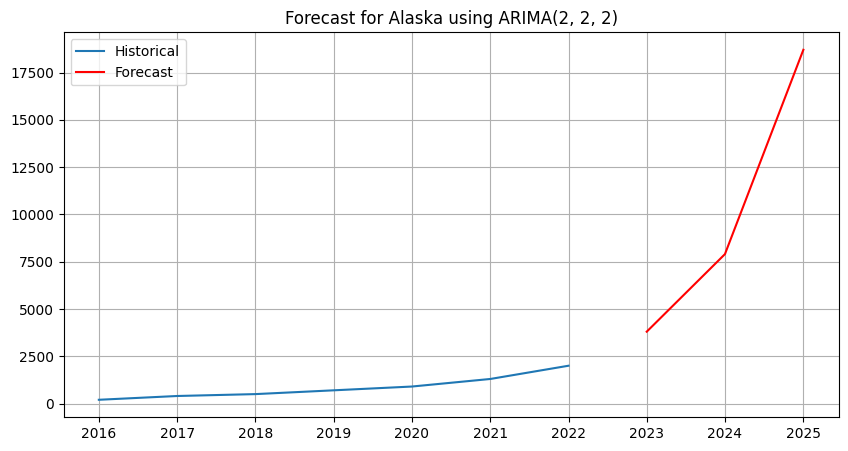

Processing Arizona...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

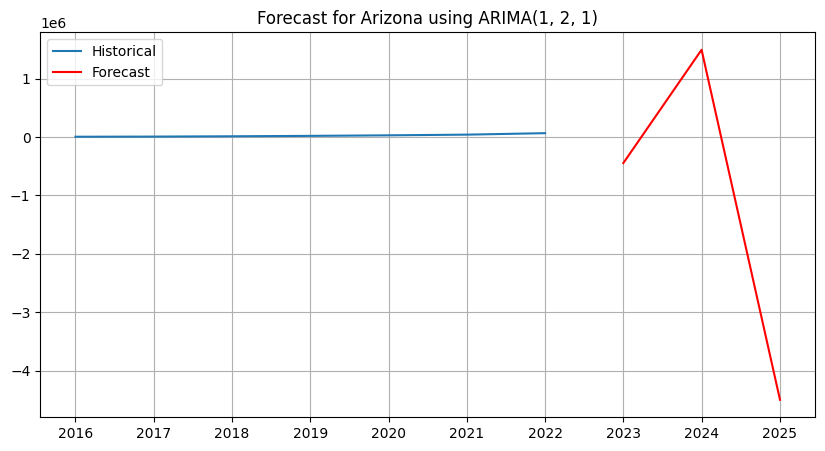

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Arkansas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

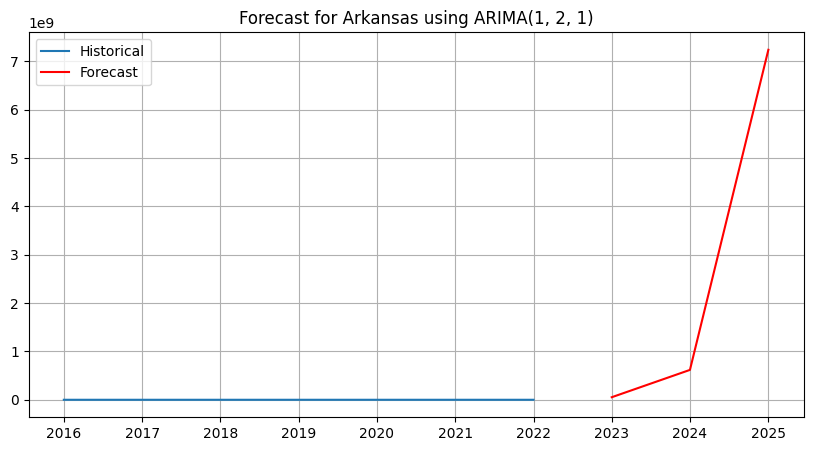

Processing California...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

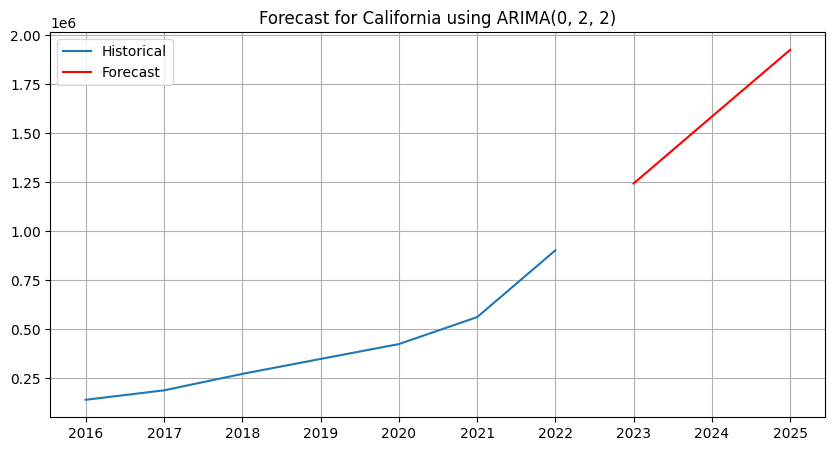

Processing Colorado...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

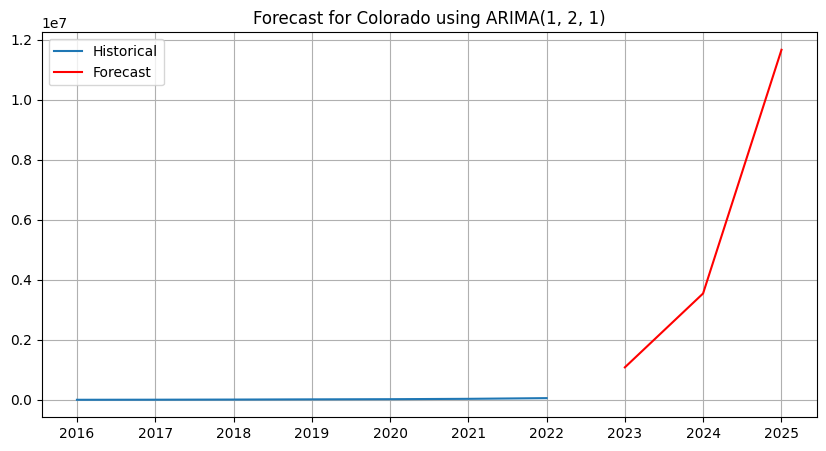

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Connecticut...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

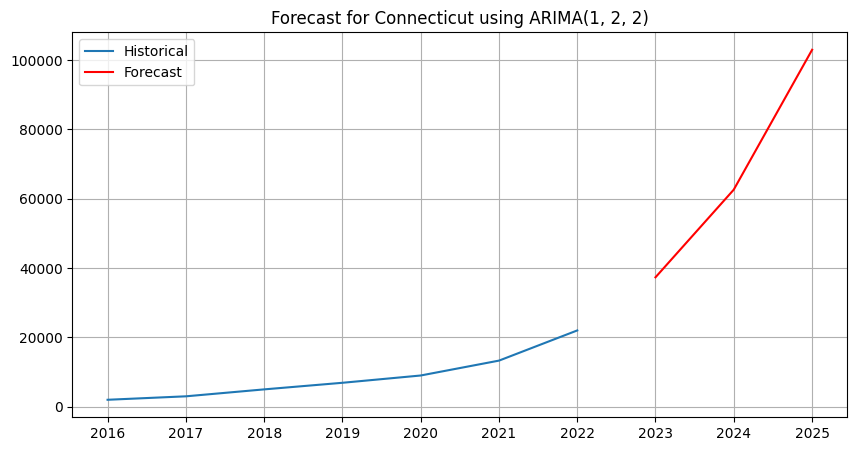

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Delaware...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

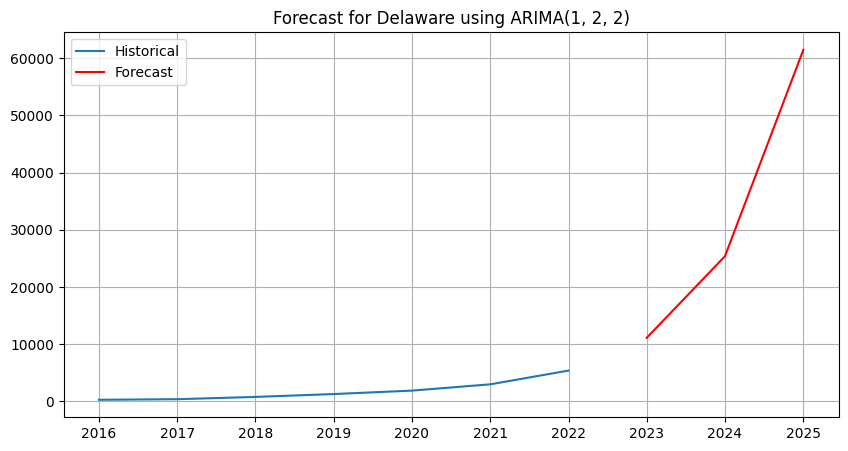

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing District of Columbia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

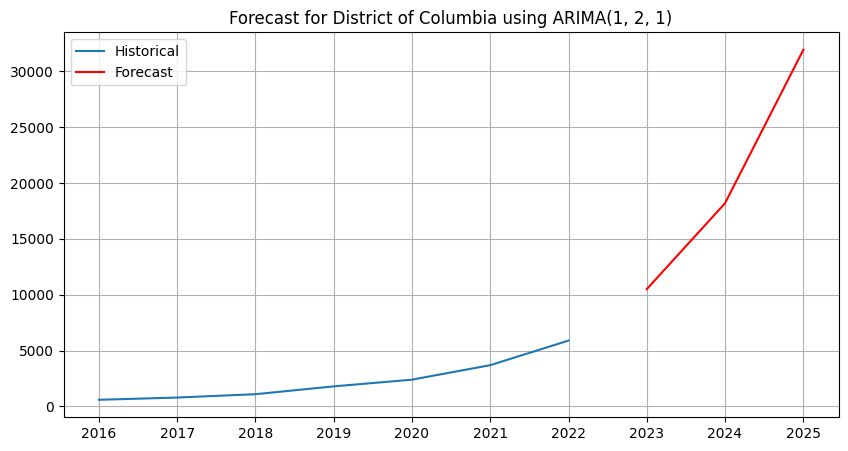

Processing Florida...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

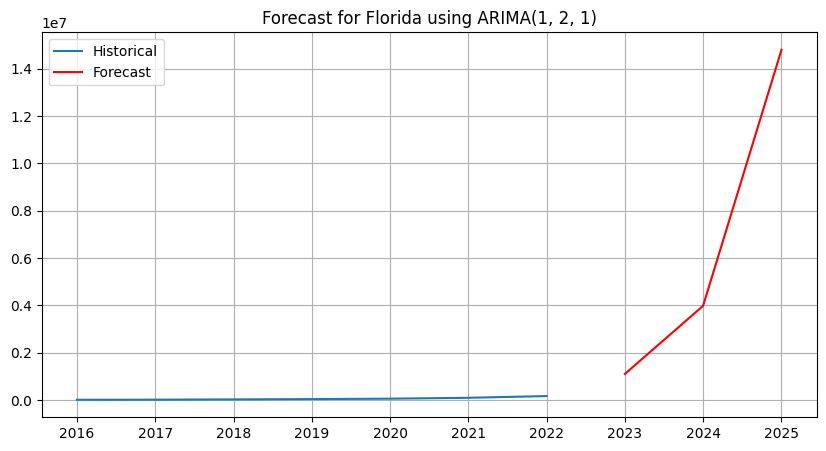

Processing Georgia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

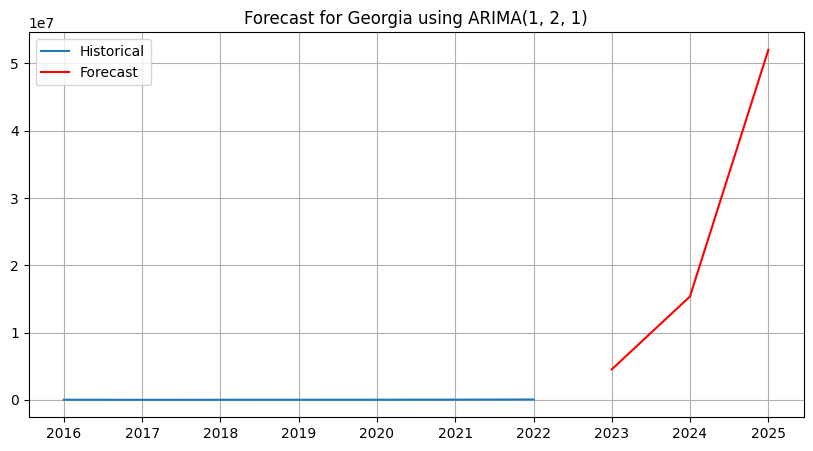

Processing Hawaii...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

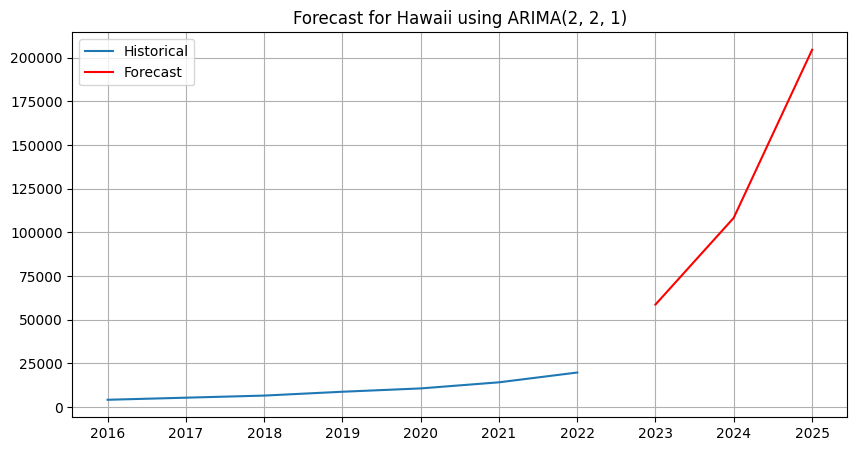

Processing Idaho...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

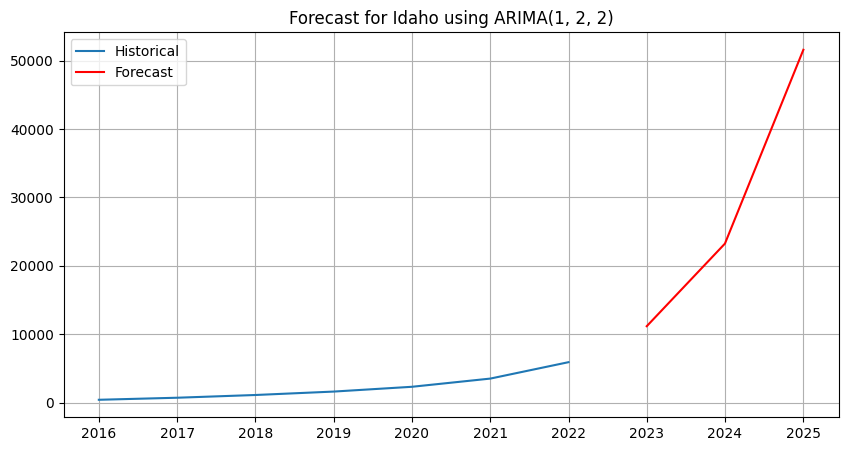

Processing Illinois...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

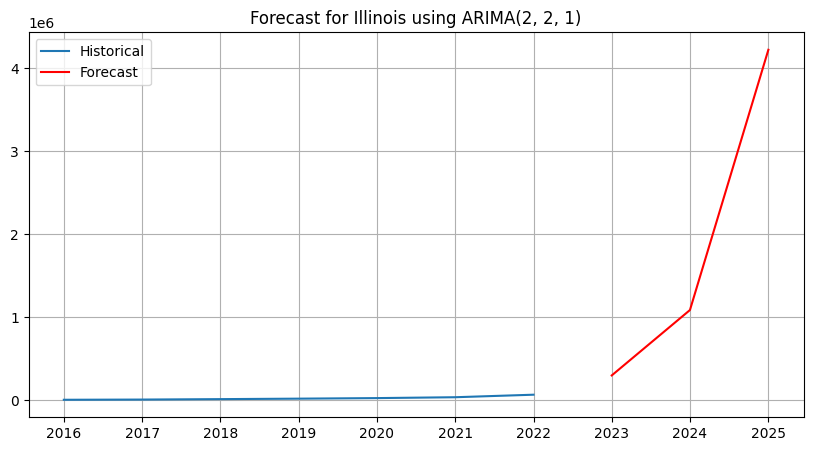

Processing Indiana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

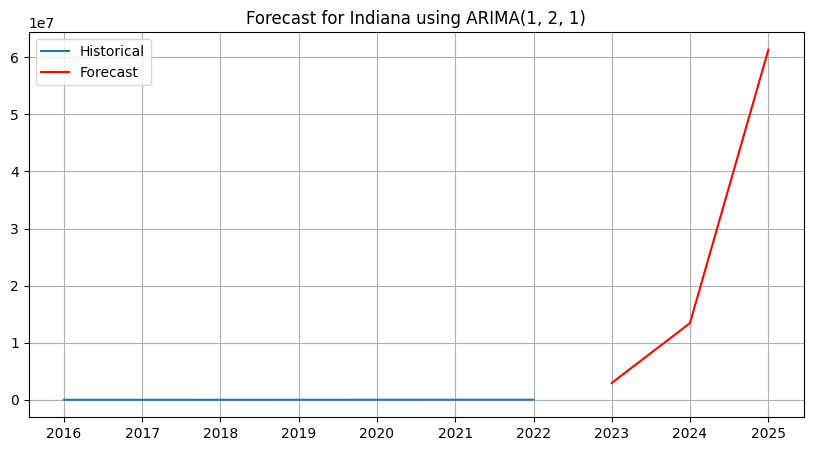

Processing Iowa...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

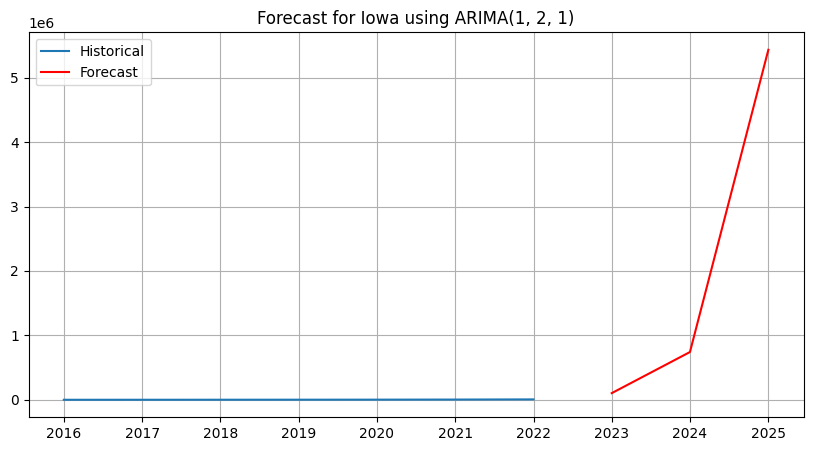

Processing Kansas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

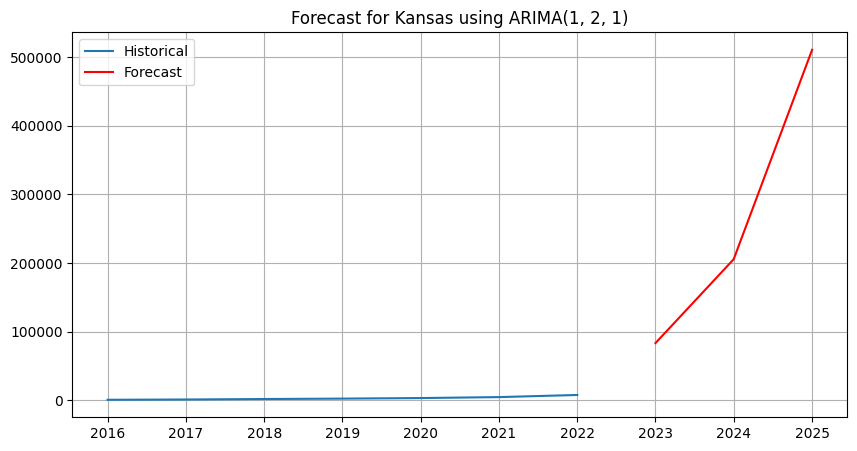

Processing Kentucky...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

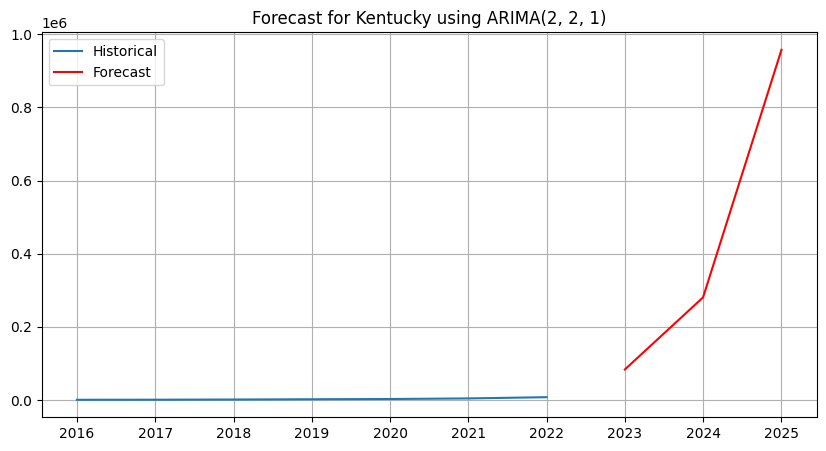

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Louisiana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

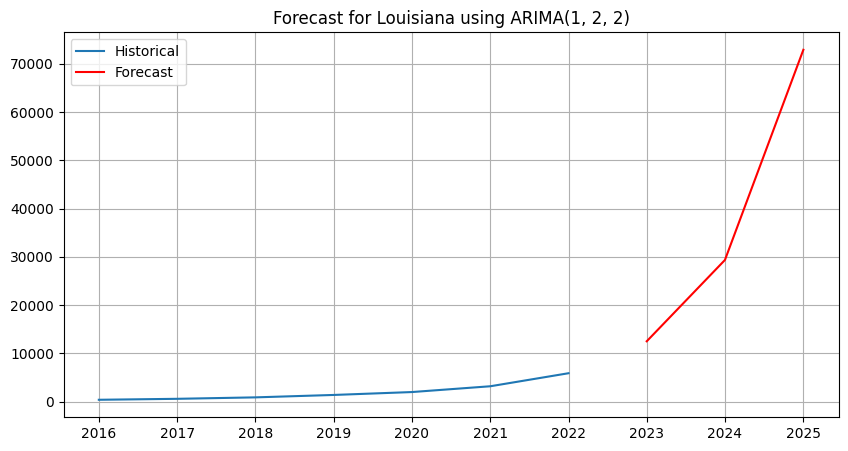

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Maine...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

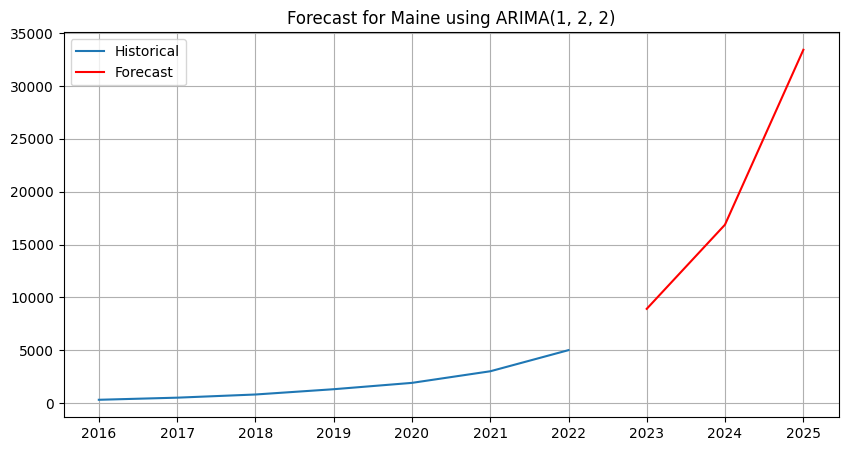

Processing Maryland...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

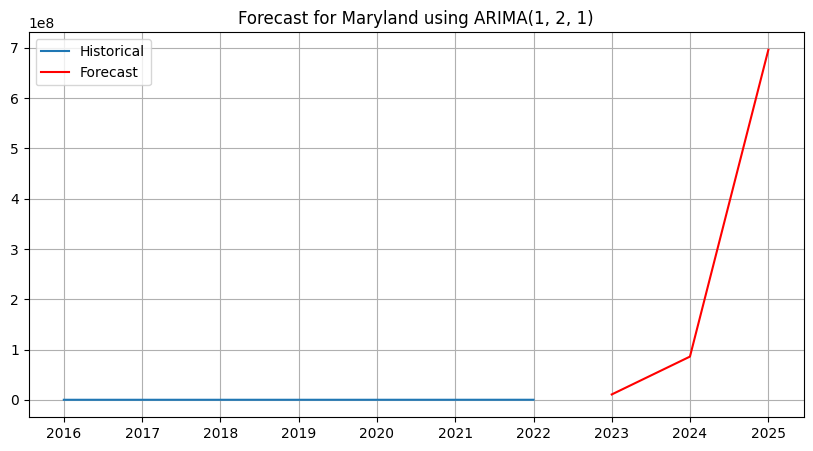

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Massachusetts...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

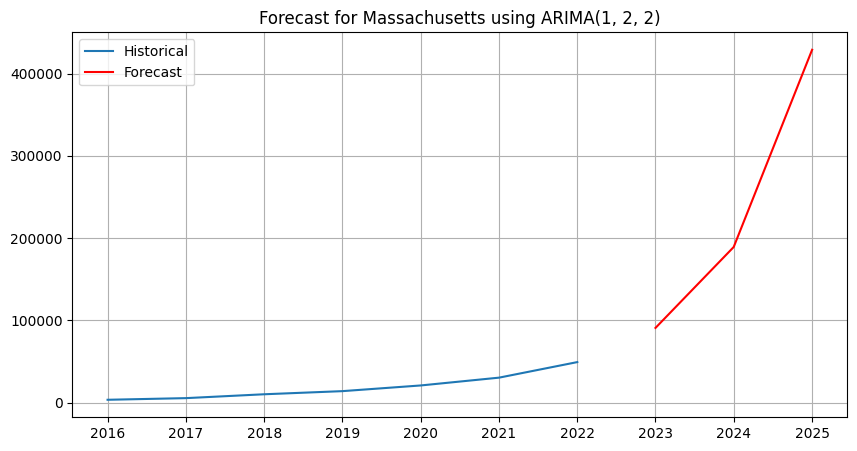

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Michigan...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

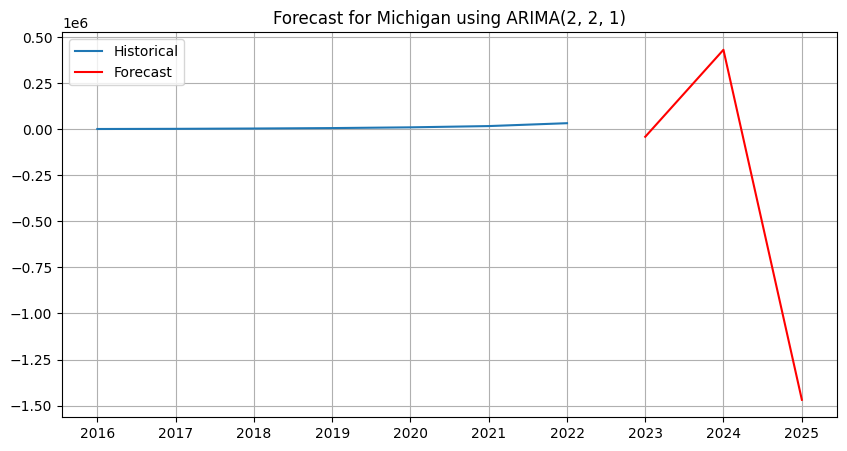

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Minnesota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

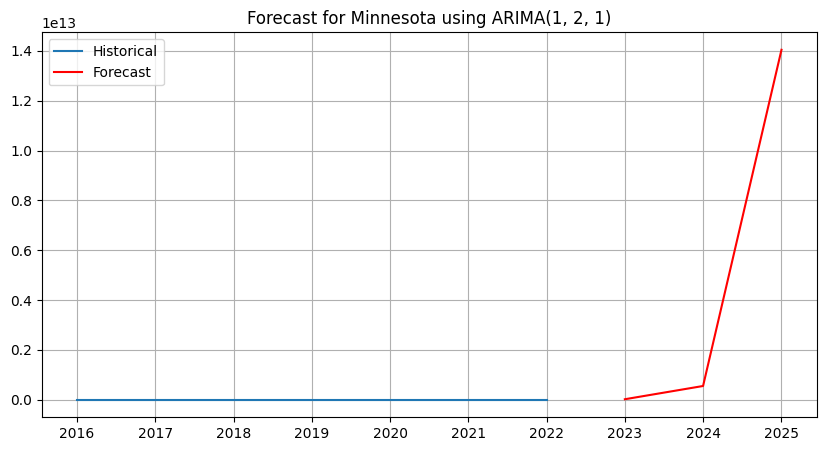

Processing Mississippi...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

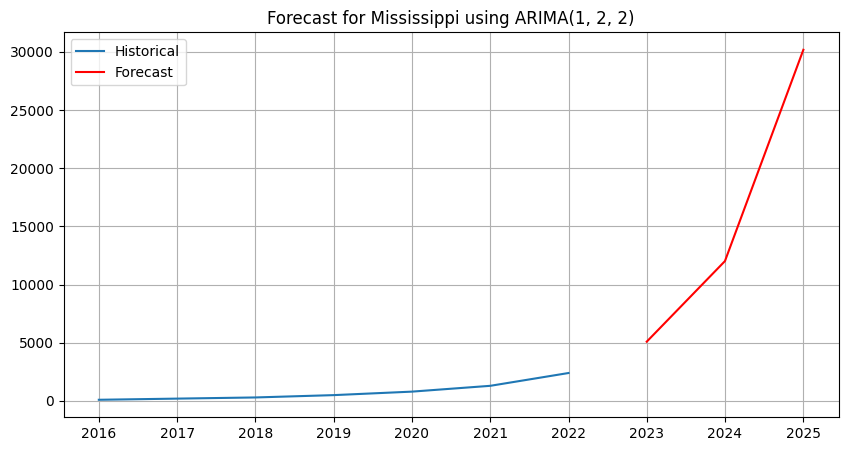

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Missouri...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

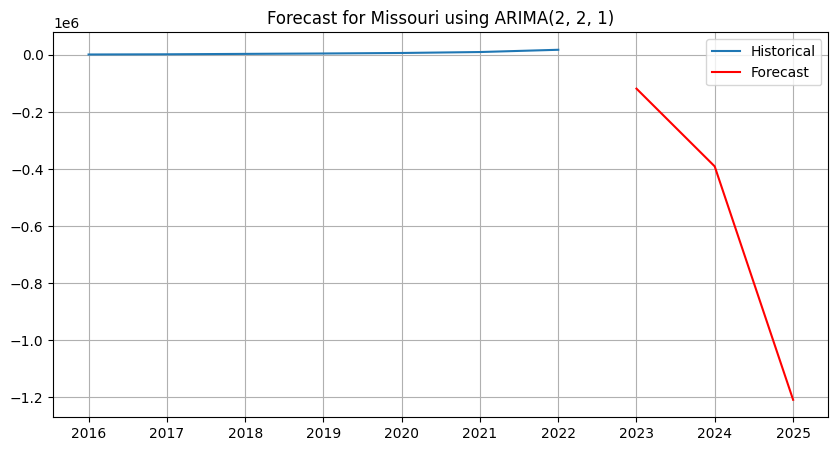

Processing Montana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

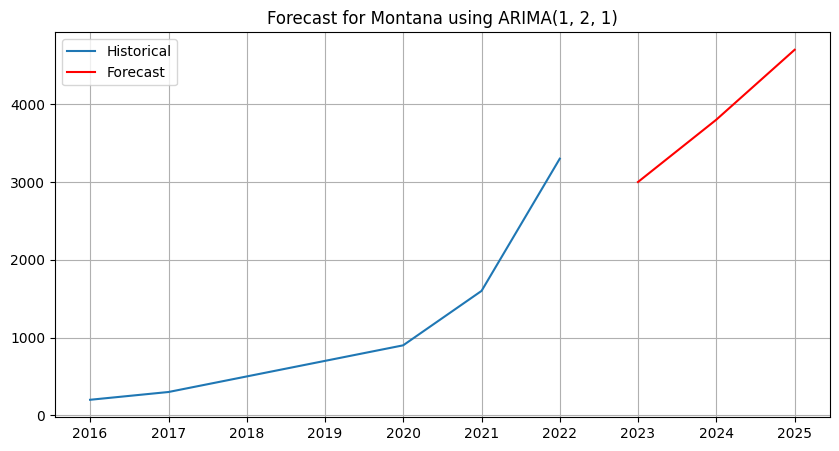

Processing Nebraska...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

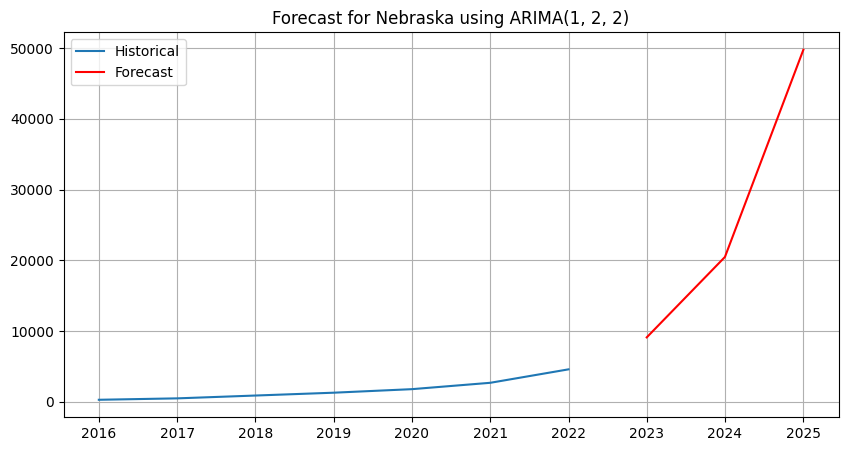

Processing Nevada...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

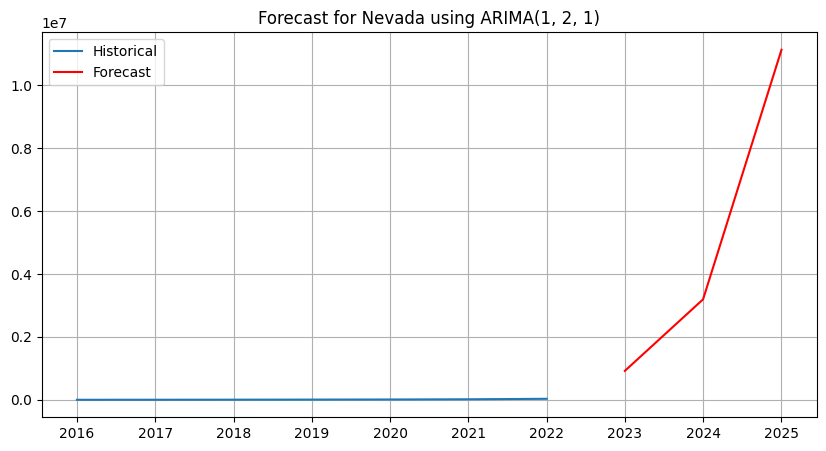

Processing New Hampshire...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

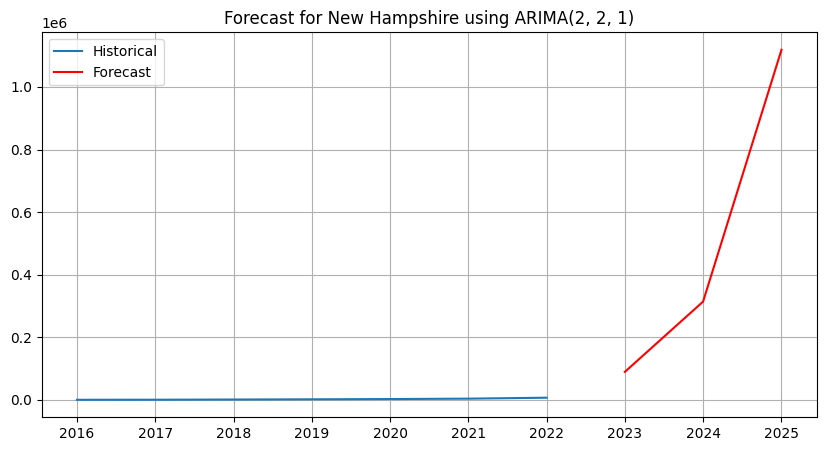

Processing New Jersey...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

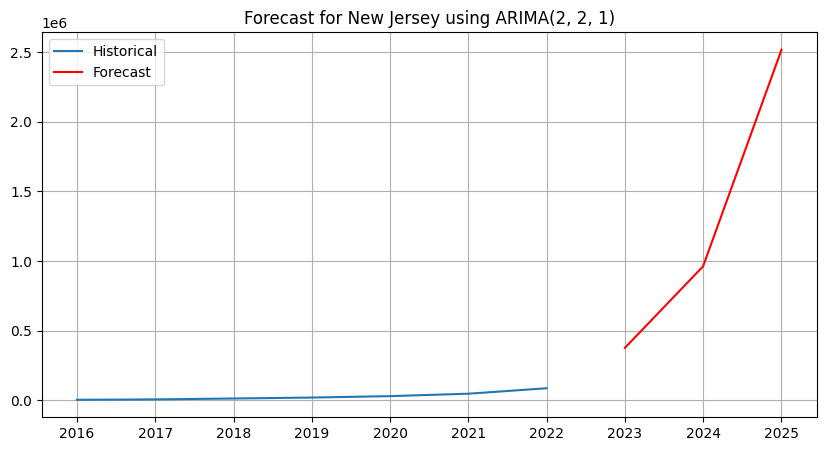

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing New Mexico...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

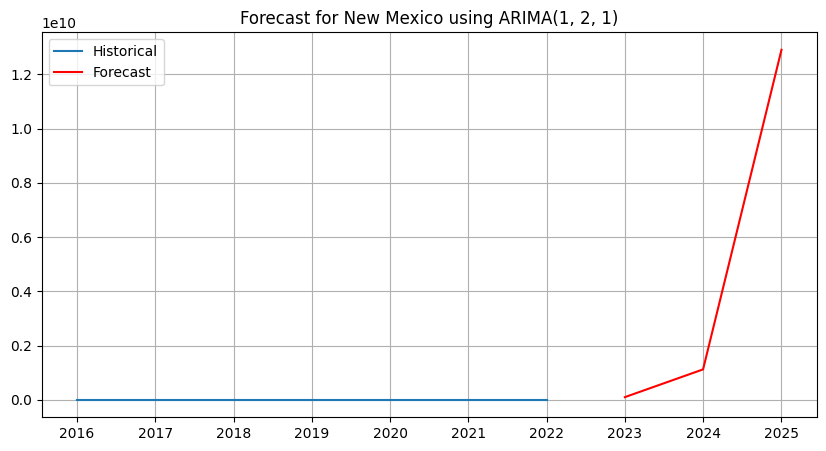

Processing New York...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

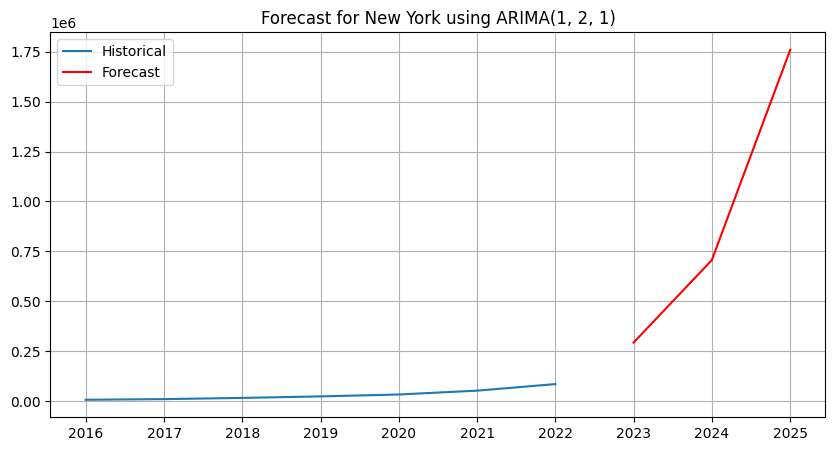

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing North Carolina...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

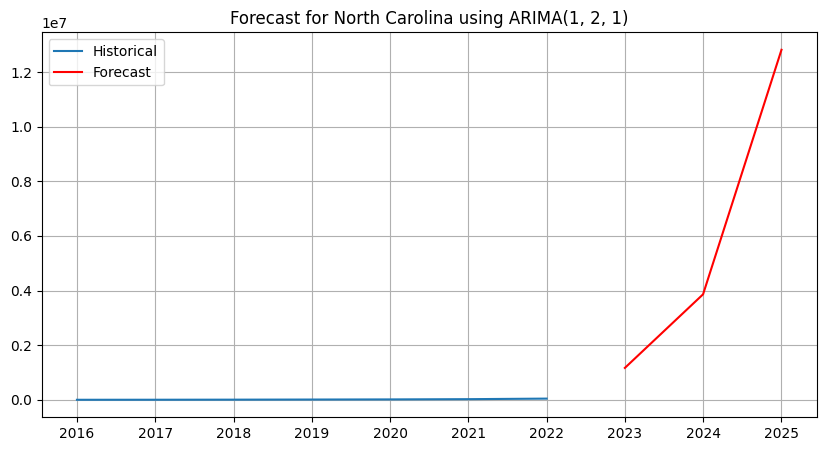

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing North Dakota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

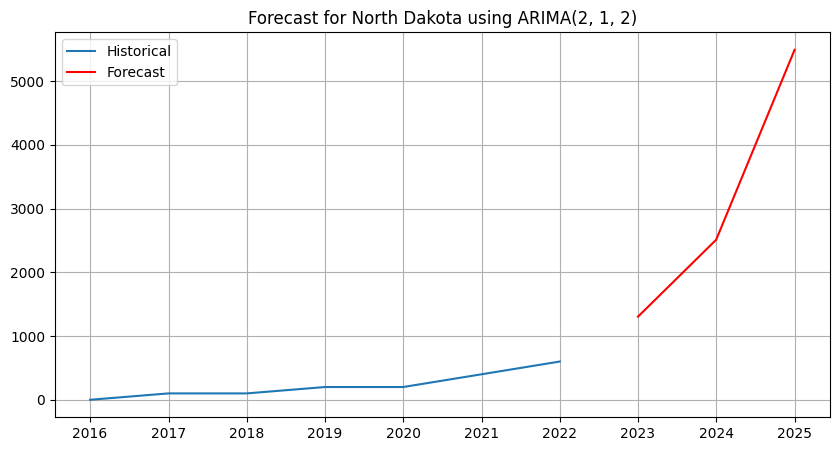

Processing Ohio...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

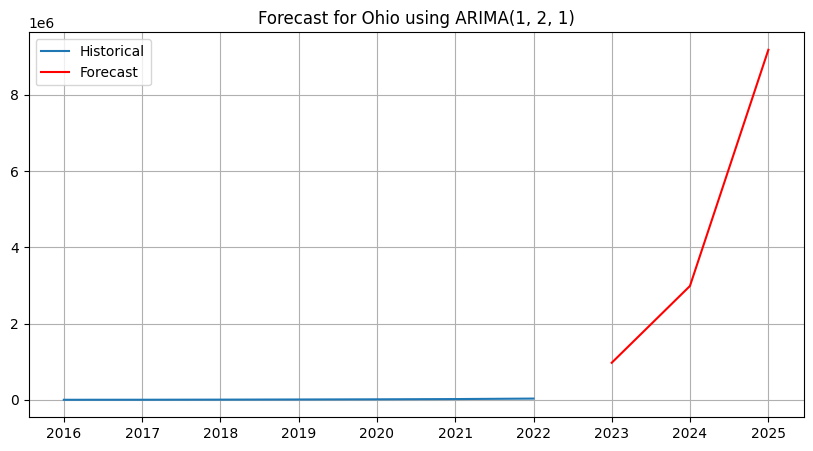

Processing Oklahoma...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

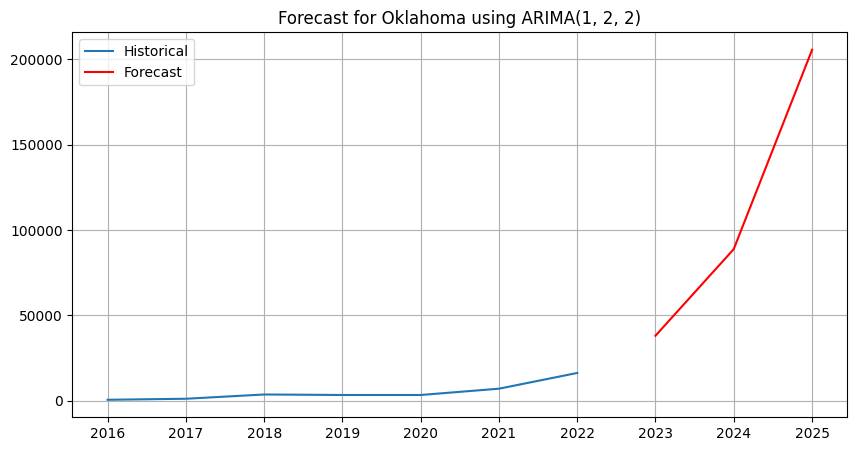

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Oregon...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

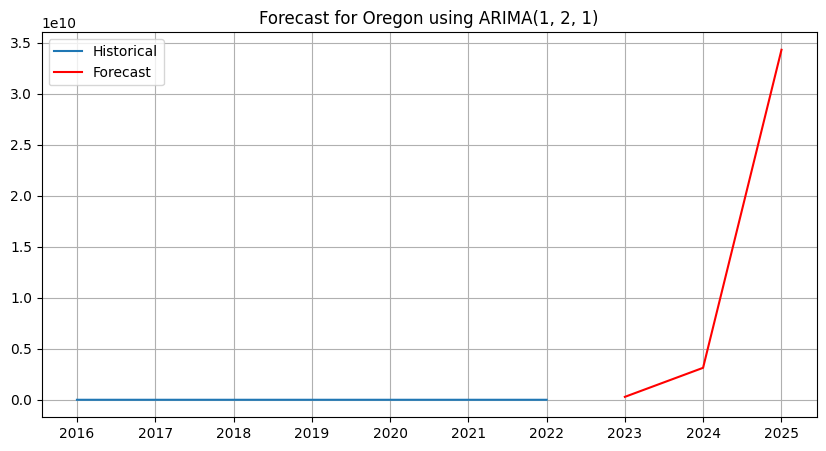

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Pennsylvania...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

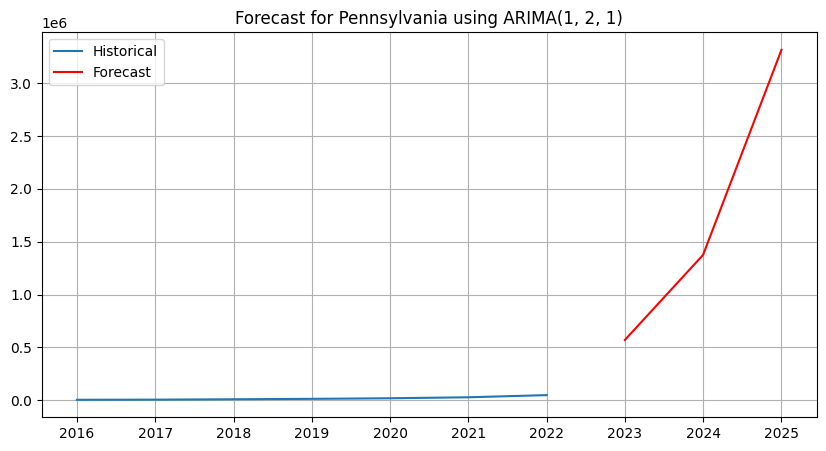

Processing Rhode Island...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

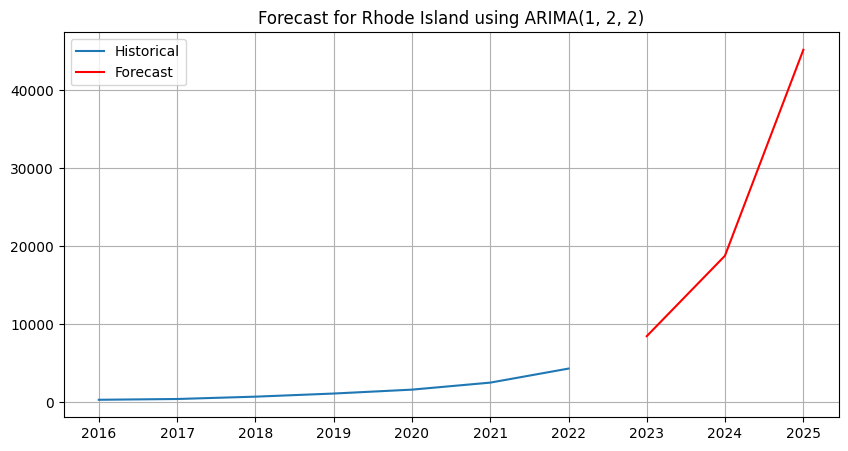

Processing South Carolina...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

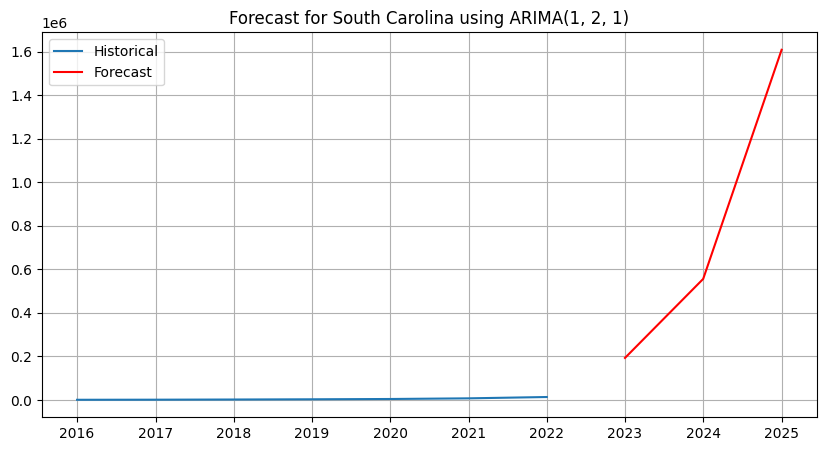

Processing South Dakota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

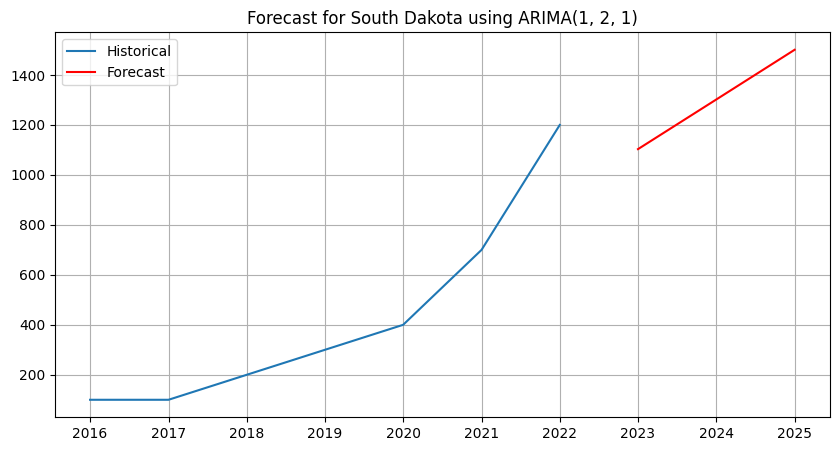

Processing Tennessee...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

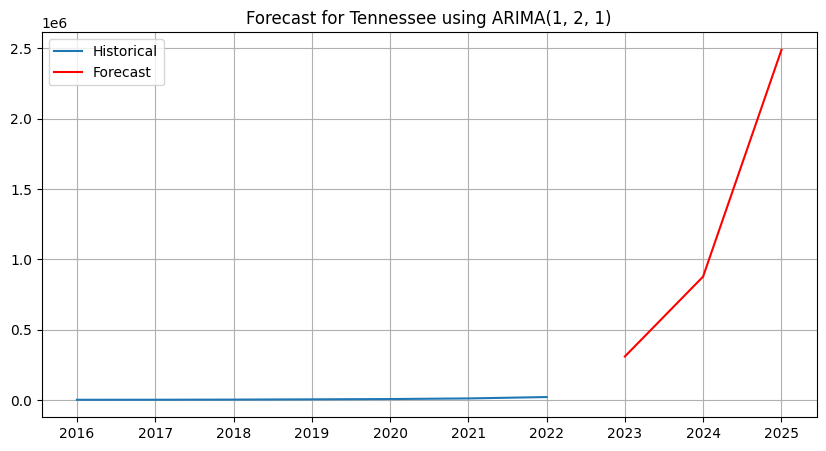

Processing Texas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

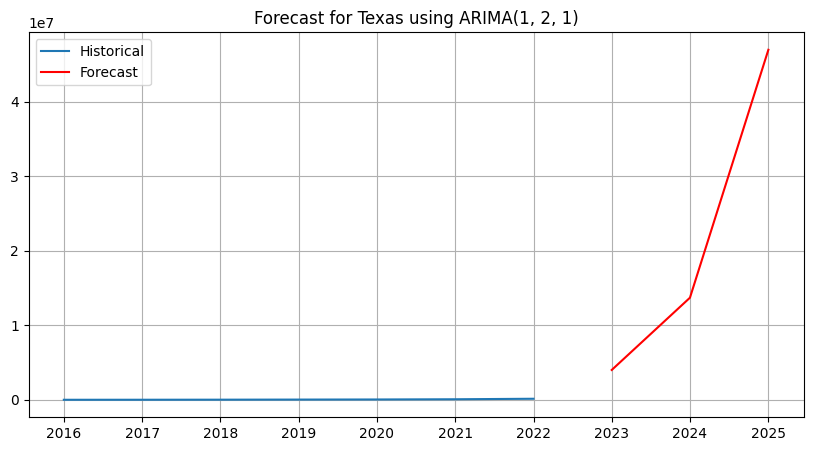

Processing Utah...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

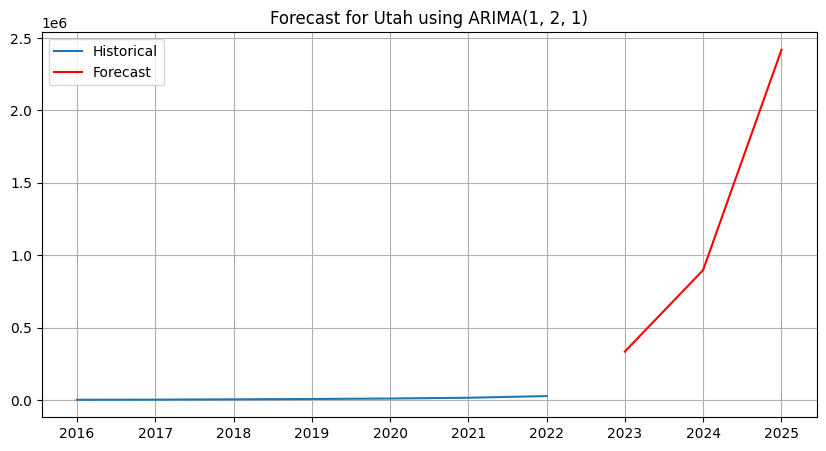

Processing Vermont...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

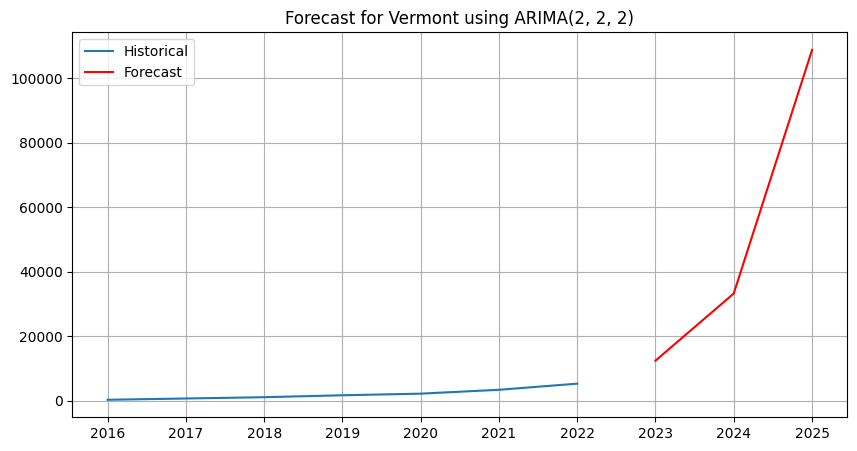

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Virginia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

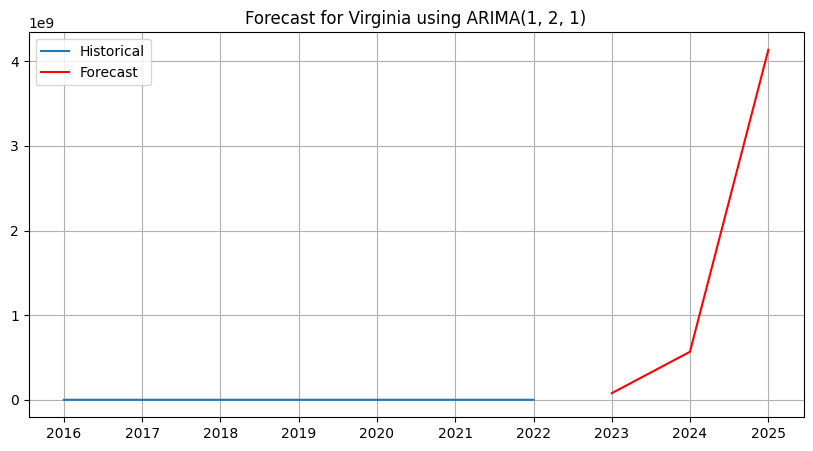

Processing Washington...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

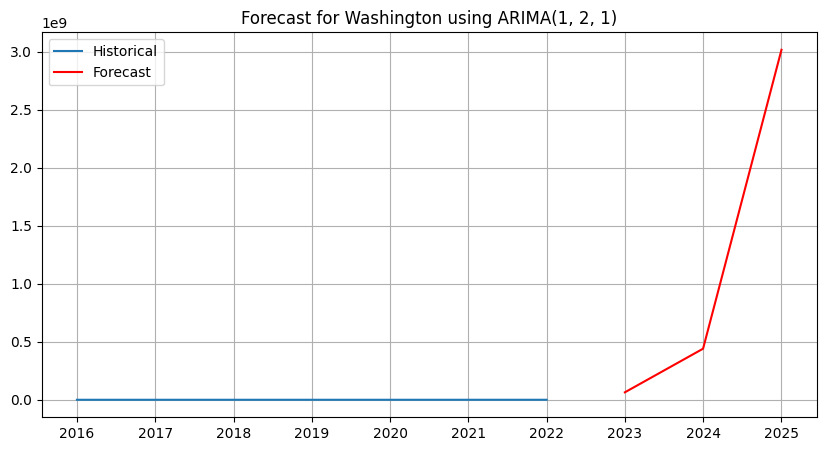

Processing West Virginia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

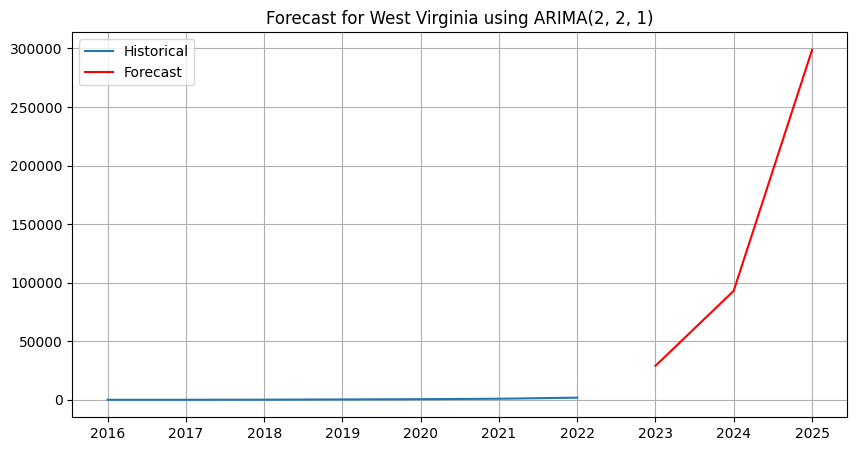

Processing Wisconsin...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

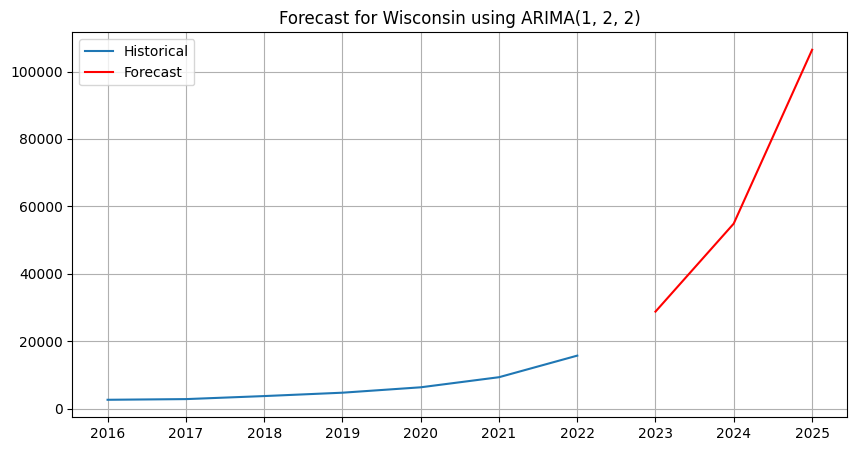

Processing Wyoming...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

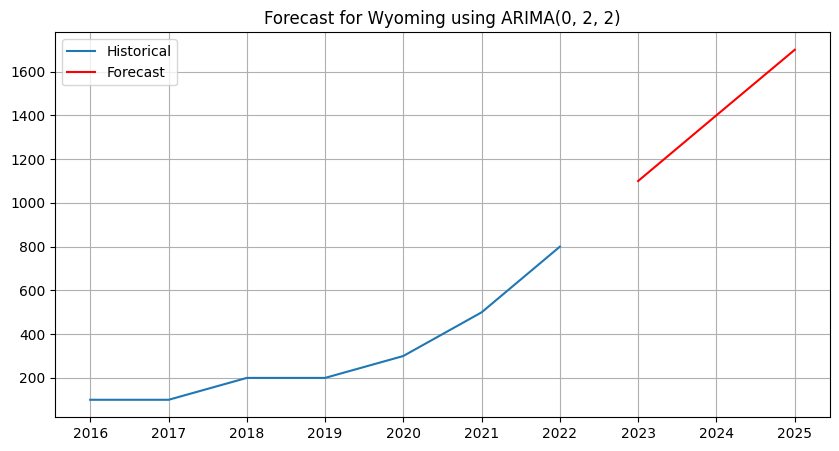

                   State        AIC      Order
0                Alabama  -1.585722  (1, 2, 2)
1                 Alaska   5.406428  (2, 2, 2)
2                Arizona   6.000000  (1, 2, 1)
3               Arkansas   6.000000  (1, 2, 1)
4             California  53.980572  (0, 2, 2)
5               Colorado   6.000000  (1, 2, 1)
6            Connecticut  37.325404  (1, 2, 2)
7               Delaware   2.034562  (1, 2, 2)
8   District of Columbia   6.000000  (1, 2, 1)
9                Florida   6.000000  (1, 2, 1)
10               Georgia   6.000000  (1, 2, 1)
11                Hawaii   8.000000  (2, 2, 1)
12                 Idaho   3.776077  (1, 2, 2)
13              Illinois   8.000000  (2, 2, 1)
14               Indiana   6.000000  (1, 2, 1)
15                  Iowa   6.000000  (1, 2, 1)
16                Kansas   6.000000  (1, 2, 1)
17              Kentucky   8.000000  (2, 2, 1)
18             Louisiana   0.247349  (1, 2, 2)
19                 Maine   2.555421  (1, 2, 2)
20           

In [56]:
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
from itertools import product
import matplotlib.pyplot as plt

# Load your dataset
df = pd.read_csv("combined_data.csv")
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

# Parameters range
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

def optimize_arima(series, pdq):
    best_aic = np.inf
    best_order = None
    best_mdl = None

    for param in pdq:
        try:
            model = SARIMAX(series,
                            order=param,
                            enforce_stationarity=False,
                            enforce_invertibility=False)
            results = model.fit(disp=0)
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_mdl = results
        except:
            continue
    return best_aic, best_order, best_mdl

# Store results
results = []

# Forecast years
forecast_years = 3
forecast_steps = forecast_years * 1  # Assuming data is yearly

# Iterate through each state
states = df['State'].unique()
for state in states:
    print(f"Processing {state}...")
    state_data = df[df['State'] == state]['Electric (EV)']
    best_aic, best_order, best_model = optimize_arima(state_data, pdq)
    
    if best_model:
        results.append({
            'State': state,
            'AIC': best_aic,
            'Order': best_order
        })
        
        # Forecasting
        forecast = best_model.get_forecast(steps=forecast_steps)
        forecast_index = pd.date_range(state_data.index.max(), periods=forecast_steps+1, freq='YS')[1:]
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)
        
        # Plotting each state's forecast
        plt.figure(figsize=(10, 5))
        plt.plot(state_data.index, state_data, label='Historical')
        plt.plot(forecast_index, forecast_series, color='red', label='Forecast')
        plt.title(f'Forecast for {state} using ARIMA{best_order}')
        plt.legend()
        plt.grid(True)
        plt.show()

# Convert results to DataFrame
results_df = pd.DataFrame(results)
print(results_df)


Processing Alabama...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

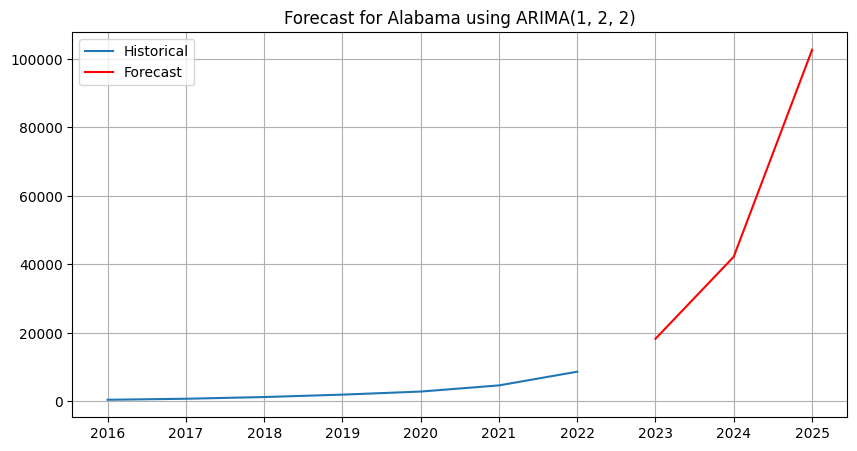

Processing Alaska...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

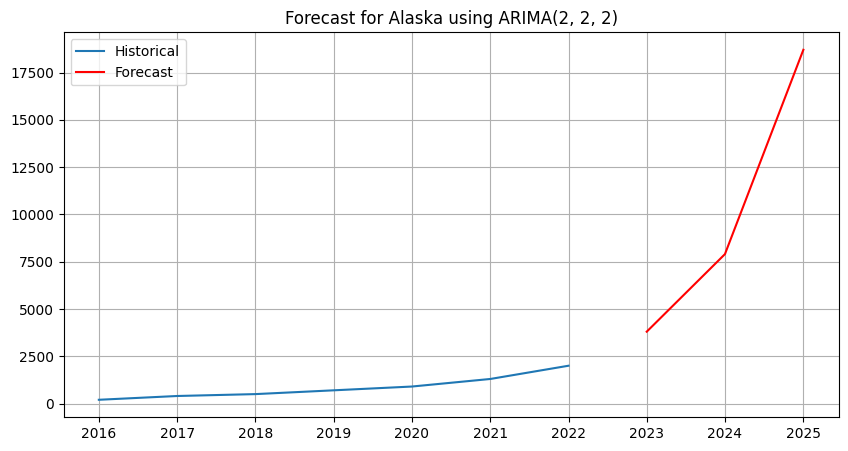

Processing Arizona...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

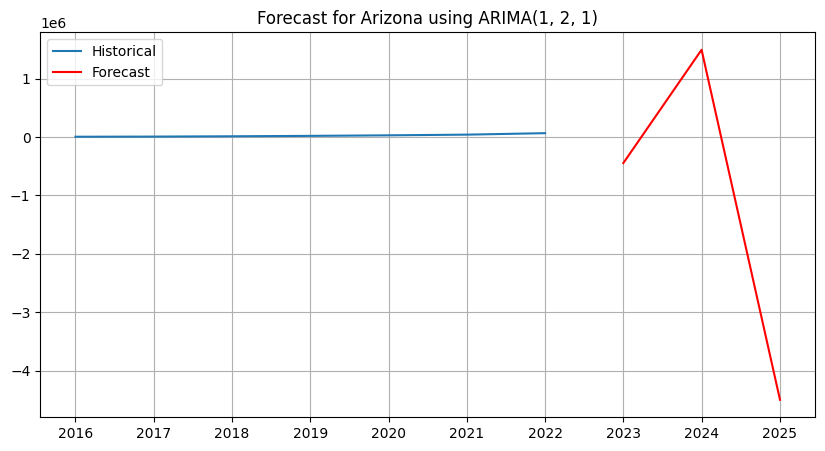

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Arkansas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

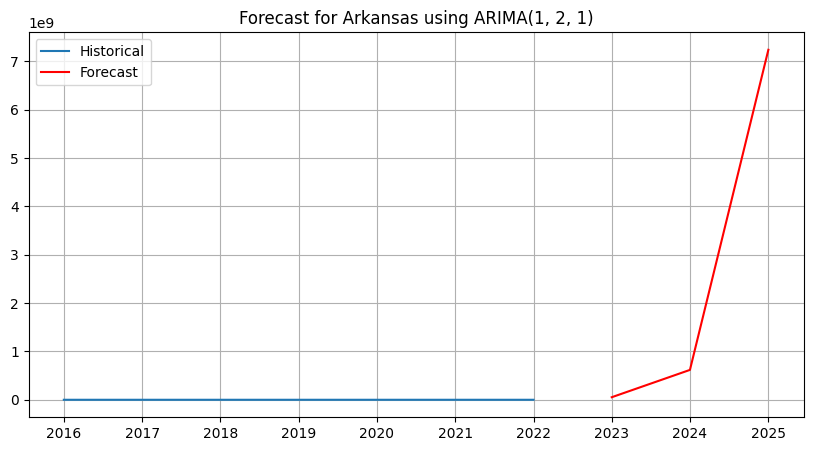

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing California...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

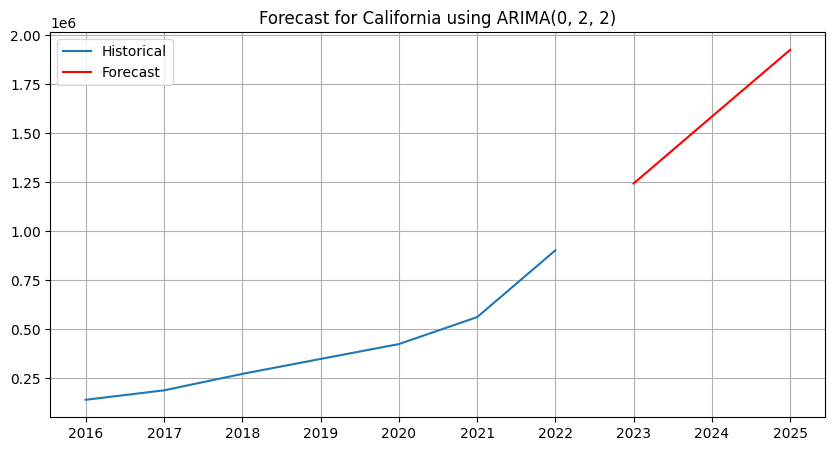

Processing Colorado...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

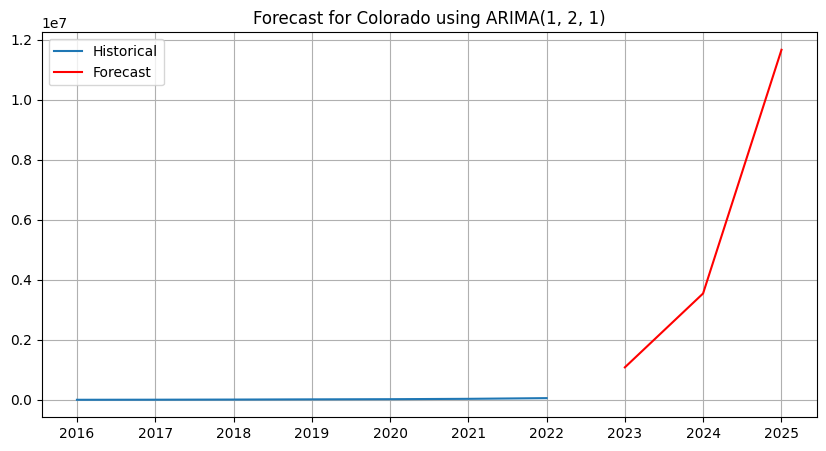

Processing Connecticut...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

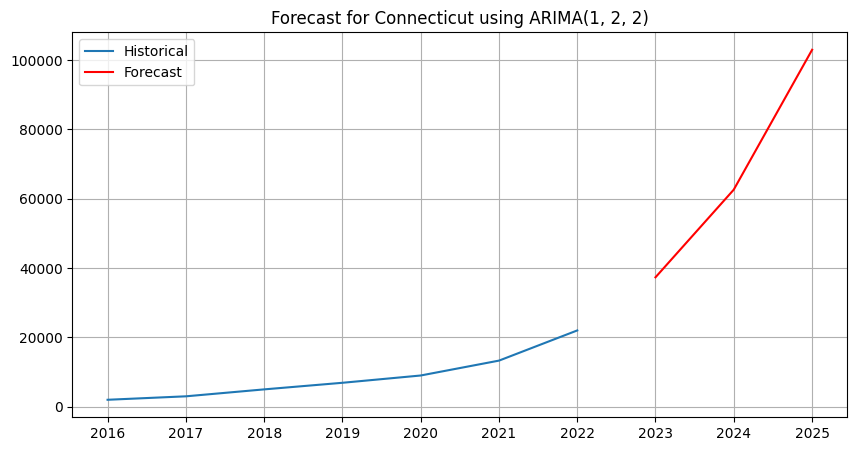

Processing Delaware...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

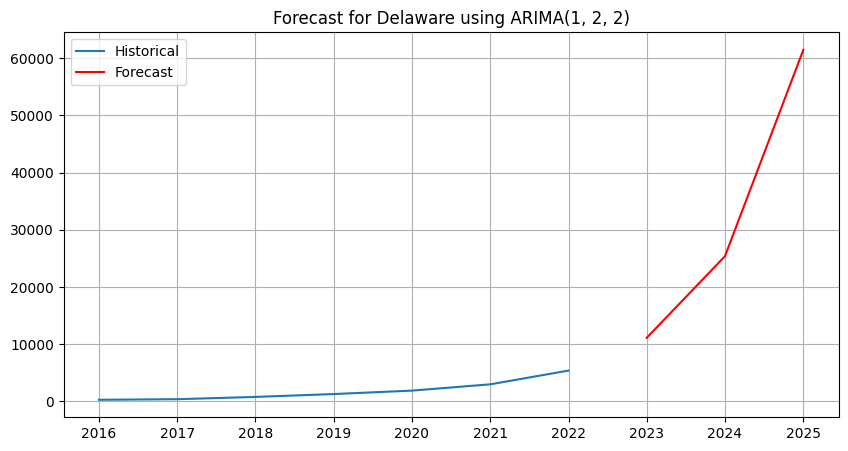

Processing District of Columbia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

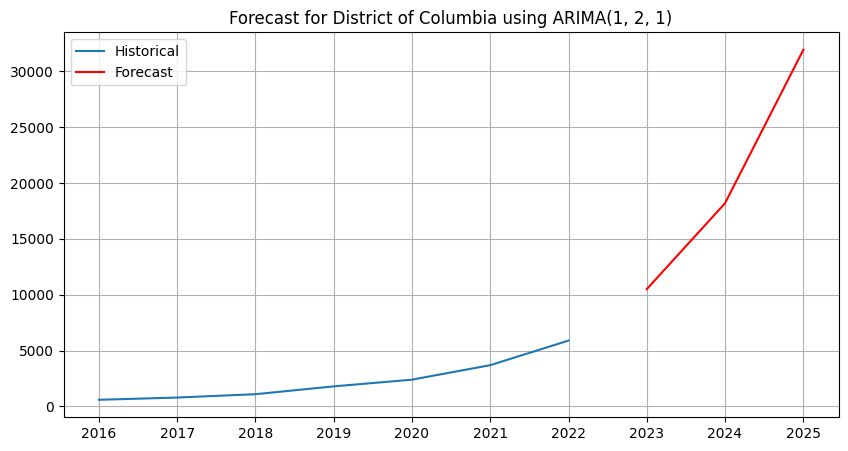

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Florida...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

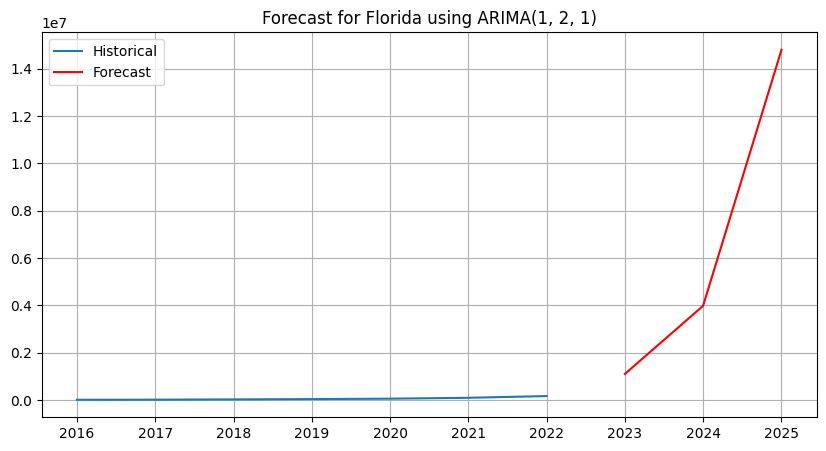

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Georgia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

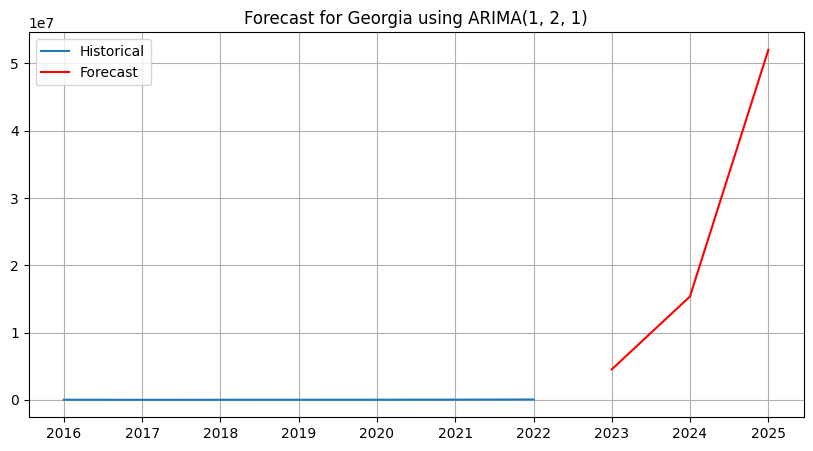

Processing Hawaii...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

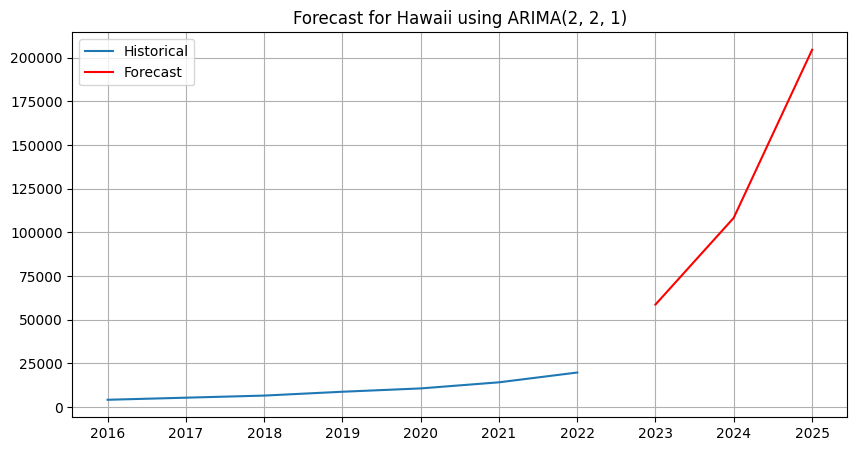

Processing Idaho...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

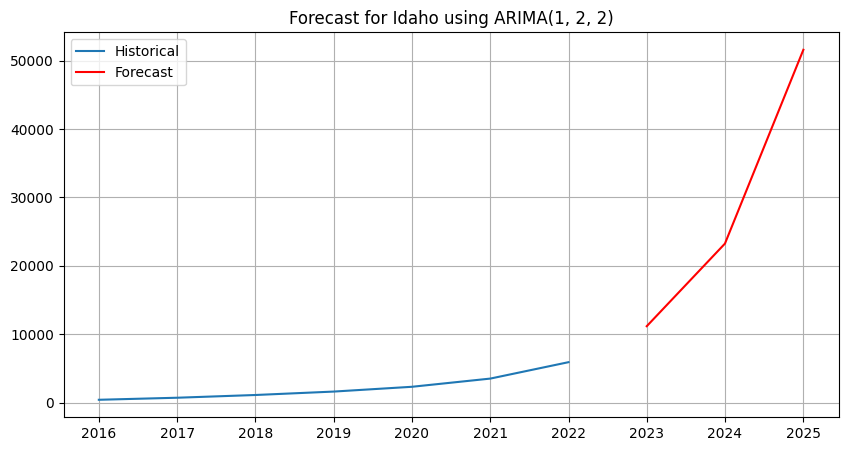

Processing Illinois...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

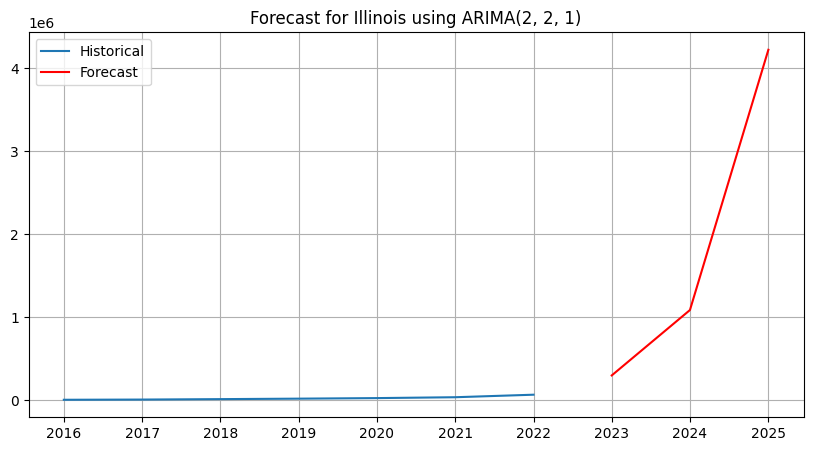

Processing Indiana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

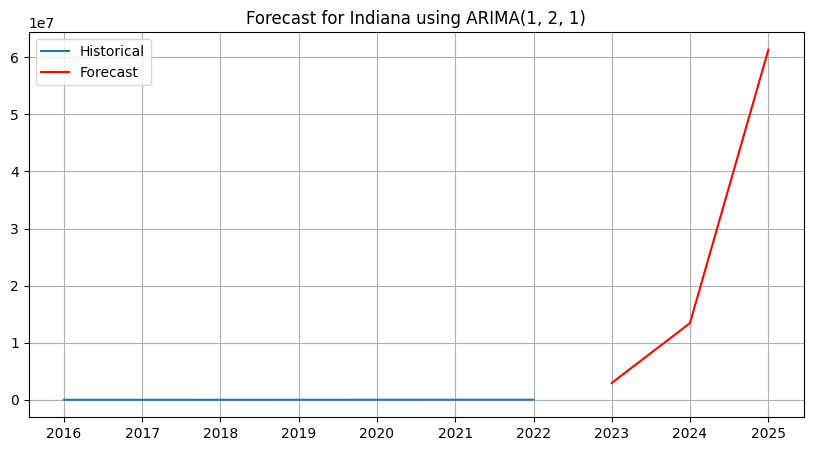

Processing Iowa...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

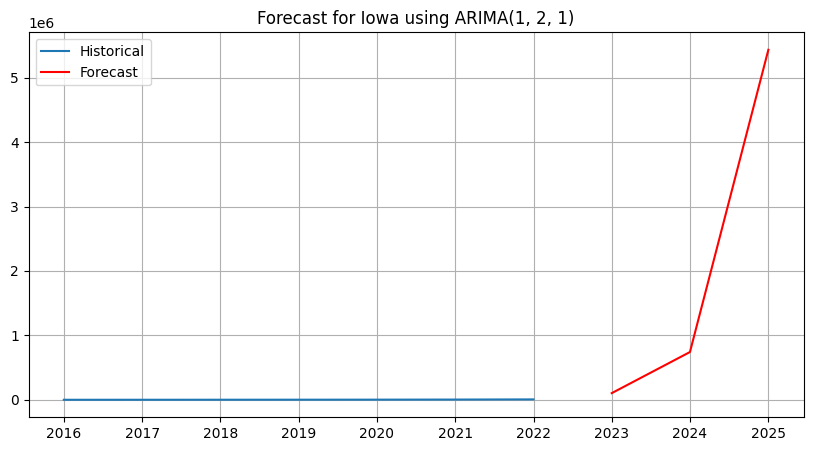

Processing Kansas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

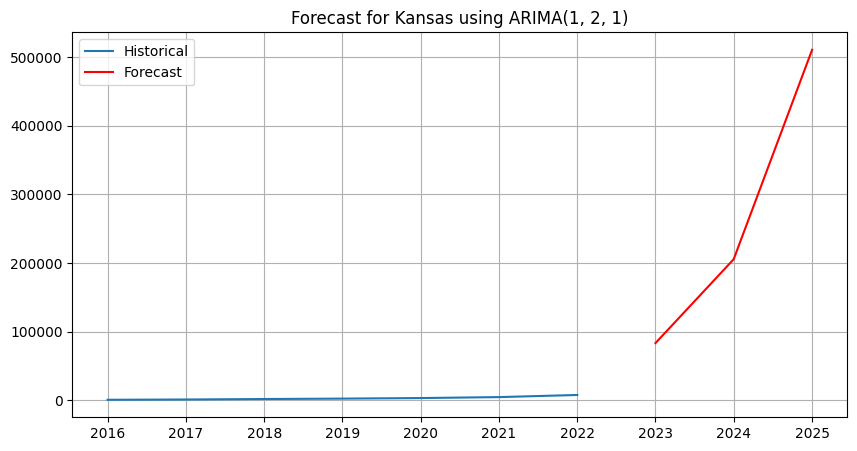

Processing Kentucky...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

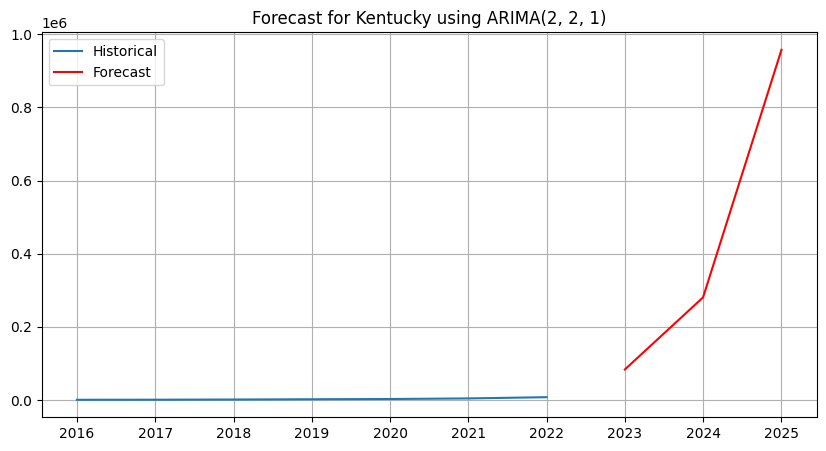

Processing Louisiana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

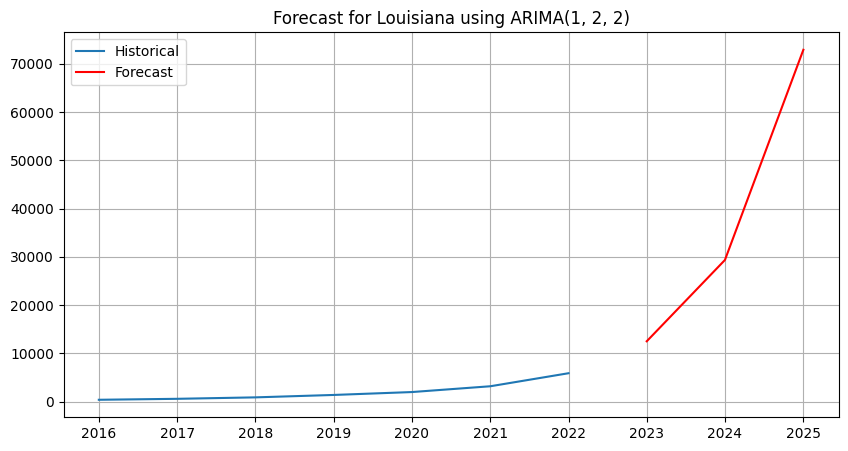

Processing Maine...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

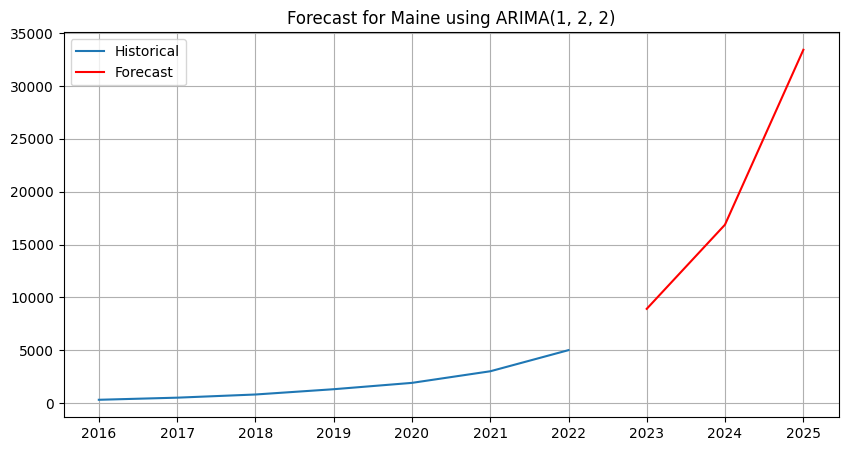

Processing Maryland...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

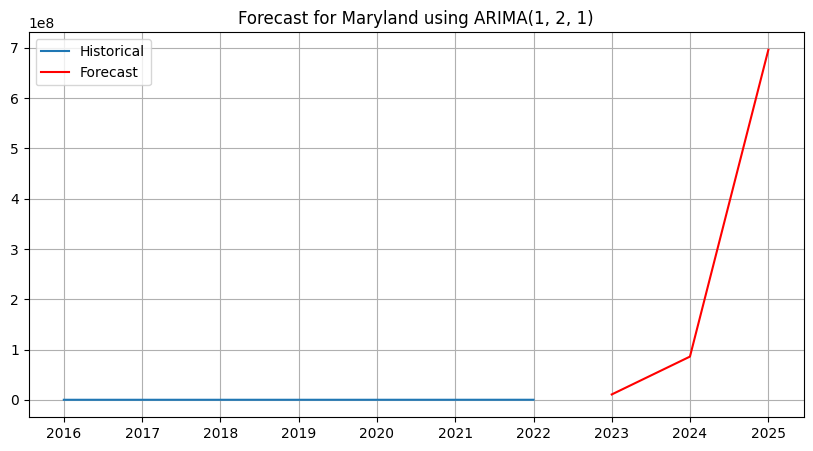

Processing Massachusetts...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

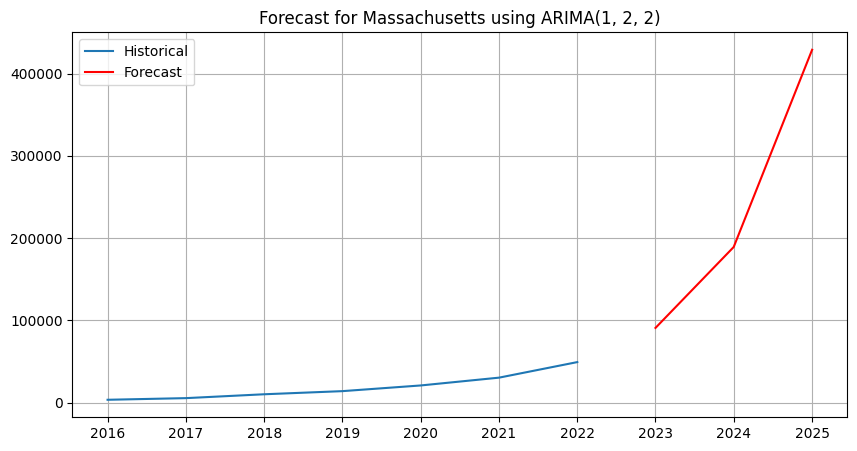

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Michigan...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

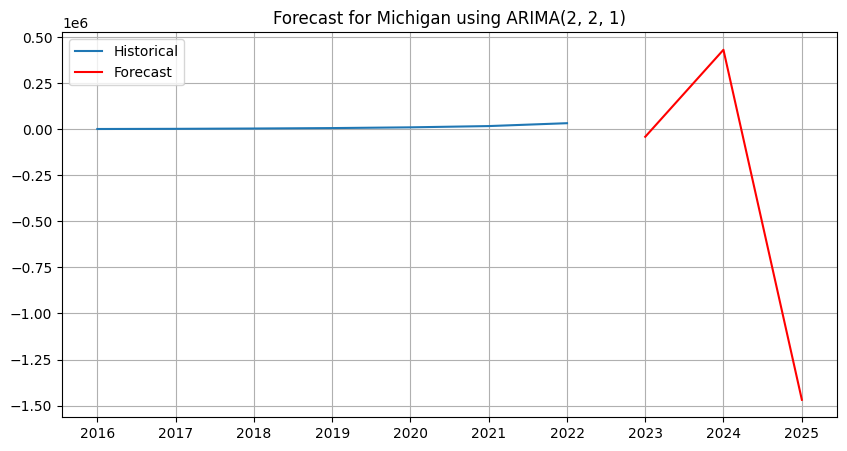

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Minnesota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

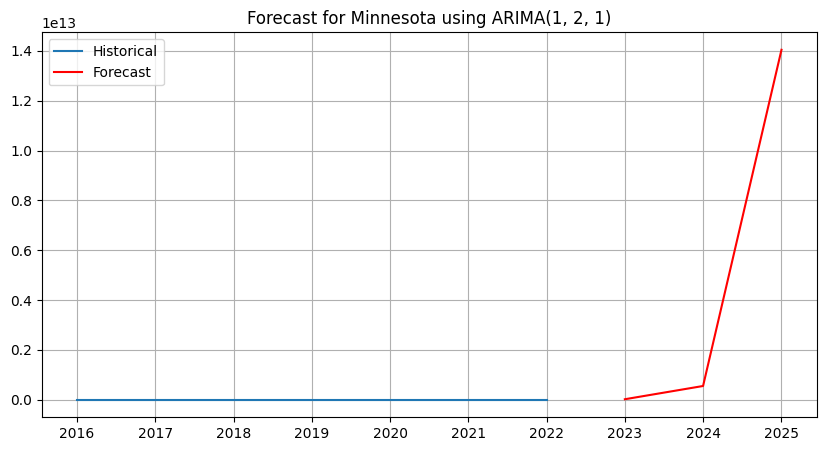

Processing Mississippi...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

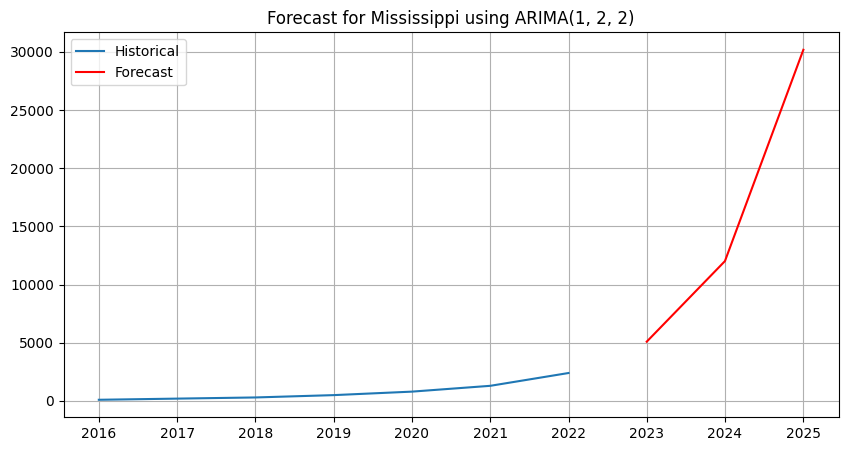

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Missouri...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

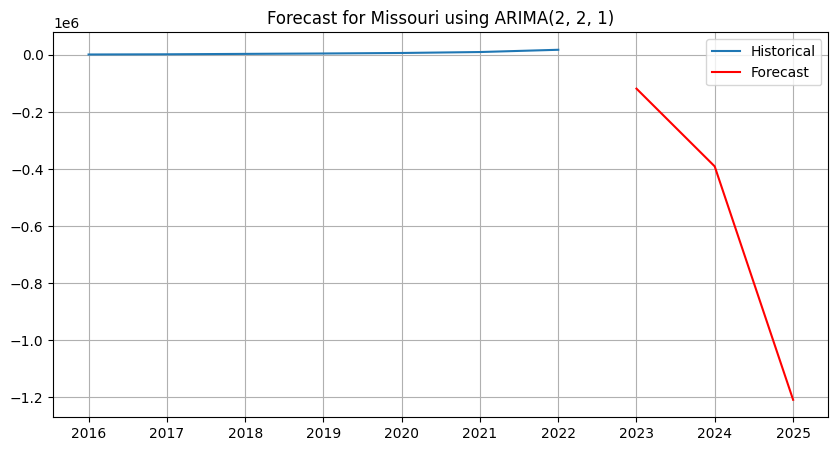

Processing Montana...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

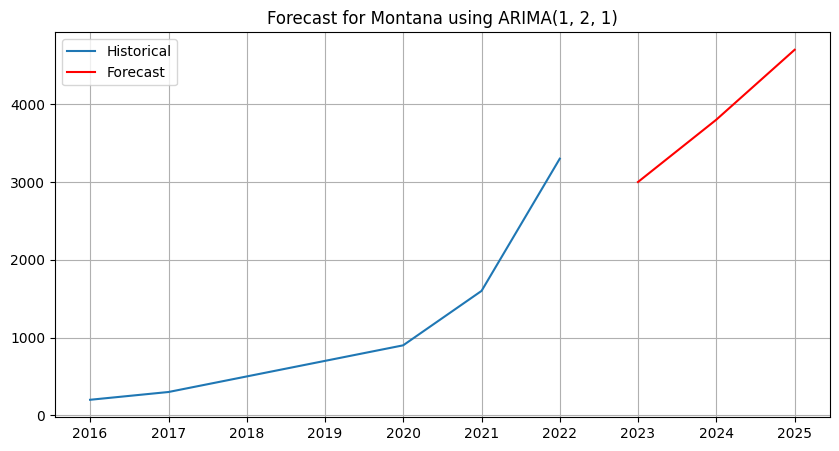

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Nebraska...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

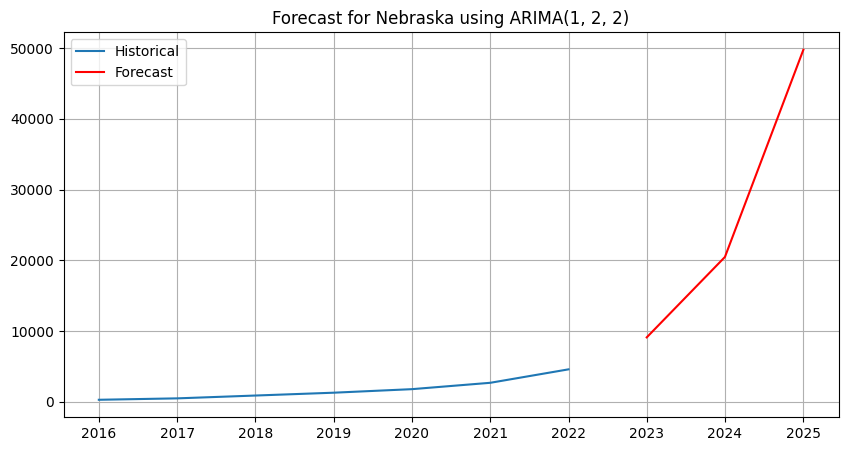

Processing Nevada...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

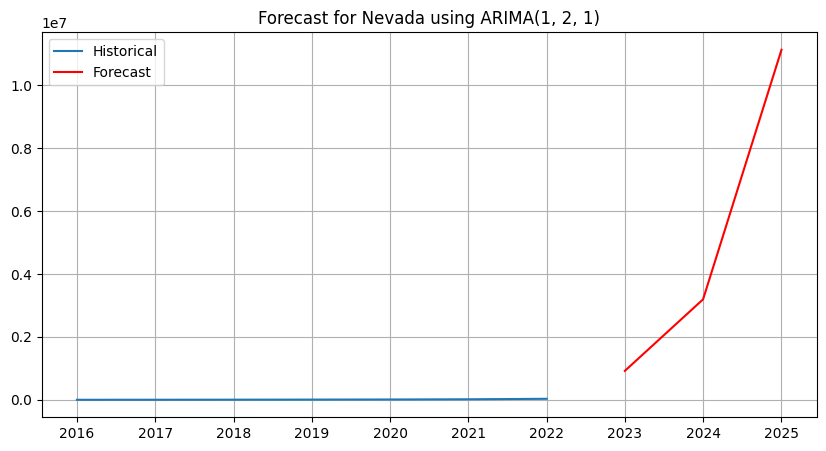

Processing New Hampshire...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

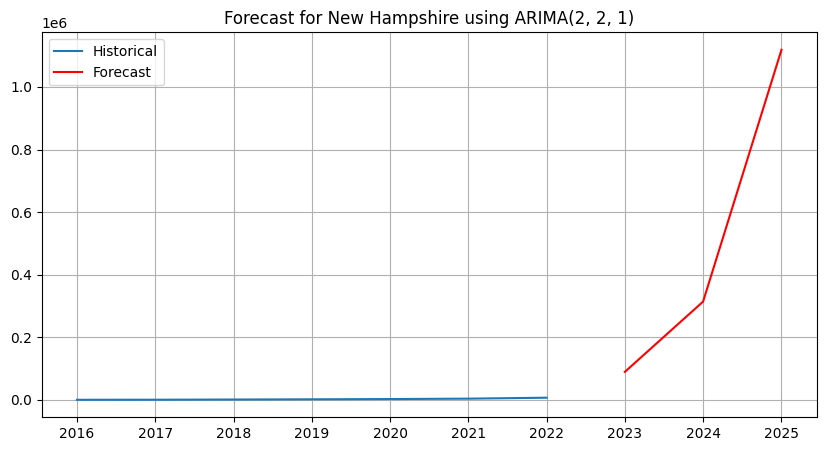

Processing New Jersey...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

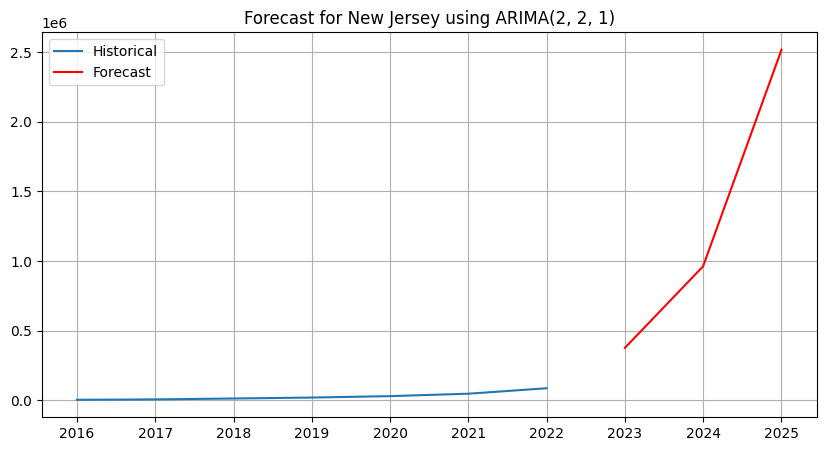

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing New Mexico...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

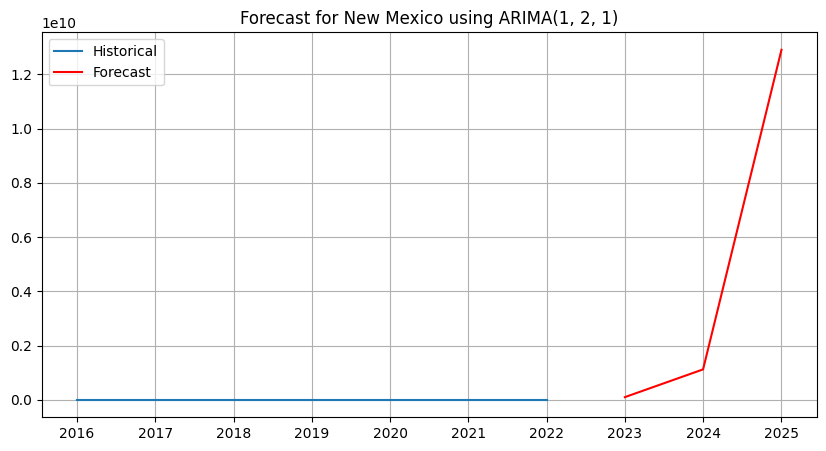

Processing New York...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

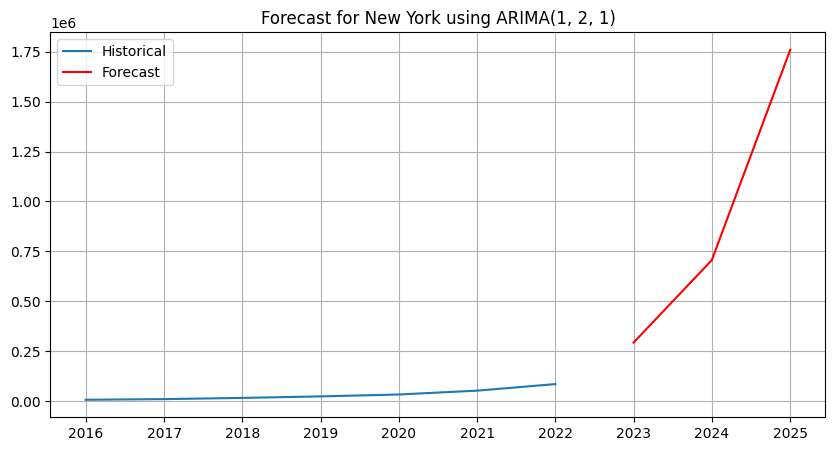

Processing North Carolina...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

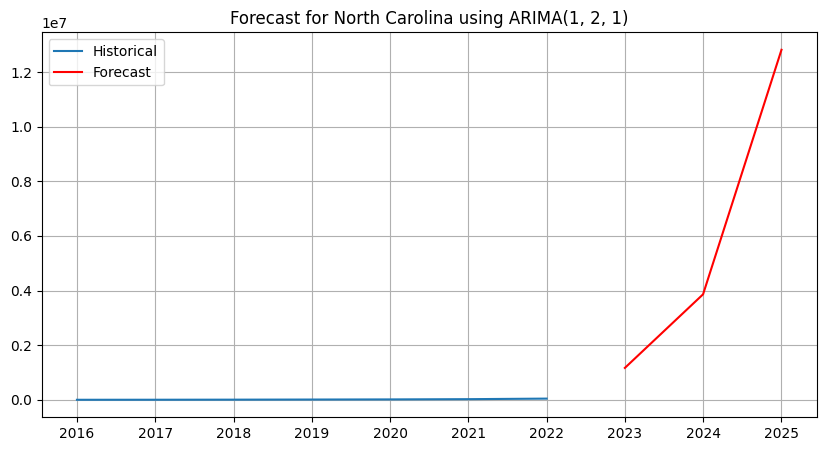

Processing North Dakota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

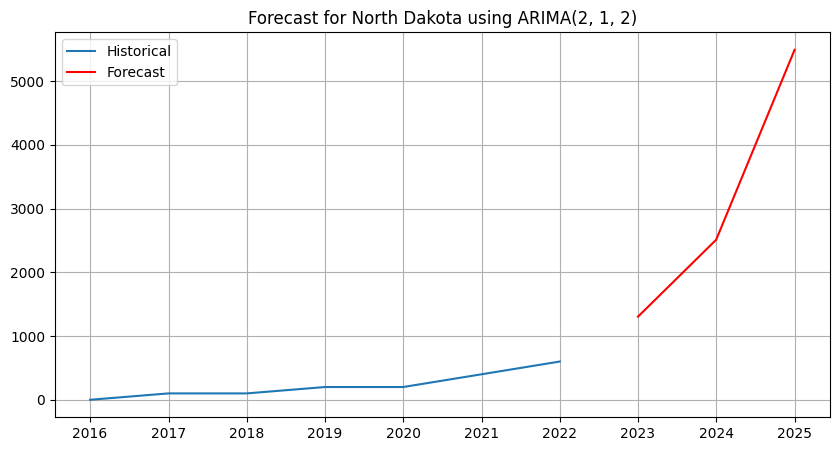

Processing Ohio...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

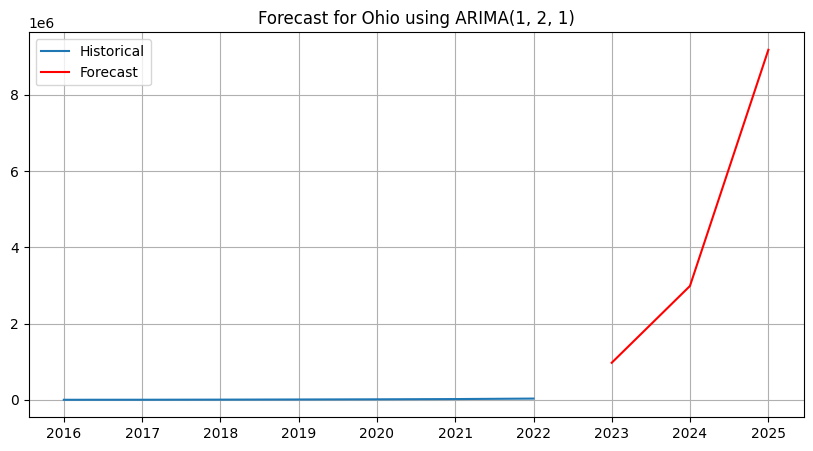

Processing Oklahoma...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

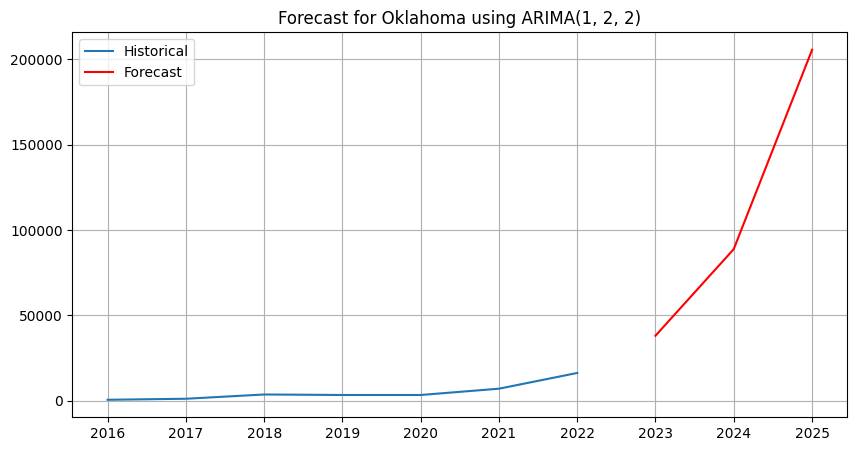

Processing Oregon...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

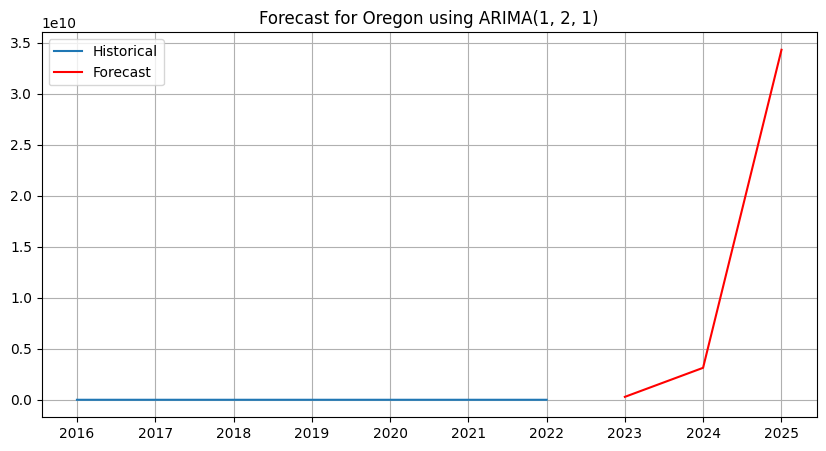

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Pennsylvania...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

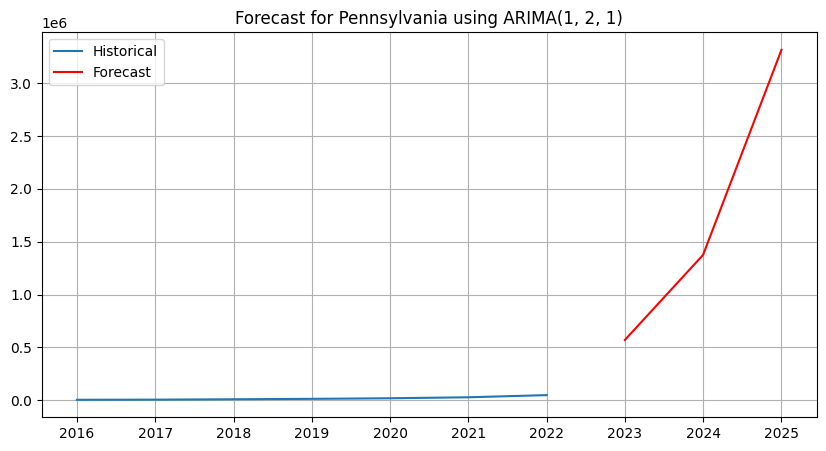

Processing Rhode Island...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

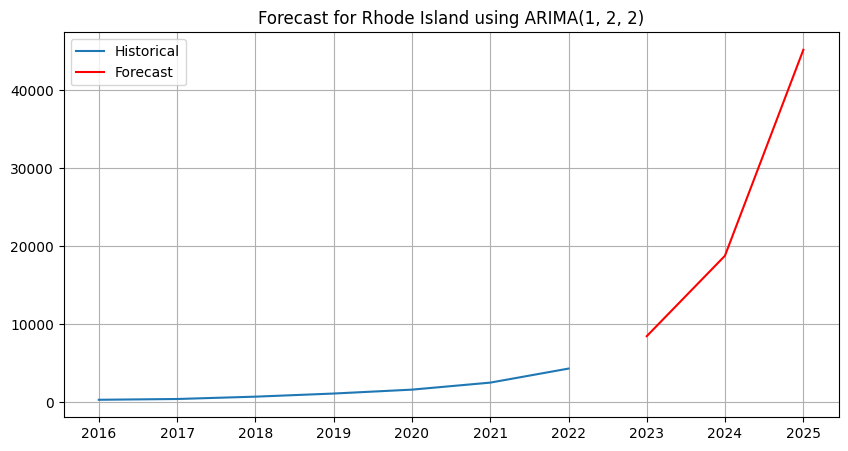

Processing South Carolina...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

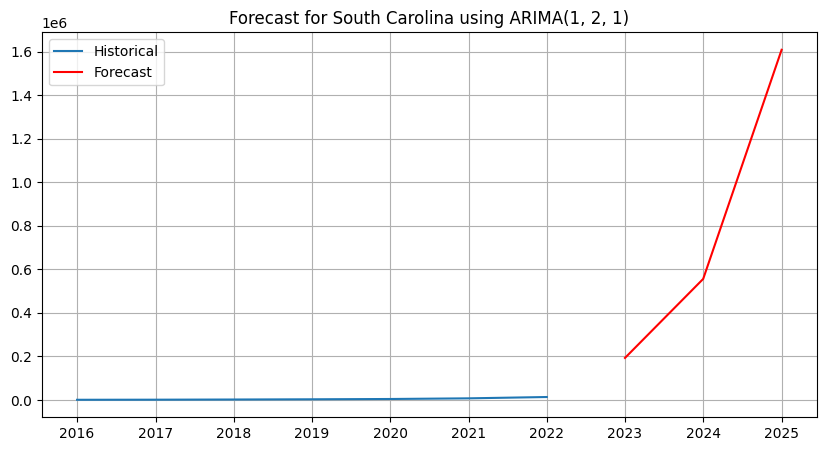

Processing South Dakota...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

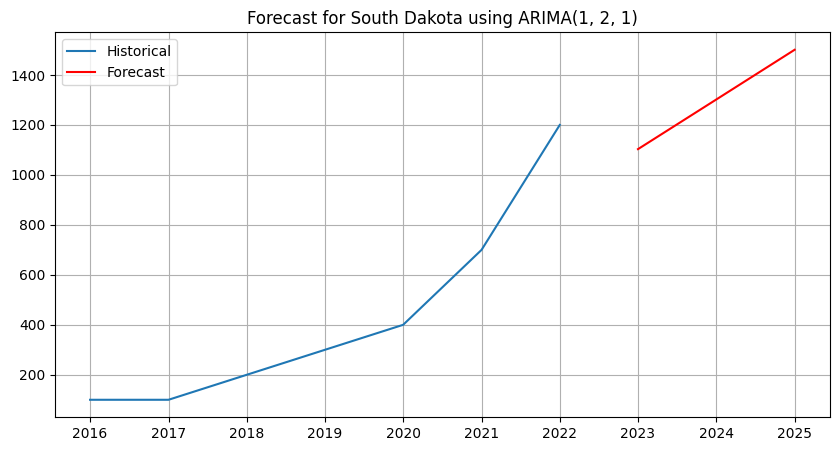

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Tennessee...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

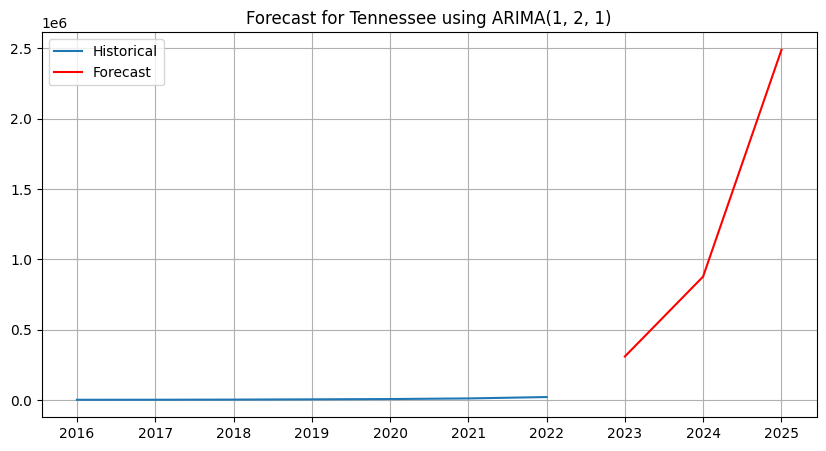

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Processing Texas...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

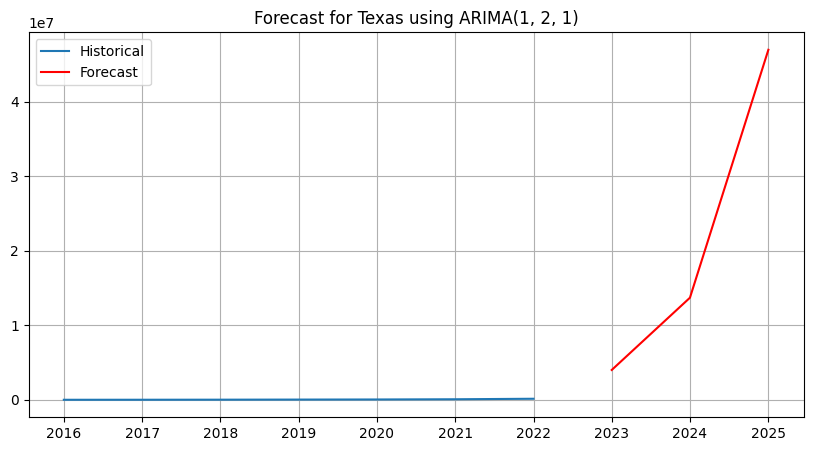

Processing Utah...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

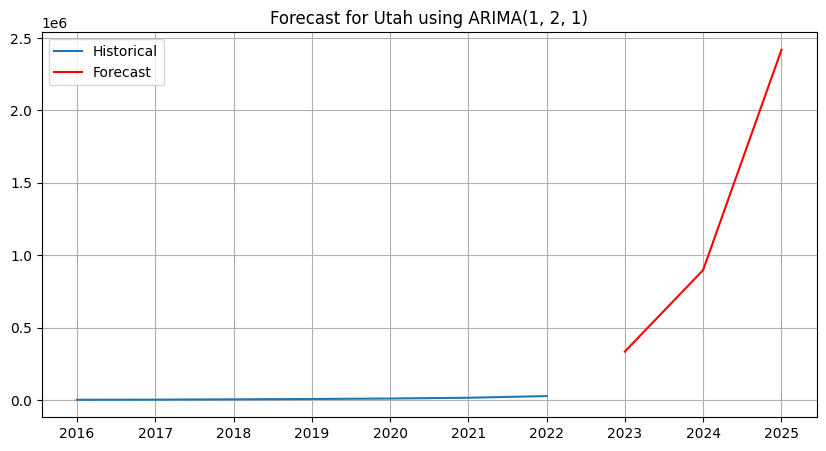

Processing Vermont...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

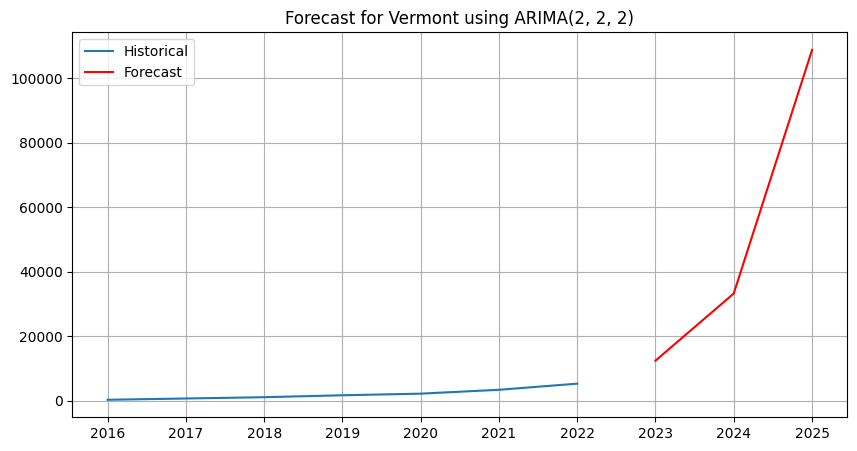

Processing Virginia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

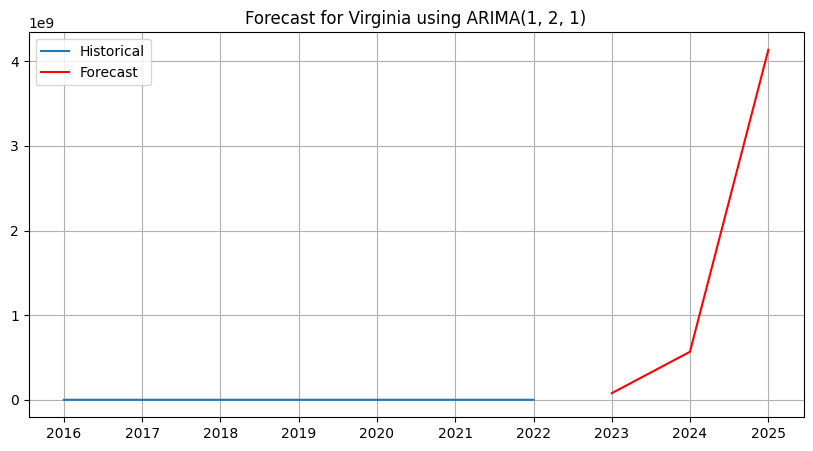

Processing Washington...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

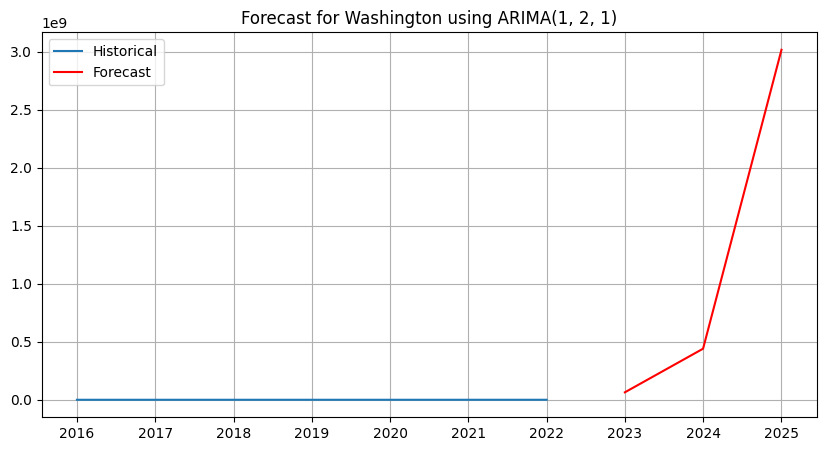

Processing West Virginia...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

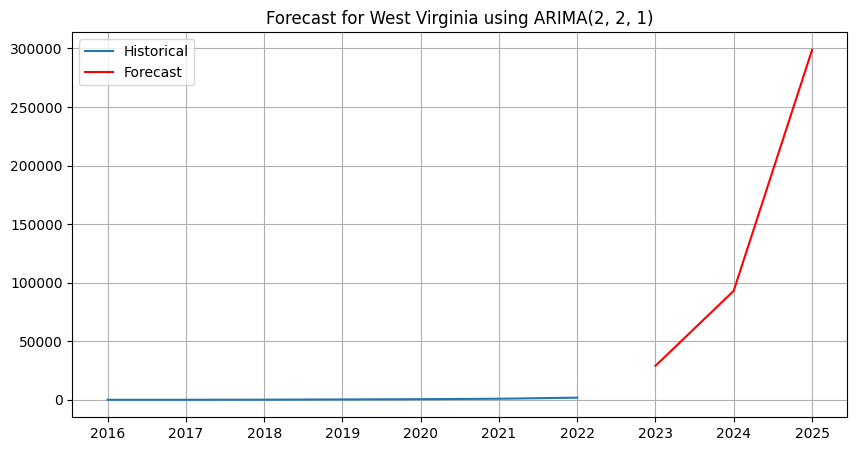

Processing Wisconsin...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

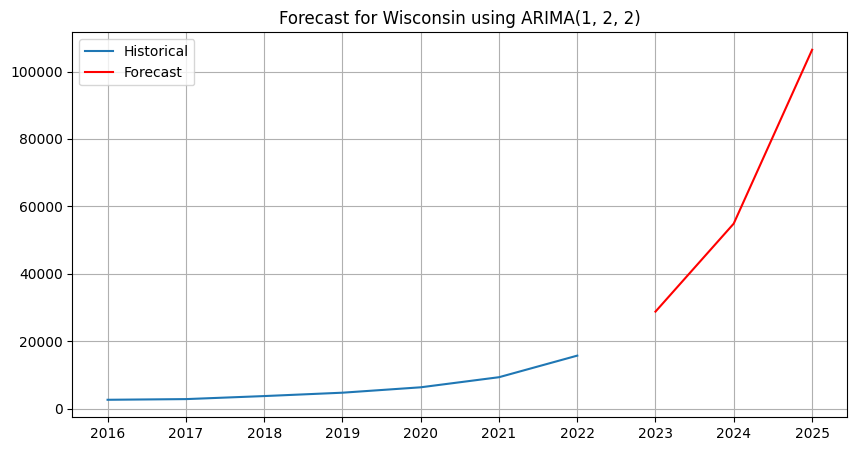

Processing Wyoming...


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

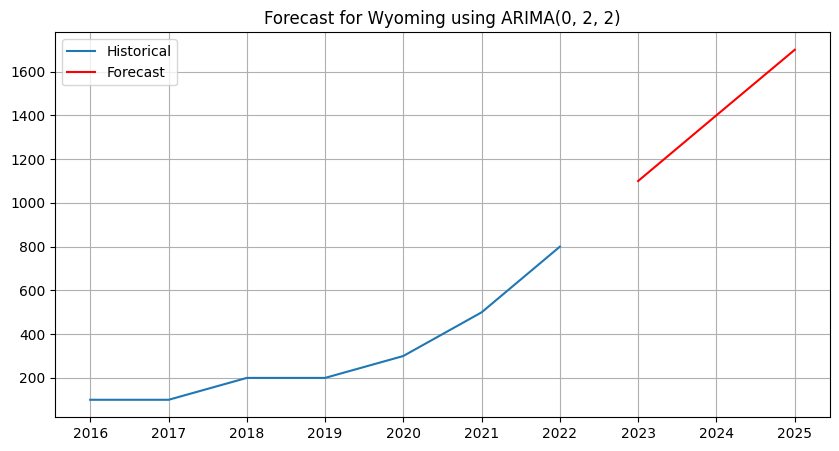

                   State        AIC      Order
0                Alabama  -1.585722  (1, 2, 2)
1                 Alaska   5.406428  (2, 2, 2)
2                Arizona   6.000000  (1, 2, 1)
3               Arkansas   6.000000  (1, 2, 1)
4             California  53.980572  (0, 2, 2)
5               Colorado   6.000000  (1, 2, 1)
6            Connecticut  37.325404  (1, 2, 2)
7               Delaware   2.034562  (1, 2, 2)
8   District of Columbia   6.000000  (1, 2, 1)
9                Florida   6.000000  (1, 2, 1)
10               Georgia   6.000000  (1, 2, 1)
11                Hawaii   8.000000  (2, 2, 1)
12                 Idaho   3.776077  (1, 2, 2)
13              Illinois   8.000000  (2, 2, 1)
14               Indiana   6.000000  (1, 2, 1)
15                  Iowa   6.000000  (1, 2, 1)
16                Kansas   6.000000  (1, 2, 1)
17              Kentucky   8.000000  (2, 2, 1)
18             Louisiana   0.247349  (1, 2, 2)
19                 Maine   2.555421  (1, 2, 2)
20           

In [57]:
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
from itertools import product
import matplotlib.pyplot as plt

# Load your dataset
df = pd.read_csv("combined_data.csv")
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

# Parameters range
p = d = q = range(0, 3)  # Example parameter ranges
pdq = list(product(p, d, q))  # Generate all different combinations of p, d, q

def optimize_arima(series, pdq):
    best_aic = np.inf
    best_order = None
    best_mdl = None

    for param in pdq:
        try:
            model = SARIMAX(series,
                            order=param,
                            enforce_stationarity=False,
                            enforce_invertibility=False)
            results = model.fit(disp=0)
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_mdl = results
        except:
            continue
    return best_aic, best_order, best_mdl

# Store results
results = []

# Forecast years
forecast_years = 3
forecast_steps = forecast_years * 1  # Assuming data is yearly

# Iterate through each state
states = df['State'].unique()
for state in states:
    print(f"Processing {state}...")
    state_data = df[df['State'] == state]['Electric (EV)']
    best_aic, best_order, best_model = optimize_arima(state_data, pdq)
    
    if best_model:
        results.append({
            'State': state,
            'AIC': best_aic,
            'Order': best_order
        })
        
        # Forecasting
        forecast = best_model.get_forecast(steps=forecast_steps)
        forecast_index = pd.date_range(state_data.index.max(), periods=forecast_steps+1, freq='YS')[1:]
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)
        
        # Plotting each state's forecast
        plt.figure(figsize=(10, 5))
        plt.plot(state_data.index, state_data, label='Historical')
        plt.plot(forecast_index, forecast_series, color='red', label='Forecast')
        plt.title(f'Forecast for {state} using ARIMA{best_order}')
        plt.legend()
        plt.grid(True)
        plt.show()

# Convert results to DataFrame
results_df = pd.DataFrame(results)
print(results_df)


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

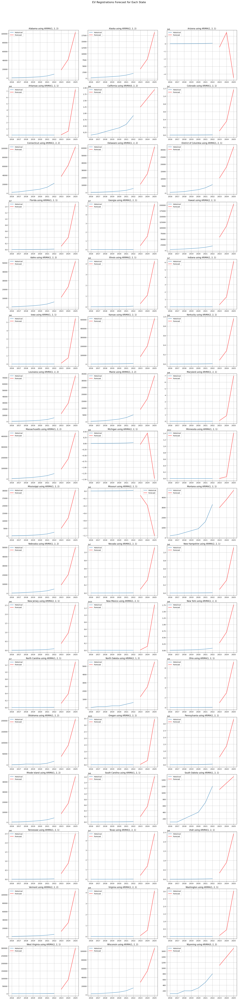

In [58]:
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
from itertools import product
import matplotlib.pyplot as plt

# Load your dataset
df = pd.read_csv("combined_data.csv")
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

# Parameters range
p = d = q = range(0, 3)  # Example parameter ranges
pdq = list(product(p, d, q))  # Generate all different combinations of p, d, q

def optimize_arima(series, pdq):
    best_aic = np.inf
    best_order = None
    best_mdl = None

    for param in pdq:
        try:
            model = SARIMAX(series,
                            order=param,
                            enforce_stationarity=False,
                            enforce_invertibility=False)
            results = model.fit(disp=0)
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_mdl = results
        except:
            continue
    return best_aic, best_order, best_mdl

# Forecast years
forecast_years = 3
forecast_steps = forecast_years * 1  # Assuming data is yearly

# Iterate through each state
states = df['State'].unique()
num_states = len(states)
cols = 3
rows = (num_states + cols - 1) // cols  # Ensure enough rows to fit all states

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5))
fig.suptitle('EV Registrations Forecast for Each State', fontsize=16)

for i, state in enumerate(states):
    ax = axes.flat[i]
    state_data = df[df['State'] == state]['Electric (EV)']
    best_aic, best_order, best_model = optimize_arima(state_data, pdq)
    
    if best_model:
        forecast = best_model.get_forecast(steps=forecast_steps)
        forecast_index = pd.date_range(state_data.index.max(), periods=forecast_steps+1, freq='YS')[1:]
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)
        
        # Plotting each state's forecast
        ax.plot(state_data.index, state_data, label='Historical')
        ax.plot(forecast_index, forecast_series, color='red', label='Forecast')
        ax.set_title(f'{state} using ARIMA{best_order}')
        ax.legend()
        ax.grid(True)

# Adjust the layout so the subplots don't overlap each other
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706221 with test MSE=6025000.000000022 for state Alabama


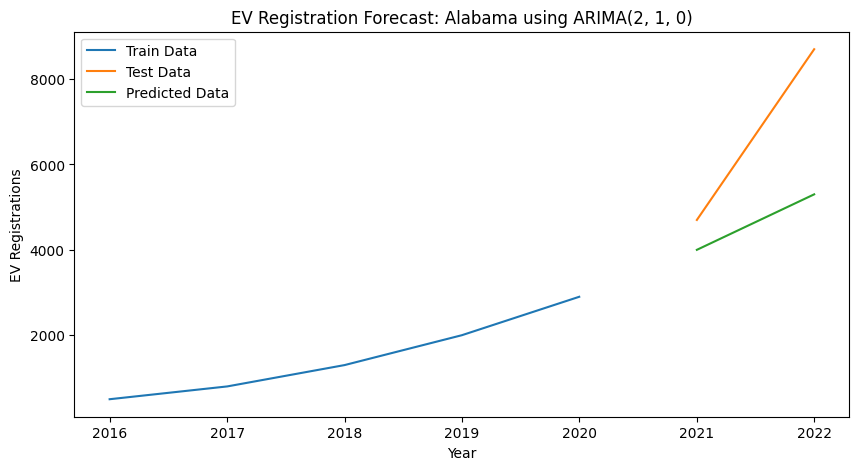

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-37.66753761725277 with test MSE=145246.88458027723 for state Alaska


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

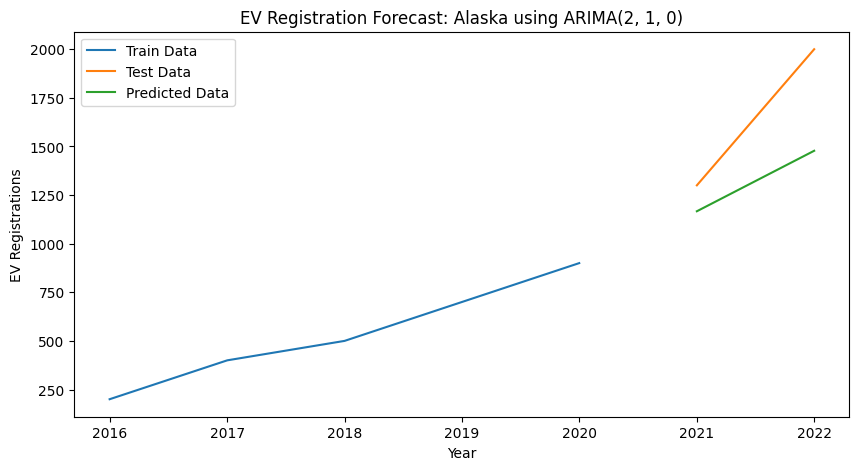

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.55613466948009 with test MSE=31062838.338538375 for state Arizona


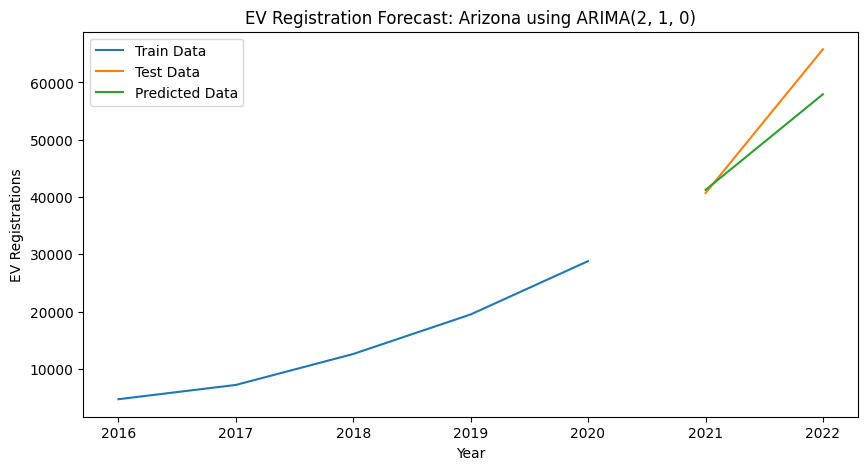

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.8997302985575 with test MSE=3872735.3395171245 for state Arkansas


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

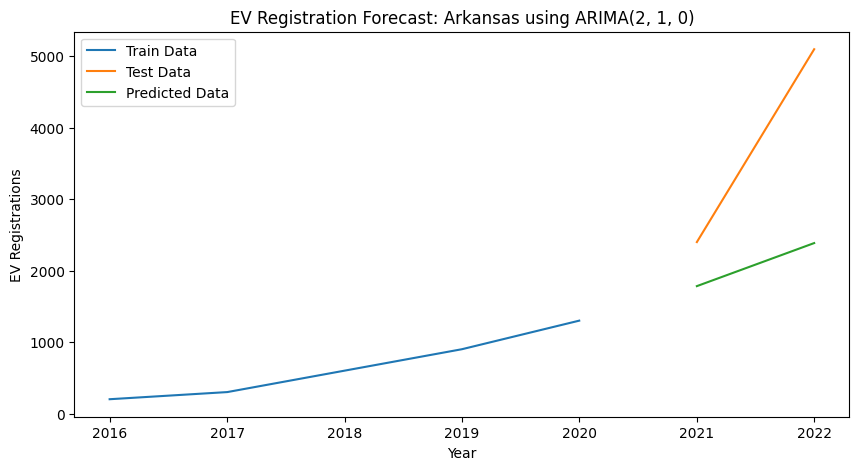

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772702835 with test MSE=57140017488.026665 for state California


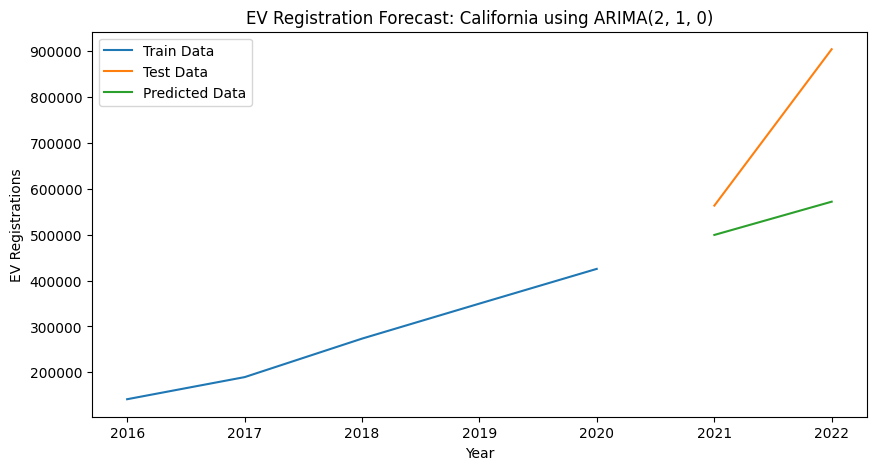

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772654133 with test MSE=38879997771.50268 for state Colorado


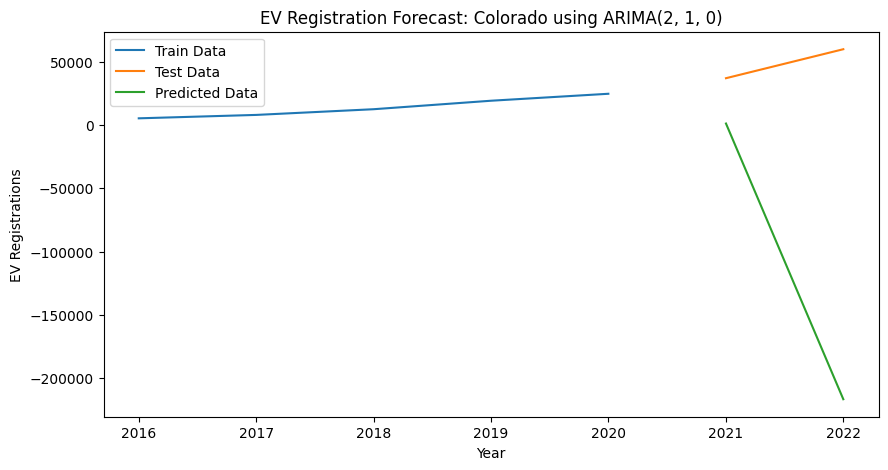

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=37145182.99731077 for state Connecticut


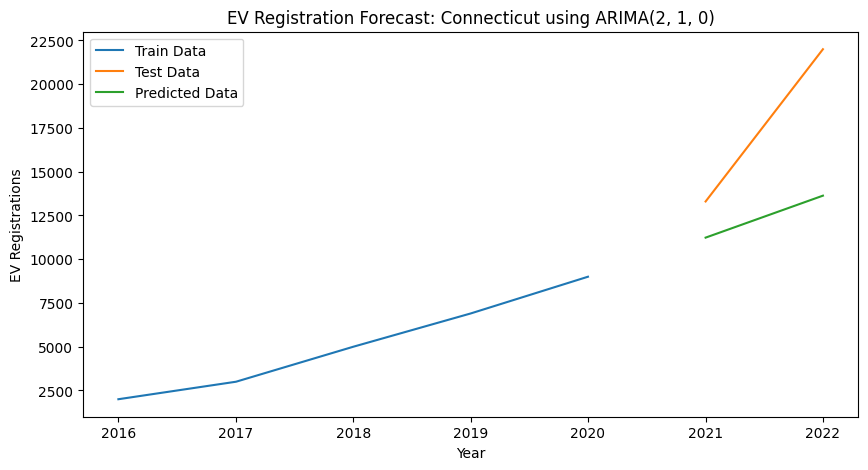

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=1920538.2146028287 for state Delaware


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: V

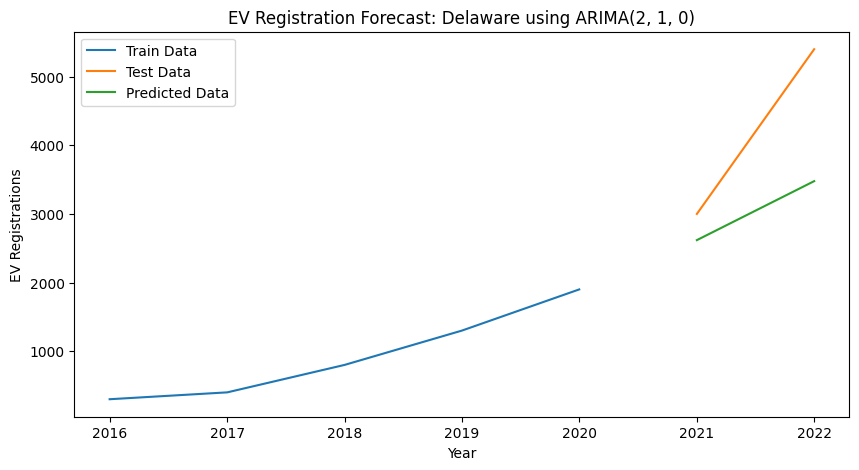

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=4772071.999999998 for state District of Columbia


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\mlemodel.py:1233: RuntimeWarning: invalid value encountered in divide
  np.inner(score_obs, score_obs) /


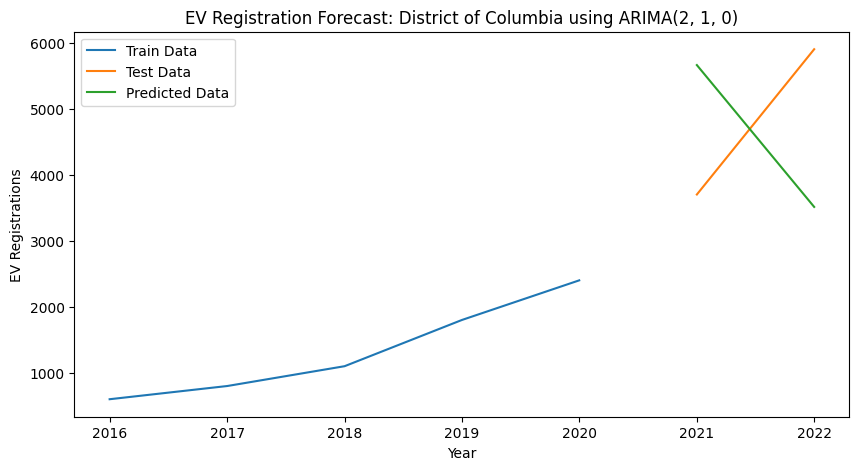

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=1651479228.588921 for state Florida


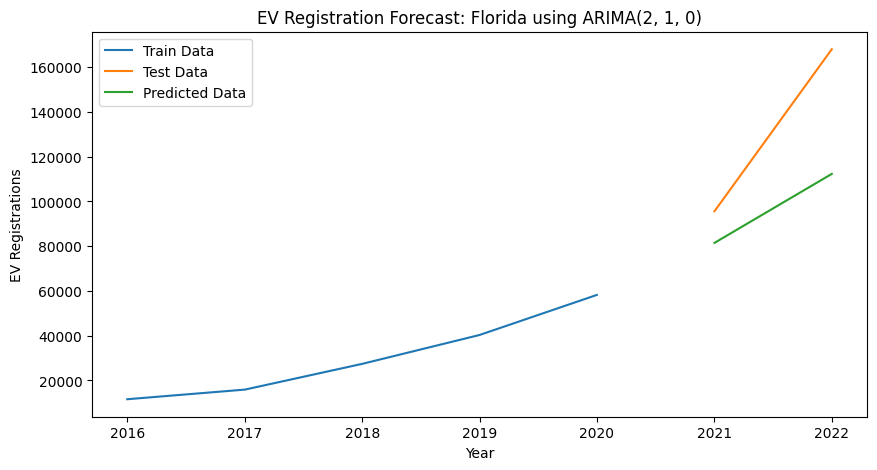

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706196 with test MSE=237090019.03208083 for state Georgia


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

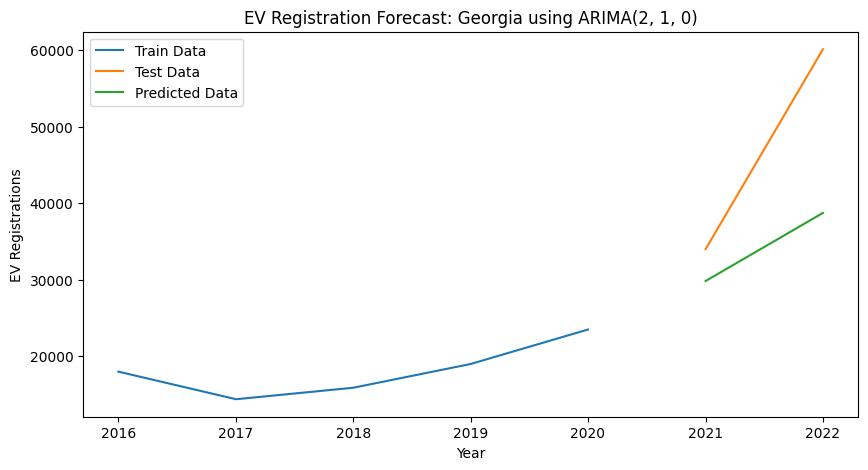

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.05187376996372 with test MSE=2527792.3017919054 for state Hawaii


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

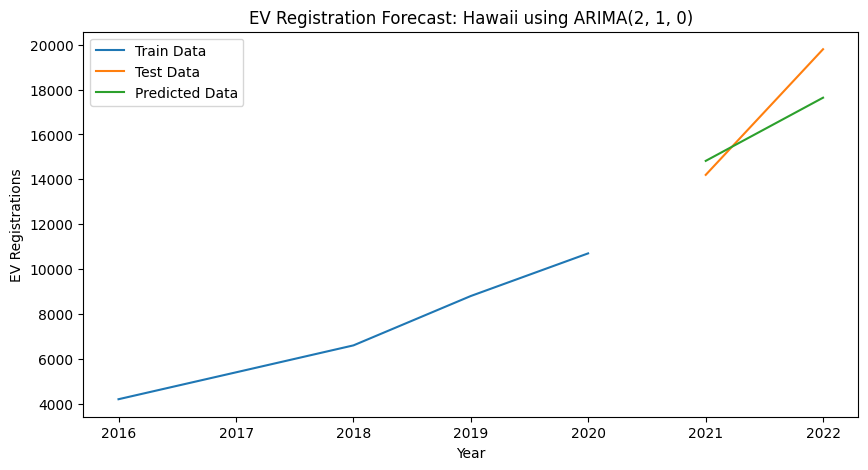

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706216 with test MSE=1204999.999999996 for state Idaho


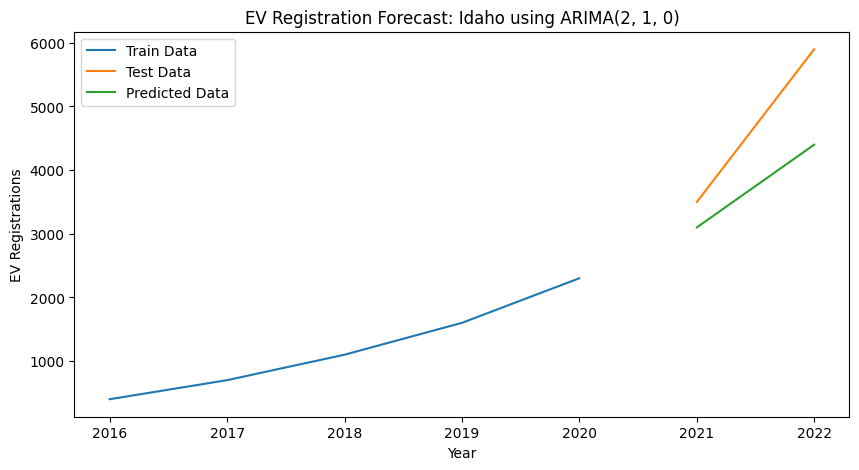

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727061565 with test MSE=294916783.8095499 for state Illinois


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

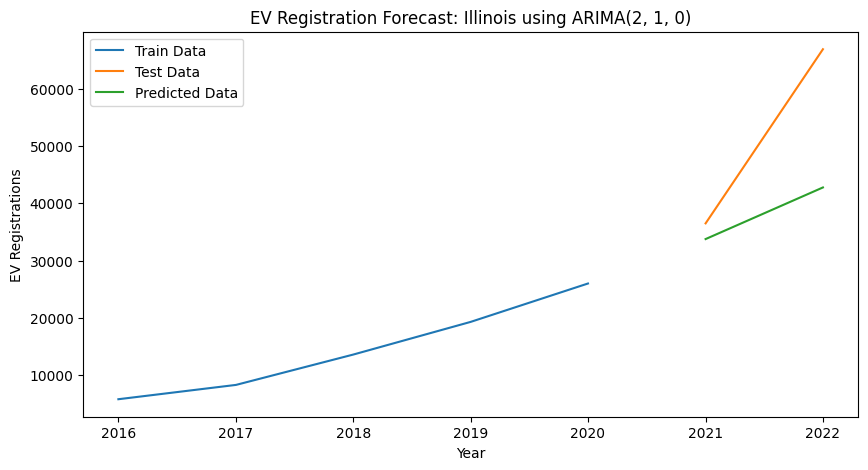

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.3759477270622 with test MSE=20070474.136976816 for state Indiana


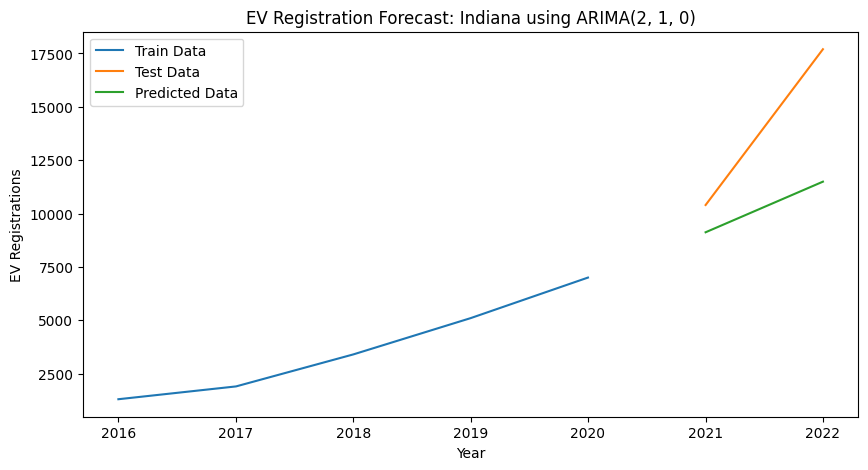

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-40.3670362503908 with test MSE=2085230.0246383422 for state Iowa


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

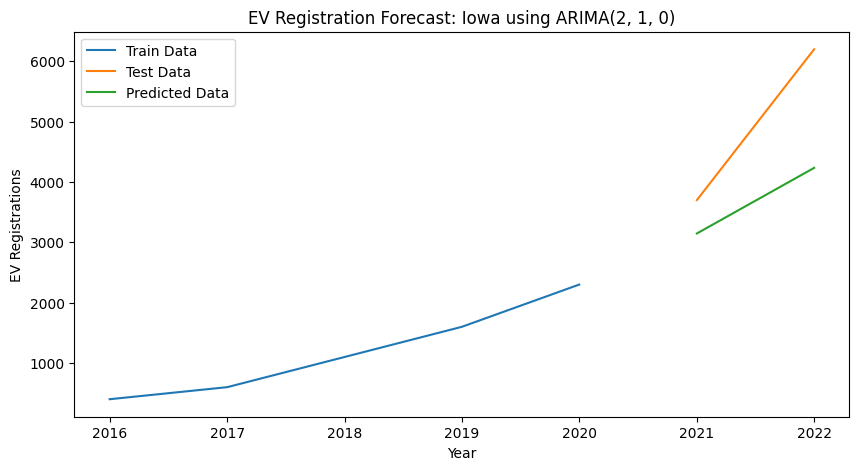

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=3933799.9999999944 for state Kansas


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

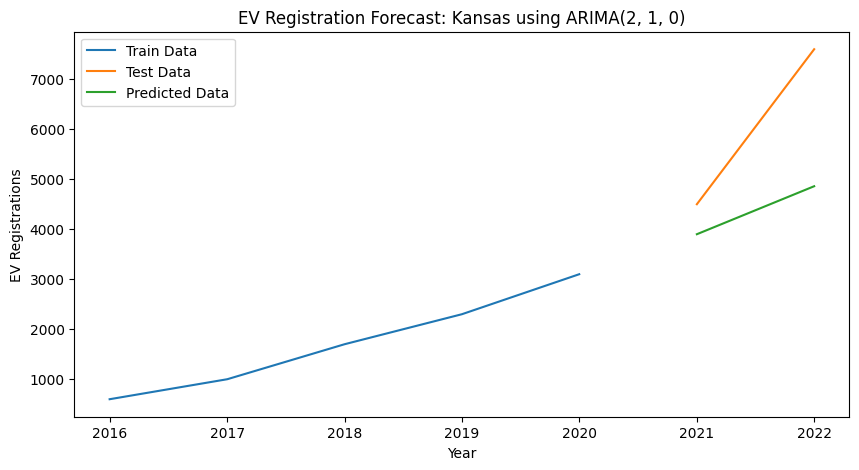

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=11223689.980192594 for state Kentucky


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

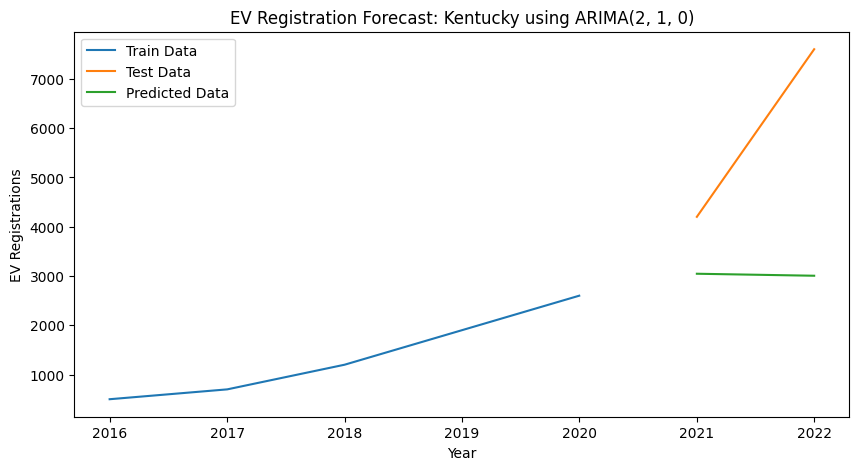

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.3759477270622 with test MSE=4929999.999999969 for state Louisiana


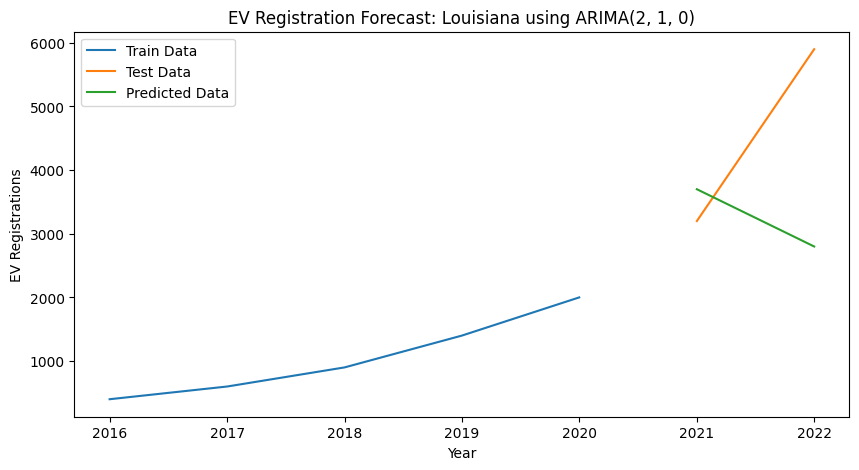

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=2824999.9999999832 for state Maine


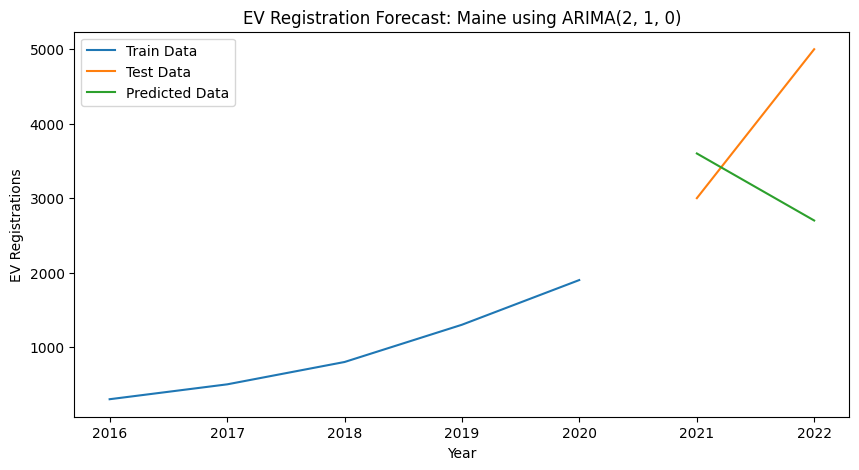

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.32411937638446 with test MSE=194808144.66330066 for state Maryland


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

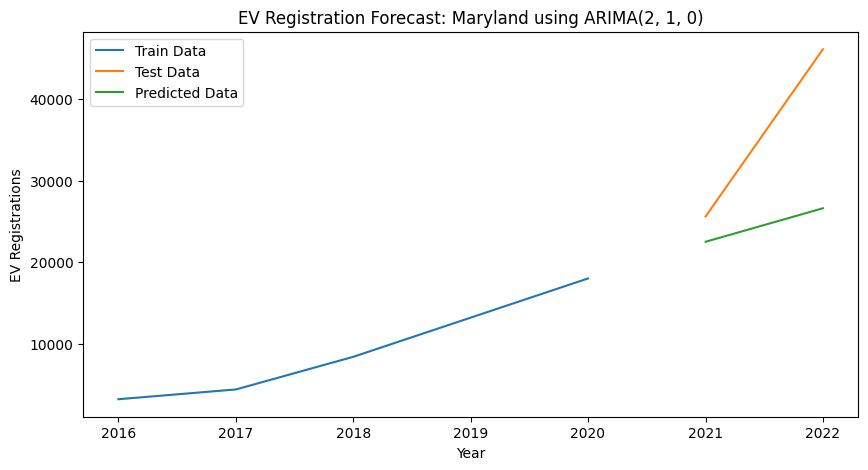

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=68112054.52320878 for state Massachusetts


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

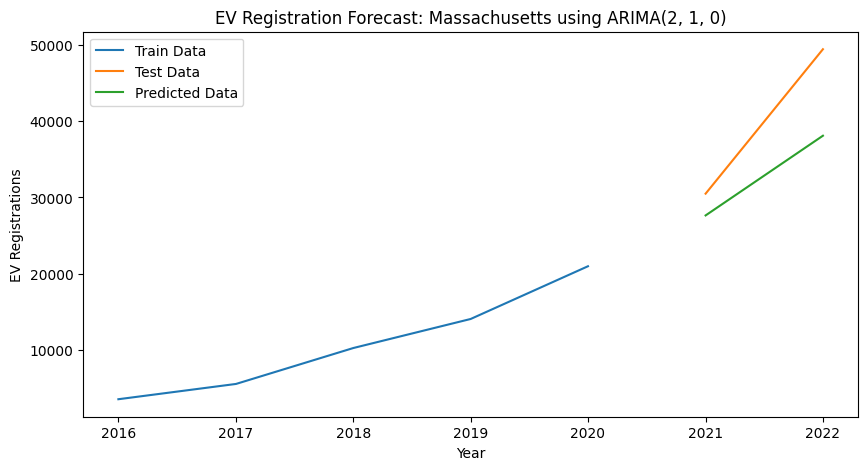

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.243286435389805 with test MSE=23308235.815301374 for state Michigan


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

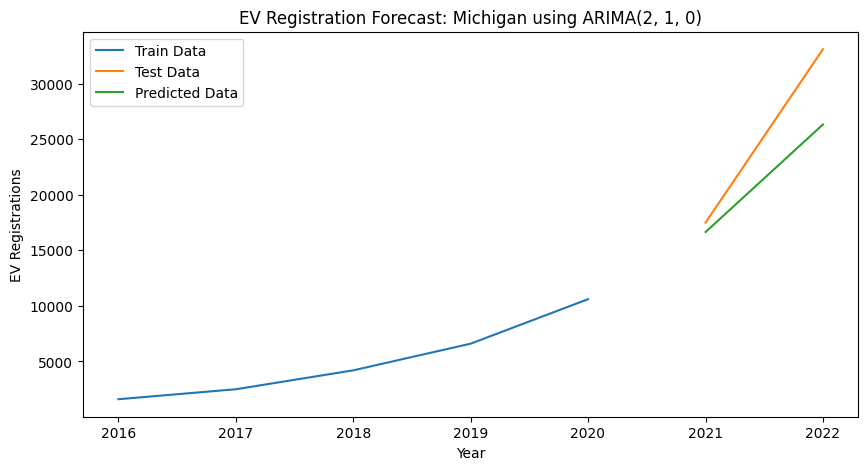

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=42058422.79924638 for state Minnesota


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

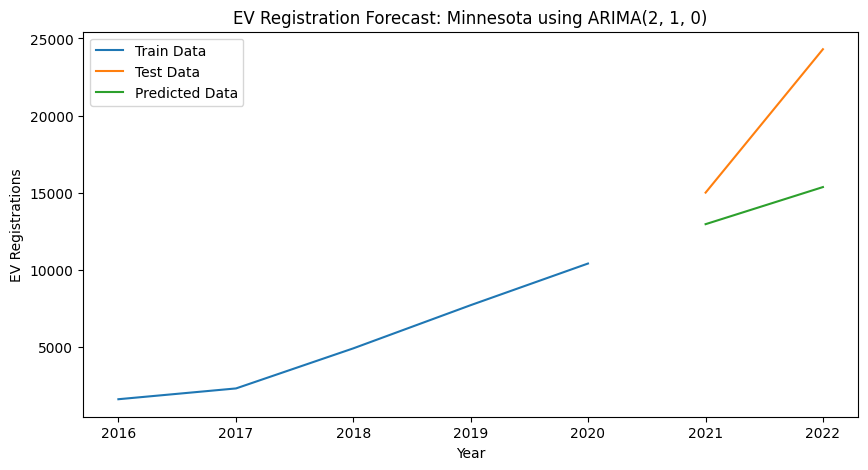

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 0, 0) AIC=-57.56392159059334 with test MSE=45000.00000000028 for state Mississippi


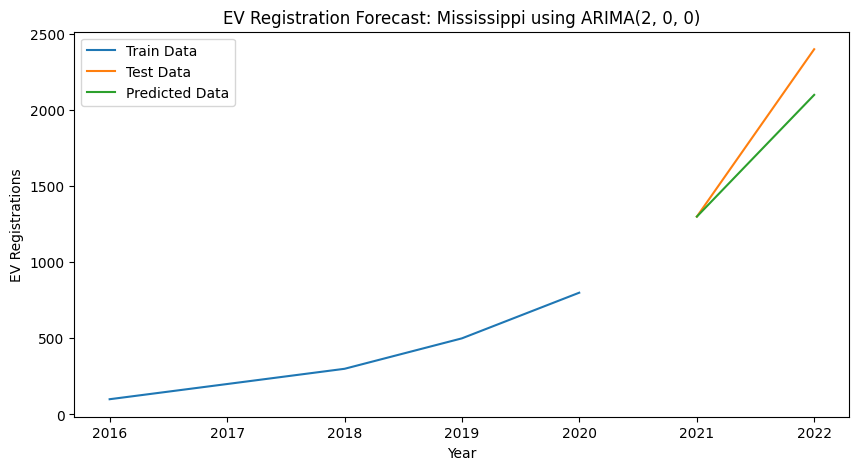

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=22490314.452311557 for state Missouri


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

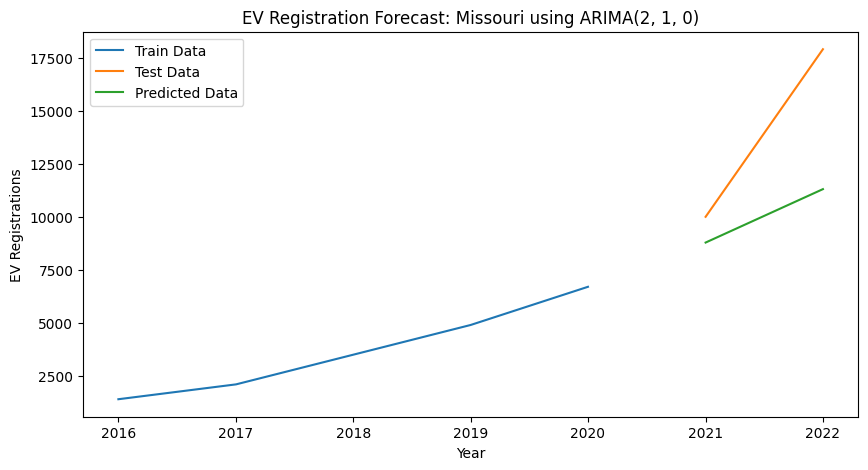

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=2125000.0 for state Montana


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

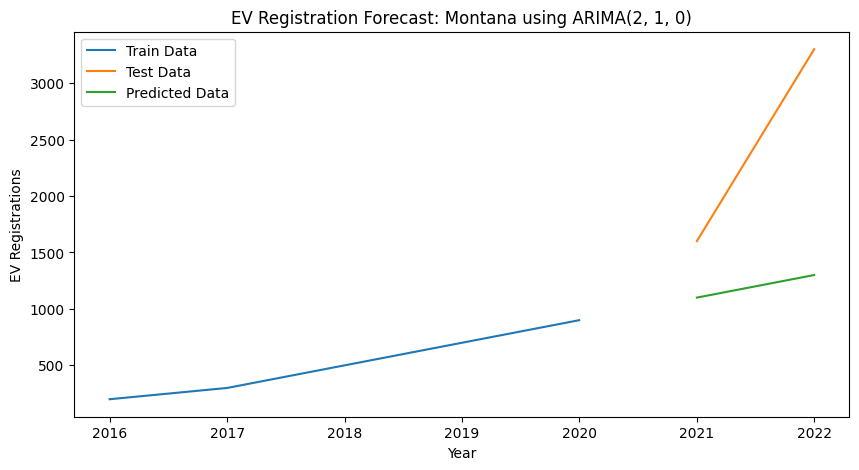

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=1244394.53125 for state Nebraska


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

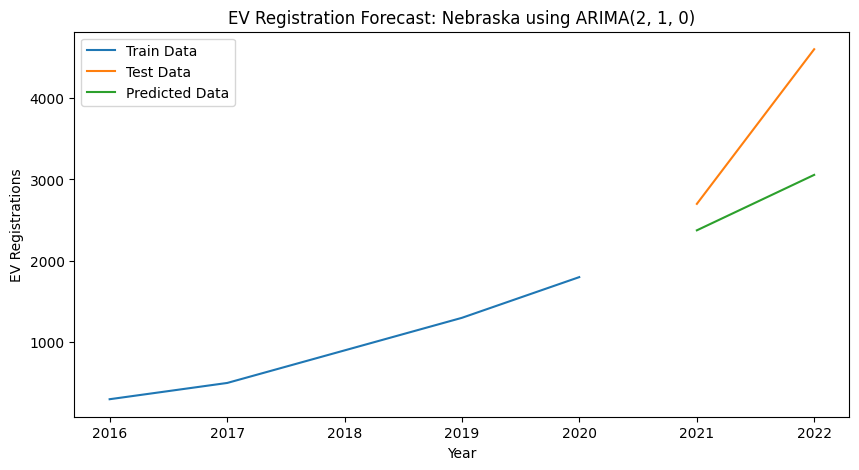

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-28.878151430515985 with test MSE=195326140.15361235 for state Nevada


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

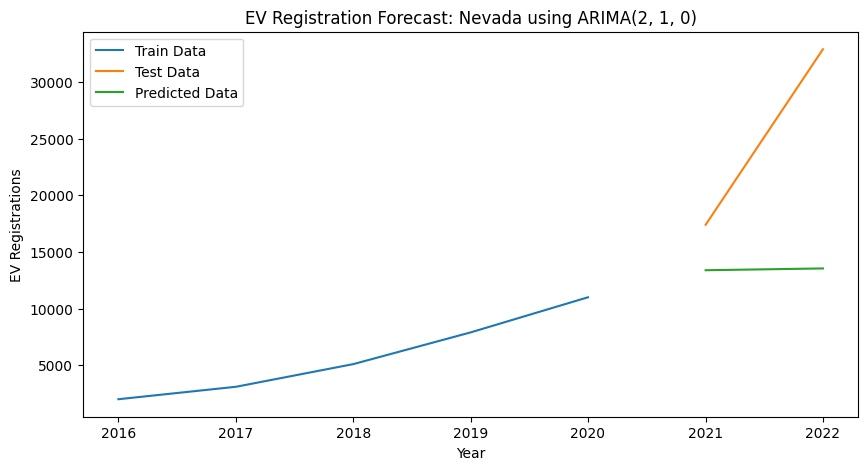

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594755058332 with test MSE=2819404.8391825804 for state New Hampshire


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

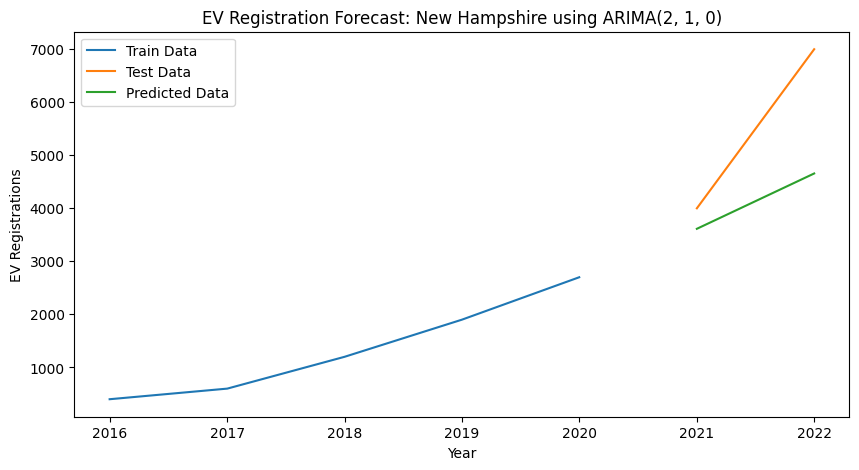

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.3759477270621 with test MSE=355532895.18979007 for state New Jersey


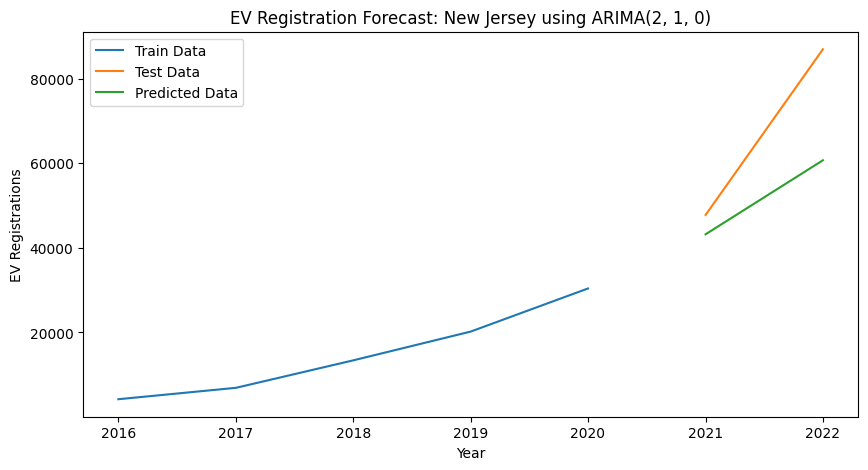

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=4268119.454089511 for state New Mexico


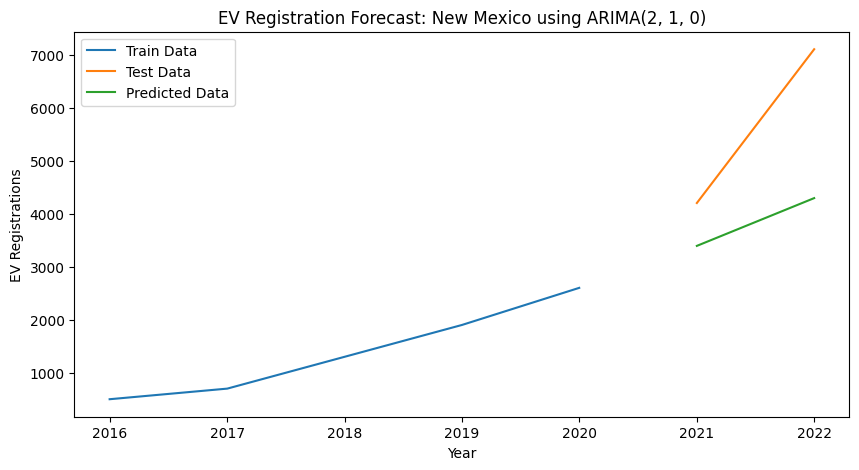

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727061565 with test MSE=319697463.7572972 for state New York


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

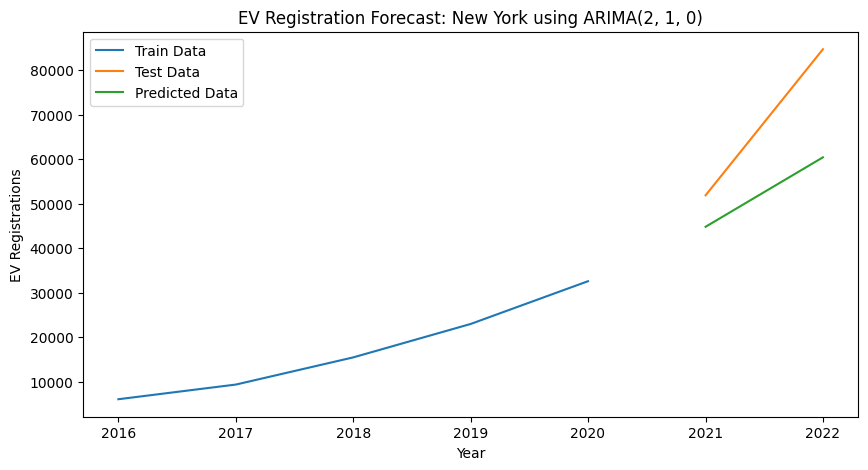

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706181 with test MSE=627160491.7785518 for state North Carolina


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\mlemodel.py:1233: RuntimeWarning: invalid value encountered in divide
  np.inner(score_obs, score_obs) /


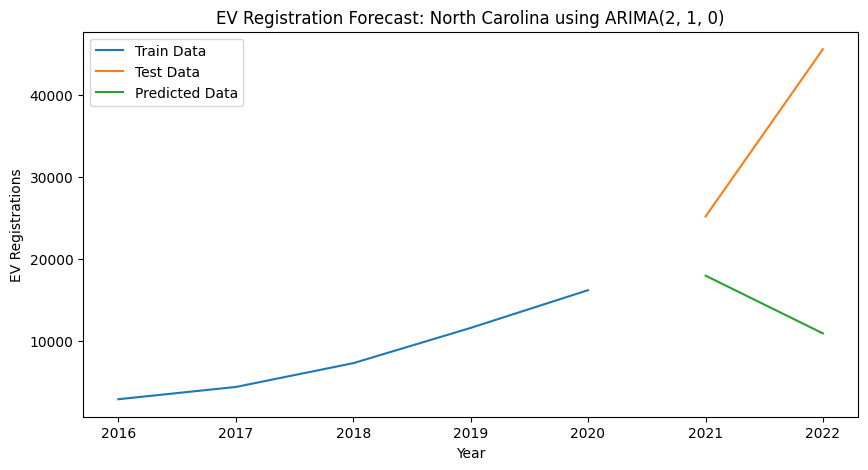

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=50000.0 for state North Dakota


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\mlemodel.py:1233: RuntimeWarning: invalid value encountered in divide
  np.inner(score_obs, score_obs) /


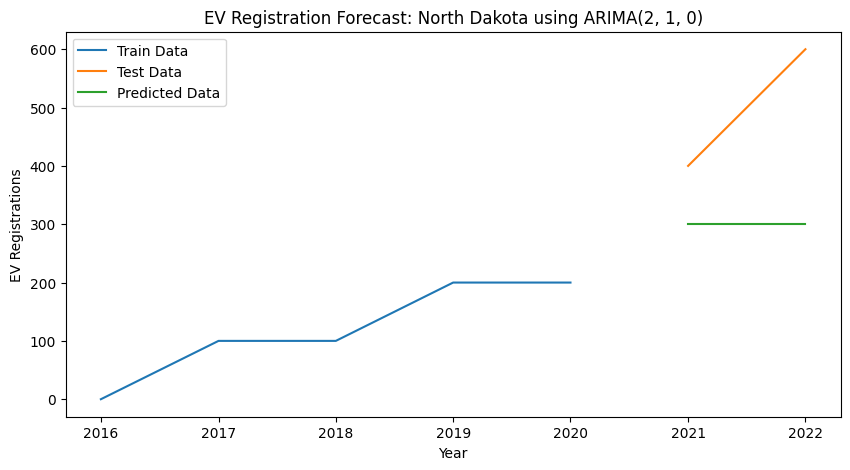

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.3759477270621 with test MSE=73695242.1338763 for state Ohio


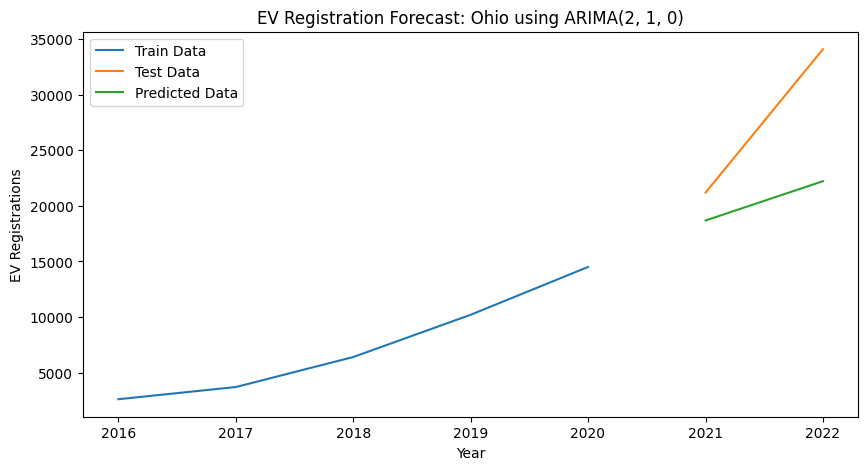

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37616952004932 with test MSE=89986629.37697102 for state Oklahoma


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

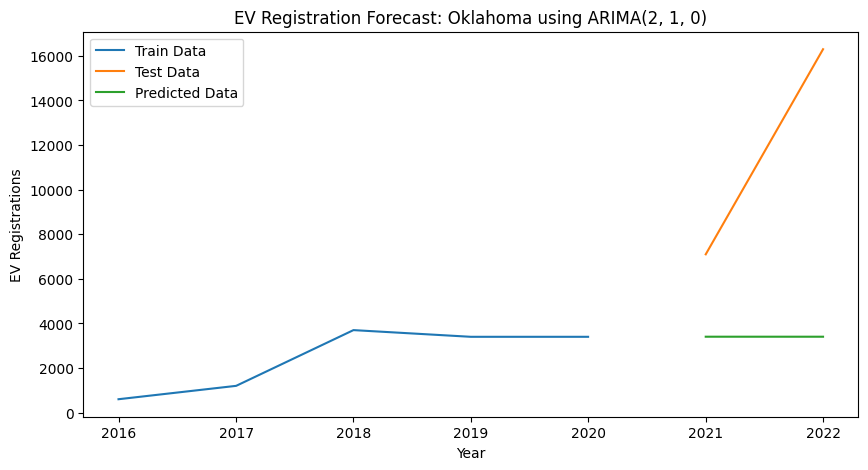

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772705812 with test MSE=1409525246.9135804 for state Oregon


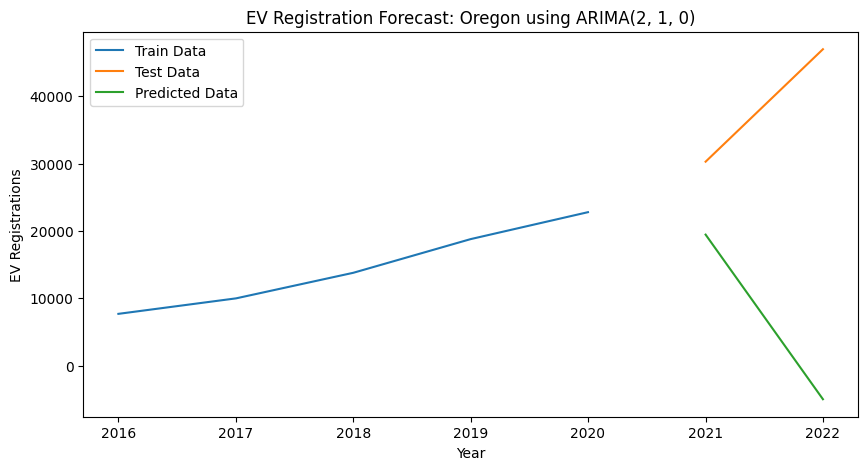

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=92325594.85478806 for state Pennsylvania


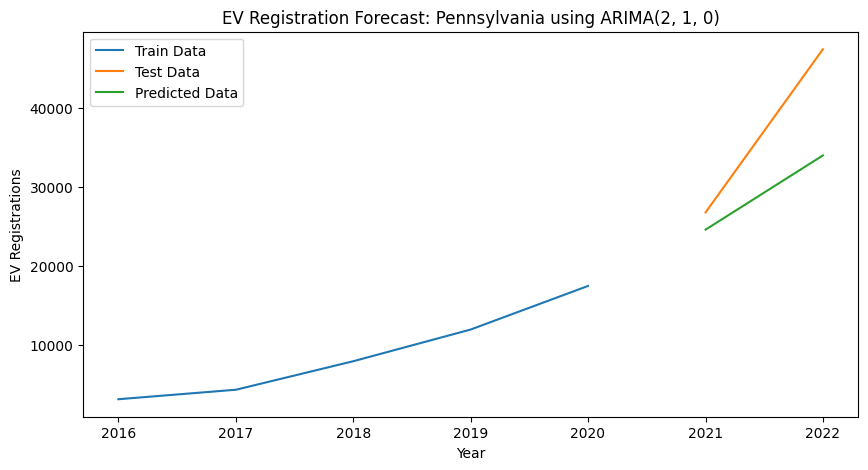

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=899872.0000000019 for state Rhode Island


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

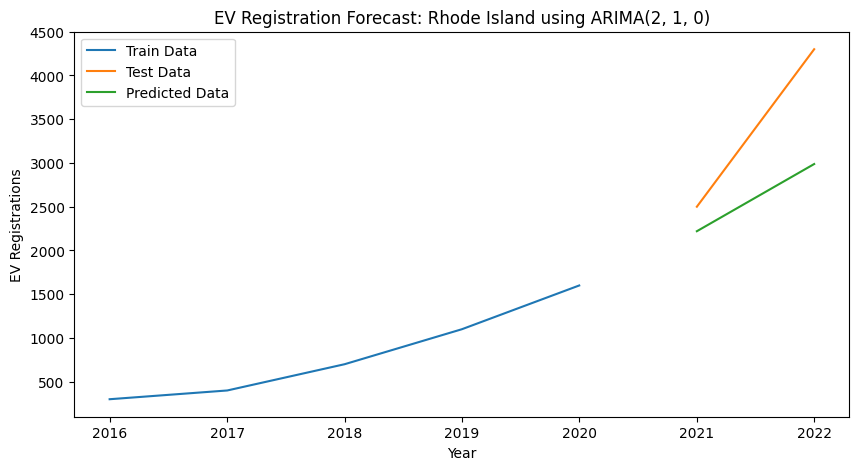

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706222 with test MSE=11185000.0 for state South Carolina


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

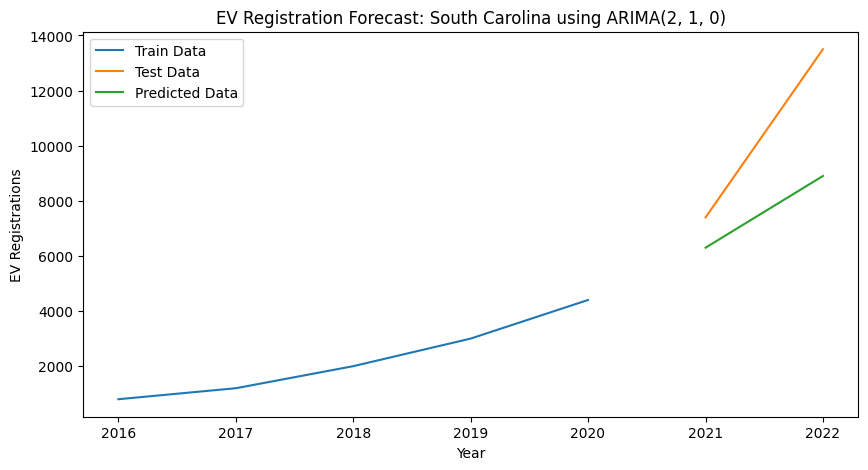

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=200000.0 for state South Dakota


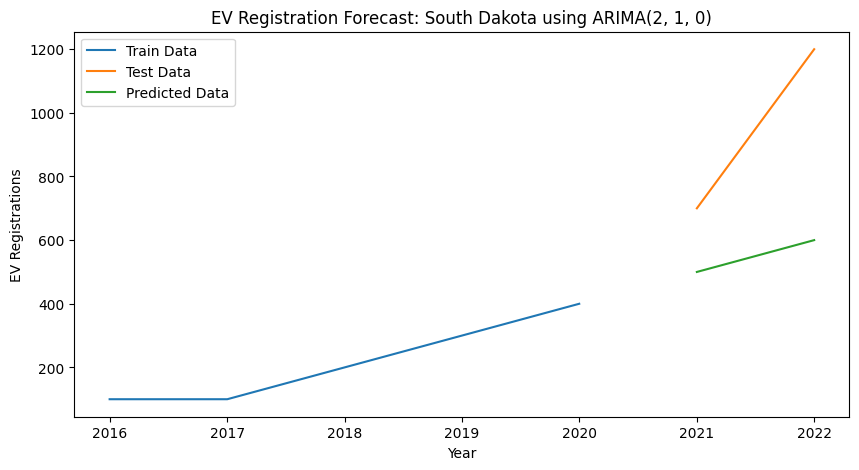

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706218 with test MSE=138786893.98287818 for state Tennessee


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

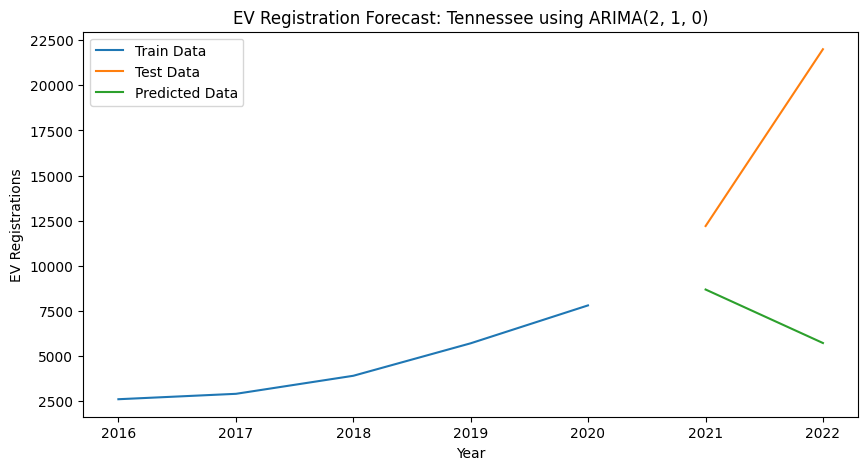

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-35.807554222105175 with test MSE=49361225773.8572 for state Texas


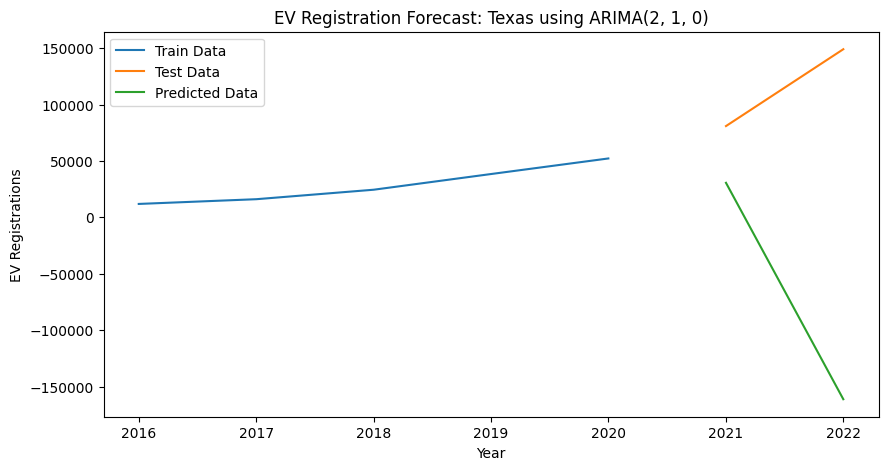

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.31611539615782 with test MSE=26991584.514448475 for state Utah


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

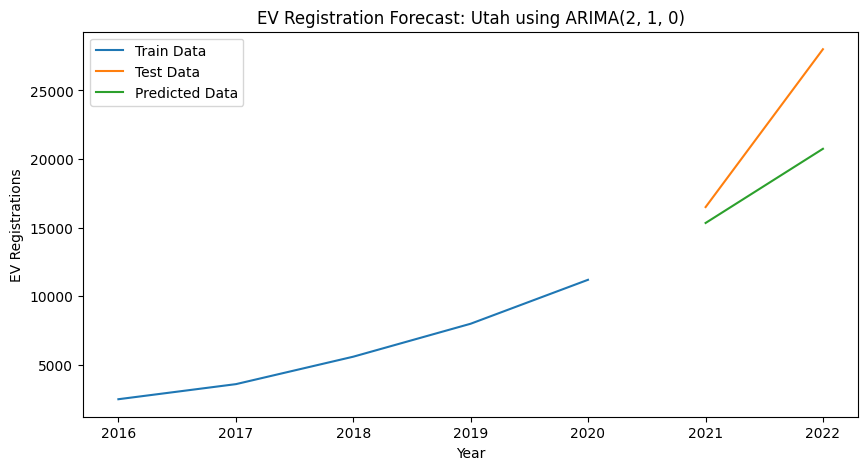

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=1351562.5000000007 for state Vermont


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:86

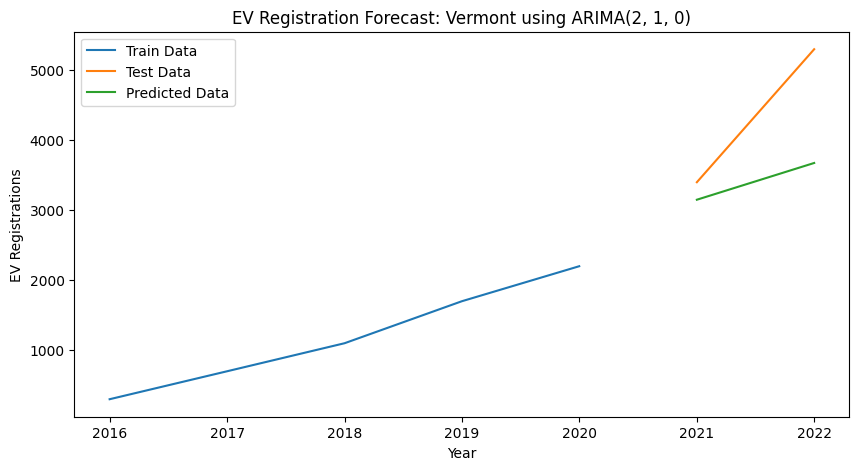

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37594772706196 with test MSE=291848425.03244287 for state Virginia


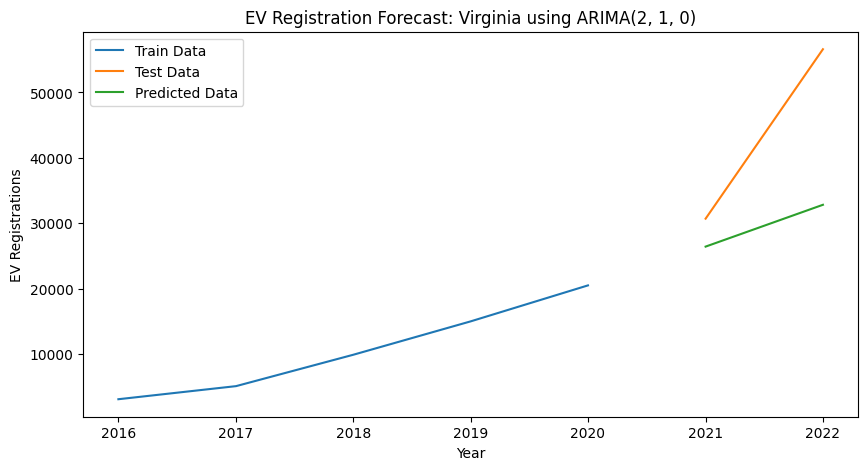

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.34681362662336 with test MSE=655276205.9006797 for state Washington


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

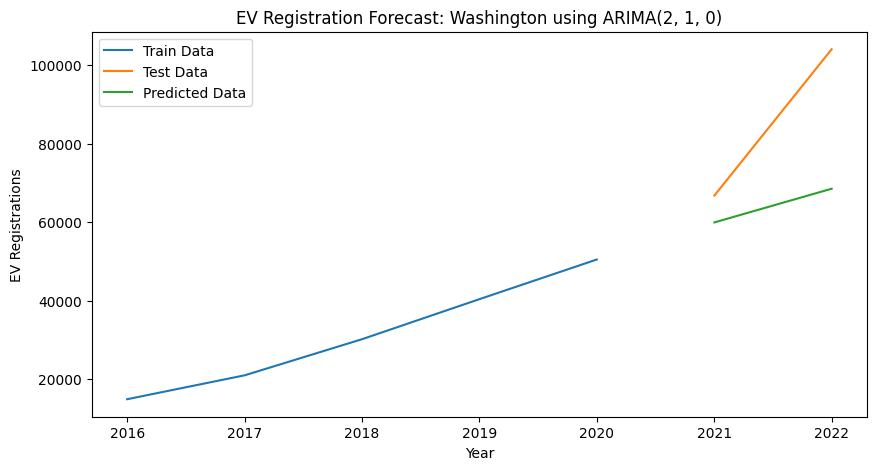

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=1524999.9999999995 for state West Virginia


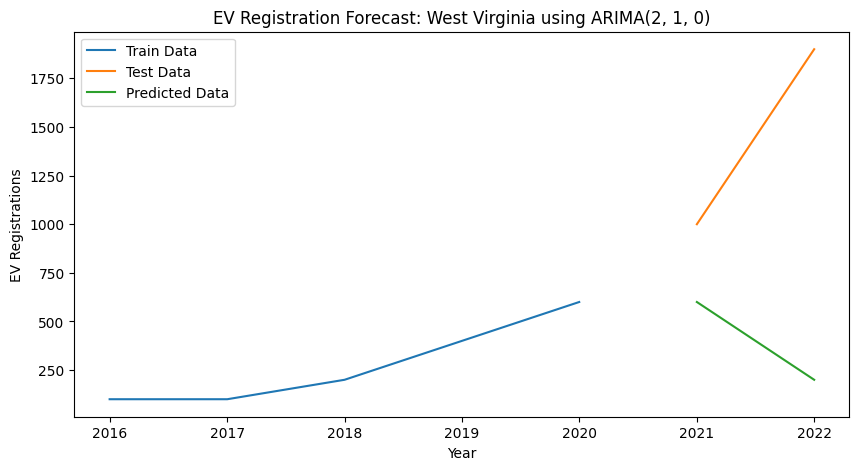

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.37486783484482 with test MSE=7778931.804537563 for state Wisconsin


C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Pro

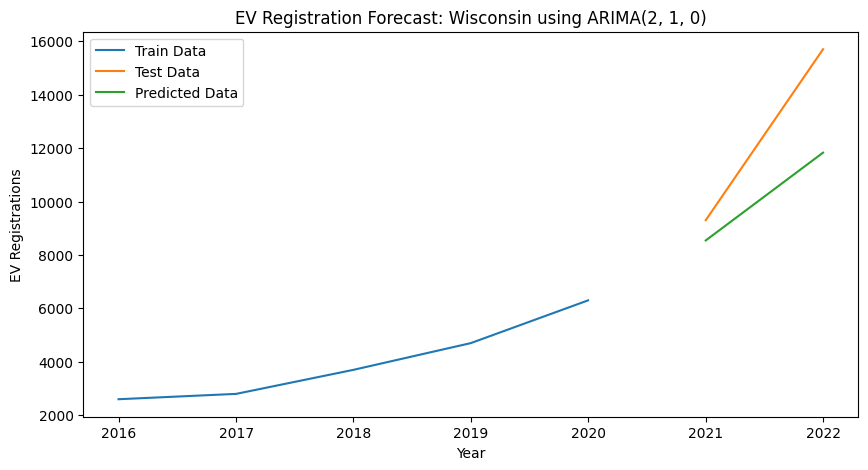

C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency YS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\Harinya's Desktop\Documents\Data Analytics Masters\Capstone\Capstone-Project-\dsenv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No

Best ARIMA(2, 1, 0) AIC=-36.375947727062226 with test MSE=100000.0 for state Wyoming


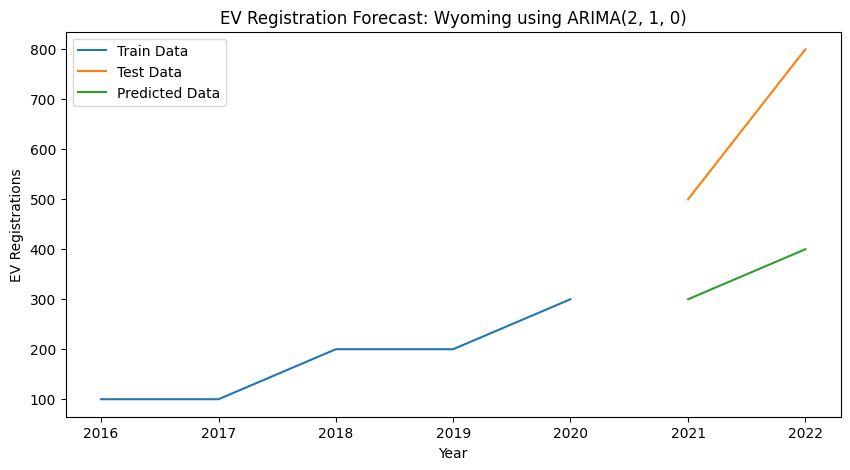

                   State ARIMA_order        AIC      Test MSE
0                Alabama   (2, 1, 0) -36.375948  6.025000e+06
1                 Alaska   (2, 1, 0) -37.667538  1.452469e+05
2                Arizona   (2, 1, 0) -36.556135  3.106284e+07
3               Arkansas   (2, 1, 0) -36.899730  3.872735e+06
4             California   (2, 1, 0) -36.375948  5.714002e+10
5               Colorado   (2, 1, 0) -36.375948  3.888000e+10
6            Connecticut   (2, 1, 0) -36.375948  3.714518e+07
7               Delaware   (2, 1, 0) -36.375948  1.920538e+06
8   District of Columbia   (2, 1, 0) -36.375948  4.772072e+06
9                Florida   (2, 1, 0) -36.375948  1.651479e+09
10               Georgia   (2, 1, 0) -36.375948  2.370900e+08
11                Hawaii   (2, 1, 0) -36.051874  2.527792e+06
12                 Idaho   (2, 1, 0) -36.375948  1.205000e+06
13              Illinois   (2, 1, 0) -36.375948  2.949168e+08
14               Indiana   (2, 1, 0) -36.375948  2.007047e+07
15      

In [59]:
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
import matplotlib.pyplot as plt

# Load your dataset
df = pd.read_csv("combined_data.csv")
df['Year'] = pd.to_datetime(df['Year'], format='%Y')
df.set_index('Year', inplace=True)

states = df['State'].unique()

# Define the p, d, and q ranges to try
p = d = q = range(0, 3)  # typically 0-2
pdq = [(x[0], x[1], x[2]) for x in list(itertools.product(p, d, q))]

results_summary = []

# Loop through each state to model
for state in states:
    state_data = df[df['State'] == state]['Electric (EV)']
    # Split data into train and test sets
    train_size = int(len(state_data) * 0.8)
    train, test = state_data.iloc[:train_size], state_data.iloc[train_size:]

    best_aic = np.inf
    best_order = None
    best_model = None
    
    # Grid search to find the best ARIMA model
    for param in pdq:
        try:
            temp_model = SARIMAX(train,
                                 order=param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = temp_model.fit(disp=0)
            
            # Compare AIC
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = param
                best_model = results
        except:
            continue
    
    # Evaluate the model on the test set
    if best_model is not None:
        predictions = best_model.get_forecast(steps=len(test))
        predictions = predictions.predicted_mean
        test_score = ((predictions - test) ** 2).mean()  # Mean Squared Error

        print(f'Best ARIMA{best_order} AIC={best_aic} with test MSE={test_score} for state {state}')
        results_summary.append((state, best_order, best_aic, test_score))
        
        # Plotting the results
        plt.figure(figsize=(10, 5))
        plt.plot(train.index, train, label='Train Data')
        plt.plot(test.index, test, label='Test Data')
        plt.plot(test.index, predictions, label='Predicted Data')
        plt.title(f'EV Registration Forecast: {state} using ARIMA{best_order}')
        plt.xlabel('Year')
        plt.ylabel('EV Registrations')
        plt.legend()
        plt.show()

# Convert results to DataFrame for easier viewing
results_df = pd.DataFrame(results_summary, columns=['State', 'ARIMA_order', 'AIC', 'Test MSE'])
print(results_df)
